<a href="https://colab.research.google.com/github/dude10116/DavisGrahamCosc470s24/blob/main/solutions/solution_cifar10_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# example of loading the cifar10 dataset
from keras.datasets.cifar10 import load_data
# load the images into memory
(trainX, trainy), (testX, testy) = load_data()
# summarize the shape of the dataset
print('Train', trainX.shape, trainy.shape)
print('Test', testX.shape, testy.shape)

170498071/170498071 [==============================] - 4s 0us/step
Train (50000, 32, 32, 3) (50000, 1)
Test (10000, 32, 32, 3) (10000, 1)


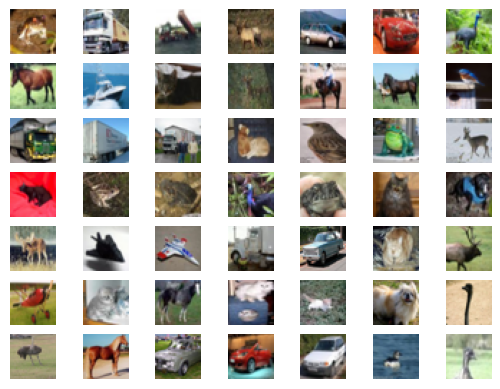

In [ ]:
# example of loading and plotting the cifar10 dataset
from keras.datasets.cifar10 import load_data
from matplotlib import pyplot
# load the images into memory
(trainX, trainy), (testX, testy) = load_data()
# plot images from the training dataset
for i in range(49):
	# define subplot
	pyplot.subplot(7, 7, 1 + i)
	# turn off axis
	pyplot.axis('off')
	# plot raw pixel data
	pyplot.imshow(trainX[i])
pyplot.show()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 leaky_re_lu_20 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_21 (Conv2D)          (None, 16, 16, 128)       73856     
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 16, 16, 128)       0         
                                                                 
 conv2d_22 (Conv2D)          (None, 8, 8, 128)         147584    
                                                                 
 leaky_re_lu_22 (LeakyReLU)  (None, 8, 8, 128)         0         
                                                                 
 conv2d_23 (Conv2D)          (None, 4, 4, 256)        

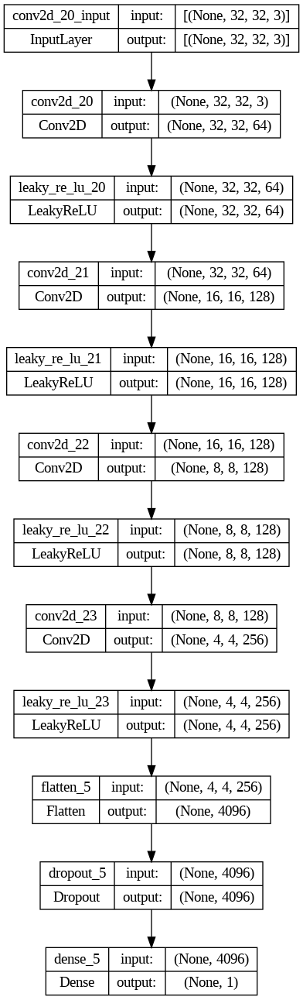

In [ ]:
!pip install graphviz

# example of defining the discriminator model
from keras.models import Sequential
from keras.optimizers import Adam
from keras.layers import Dense
from keras.layers import Conv2D
from keras.layers import Flatten
from keras.layers import Dropout
from keras.layers import LeakyReLU
from tensorflow.keras.utils import plot_model

# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
	model = Sequential()
	# normal
	model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# classifier
	model.add(Flatten())
	model.add(Dropout(0.4))
	model.add(Dense(1, activation='sigmoid'))
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model

# define model
model = define_discriminator()
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# example of training the discriminator model on real and random cifar10 images
from numpy import expand_dims
from numpy import ones
from numpy import zeros
from numpy.random import rand
from numpy.random import randint
from keras.datasets.cifar10 import load_data
from keras.datasets.cifar10 import load_data as load_data_100
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Conv2D
from keras.layers import Flatten
from keras.layers import Dropout
from keras.layers import LeakyReLU

# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
	model = Sequential()
	# normal
	model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# classifier
	model.add(Flatten())
	model.add(Dropout(0.4))
	model.add(Dense(1, activation='sigmoid'))
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model

# load and prepare cifar10 training images
def load_real_samples(loadfunc):
	# load cifar10 dataset
	(trainX, _), (_, _) = loadfunc()
	# convert from unsigned ints to floats
	X = trainX.astype('float32')
	# scale from [0,255] to [-1,1]
	X = (X - 127.5) / 127.5
	return X

# select real samples
def generate_real_samples(dataset, n_samples):
	# choose random instances
	ix = randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	# generate 'real' class labels (1)
	y = ones((n_samples, 1))
	return X, y

# generate n fake samples with class labels
def generate_fake_samples(n_samples):
	# generate uniform random numbers in [0,1]
	X = rand(32 * 32 * 3 * n_samples)
	# update to have the range [-1, 1]
	X = -1 + X * 2
	# reshape into a batch of color images
	X = X.reshape((n_samples, 32, 32, 3))
	# generate 'fake' class labels (0)
	y = zeros((n_samples, 1))
	return X, y

# train the discriminator model
def train_discriminator(model, dataset, n_iter=20, n_batch=128):
	half_batch = int(n_batch / 2)
	# manually enumerate epochs
	for i in range(n_iter):
		# get randomly selected 'real' samples
		X_real, y_real = generate_real_samples(dataset, half_batch)
		# update discriminator on real samples
		_, real_acc = model.train_on_batch(X_real, y_real)
		# generate 'fake' examples
		X_fake, y_fake = generate_fake_samples(half_batch)
		# update discriminator on fake samples
		_, fake_acc = model.train_on_batch(X_fake, y_fake)
		# summarize performance
		print('>%d real=%.0f%% fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

# define the discriminator model
model = define_discriminator()
# load image data
dataset10 = load_real_samples(load_data)
# fit the model
train_discriminator(model, dataset10)

>1 real=81% fake=0%
>2 real=98% fake=0%
>3 real=98% fake=56%
>4 real=98% fake=100%
>5 real=98% fake=100%
>6 real=100% fake=100%
>7 real=100% fake=100%
>8 real=98% fake=100%
>9 real=100% fake=100%
>10 real=100% fake=100%
>11 real=100% fake=100%
>12 real=100% fake=100%
>13 real=100% fake=100%
>14 real=98% fake=100%
>15 real=100% fake=100%
>16 real=100% fake=100%
>17 real=100% fake=100%
>18 real=100% fake=100%
>19 real=100% fake=100%
>20 real=100% fake=100%


In [ ]:
import numpy as np
a_real = model.predict(np.array([dataset10[0], dataset10[37476]]))
print(a_real)
fake_samples = generate_fake_samples(2)
a_fake = model.predict(fake_samples[0])
print(a_fake)

1/1 [==============================] - 0s 140ms/step
[[0.99998486]
 [0.99999994]]
1/1 [==============================] - 0s 42ms/step
[[0.0002613 ]
 [0.00032961]]


(50000, 32, 32, 3)
1/1 [==============================] - 0s 26ms/step


[[1.        ]
 [0.99999547]]


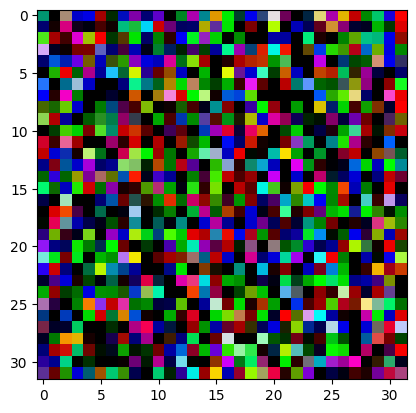

In [ ]:
# how well does it recognize images from the cifar-100 dataset, when it was only trained on cifar-10
dataset100 = load_real_samples(load_data_100)
print(dataset100.shape)
a_real100 = model.predict(np.array([dataset100[7500], dataset100[23000]]))
print(a_real100)
pyplot.imshow(fake_samples[0][0])

2/2 [==============================] - 1s 216ms/step


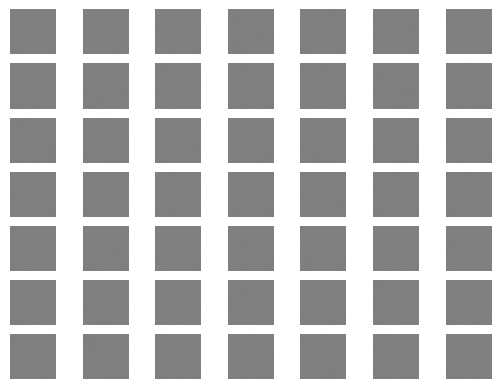

In [ ]:
# example of defining and using the generator model
from numpy import zeros
from numpy.random import randn
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from matplotlib import pyplot

# define the standalone generator model
def define_generator(latent_dim):
	model = Sequential()
	# foundation for 4x4 image
	n_nodes = 256 * 4 * 4
	model.add(Dense(n_nodes, input_dim=latent_dim))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 256)))
	# upsample to 8x8
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 16x16
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 32x32
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# output layer
	model.add(Conv2D(3, (3,3), activation='tanh', padding='same'))
	return model

# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
	# generate points in latent space
	x_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	X = g_model.predict(x_input)
	# create 'fake' class labels (0)
	y = zeros((n_samples, 1))
	return X, y

# size of the latent space
latent_dim = 100
# define the discriminator model
model = define_generator(latent_dim)
# generate samples
n_samples = 49
X, _ = generate_fake_samples(model, latent_dim, n_samples)
# scale pixel values from [-1,1] to [0,1]
X = (X + 1) / 2.0
# plot the generated samples
for i in range(n_samples):
	# define subplot
	pyplot.subplot(7, 7, 1 + i)
	# turn off axis labels
	pyplot.axis('off')
	# plot single image
	pyplot.imshow(X[i])
# show the figure
pyplot.show()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_11 (Sequential)  (None, 32, 32, 3)         1466115   
                                                                 
 sequential_10 (Sequential)  (None, 1)                 522497    
                                                                 
Total params: 1988612 (7.59 MB)
Trainable params: 1466115 (5.59 MB)
Non-trainable params: 522497 (1.99 MB)
_________________________________________________________________


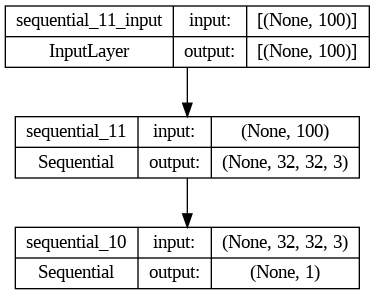

In [ ]:
# demonstrate creating the three models in the gan
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout
from tensorflow.keras.utils import plot_model

# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
	model = Sequential()
	# normal
	model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# classifier
	model.add(Flatten())
	model.add(Dropout(0.4))
	model.add(Dense(1, activation='sigmoid'))
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model

# define the standalone generator model
def define_generator(latent_dim):
	model = Sequential()
	# foundation for 4x4 image
	n_nodes = 256 * 4 * 4
	model.add(Dense(n_nodes, input_dim=latent_dim))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 256)))
	# upsample to 8x8
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 16x16
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 32x32
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# output layer
	model.add(Conv2D(3, (3,3), activation='tanh', padding='same'))
	return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
	# make weights in the discriminator not trainable
	d_model.trainable = False
	# connect them
	model = Sequential()
	# add generator
	model.add(g_model)
	# add the discriminator
	model.add(d_model)
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt)
	return model

# size of the latent space
latent_dim = 100
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# summarize gan model
gan_model.summary()
# plot gan model
plot_model(gan_model, to_file='gan_plot.png', show_shapes=True, show_layer_names=True)

2/2 [==============================] - 1s 6ms/step
>1, 1/390, d1=0.689, d2=0.709 g=0.689


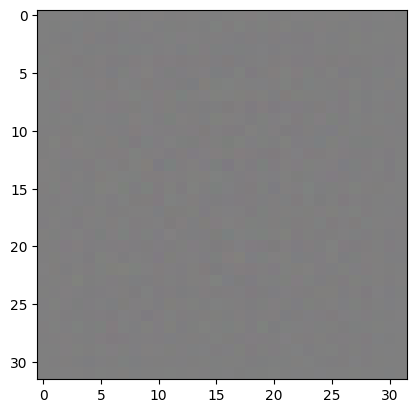

2/2 [==============================] - 0s 5ms/step
>1, 2/390, d1=0.484, d2=0.854 g=0.631


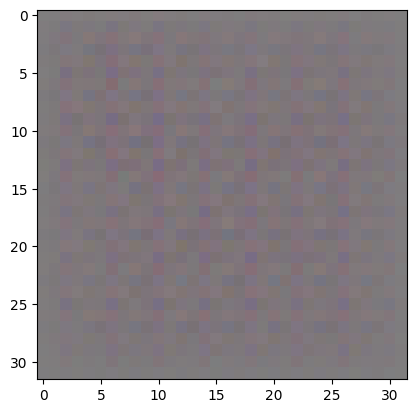

2/2 [==============================] - 0s 5ms/step
>1, 3/390, d1=0.177, d2=1.660 g=0.670


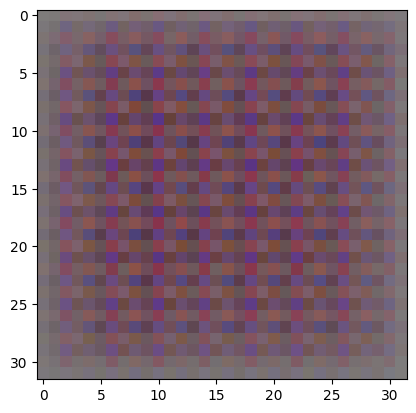

2/2 [==============================] - 0s 5ms/step
>1, 4/390, d1=0.180, d2=0.627 g=1.431


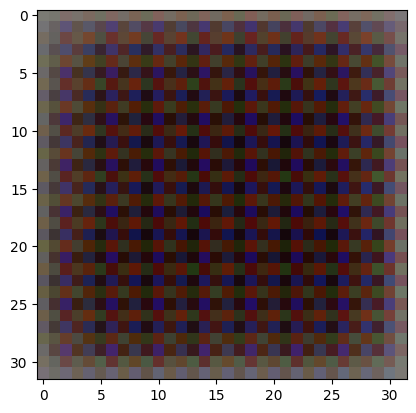

2/2 [==============================] - 0s 10ms/step
>1, 5/390, d1=0.155, d2=0.477 g=1.477


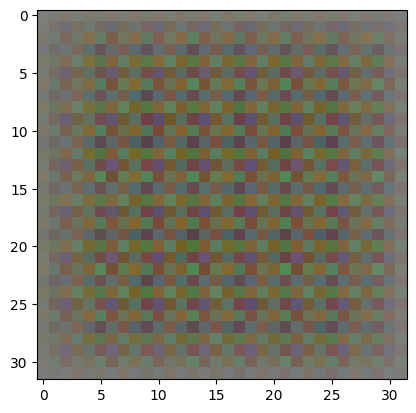

2/2 [==============================] - 0s 6ms/step
>1, 6/390, d1=0.251, d2=0.640 g=0.781


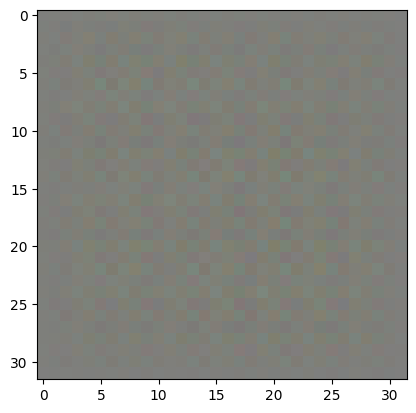

2/2 [==============================] - 0s 6ms/step
>1, 7/390, d1=0.222, d2=1.121 g=0.724


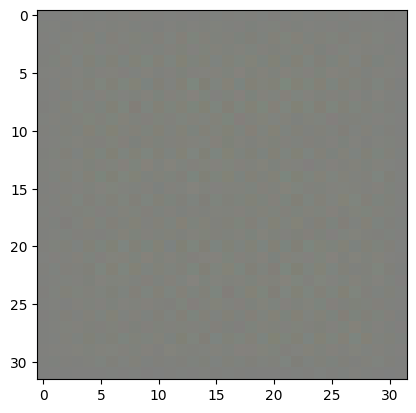

2/2 [==============================] - 0s 6ms/step
>1, 8/390, d1=0.115, d2=1.269 g=0.708


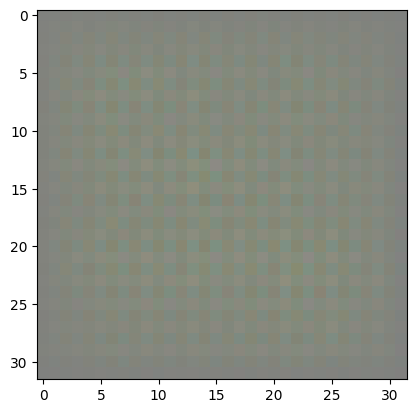

2/2 [==============================] - 0s 7ms/step
>1, 9/390, d1=0.187, d2=0.835 g=0.967


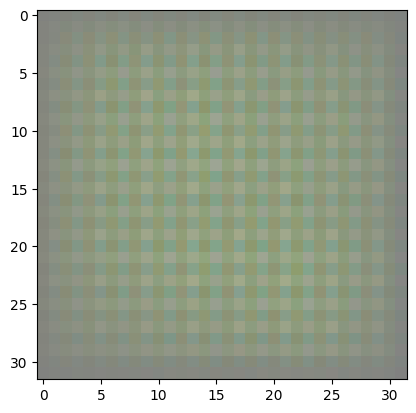

2/2 [==============================] - 0s 7ms/step
>1, 10/390, d1=0.409, d2=0.603 g=0.846


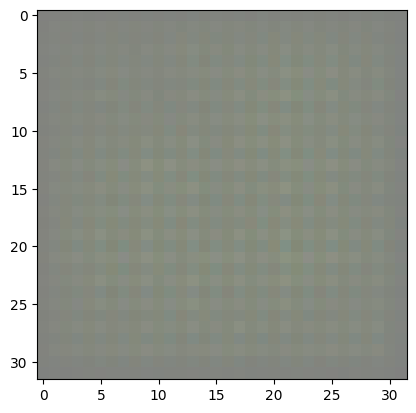

2/2 [==============================] - 0s 7ms/step
>1, 11/390, d1=0.050, d2=0.606 g=0.833


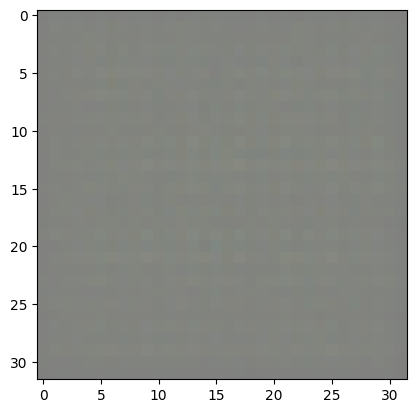

2/2 [==============================] - 0s 7ms/step
>1, 12/390, d1=0.007, d2=0.603 g=0.852


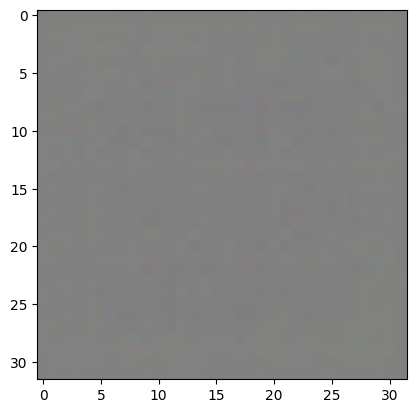

2/2 [==============================] - 0s 8ms/step
>1, 13/390, d1=0.020, d2=0.872 g=0.804


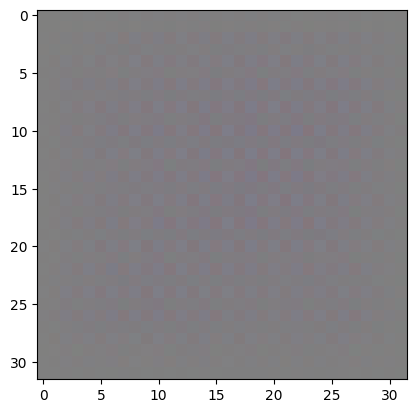

2/2 [==============================] - 0s 8ms/step
>1, 14/390, d1=0.021, d2=1.289 g=0.936


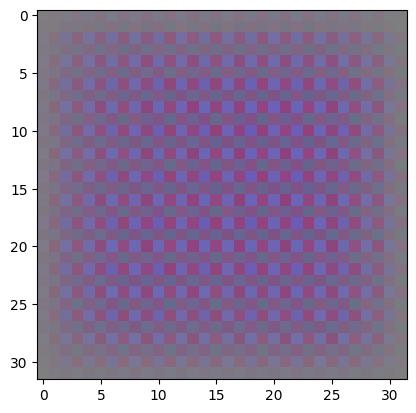

2/2 [==============================] - 0s 5ms/step
>1, 15/390, d1=0.055, d2=0.591 g=1.206


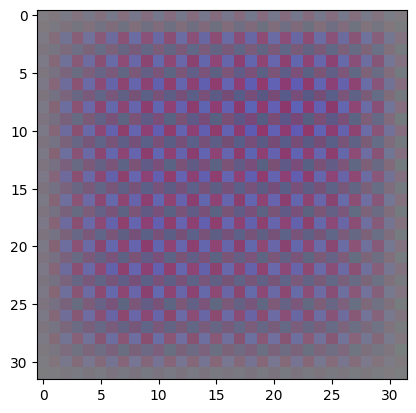

2/2 [==============================] - 0s 7ms/step
>1, 16/390, d1=0.219, d2=0.510 g=1.570


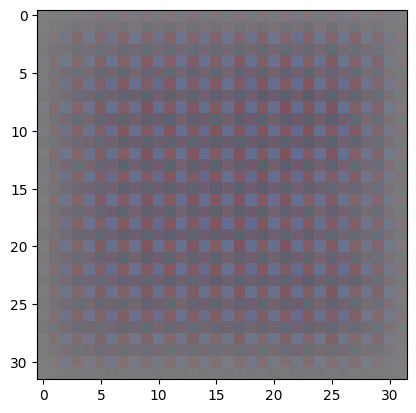

2/2 [==============================] - 0s 7ms/step
>1, 17/390, d1=0.105, d2=0.362 g=1.684


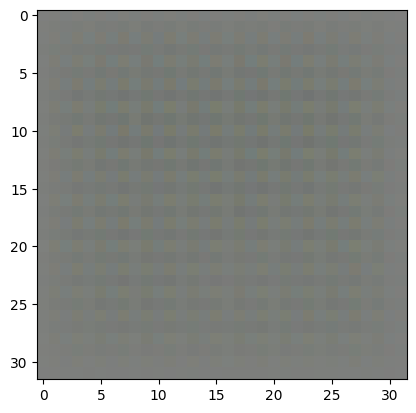

2/2 [==============================] - 0s 6ms/step
>1, 18/390, d1=0.071, d2=0.230 g=2.143


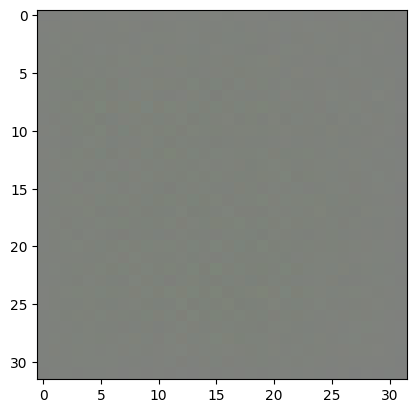

2/2 [==============================] - 0s 5ms/step
>1, 19/390, d1=0.004, d2=0.651 g=4.003


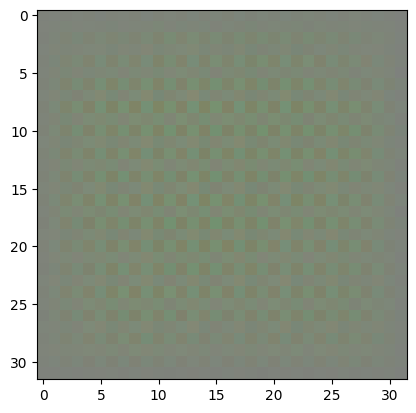

2/2 [==============================] - 0s 6ms/step
>1, 20/390, d1=0.309, d2=0.282 g=4.356


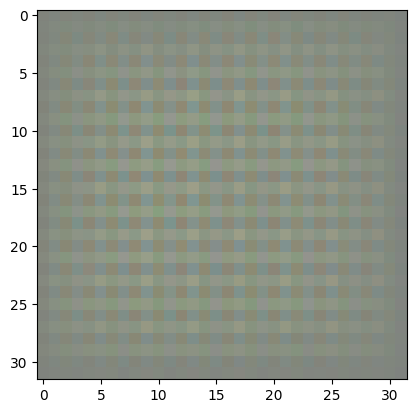

2/2 [==============================] - 0s 6ms/step
>1, 21/390, d1=0.015, d2=0.625 g=8.720


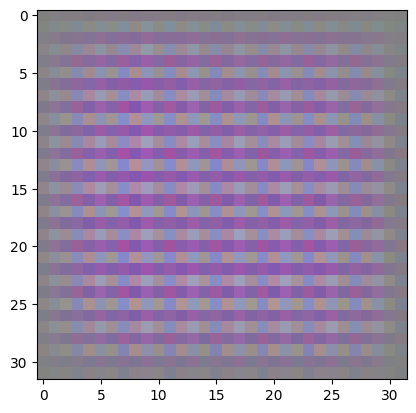

2/2 [==============================] - 0s 7ms/step
>1, 22/390, d1=2.536, d2=0.194 g=1.982


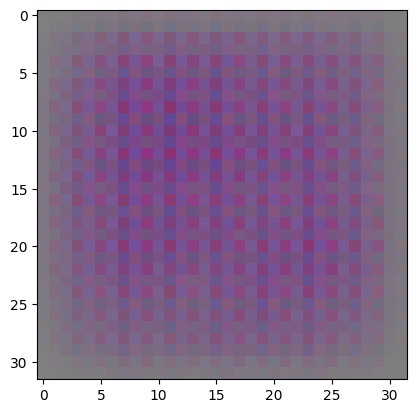

2/2 [==============================] - 0s 7ms/step
>1, 23/390, d1=0.075, d2=8.855 g=1.977


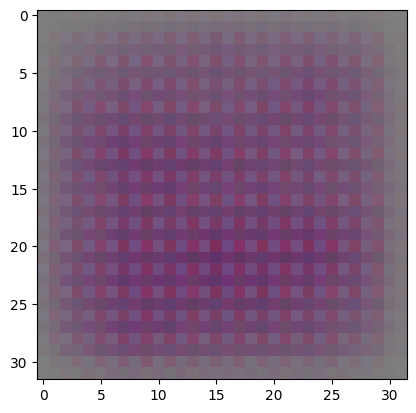

2/2 [==============================] - 0s 7ms/step
>1, 24/390, d1=0.156, d2=0.257 g=1.787


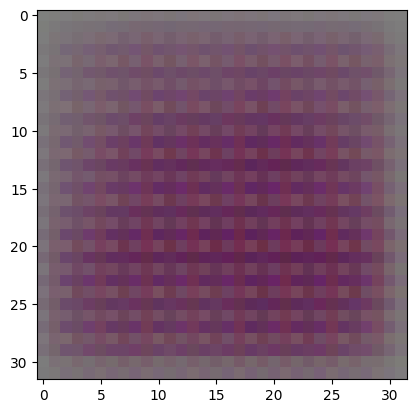

2/2 [==============================] - 0s 7ms/step
>1, 25/390, d1=0.679, d2=0.293 g=1.590


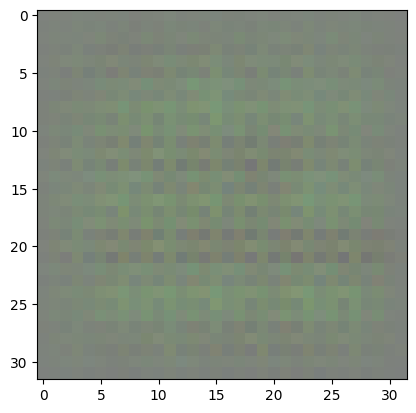

2/2 [==============================] - 0s 7ms/step
>1, 26/390, d1=0.409, d2=0.760 g=1.375


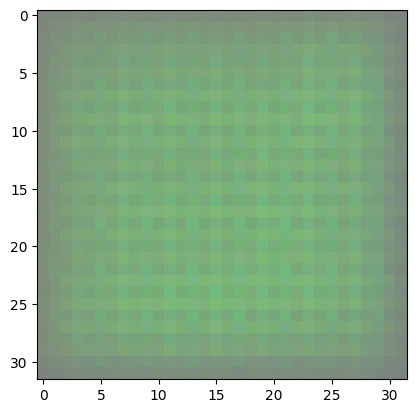

2/2 [==============================] - 0s 7ms/step
>1, 27/390, d1=0.287, d2=0.712 g=2.064


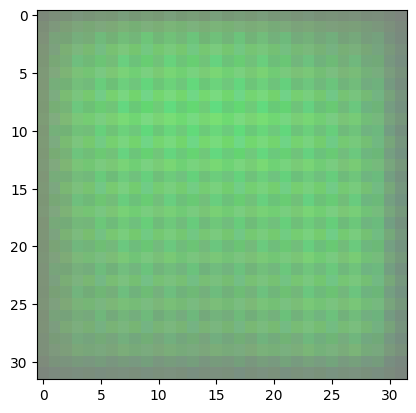

2/2 [==============================] - 0s 7ms/step
>1, 28/390, d1=0.512, d2=0.241 g=2.416


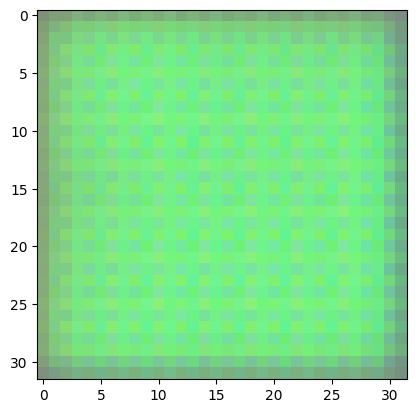

2/2 [==============================] - 0s 10ms/step
>1, 29/390, d1=0.488, d2=0.354 g=1.666


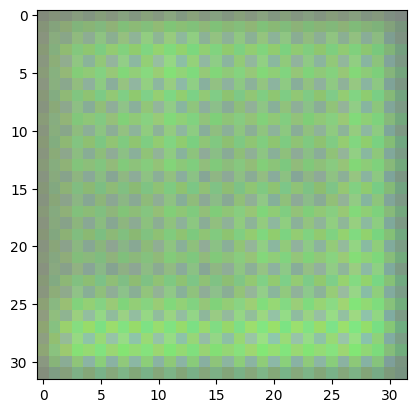

2/2 [==============================] - 0s 9ms/step
>1, 30/390, d1=0.298, d2=0.465 g=2.044


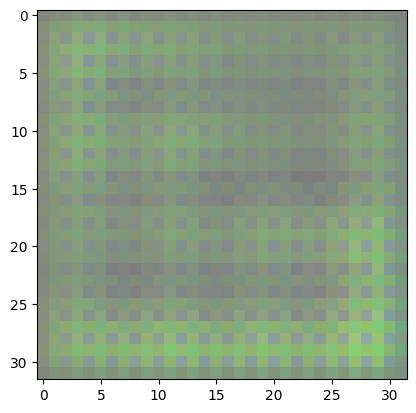

2/2 [==============================] - 0s 7ms/step
>1, 31/390, d1=0.119, d2=0.139 g=2.808


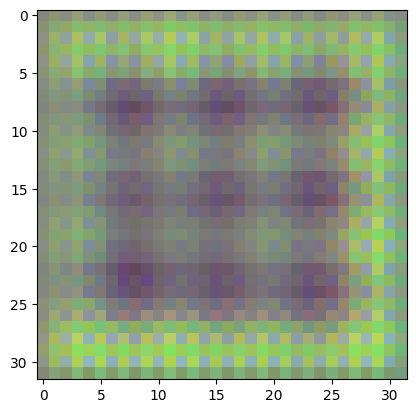

2/2 [==============================] - 0s 13ms/step
>1, 32/390, d1=0.087, d2=0.590 g=3.093


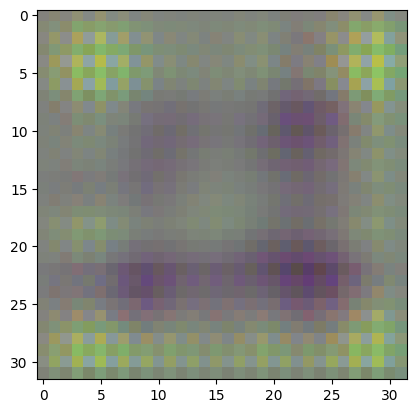

2/2 [==============================] - 0s 7ms/step
>1, 33/390, d1=0.180, d2=1.049 g=3.926


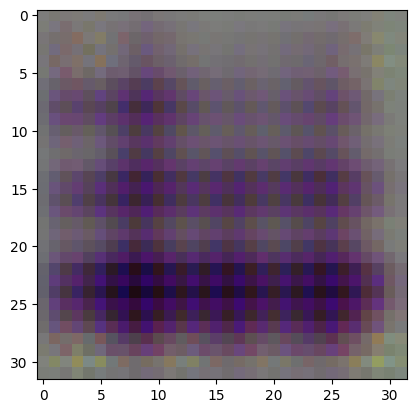

2/2 [==============================] - 0s 7ms/step
>1, 34/390, d1=0.437, d2=0.147 g=2.854


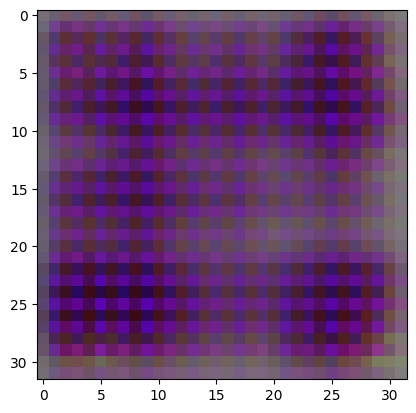

2/2 [==============================] - 0s 7ms/step
>1, 35/390, d1=0.563, d2=0.954 g=4.688


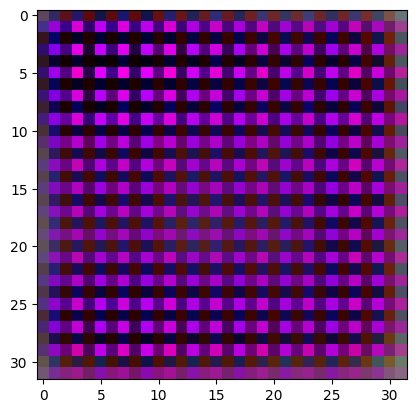

2/2 [==============================] - 0s 7ms/step
>1, 36/390, d1=0.589, d2=0.019 g=4.997


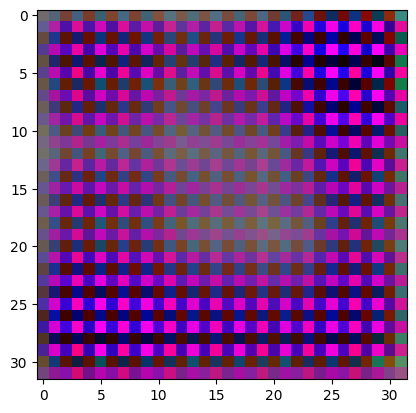

2/2 [==============================] - 0s 7ms/step
>1, 37/390, d1=0.281, d2=0.367 g=3.407


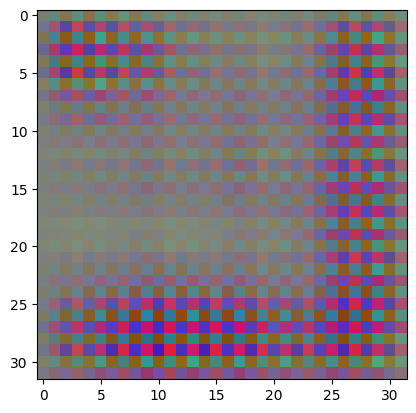

2/2 [==============================] - 0s 7ms/step
>1, 38/390, d1=0.133, d2=0.711 g=3.453


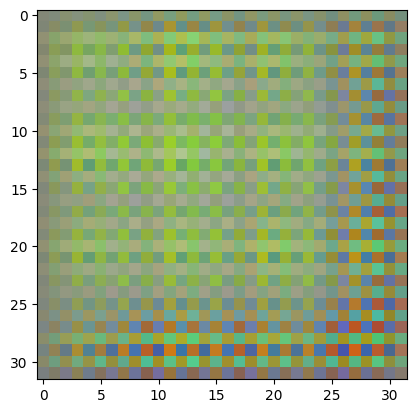

2/2 [==============================] - 0s 6ms/step
>1, 39/390, d1=0.253, d2=0.502 g=2.977


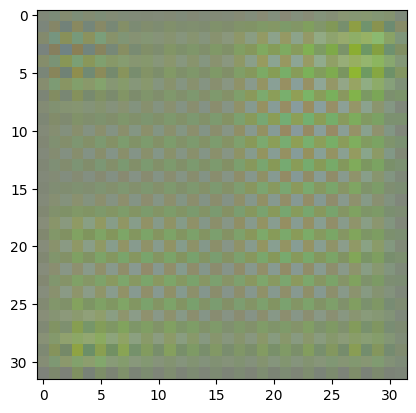

2/2 [==============================] - 0s 7ms/step
>1, 40/390, d1=0.440, d2=0.256 g=3.178


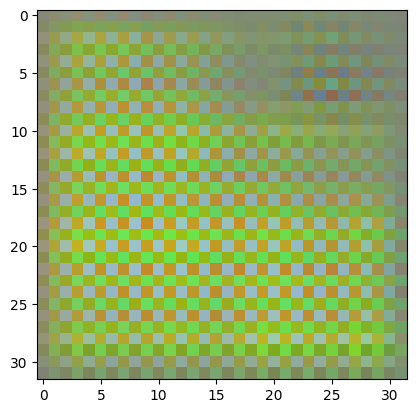

2/2 [==============================] - 0s 6ms/step
>1, 41/390, d1=0.395, d2=0.176 g=3.593


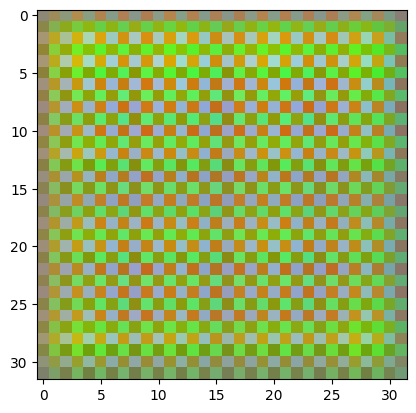

2/2 [==============================] - 0s 7ms/step
>1, 42/390, d1=0.590, d2=0.474 g=5.847


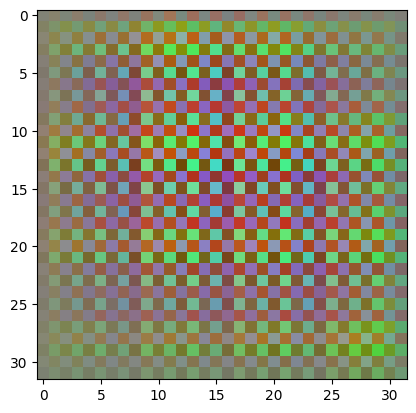

2/2 [==============================] - 0s 7ms/step
>1, 43/390, d1=0.227, d2=0.024 g=4.038


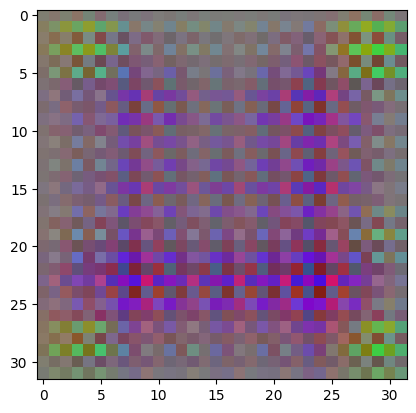

2/2 [==============================] - 0s 6ms/step
>1, 44/390, d1=0.527, d2=0.076 g=2.894


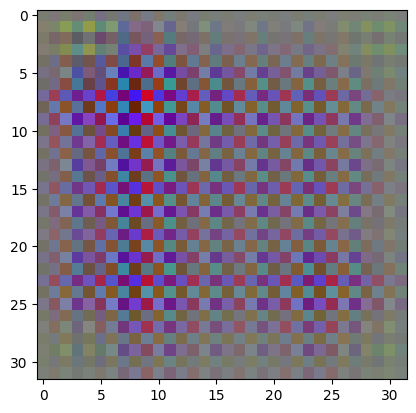

2/2 [==============================] - 0s 6ms/step
>1, 45/390, d1=0.145, d2=0.832 g=1.817


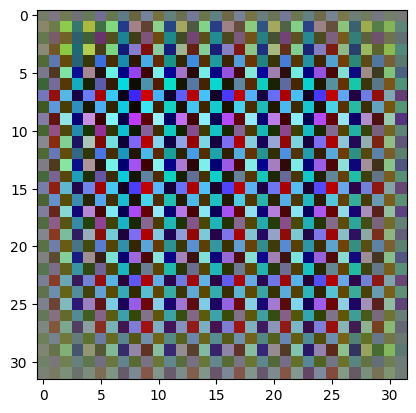

2/2 [==============================] - 0s 7ms/step
>1, 46/390, d1=0.103, d2=0.368 g=3.682


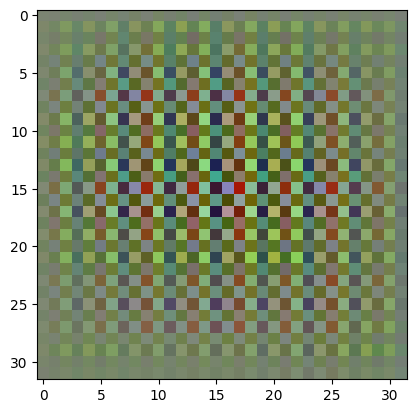

2/2 [==============================] - 0s 7ms/step
>1, 47/390, d1=0.139, d2=0.104 g=4.321


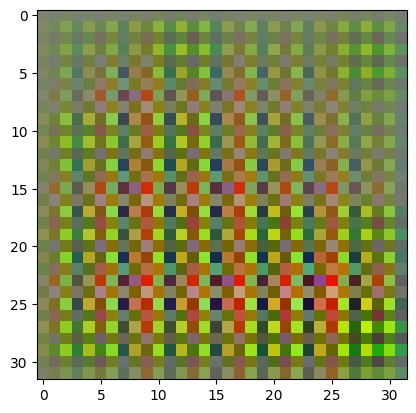

2/2 [==============================] - 0s 8ms/step
>1, 48/390, d1=0.300, d2=0.165 g=3.771


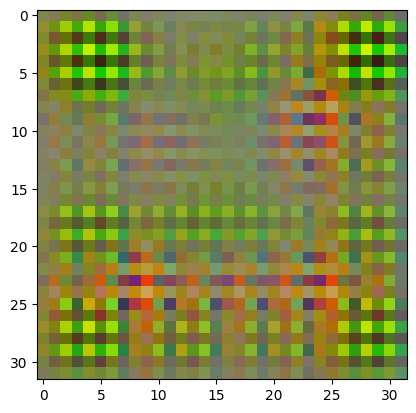

2/2 [==============================] - 0s 7ms/step
>1, 49/390, d1=0.174, d2=0.090 g=3.744


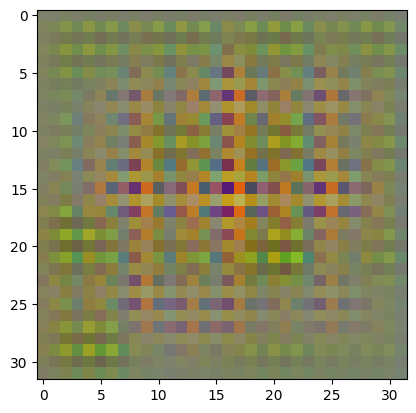

2/2 [==============================] - 0s 7ms/step
>1, 50/390, d1=0.193, d2=0.089 g=3.323


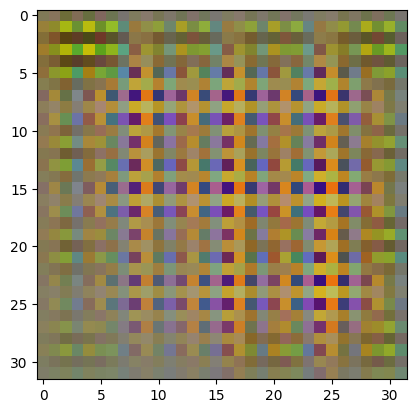

2/2 [==============================] - 0s 6ms/step
>1, 51/390, d1=0.187, d2=0.129 g=3.085


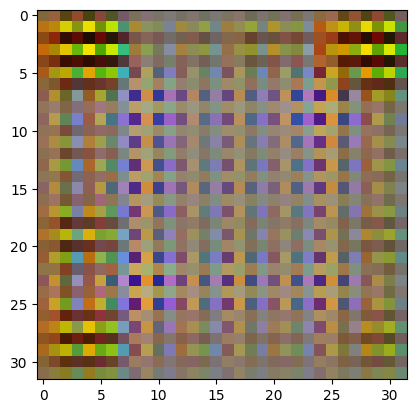

2/2 [==============================] - 0s 6ms/step
>1, 52/390, d1=0.122, d2=0.783 g=4.917


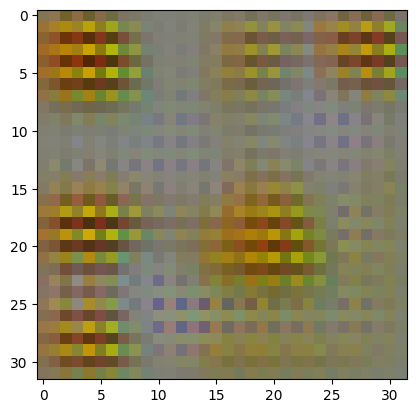

2/2 [==============================] - 0s 7ms/step
>1, 53/390, d1=0.184, d2=0.008 g=5.397


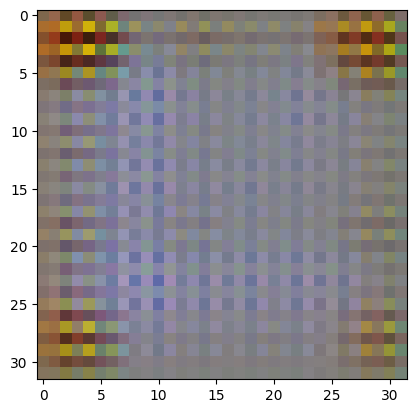

2/2 [==============================] - 0s 14ms/step
>1, 54/390, d1=0.404, d2=0.022 g=3.810


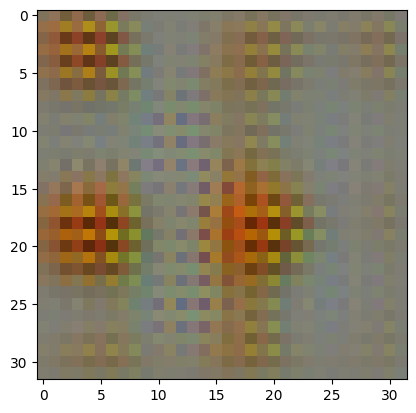

2/2 [==============================] - 0s 6ms/step
>1, 55/390, d1=0.057, d2=0.071 g=3.011


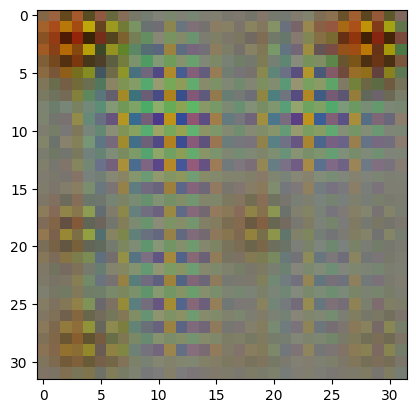

2/2 [==============================] - 0s 5ms/step
>1, 56/390, d1=0.108, d2=0.668 g=3.869


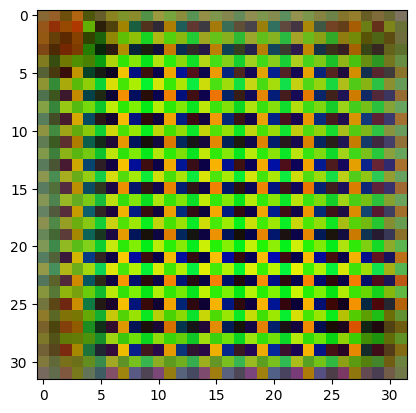

2/2 [==============================] - 0s 6ms/step
>1, 57/390, d1=0.229, d2=0.168 g=4.880


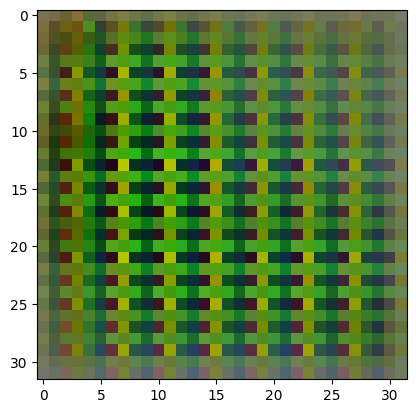

2/2 [==============================] - 0s 7ms/step
>1, 58/390, d1=0.249, d2=0.449 g=5.623


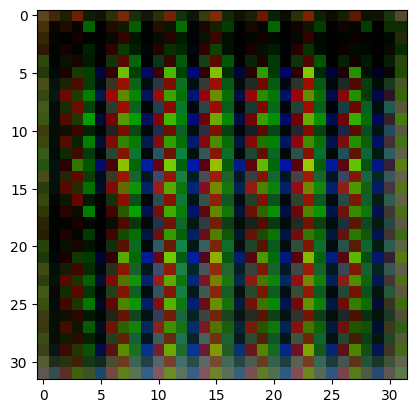

2/2 [==============================] - 0s 6ms/step
>1, 59/390, d1=1.122, d2=0.271 g=3.102


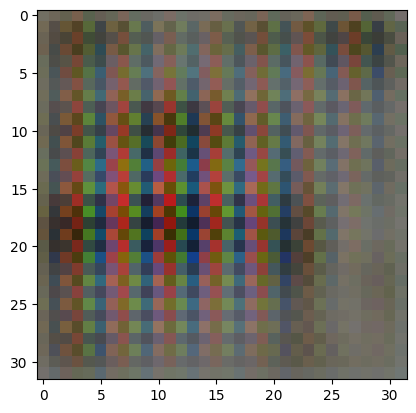

2/2 [==============================] - 0s 10ms/step
>1, 60/390, d1=0.218, d2=0.062 g=3.778


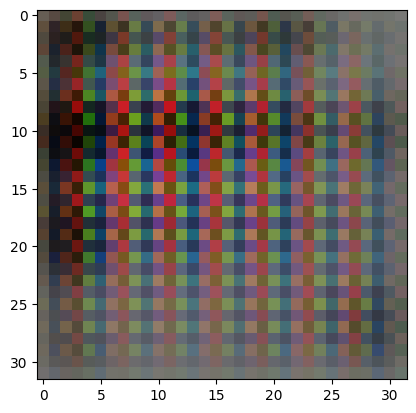

2/2 [==============================] - 0s 7ms/step
>1, 61/390, d1=0.348, d2=0.092 g=3.090


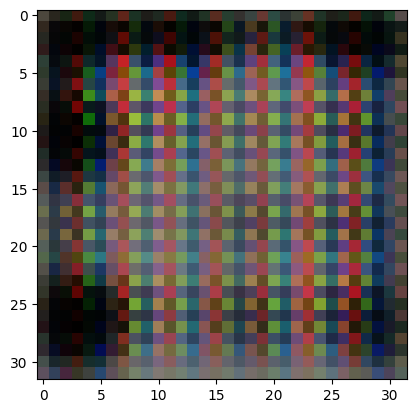

2/2 [==============================] - 0s 7ms/step
>1, 62/390, d1=0.060, d2=0.108 g=3.979


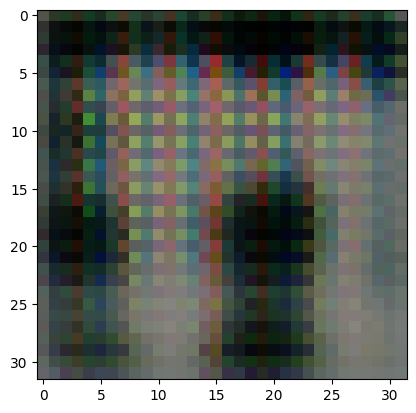

2/2 [==============================] - 0s 7ms/step
>1, 63/390, d1=0.220, d2=0.082 g=3.880


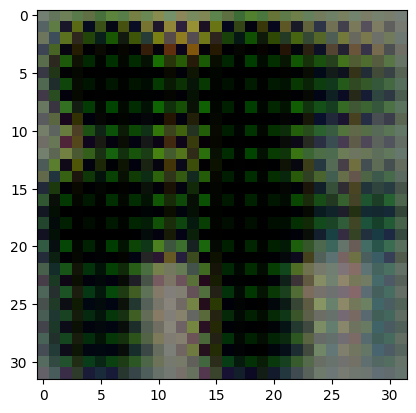

2/2 [==============================] - 0s 7ms/step
>1, 64/390, d1=0.127, d2=1.838 g=7.711


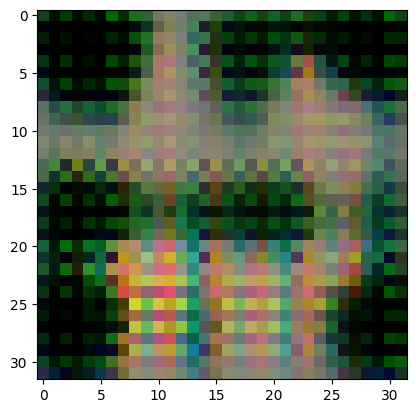

2/2 [==============================] - 0s 6ms/step
>1, 65/390, d1=1.246, d2=0.011 g=4.570


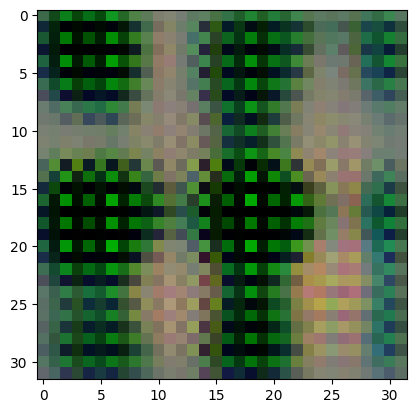

2/2 [==============================] - 0s 7ms/step
>1, 66/390, d1=0.696, d2=0.199 g=2.094


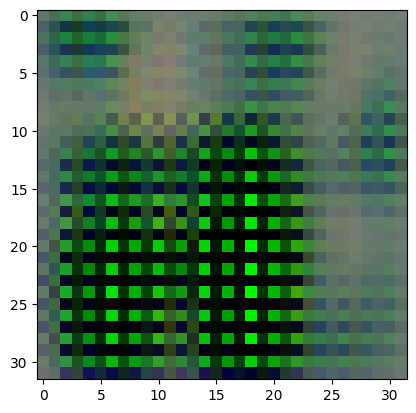

2/2 [==============================] - 0s 7ms/step
>1, 67/390, d1=0.338, d2=0.340 g=2.095


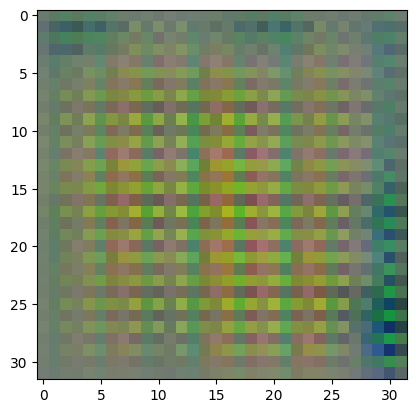

2/2 [==============================] - 0s 8ms/step
>1, 68/390, d1=0.243, d2=0.155 g=2.515


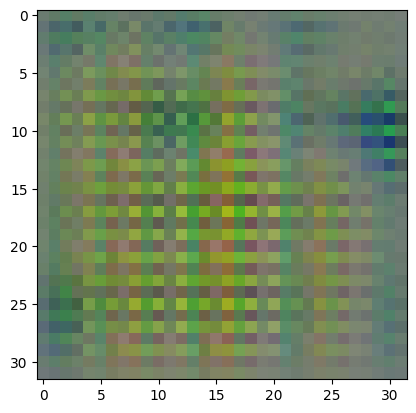

2/2 [==============================] - 0s 7ms/step
>1, 69/390, d1=0.355, d2=0.131 g=2.343


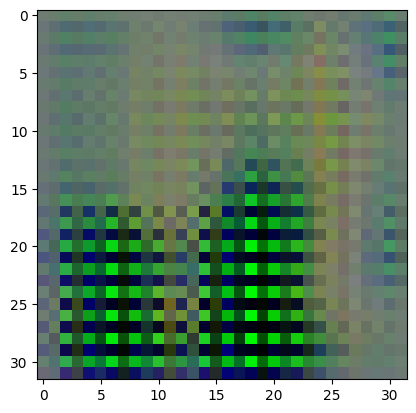

2/2 [==============================] - 0s 6ms/step
>1, 70/390, d1=0.241, d2=0.149 g=2.243


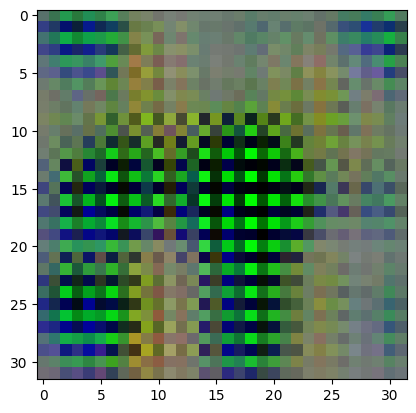

2/2 [==============================] - 0s 6ms/step
>1, 71/390, d1=0.243, d2=0.167 g=2.158


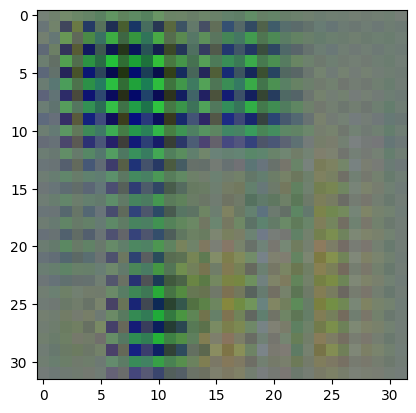

2/2 [==============================] - 0s 7ms/step
>1, 72/390, d1=0.104, d2=0.152 g=2.304


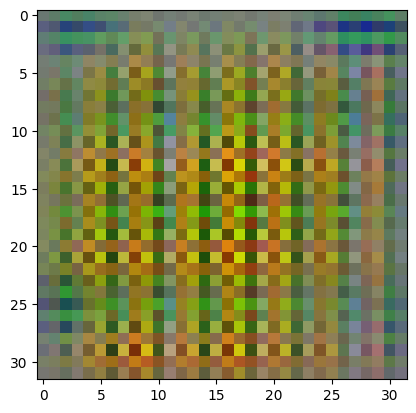

2/2 [==============================] - 0s 7ms/step
>1, 73/390, d1=0.219, d2=0.184 g=2.189


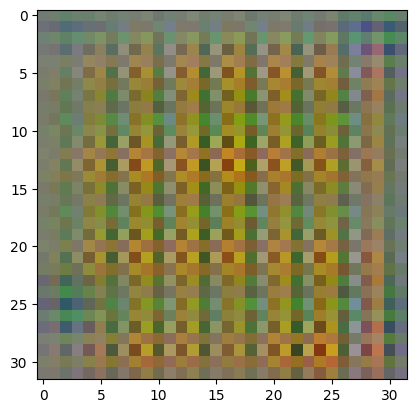

2/2 [==============================] - 0s 7ms/step
>1, 74/390, d1=0.109, d2=0.203 g=2.659


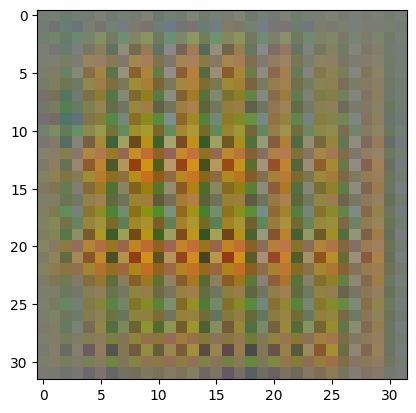

2/2 [==============================] - 0s 7ms/step
>1, 75/390, d1=0.237, d2=0.117 g=2.819


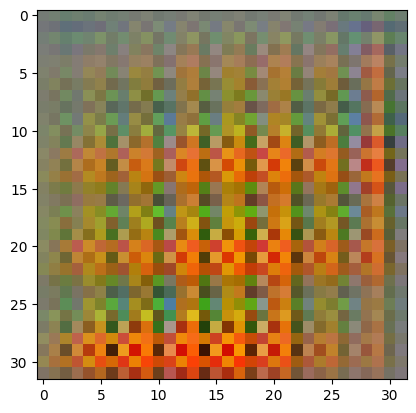

2/2 [==============================] - 0s 7ms/step
>1, 76/390, d1=0.209, d2=0.141 g=2.481


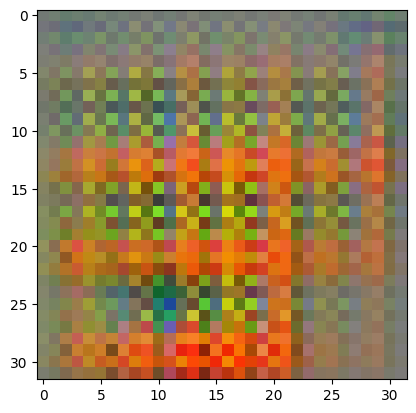

2/2 [==============================] - 0s 6ms/step
>1, 77/390, d1=0.104, d2=0.180 g=2.598


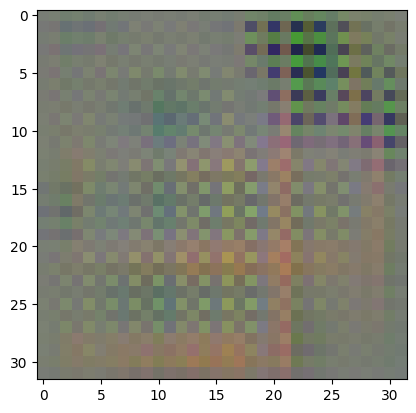

2/2 [==============================] - 0s 6ms/step
>1, 78/390, d1=0.160, d2=0.352 g=2.911


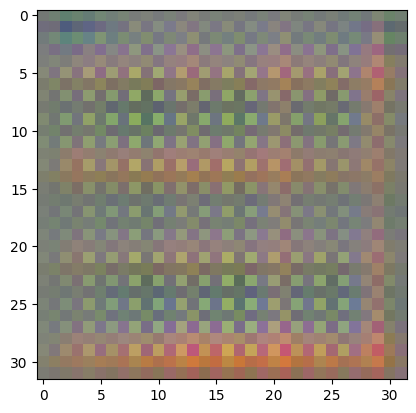

2/2 [==============================] - 0s 6ms/step
>1, 79/390, d1=0.340, d2=1.309 g=4.073


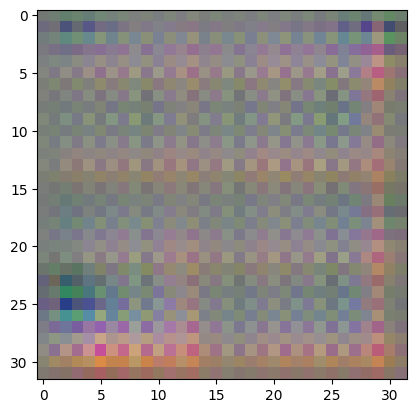

2/2 [==============================] - 0s 7ms/step
>1, 80/390, d1=0.397, d2=0.072 g=3.977


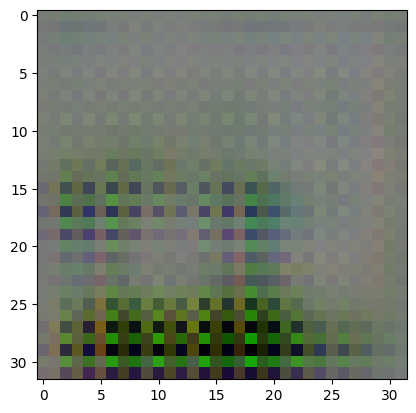

2/2 [==============================] - 0s 6ms/step
>1, 81/390, d1=0.523, d2=0.162 g=2.926


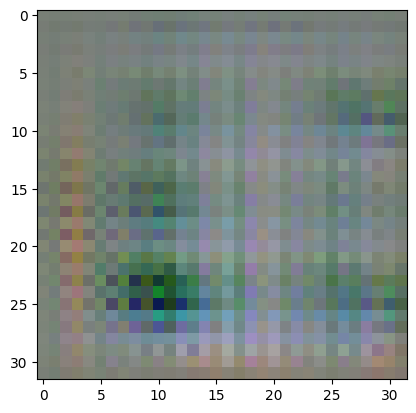

2/2 [==============================] - 0s 7ms/step
>1, 82/390, d1=0.164, d2=0.356 g=2.711


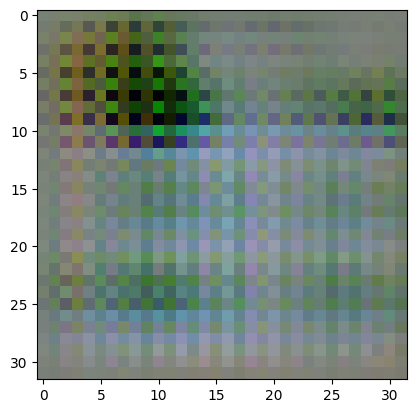

2/2 [==============================] - 0s 6ms/step
>1, 83/390, d1=0.253, d2=0.862 g=3.604


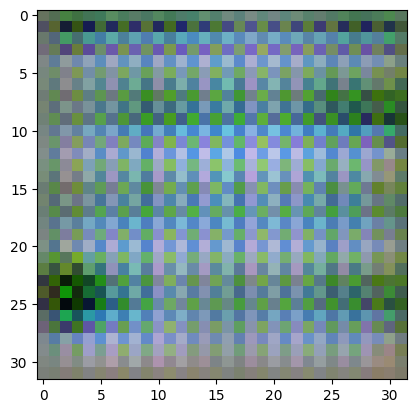

2/2 [==============================] - 0s 13ms/step
>1, 84/390, d1=0.452, d2=0.366 g=2.623


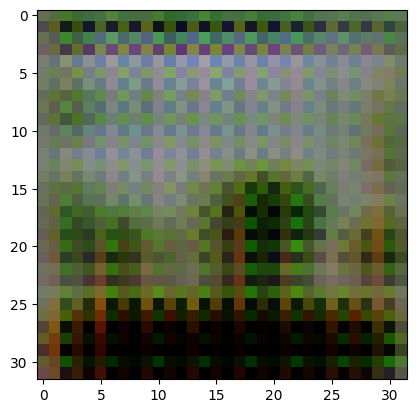

2/2 [==============================] - 0s 8ms/step
>1, 85/390, d1=0.661, d2=0.490 g=2.351


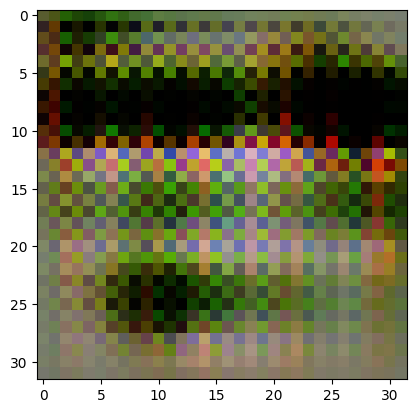

2/2 [==============================] - 0s 6ms/step
>1, 86/390, d1=0.548, d2=0.156 g=2.993


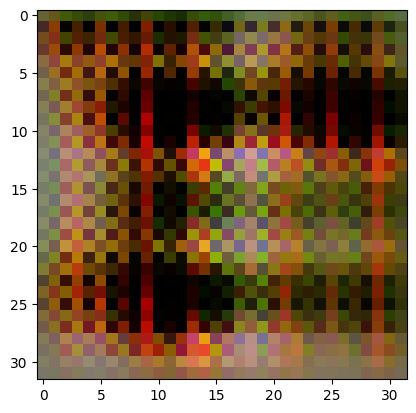

2/2 [==============================] - 0s 6ms/step
>1, 87/390, d1=0.356, d2=0.172 g=3.037


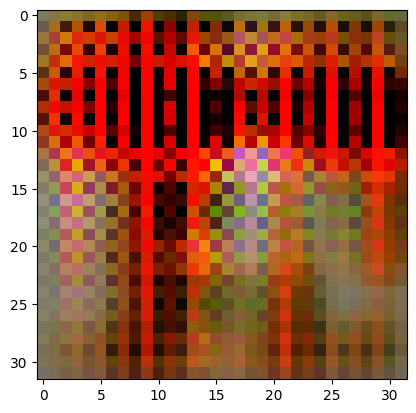

2/2 [==============================] - 0s 7ms/step
>1, 88/390, d1=0.416, d2=0.114 g=3.244


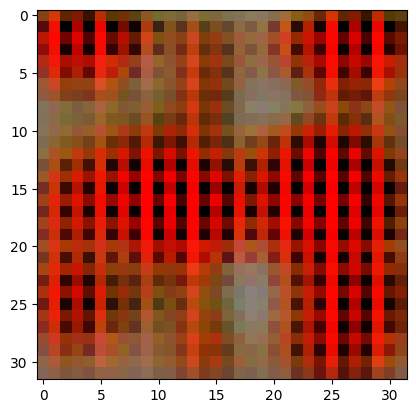

2/2 [==============================] - 0s 7ms/step
>1, 89/390, d1=0.187, d2=0.127 g=3.576


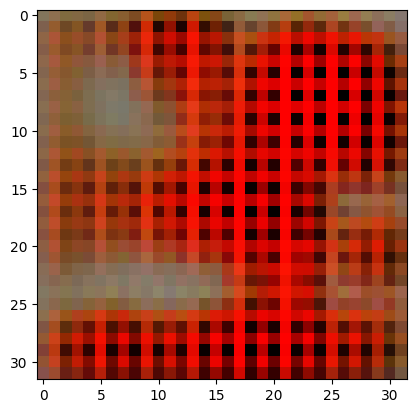

2/2 [==============================] - 0s 7ms/step
>1, 90/390, d1=0.310, d2=0.403 g=4.250


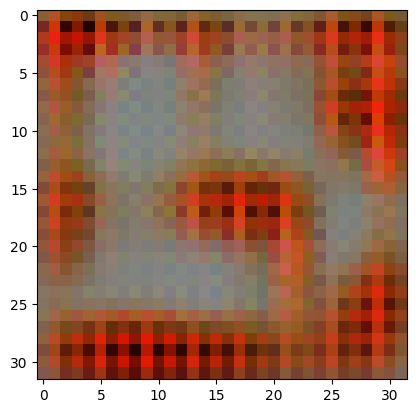

2/2 [==============================] - 0s 7ms/step
>1, 91/390, d1=0.380, d2=0.617 g=5.693


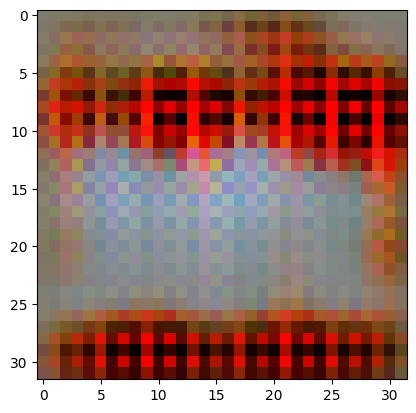

2/2 [==============================] - 0s 7ms/step
>1, 92/390, d1=0.443, d2=0.074 g=3.612


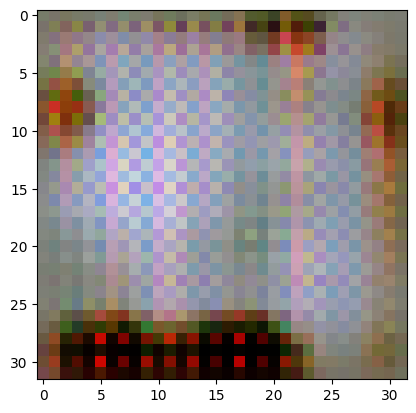

2/2 [==============================] - 0s 7ms/step
>1, 93/390, d1=0.577, d2=0.270 g=2.051


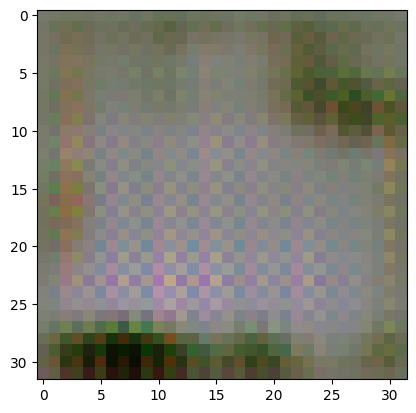

2/2 [==============================] - 0s 7ms/step
>1, 94/390, d1=0.563, d2=0.385 g=1.799


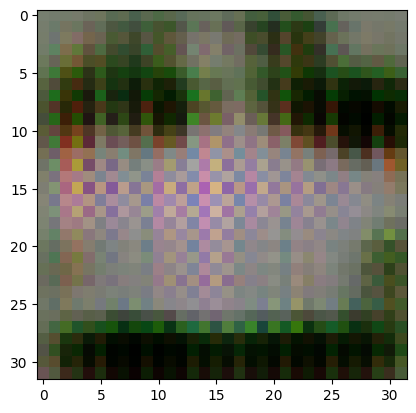

2/2 [==============================] - 0s 6ms/step
>1, 95/390, d1=0.444, d2=0.313 g=1.783


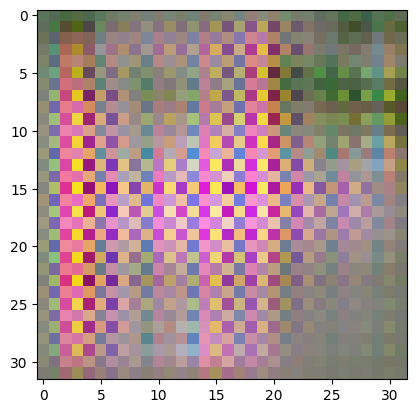

2/2 [==============================] - 0s 6ms/step
>1, 96/390, d1=0.472, d2=0.358 g=1.812


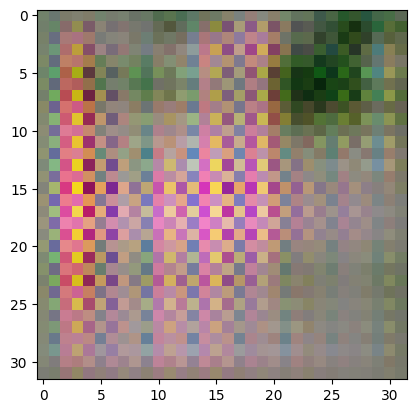

2/2 [==============================] - 0s 6ms/step
>1, 97/390, d1=0.312, d2=0.392 g=1.688


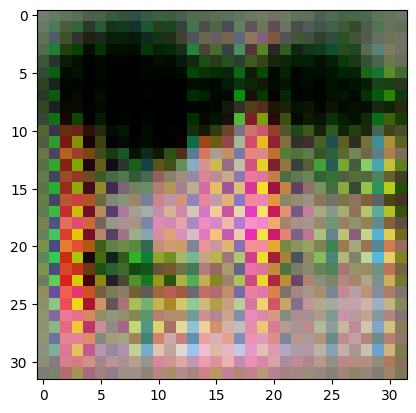

2/2 [==============================] - 0s 9ms/step
>1, 98/390, d1=0.344, d2=0.573 g=1.797


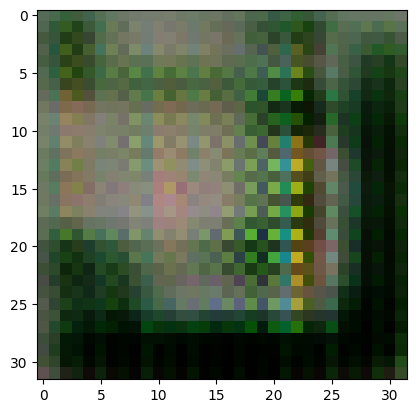

2/2 [==============================] - 0s 7ms/step
>1, 99/390, d1=0.444, d2=0.449 g=1.698


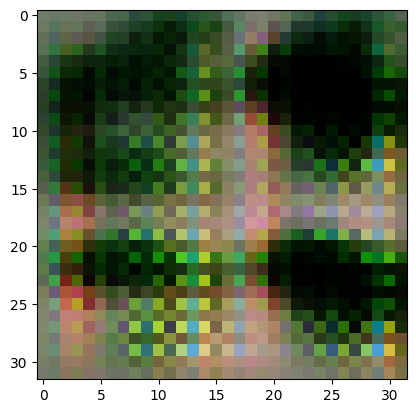

2/2 [==============================] - 0s 7ms/step
>1, 100/390, d1=0.530, d2=0.374 g=1.795


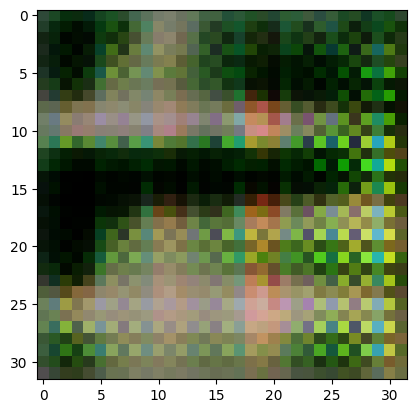

2/2 [==============================] - 0s 7ms/step
>1, 101/390, d1=0.437, d2=0.291 g=2.017


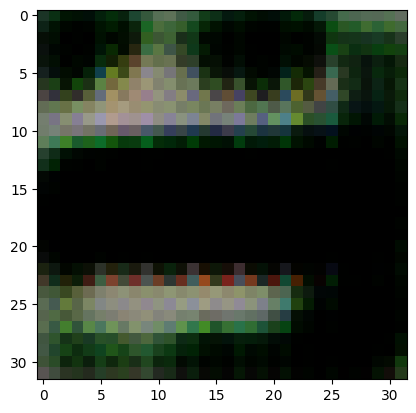

2/2 [==============================] - 0s 7ms/step
>1, 102/390, d1=0.561, d2=0.334 g=2.590


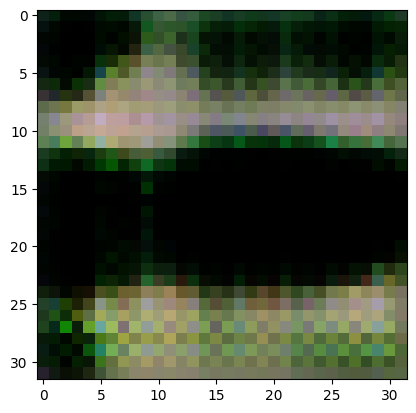

2/2 [==============================] - 0s 7ms/step
>1, 103/390, d1=0.569, d2=0.234 g=3.314


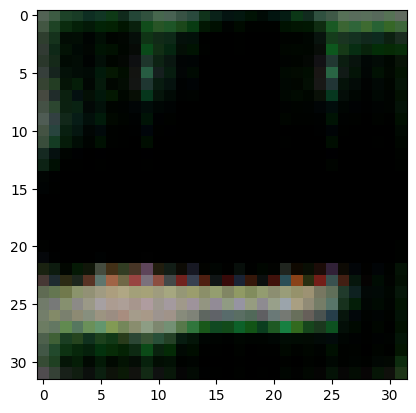

2/2 [==============================] - 0s 6ms/step
>1, 104/390, d1=0.536, d2=0.259 g=3.432


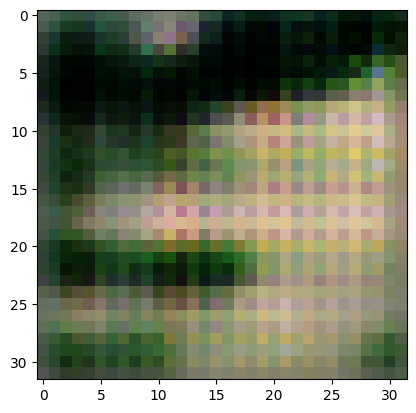

2/2 [==============================] - 0s 10ms/step
>1, 105/390, d1=0.586, d2=0.211 g=3.105


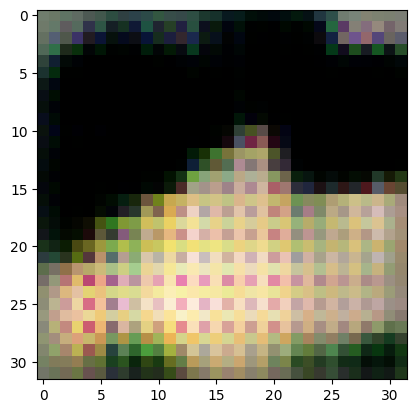

2/2 [==============================] - 0s 6ms/step
>1, 106/390, d1=0.542, d2=0.311 g=2.347


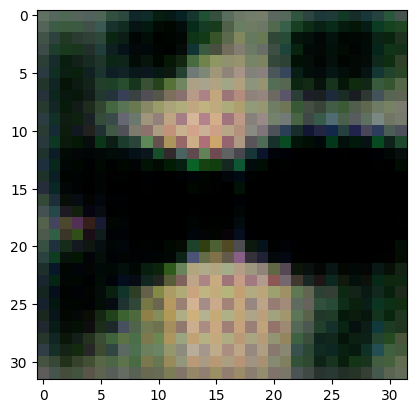

2/2 [==============================] - 0s 7ms/step
>1, 107/390, d1=0.691, d2=0.338 g=2.001


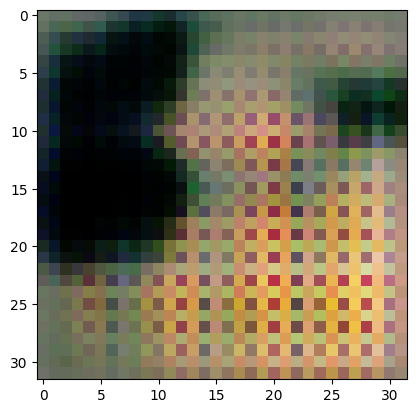

2/2 [==============================] - 0s 6ms/step
>1, 108/390, d1=0.385, d2=0.283 g=2.175


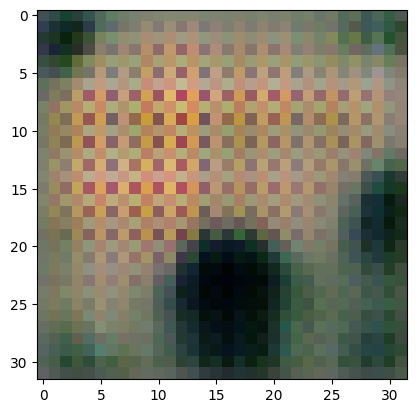

2/2 [==============================] - 0s 7ms/step
>1, 109/390, d1=0.446, d2=0.298 g=1.934


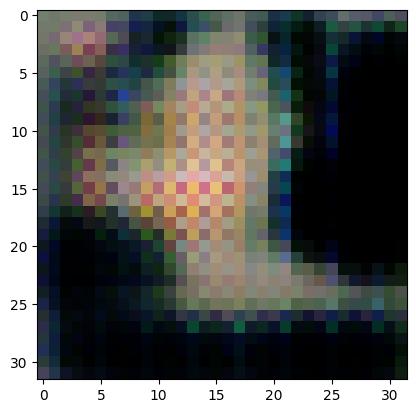

2/2 [==============================] - 0s 7ms/step
>1, 110/390, d1=0.560, d2=0.670 g=2.111


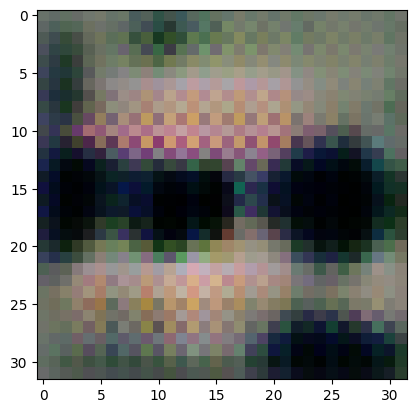

2/2 [==============================] - 0s 7ms/step
>1, 111/390, d1=0.606, d2=0.353 g=1.807


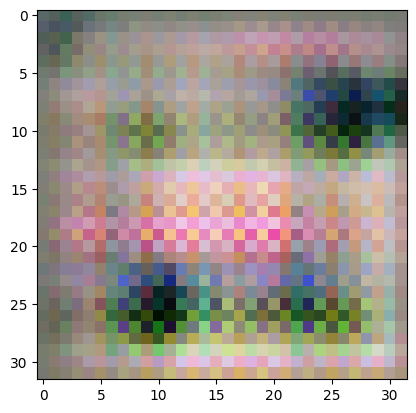

2/2 [==============================] - 0s 8ms/step
>1, 112/390, d1=0.516, d2=0.369 g=1.704


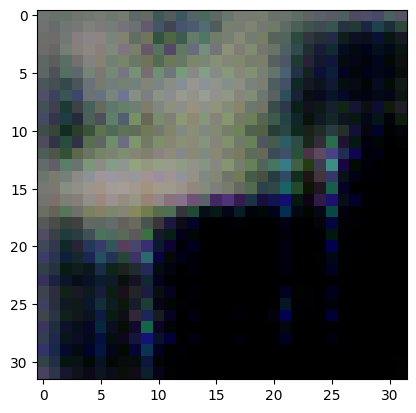

2/2 [==============================] - 0s 10ms/step
>1, 113/390, d1=0.519, d2=0.411 g=1.714


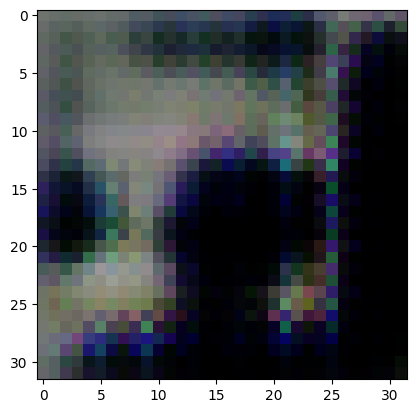

2/2 [==============================] - 0s 8ms/step
>1, 114/390, d1=0.437, d2=0.413 g=1.779


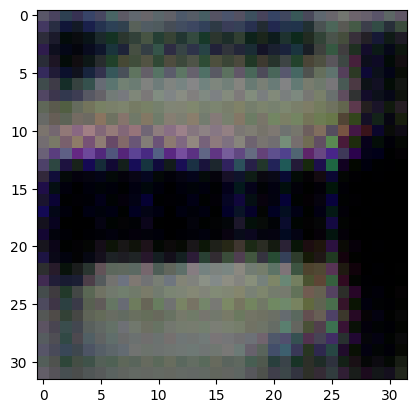

2/2 [==============================] - 0s 6ms/step
>1, 115/390, d1=0.336, d2=0.397 g=2.106


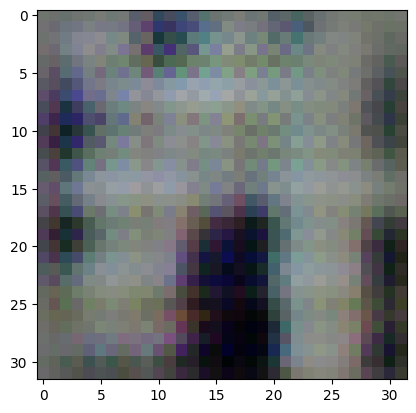

2/2 [==============================] - 0s 6ms/step
>1, 116/390, d1=0.395, d2=0.440 g=2.909


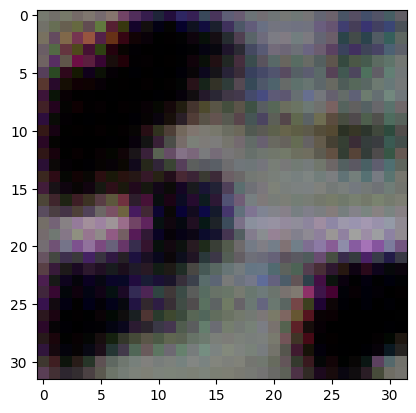

2/2 [==============================] - 0s 7ms/step
>1, 117/390, d1=0.765, d2=0.333 g=1.918


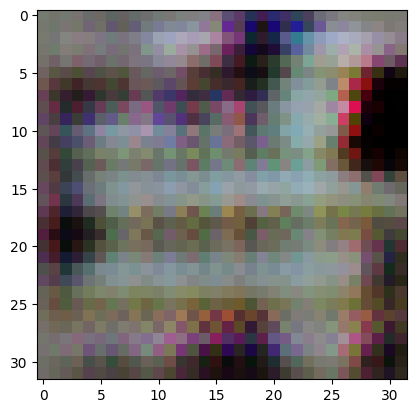

2/2 [==============================] - 0s 6ms/step
>1, 118/390, d1=0.587, d2=0.674 g=1.987


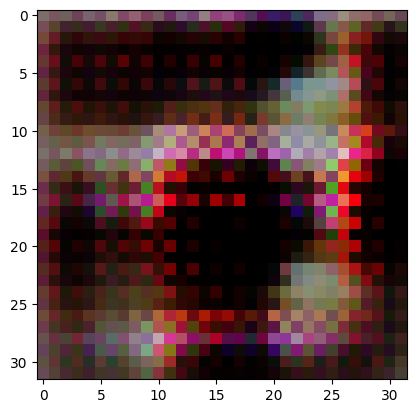

2/2 [==============================] - 0s 8ms/step
>1, 119/390, d1=0.625, d2=0.307 g=1.849


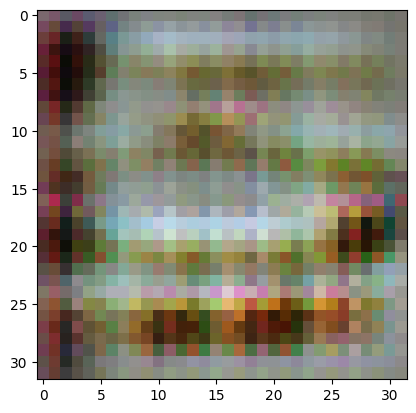

2/2 [==============================] - 0s 7ms/step
>1, 120/390, d1=0.546, d2=0.374 g=1.601


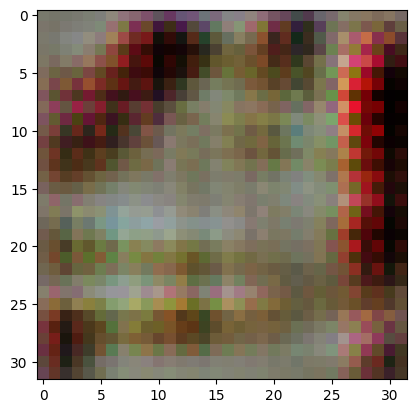

2/2 [==============================] - 0s 6ms/step
>1, 121/390, d1=0.548, d2=0.365 g=1.720


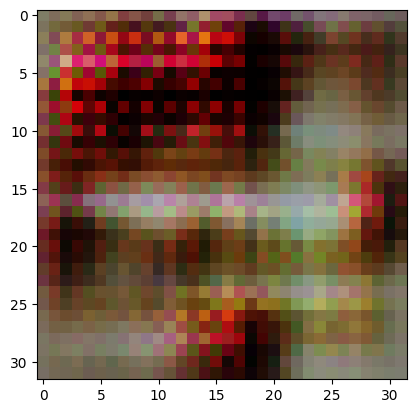

2/2 [==============================] - 0s 6ms/step
>1, 122/390, d1=0.330, d2=0.342 g=2.268


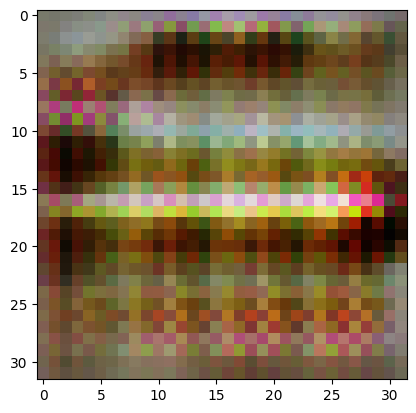

2/2 [==============================] - 0s 7ms/step
>1, 123/390, d1=0.348, d2=0.218 g=2.795


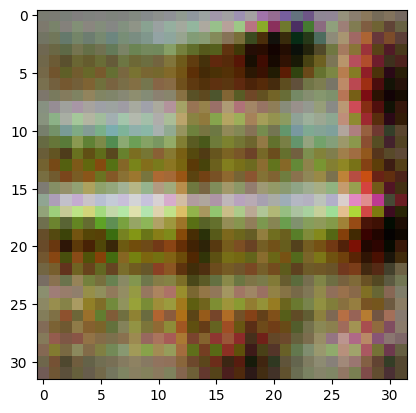

2/2 [==============================] - 0s 9ms/step
>1, 124/390, d1=0.423, d2=0.318 g=3.004


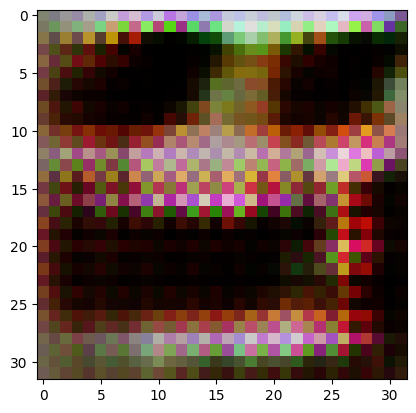

2/2 [==============================] - 0s 10ms/step
>1, 125/390, d1=0.393, d2=0.177 g=2.733


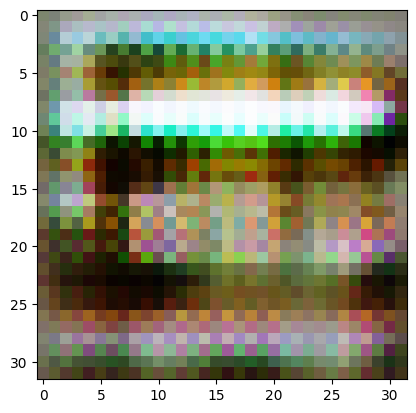

2/2 [==============================] - 0s 7ms/step
>1, 126/390, d1=0.424, d2=0.924 g=3.897


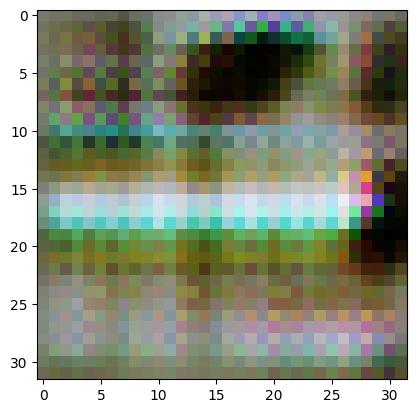

2/2 [==============================] - 0s 6ms/step
>1, 127/390, d1=0.880, d2=0.263 g=2.404


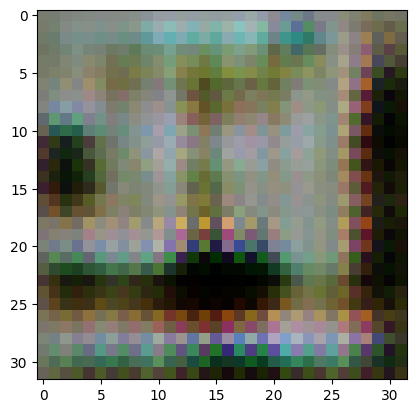

2/2 [==============================] - 0s 11ms/step
>1, 128/390, d1=0.583, d2=0.714 g=1.727


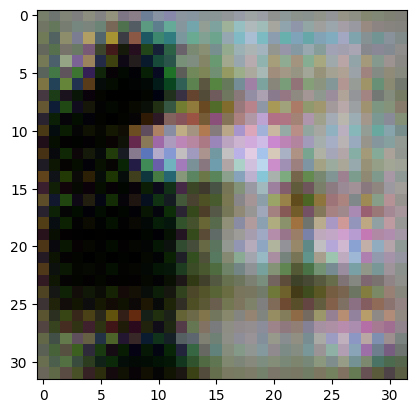

2/2 [==============================] - 0s 14ms/step
>1, 129/390, d1=0.480, d2=0.541 g=1.777


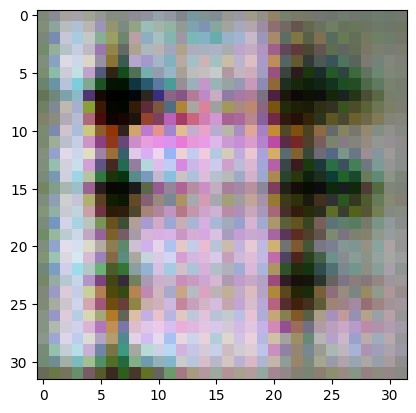

2/2 [==============================] - 0s 7ms/step
>1, 130/390, d1=0.589, d2=0.462 g=1.774


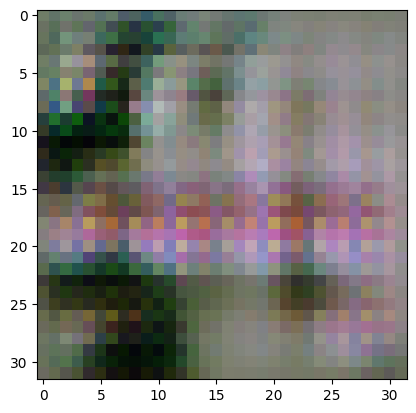

2/2 [==============================] - 0s 8ms/step
>1, 131/390, d1=0.544, d2=0.579 g=1.696


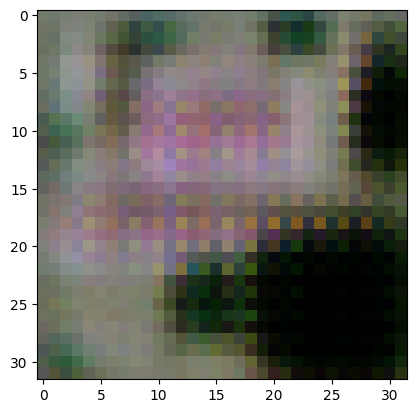

2/2 [==============================] - 0s 7ms/step
>1, 132/390, d1=0.581, d2=0.562 g=1.844


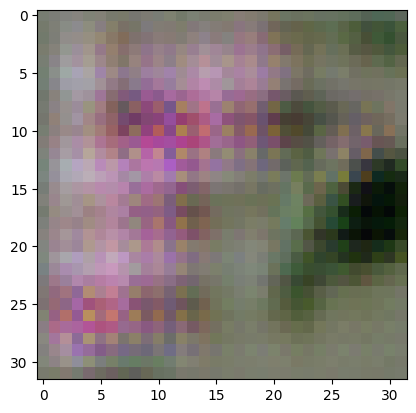

2/2 [==============================] - 0s 7ms/step
>1, 133/390, d1=0.517, d2=0.471 g=1.988


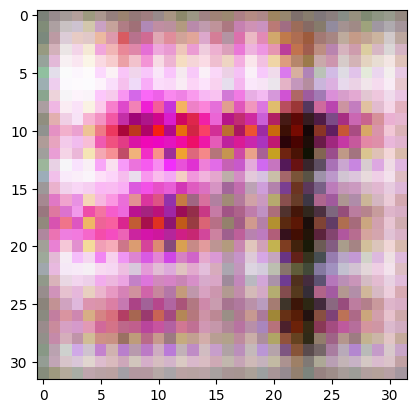

2/2 [==============================] - 0s 7ms/step
>1, 134/390, d1=0.549, d2=0.583 g=1.802


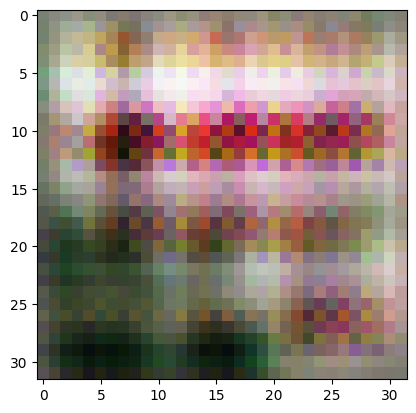

2/2 [==============================] - 0s 6ms/step
>1, 135/390, d1=0.730, d2=0.661 g=1.786


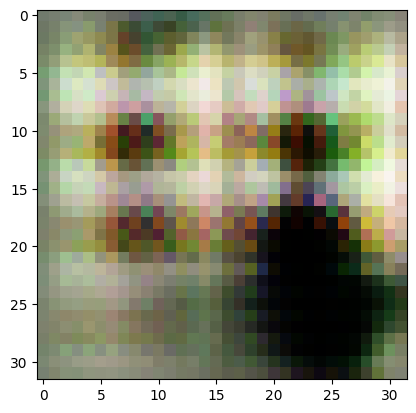

2/2 [==============================] - 0s 11ms/step
>1, 136/390, d1=0.543, d2=0.335 g=2.130


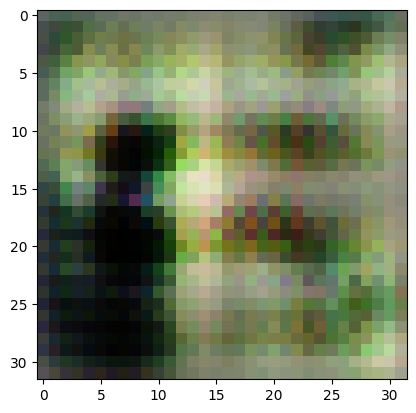

2/2 [==============================] - 0s 7ms/step
>1, 137/390, d1=0.511, d2=0.286 g=1.942


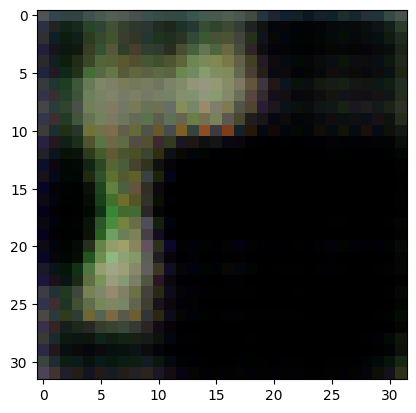

2/2 [==============================] - 0s 7ms/step
>1, 138/390, d1=0.518, d2=0.354 g=1.984


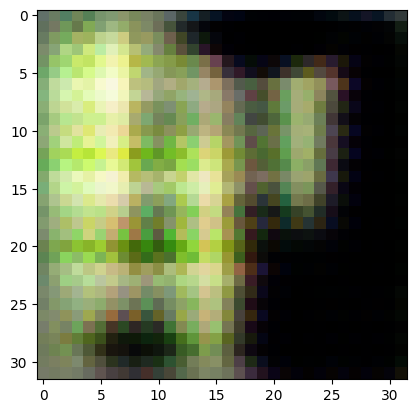

2/2 [==============================] - 0s 10ms/step
>1, 139/390, d1=0.426, d2=0.378 g=2.153


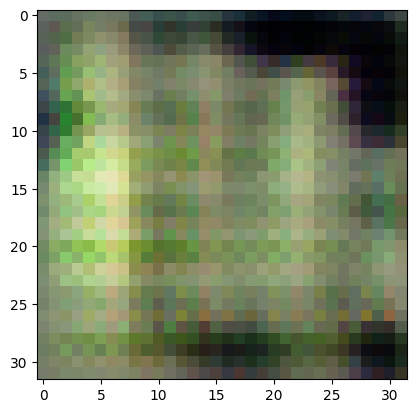

2/2 [==============================] - 0s 7ms/step
>1, 140/390, d1=0.475, d2=0.331 g=2.076


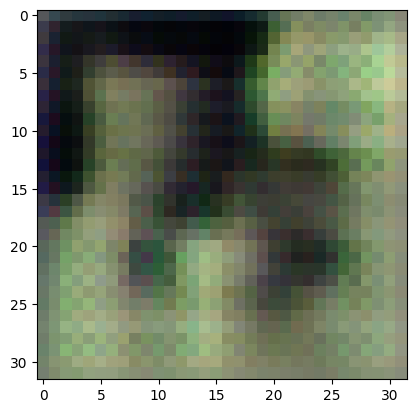

2/2 [==============================] - 0s 7ms/step
>1, 141/390, d1=0.410, d2=0.296 g=1.941


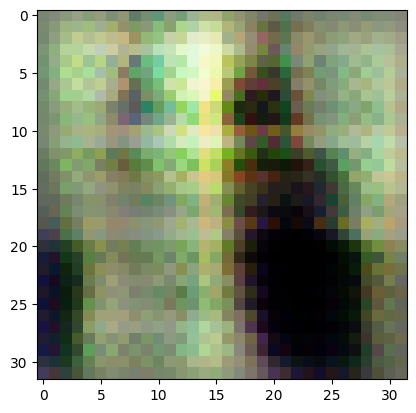

2/2 [==============================] - 0s 7ms/step
>1, 142/390, d1=0.408, d2=0.396 g=1.821


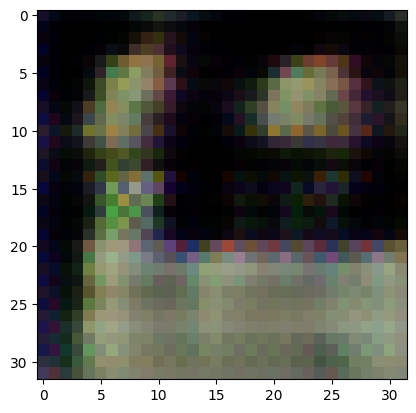

2/2 [==============================] - 0s 7ms/step
>1, 143/390, d1=0.389, d2=0.618 g=1.822


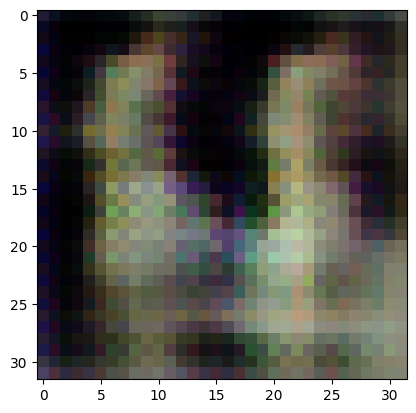

2/2 [==============================] - 0s 6ms/step
>1, 144/390, d1=0.364, d2=0.677 g=3.050


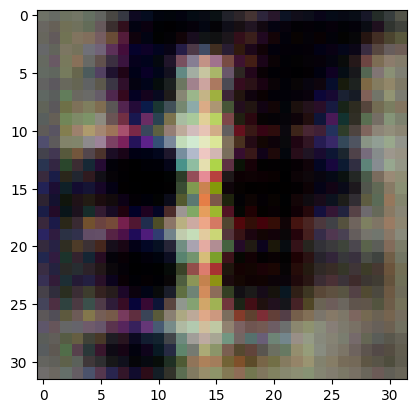

2/2 [==============================] - 0s 7ms/step
>1, 145/390, d1=0.810, d2=0.919 g=2.081


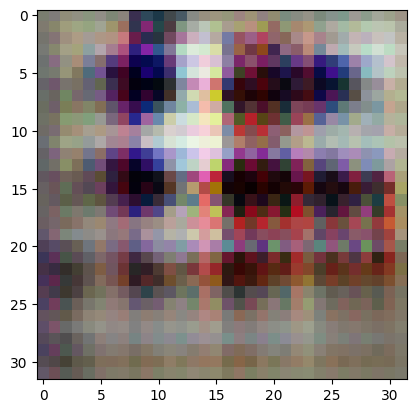

2/2 [==============================] - 0s 6ms/step
>1, 146/390, d1=0.589, d2=0.737 g=2.918


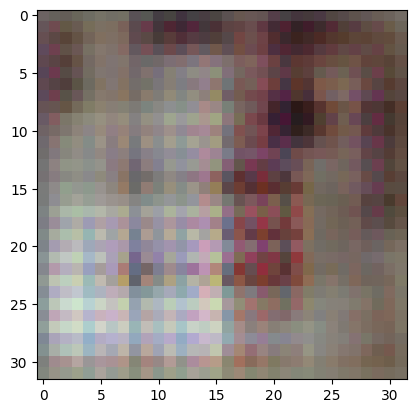

2/2 [==============================] - 0s 7ms/step
>1, 147/390, d1=1.384, d2=0.339 g=1.762


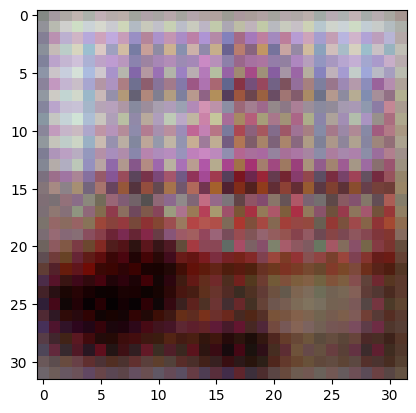

2/2 [==============================] - 0s 6ms/step
>1, 148/390, d1=0.628, d2=0.741 g=1.668


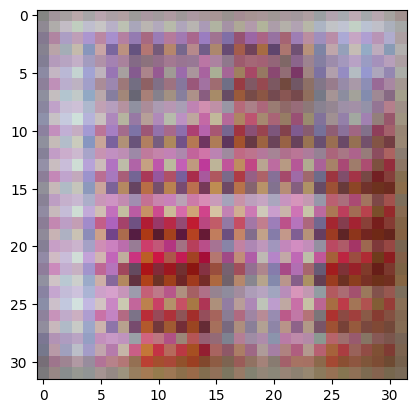

2/2 [==============================] - 0s 7ms/step
>1, 149/390, d1=0.749, d2=0.388 g=1.785


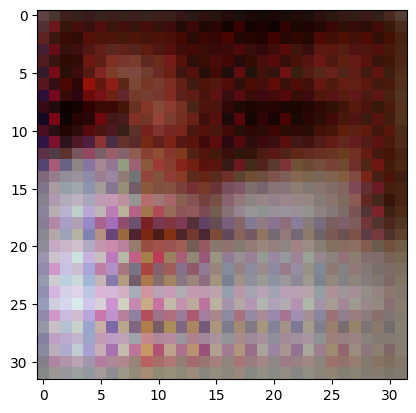

2/2 [==============================] - 0s 9ms/step
>1, 150/390, d1=0.650, d2=0.550 g=1.535


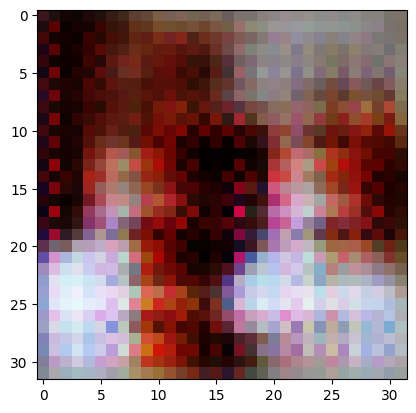

2/2 [==============================] - 0s 10ms/step
>1, 151/390, d1=0.564, d2=0.722 g=1.679


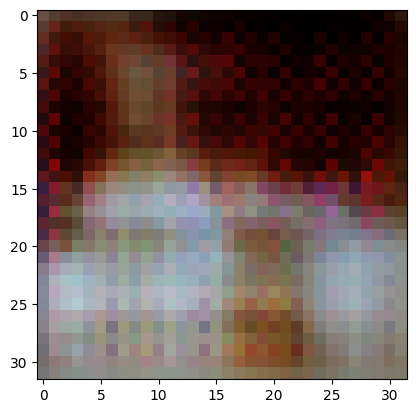

2/2 [==============================] - 0s 6ms/step
>1, 152/390, d1=0.949, d2=0.411 g=1.461


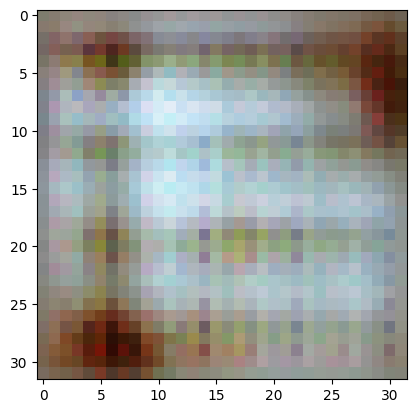

2/2 [==============================] - 0s 7ms/step
>1, 153/390, d1=0.668, d2=0.486 g=1.293


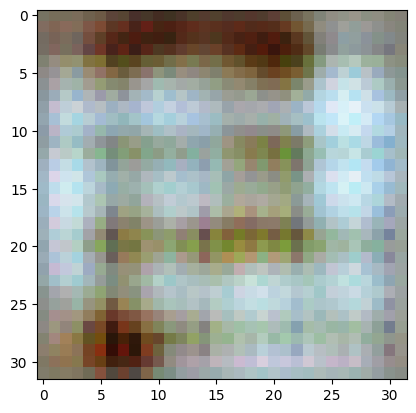

2/2 [==============================] - 0s 8ms/step
>1, 154/390, d1=0.618, d2=0.653 g=1.208


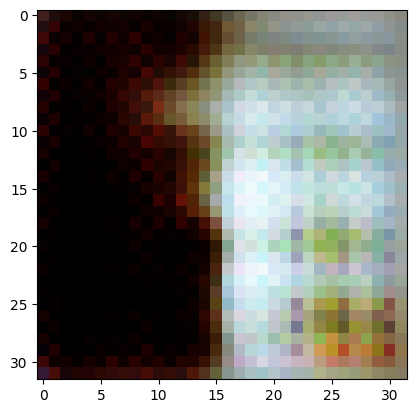

2/2 [==============================] - 0s 6ms/step
>1, 155/390, d1=0.603, d2=0.561 g=1.316


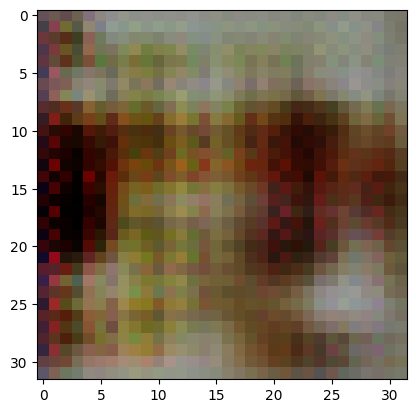

2/2 [==============================] - 0s 7ms/step
>1, 156/390, d1=0.554, d2=0.417 g=1.478


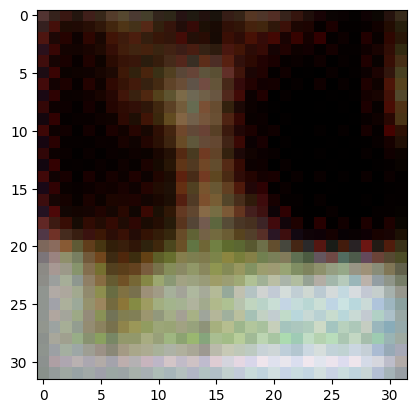

2/2 [==============================] - 0s 7ms/step
>1, 157/390, d1=0.685, d2=0.453 g=1.604


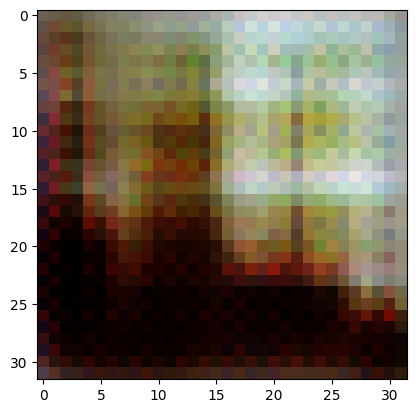

2/2 [==============================] - 0s 7ms/step
>1, 158/390, d1=0.494, d2=0.370 g=1.755


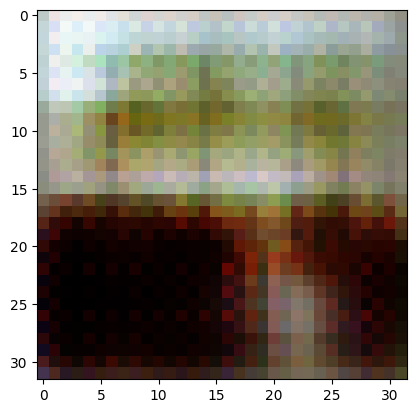

2/2 [==============================] - 0s 7ms/step
>1, 159/390, d1=0.618, d2=0.400 g=1.750


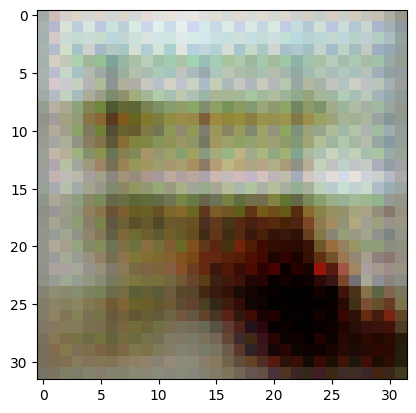

2/2 [==============================] - 0s 6ms/step
>1, 160/390, d1=0.528, d2=0.462 g=1.700


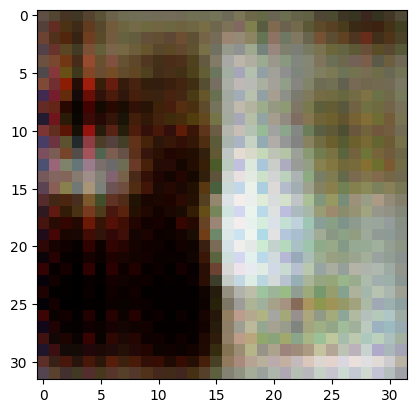

2/2 [==============================] - 0s 6ms/step
>1, 161/390, d1=0.553, d2=0.467 g=1.585


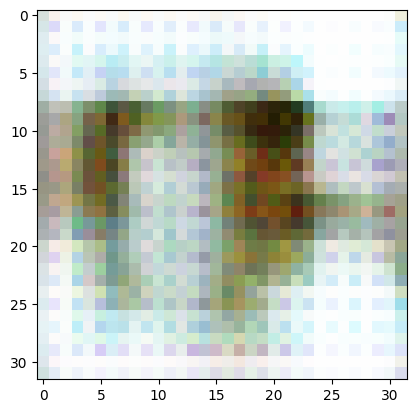

2/2 [==============================] - 0s 7ms/step
>1, 162/390, d1=0.507, d2=0.452 g=1.573


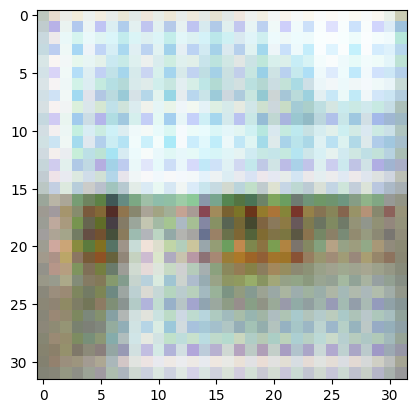

2/2 [==============================] - 0s 8ms/step
>1, 163/390, d1=0.356, d2=0.854 g=2.232


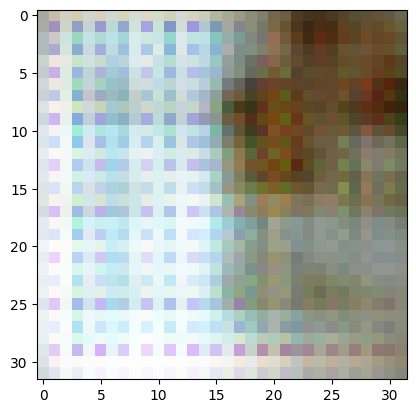

2/2 [==============================] - 0s 7ms/step
>1, 164/390, d1=0.753, d2=2.297 g=3.385


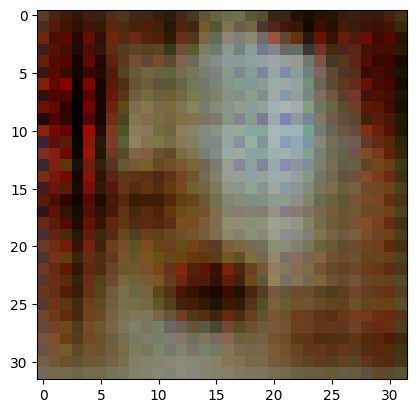

2/2 [==============================] - 0s 9ms/step
>1, 165/390, d1=1.288, d2=0.290 g=1.692


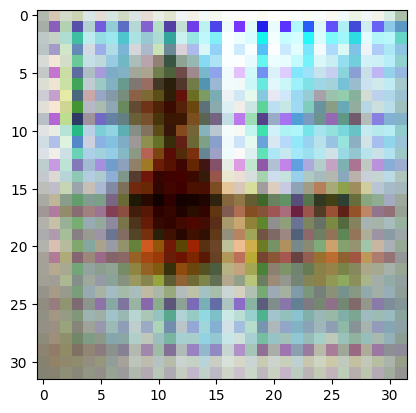

2/2 [==============================] - 0s 9ms/step
>1, 166/390, d1=0.692, d2=0.837 g=1.713


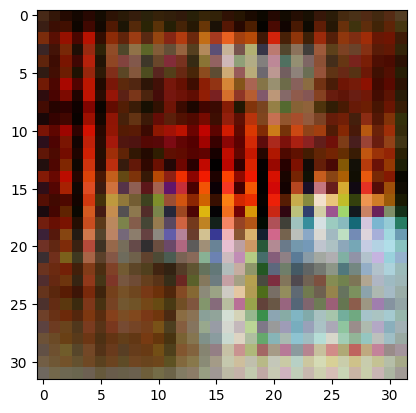

2/2 [==============================] - 0s 10ms/step
>1, 167/390, d1=0.681, d2=0.350 g=1.972


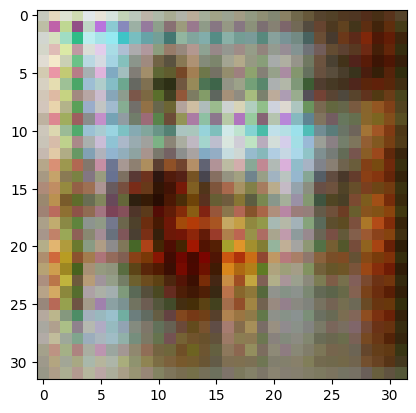

2/2 [==============================] - 0s 7ms/step
>1, 168/390, d1=0.718, d2=0.433 g=1.777


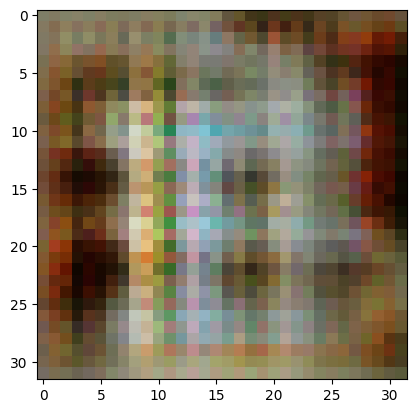

2/2 [==============================] - 0s 10ms/step
>1, 169/390, d1=0.662, d2=0.505 g=1.367


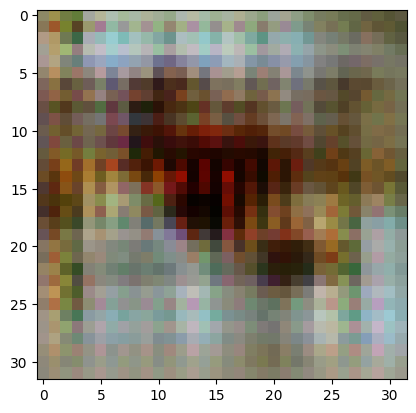

2/2 [==============================] - 0s 7ms/step
>1, 170/390, d1=0.523, d2=0.799 g=1.345


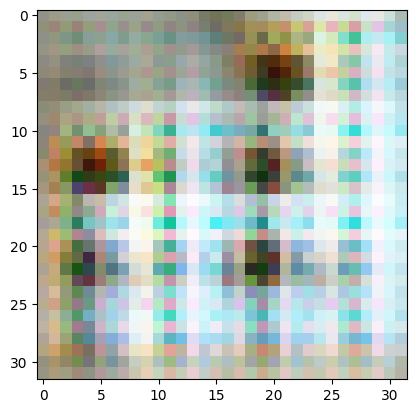

2/2 [==============================] - 0s 6ms/step
>1, 171/390, d1=0.698, d2=0.752 g=2.180


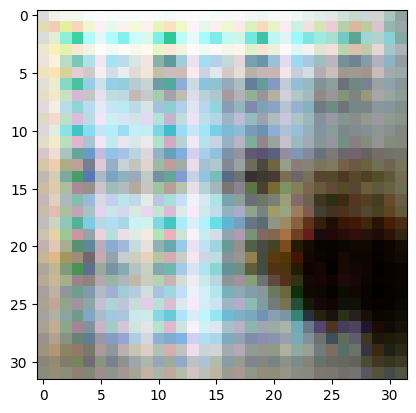

2/2 [==============================] - 0s 6ms/step
>1, 172/390, d1=0.899, d2=0.288 g=1.918


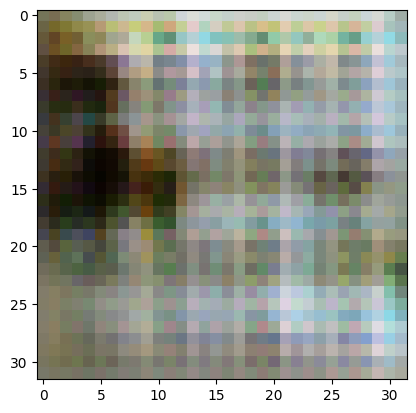

2/2 [==============================] - 0s 7ms/step
>1, 173/390, d1=0.539, d2=0.439 g=1.434


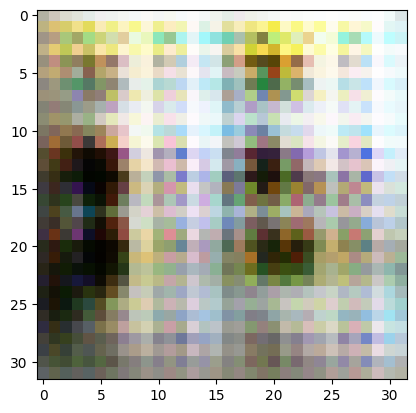

2/2 [==============================] - 0s 6ms/step
>1, 174/390, d1=0.504, d2=0.878 g=1.769


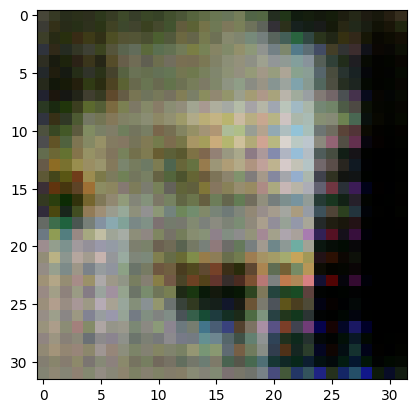

2/2 [==============================] - 0s 7ms/step
>1, 175/390, d1=0.576, d2=0.330 g=2.081


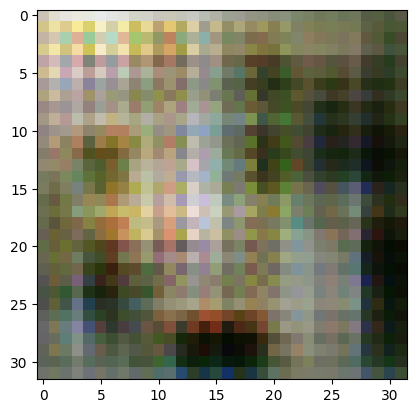

2/2 [==============================] - 0s 7ms/step
>1, 176/390, d1=0.660, d2=0.542 g=1.624


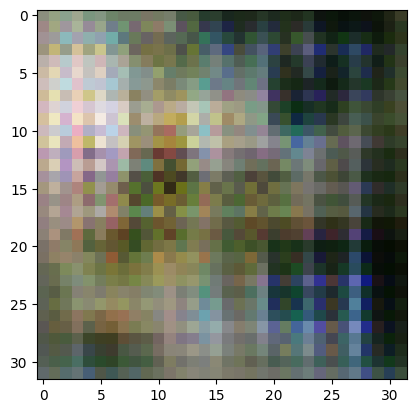

2/2 [==============================] - 0s 7ms/step
>1, 177/390, d1=0.603, d2=1.229 g=1.541


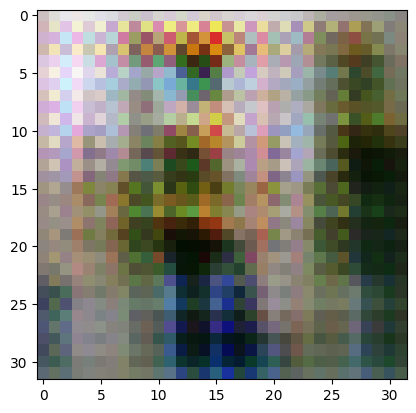

2/2 [==============================] - 0s 7ms/step
>1, 178/390, d1=0.756, d2=0.581 g=1.634


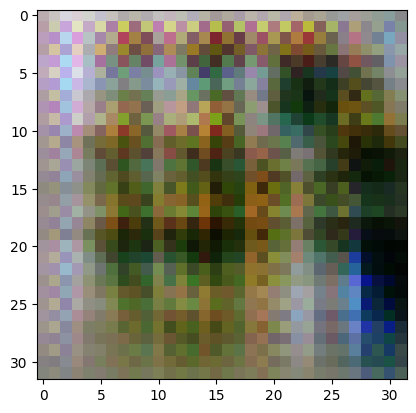

2/2 [==============================] - 0s 7ms/step
>1, 179/390, d1=0.849, d2=0.493 g=1.670


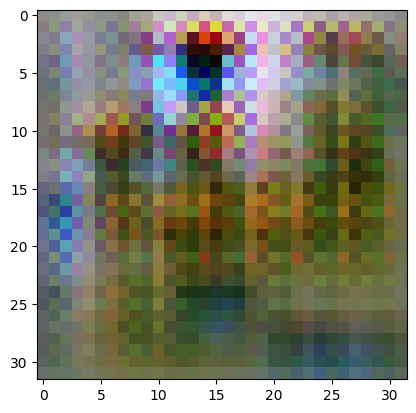

2/2 [==============================] - 0s 8ms/step
>1, 180/390, d1=0.607, d2=0.366 g=1.759


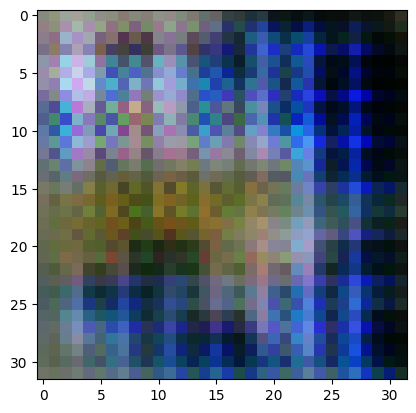

2/2 [==============================] - 0s 7ms/step
>1, 181/390, d1=0.651, d2=0.408 g=1.696


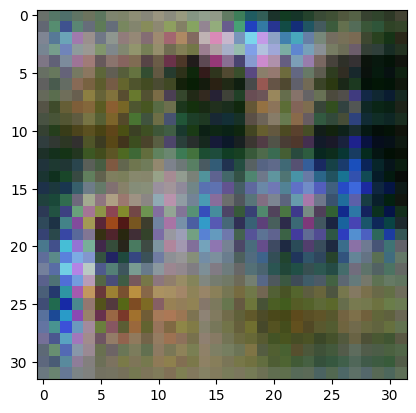

2/2 [==============================] - 0s 6ms/step
>1, 182/390, d1=0.600, d2=0.654 g=1.678


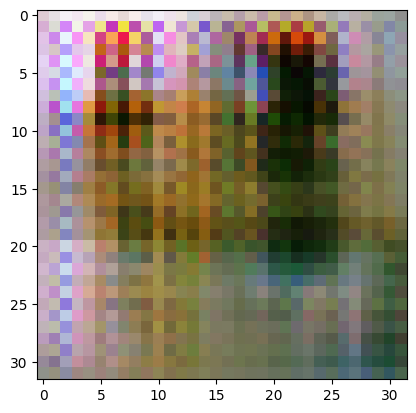

2/2 [==============================] - 0s 6ms/step
>1, 183/390, d1=0.593, d2=0.413 g=1.678


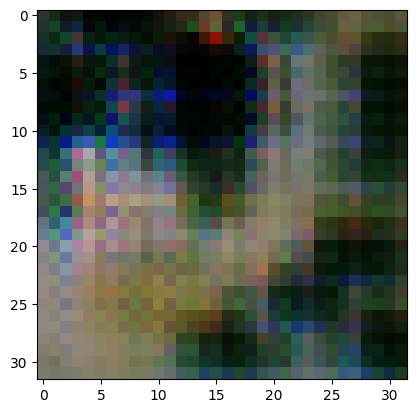

2/2 [==============================] - 0s 6ms/step
>1, 184/390, d1=0.651, d2=0.541 g=1.473


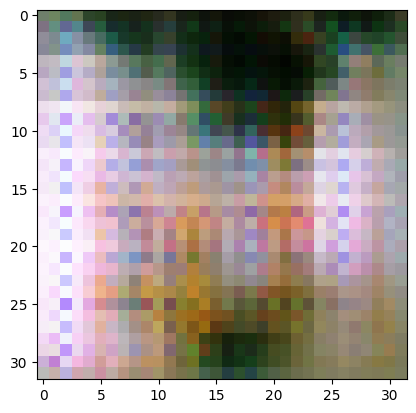

2/2 [==============================] - 0s 6ms/step
>1, 185/390, d1=0.634, d2=0.514 g=1.405


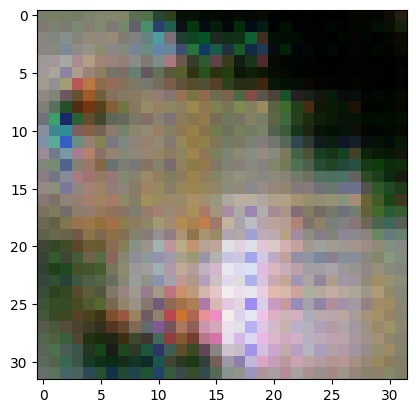

2/2 [==============================] - 0s 6ms/step
>1, 186/390, d1=0.576, d2=0.436 g=1.496


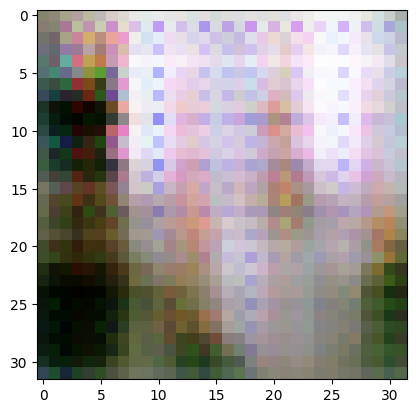

2/2 [==============================] - 0s 7ms/step
>1, 187/390, d1=0.501, d2=0.411 g=1.609


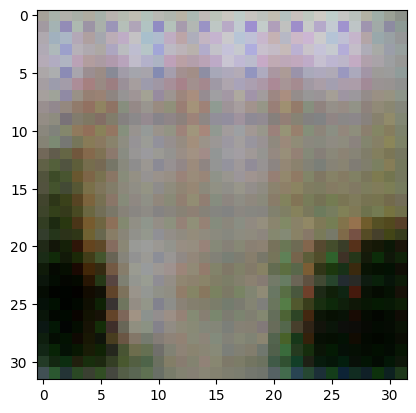

2/2 [==============================] - 0s 7ms/step
>1, 188/390, d1=0.470, d2=0.460 g=1.605


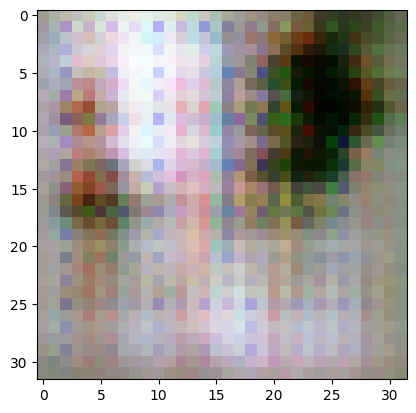

2/2 [==============================] - 0s 8ms/step
>1, 189/390, d1=0.581, d2=0.572 g=1.338


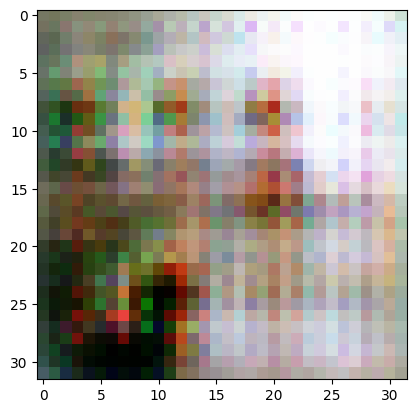

2/2 [==============================] - 0s 8ms/step
>1, 190/390, d1=0.383, d2=0.493 g=1.558


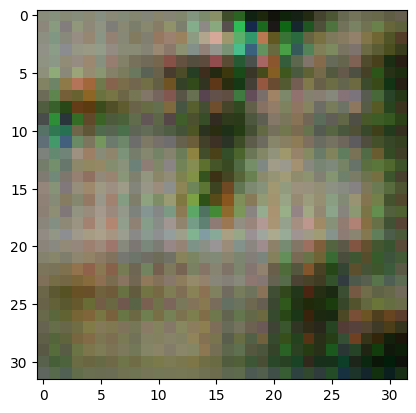

2/2 [==============================] - 0s 9ms/step
>1, 191/390, d1=0.356, d2=0.398 g=1.806


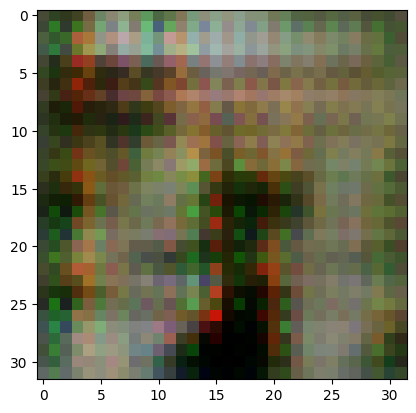

2/2 [==============================] - 0s 7ms/step
>1, 192/390, d1=0.463, d2=0.443 g=1.741


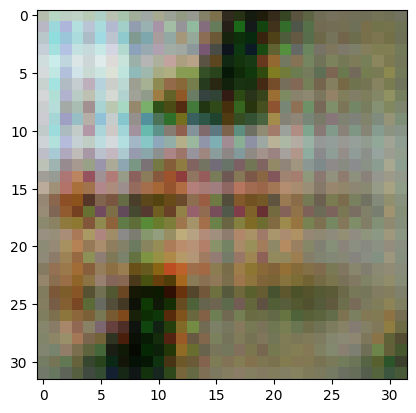

2/2 [==============================] - 0s 8ms/step
>1, 193/390, d1=0.484, d2=0.790 g=1.532


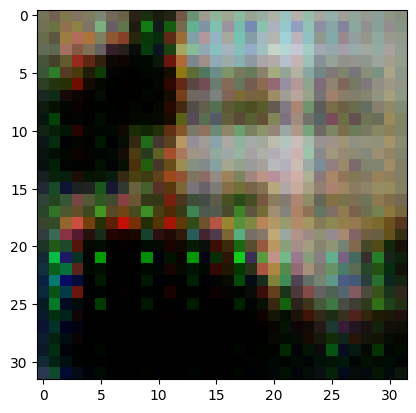

2/2 [==============================] - 0s 8ms/step
>1, 194/390, d1=0.605, d2=0.625 g=1.460


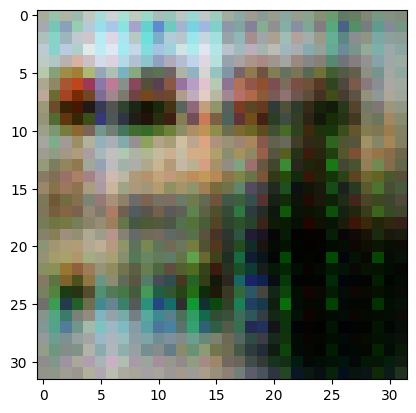

2/2 [==============================] - 0s 7ms/step
>1, 195/390, d1=0.386, d2=0.678 g=2.055


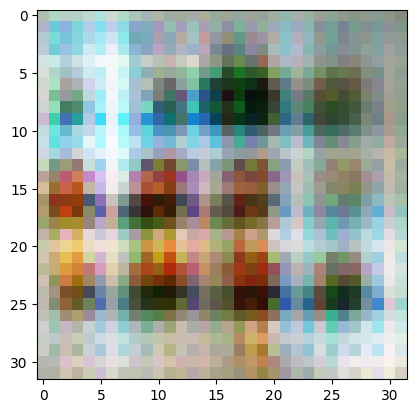

2/2 [==============================] - 0s 7ms/step
>1, 196/390, d1=0.632, d2=0.458 g=2.334


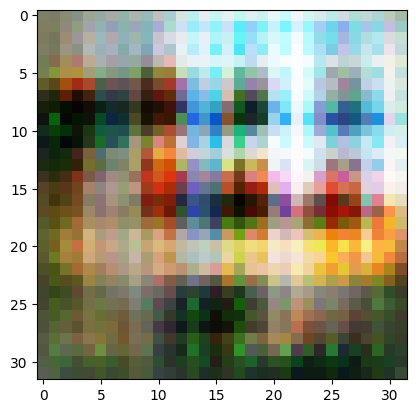

2/2 [==============================] - 0s 6ms/step
>1, 197/390, d1=0.680, d2=0.431 g=2.205


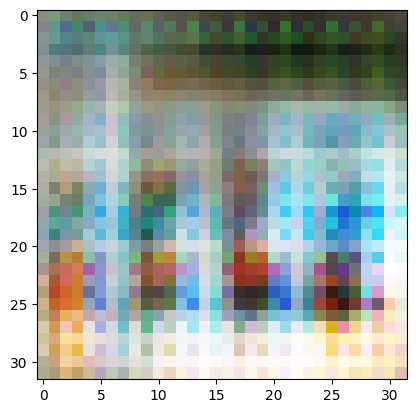

2/2 [==============================] - 0s 6ms/step
>1, 198/390, d1=0.531, d2=0.688 g=2.109


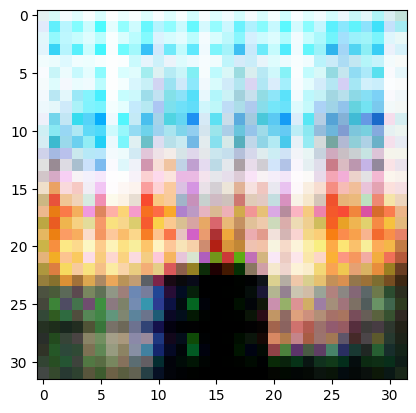

2/2 [==============================] - 0s 6ms/step
>1, 199/390, d1=0.608, d2=0.457 g=1.836


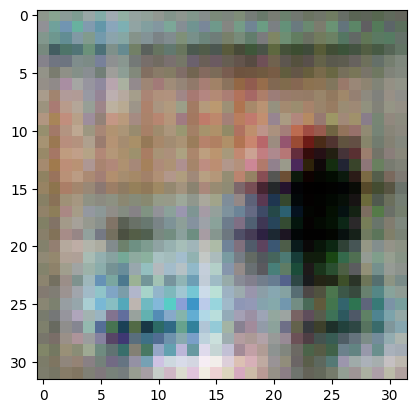

2/2 [==============================] - 0s 8ms/step
>1, 200/390, d1=0.681, d2=0.831 g=1.886


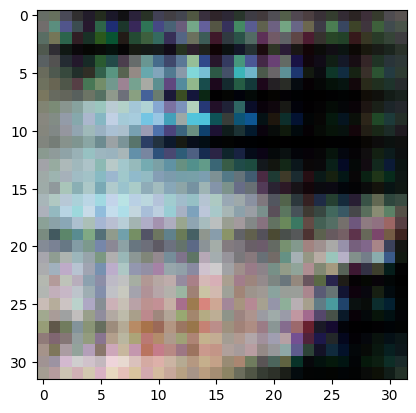

2/2 [==============================] - 0s 7ms/step
>1, 201/390, d1=0.749, d2=0.647 g=1.323


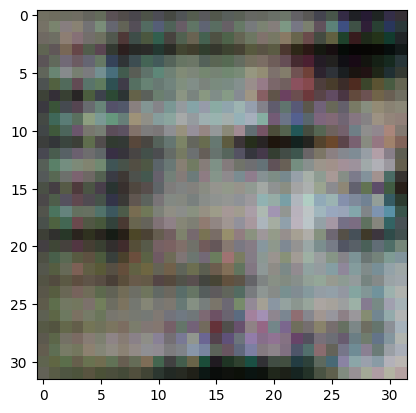

2/2 [==============================] - 0s 7ms/step
>1, 202/390, d1=0.463, d2=0.654 g=1.449


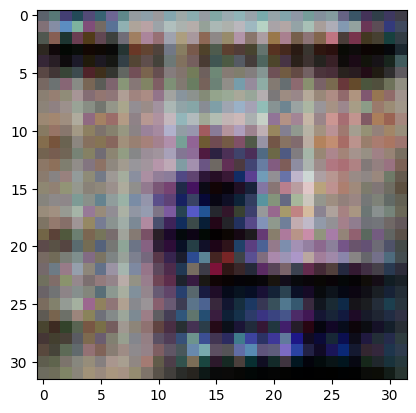

2/2 [==============================] - 0s 12ms/step
>1, 203/390, d1=0.374, d2=0.618 g=1.617


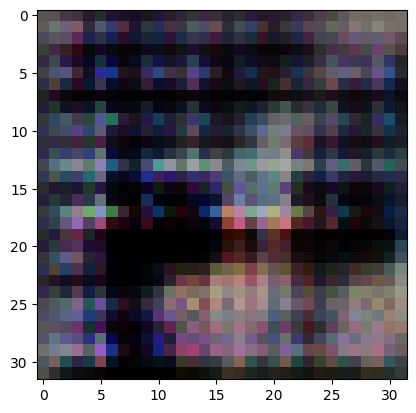

2/2 [==============================] - 0s 7ms/step
>1, 204/390, d1=0.396, d2=0.491 g=1.998


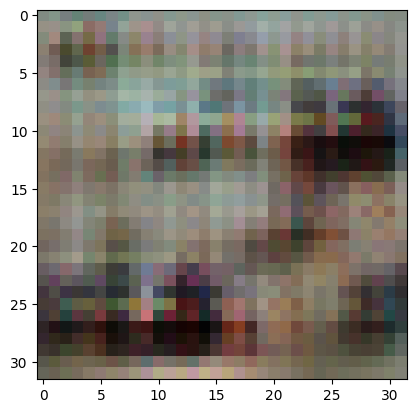

2/2 [==============================] - 0s 6ms/step
>1, 205/390, d1=0.546, d2=0.494 g=2.017


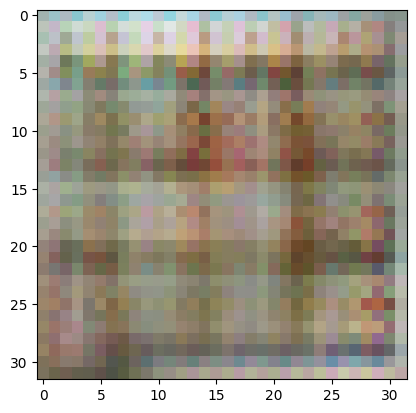

2/2 [==============================] - 0s 6ms/step
>1, 206/390, d1=0.600, d2=0.588 g=1.616


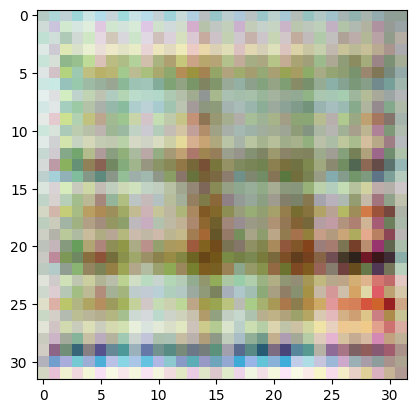

2/2 [==============================] - 0s 6ms/step
>1, 207/390, d1=0.580, d2=0.533 g=1.565


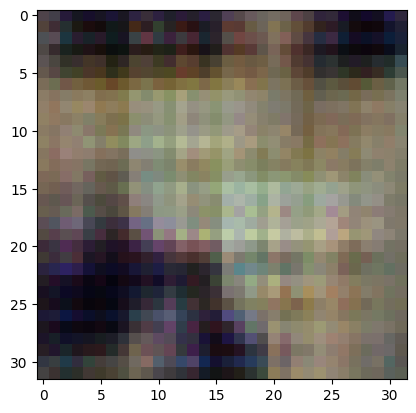

2/2 [==============================] - 0s 6ms/step
>1, 208/390, d1=0.582, d2=0.550 g=1.561


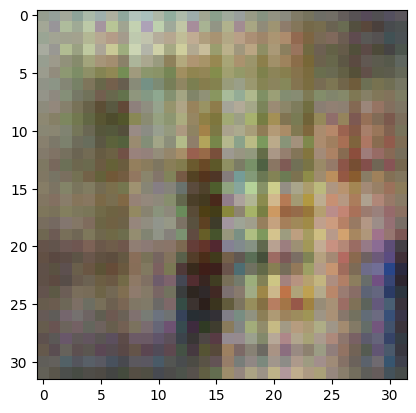

2/2 [==============================] - 0s 8ms/step
>1, 209/390, d1=0.413, d2=0.656 g=1.703


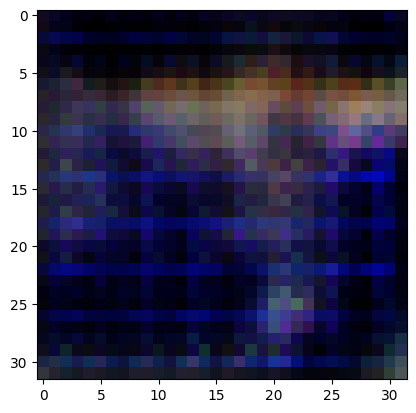

2/2 [==============================] - 0s 7ms/step
>1, 210/390, d1=0.567, d2=0.371 g=1.738


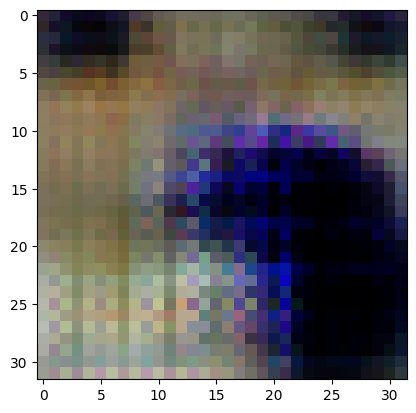

2/2 [==============================] - 0s 7ms/step
>1, 211/390, d1=0.660, d2=0.668 g=1.499


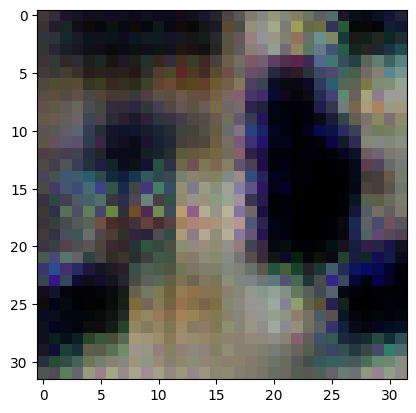

2/2 [==============================] - 0s 6ms/step
>1, 212/390, d1=0.519, d2=0.557 g=1.504


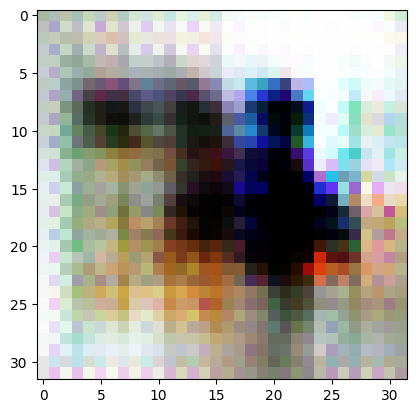

2/2 [==============================] - 0s 6ms/step
>1, 213/390, d1=0.640, d2=0.545 g=1.395


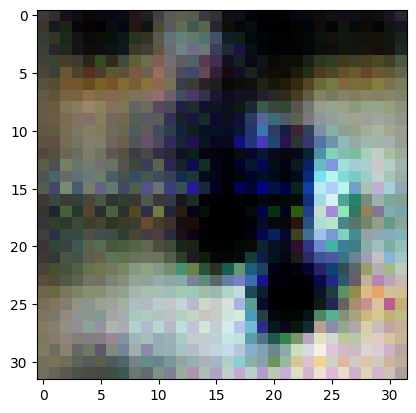

2/2 [==============================] - 0s 6ms/step
>1, 214/390, d1=0.496, d2=0.601 g=1.507


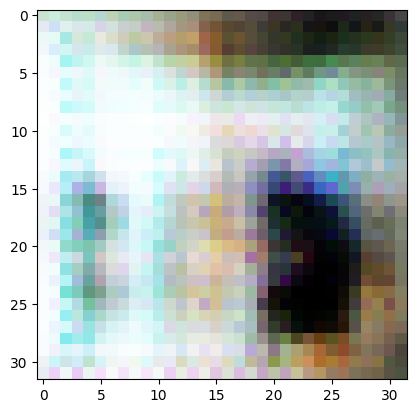

2/2 [==============================] - 0s 7ms/step
>1, 215/390, d1=0.777, d2=0.898 g=1.505


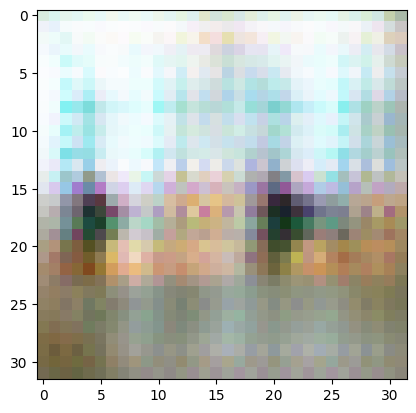

2/2 [==============================] - 0s 7ms/step
>1, 216/390, d1=0.734, d2=0.535 g=1.812


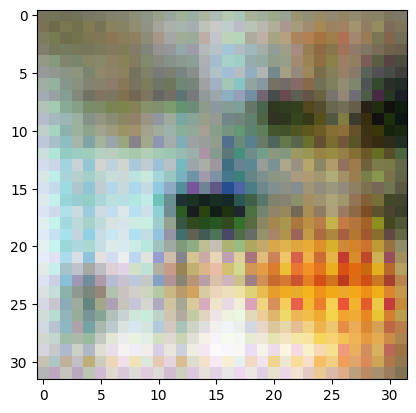

2/2 [==============================] - 0s 7ms/step
>1, 217/390, d1=0.891, d2=0.387 g=1.809


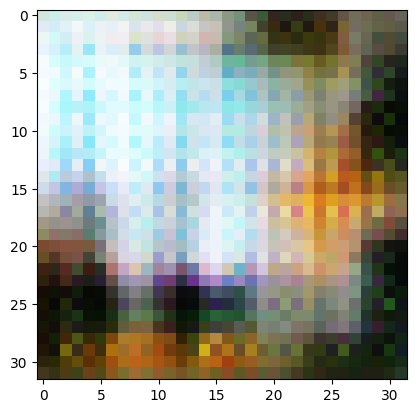

2/2 [==============================] - 0s 6ms/step
>1, 218/390, d1=0.855, d2=0.352 g=1.582


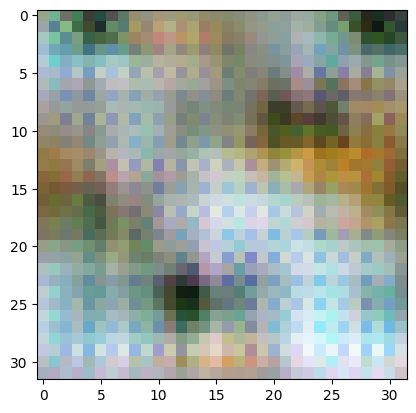

2/2 [==============================] - 0s 10ms/step
>1, 219/390, d1=0.654, d2=0.514 g=1.322


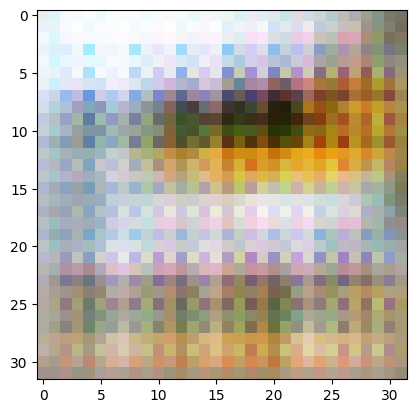

2/2 [==============================] - 0s 7ms/step
>1, 220/390, d1=0.561, d2=0.706 g=1.630


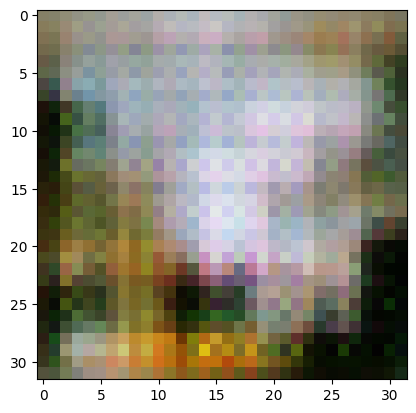

2/2 [==============================] - 0s 9ms/step
>1, 221/390, d1=0.604, d2=0.379 g=1.729


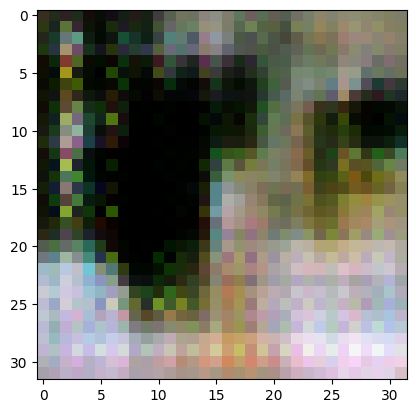

2/2 [==============================] - 0s 7ms/step
>1, 222/390, d1=0.537, d2=0.410 g=1.421


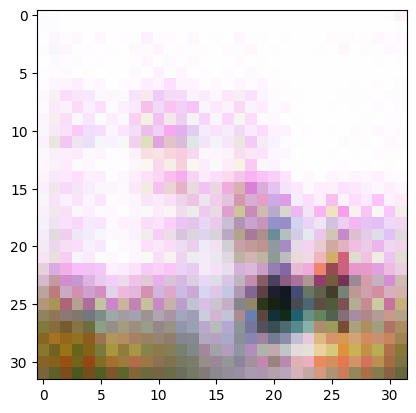

2/2 [==============================] - 0s 7ms/step
>1, 223/390, d1=0.569, d2=0.606 g=1.306


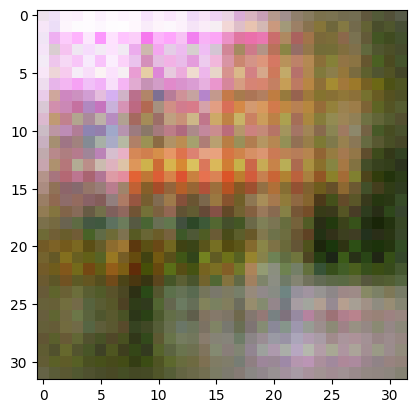

2/2 [==============================] - 0s 10ms/step
>1, 224/390, d1=0.401, d2=0.701 g=1.402


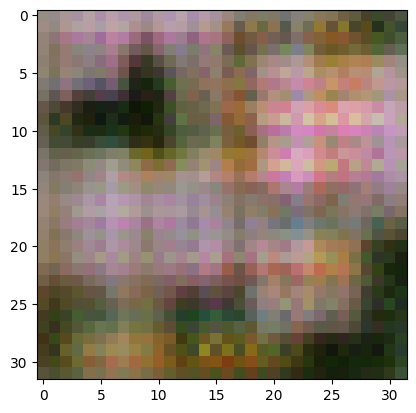

2/2 [==============================] - 0s 7ms/step
>1, 225/390, d1=0.705, d2=0.493 g=1.351


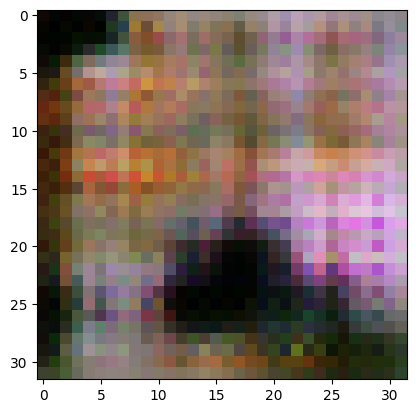

2/2 [==============================] - 0s 6ms/step
>1, 226/390, d1=0.639, d2=0.478 g=1.353


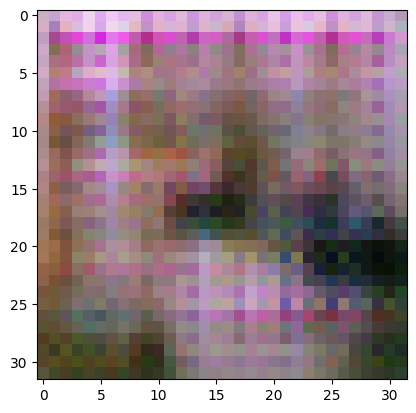

2/2 [==============================] - 0s 6ms/step
>1, 227/390, d1=0.583, d2=0.516 g=1.278


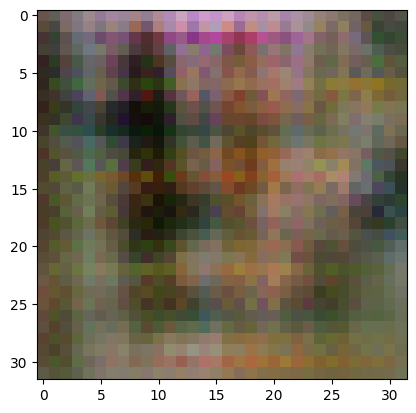

2/2 [==============================] - 0s 7ms/step
>1, 228/390, d1=0.434, d2=0.569 g=1.257


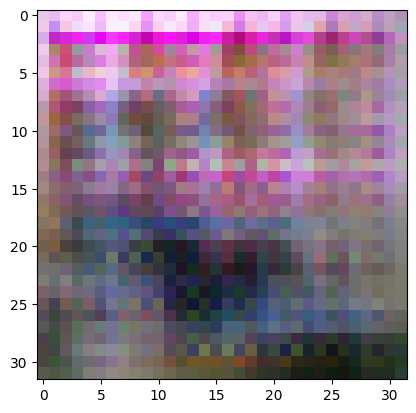

2/2 [==============================] - 0s 6ms/step
>1, 229/390, d1=0.291, d2=0.535 g=1.277


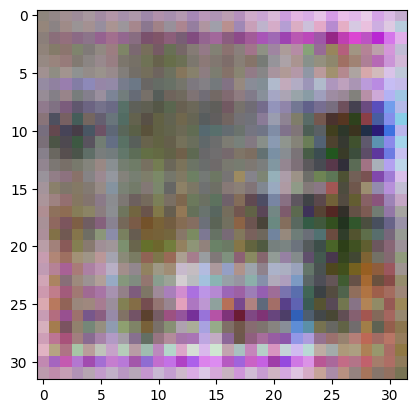

2/2 [==============================] - 0s 6ms/step
>1, 230/390, d1=0.379, d2=0.730 g=1.260


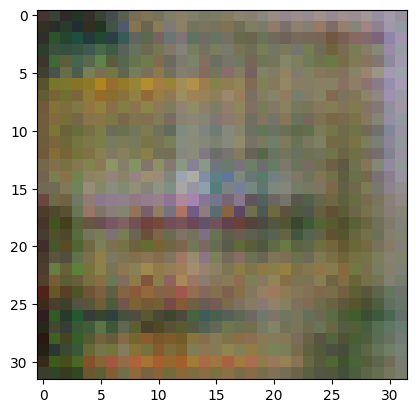

2/2 [==============================] - 0s 6ms/step
>1, 231/390, d1=0.373, d2=0.593 g=1.507


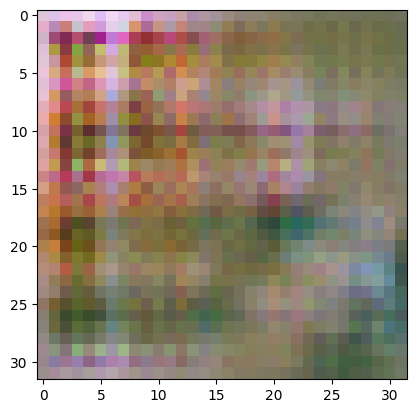

2/2 [==============================] - 0s 6ms/step
>1, 232/390, d1=0.403, d2=0.538 g=1.722


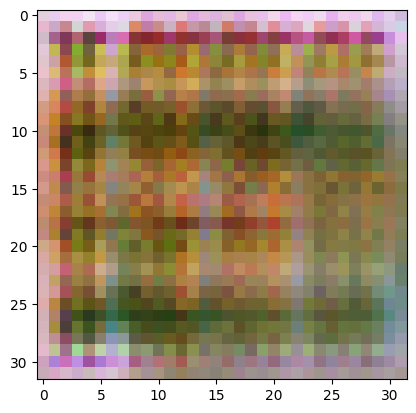

2/2 [==============================] - 0s 7ms/step
>1, 233/390, d1=0.523, d2=0.517 g=2.123


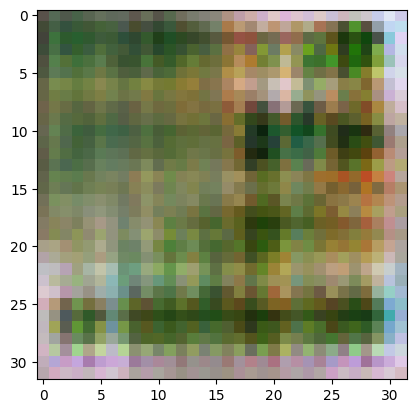

2/2 [==============================] - 0s 6ms/step
>1, 234/390, d1=0.600, d2=0.475 g=2.384


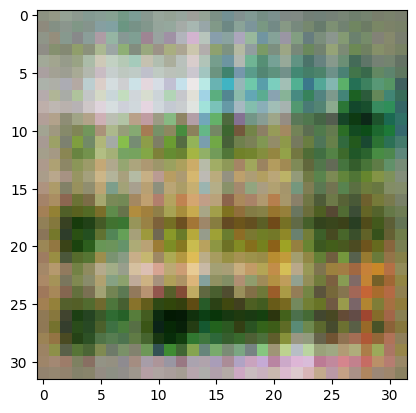

2/2 [==============================] - 0s 6ms/step
>1, 235/390, d1=0.493, d2=0.283 g=2.584


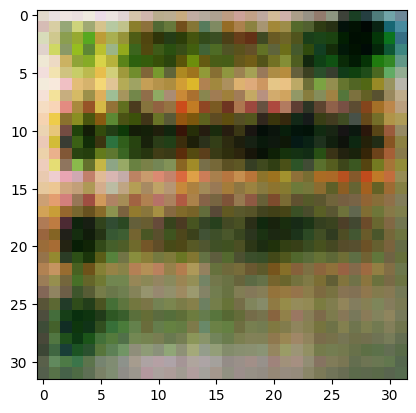

2/2 [==============================] - 0s 7ms/step
>1, 236/390, d1=0.520, d2=1.037 g=3.380


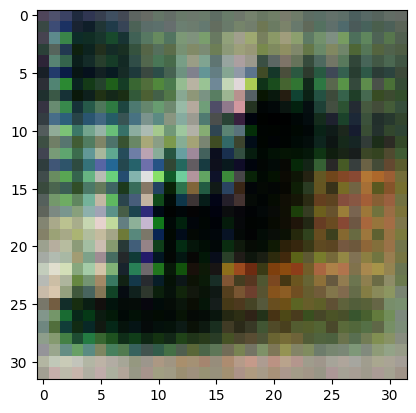

2/2 [==============================] - 0s 6ms/step
>1, 237/390, d1=0.973, d2=0.618 g=1.797


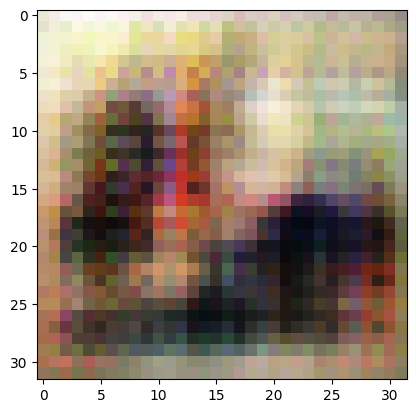

2/2 [==============================] - 0s 7ms/step
>1, 238/390, d1=0.818, d2=0.845 g=1.252


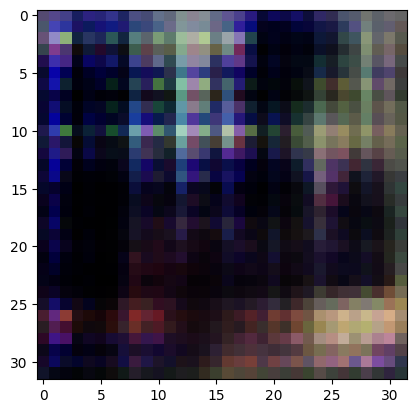

2/2 [==============================] - 0s 6ms/step
>1, 239/390, d1=0.751, d2=0.671 g=1.288


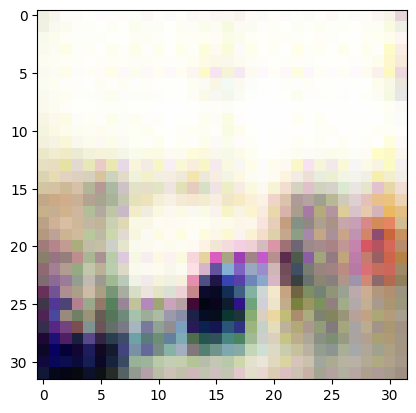

2/2 [==============================] - 0s 6ms/step
>1, 240/390, d1=0.820, d2=0.546 g=1.326


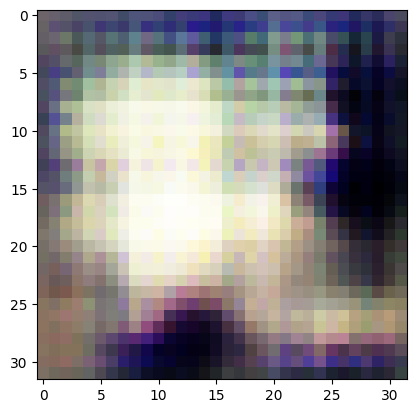

2/2 [==============================] - 0s 7ms/step
>1, 241/390, d1=0.744, d2=0.420 g=1.416


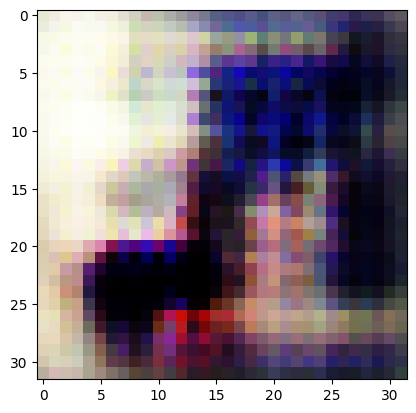

2/2 [==============================] - 0s 7ms/step
>1, 242/390, d1=0.632, d2=0.395 g=1.512


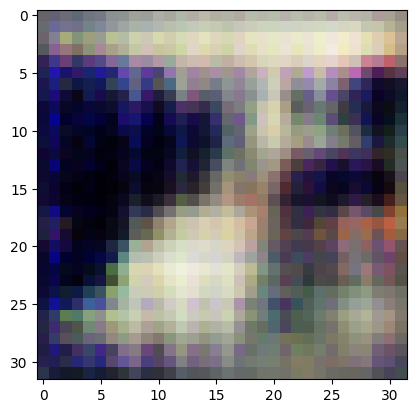

2/2 [==============================] - 0s 7ms/step
>1, 243/390, d1=0.712, d2=0.412 g=1.544


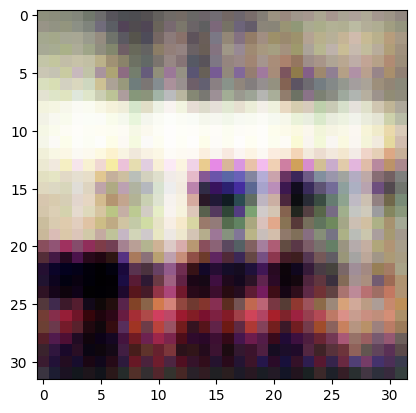

2/2 [==============================] - 0s 7ms/step
>1, 244/390, d1=0.578, d2=0.474 g=1.498


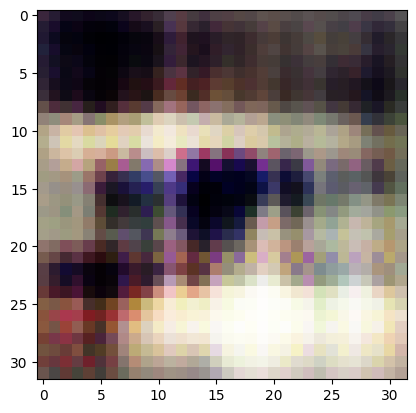

2/2 [==============================] - 0s 9ms/step
>1, 245/390, d1=0.580, d2=0.431 g=1.482


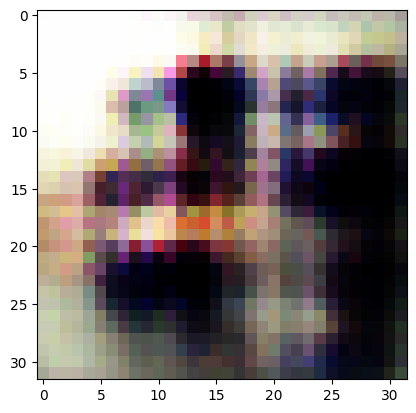

2/2 [==============================] - 0s 7ms/step
>1, 246/390, d1=0.548, d2=0.473 g=1.322


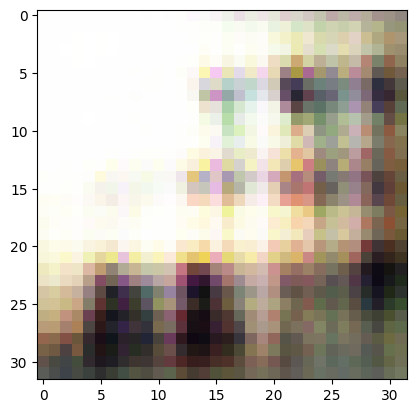

2/2 [==============================] - 0s 8ms/step
>1, 247/390, d1=0.603, d2=0.499 g=1.296


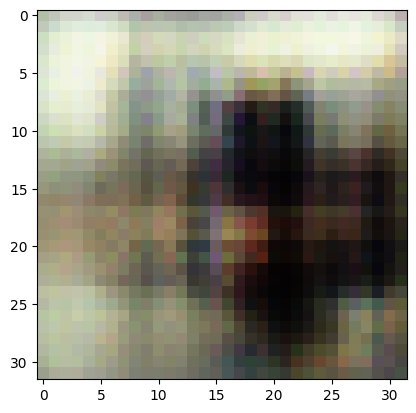

2/2 [==============================] - 0s 6ms/step
>1, 248/390, d1=0.569, d2=0.502 g=1.364


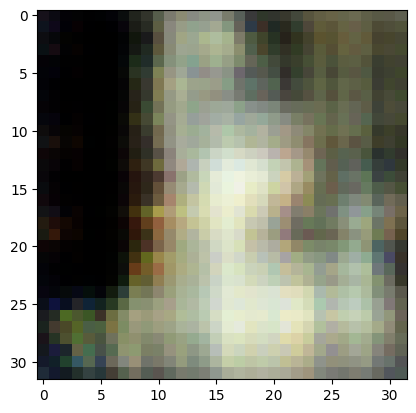

2/2 [==============================] - 0s 7ms/step
>1, 249/390, d1=0.514, d2=0.462 g=1.466


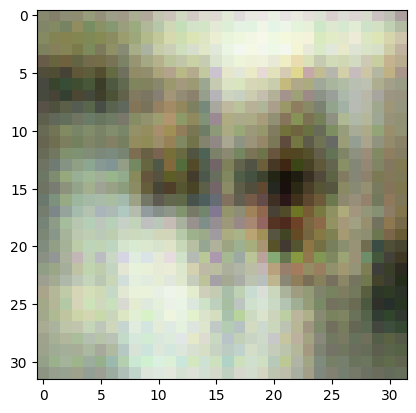

2/2 [==============================] - 0s 7ms/step
>1, 250/390, d1=0.606, d2=0.555 g=1.405


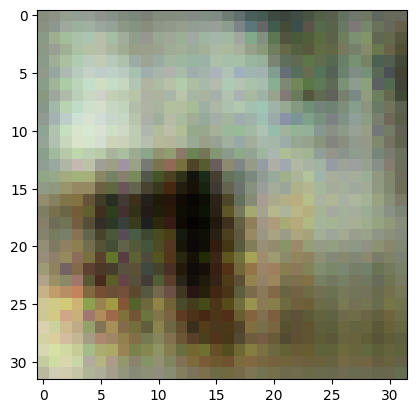

2/2 [==============================] - 0s 7ms/step
>1, 251/390, d1=0.536, d2=0.706 g=1.302


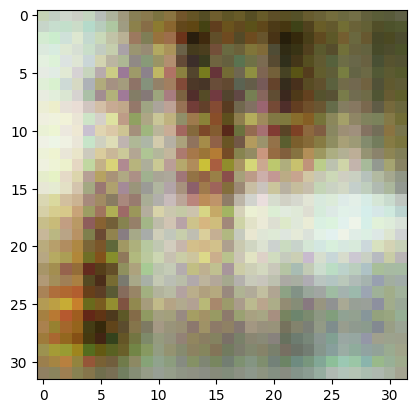

2/2 [==============================] - 0s 7ms/step
>1, 252/390, d1=0.614, d2=0.735 g=1.215


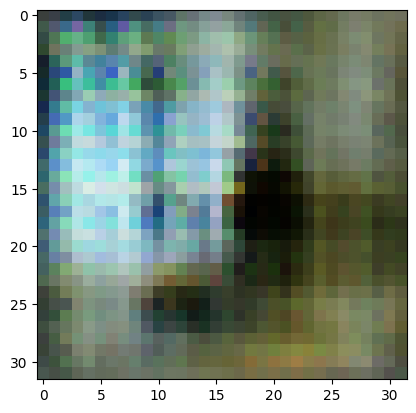

2/2 [==============================] - 0s 7ms/step
>1, 253/390, d1=0.638, d2=0.752 g=1.096


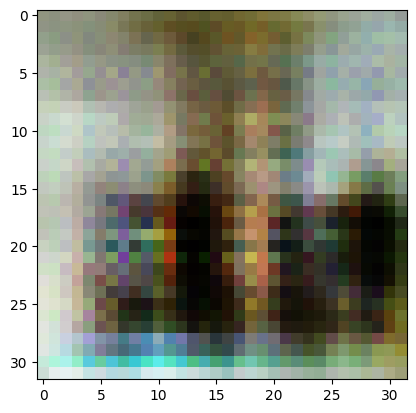

2/2 [==============================] - 0s 7ms/step
>1, 254/390, d1=0.558, d2=0.717 g=1.825


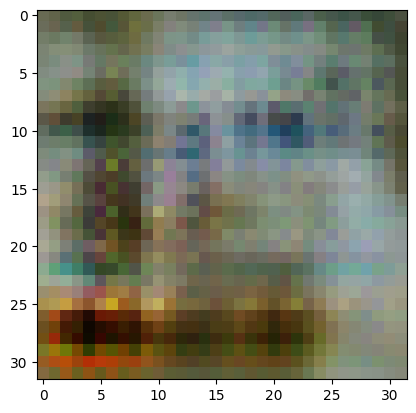

2/2 [==============================] - 0s 6ms/step
>1, 255/390, d1=0.570, d2=0.549 g=1.598


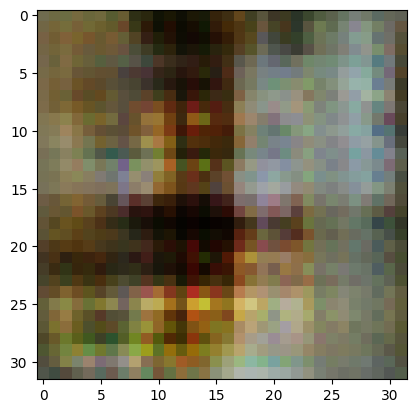

2/2 [==============================] - 0s 6ms/step
>1, 256/390, d1=0.530, d2=0.562 g=1.362


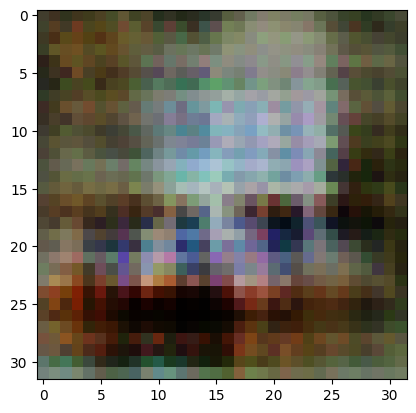

2/2 [==============================] - 0s 7ms/step
>1, 257/390, d1=0.383, d2=0.391 g=1.696


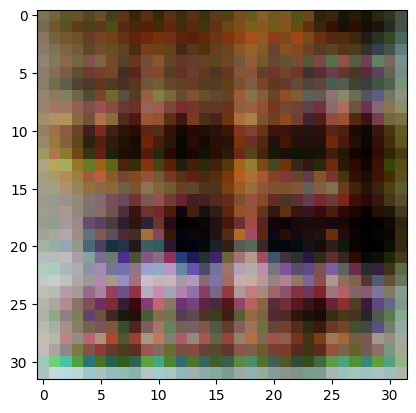

2/2 [==============================] - 0s 7ms/step
>1, 258/390, d1=0.327, d2=0.385 g=1.926


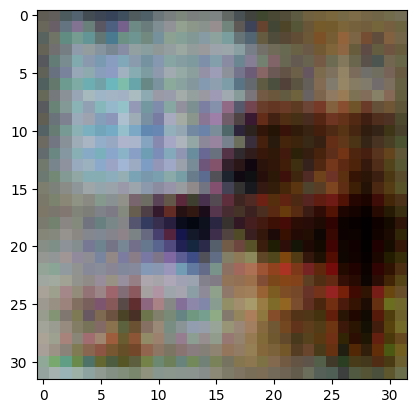

2/2 [==============================] - 0s 7ms/step
>1, 259/390, d1=0.418, d2=0.617 g=2.195


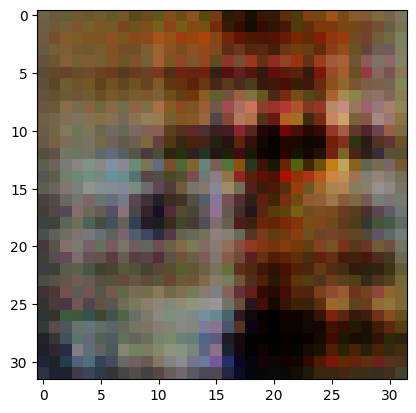

2/2 [==============================] - 0s 10ms/step
>1, 260/390, d1=0.275, d2=0.780 g=2.186


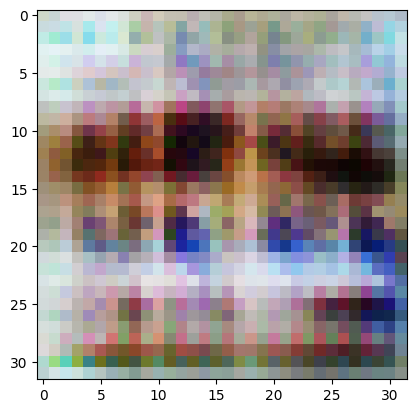

2/2 [==============================] - 0s 7ms/step
>1, 261/390, d1=0.684, d2=1.062 g=2.280


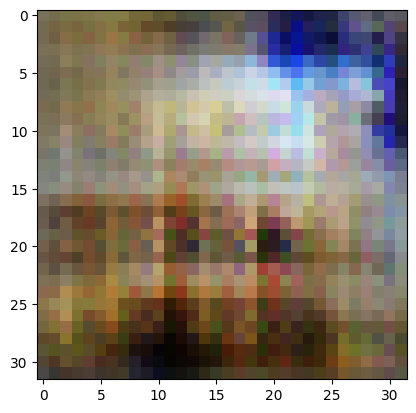

2/2 [==============================] - 0s 7ms/step
>1, 262/390, d1=1.272, d2=0.757 g=1.679


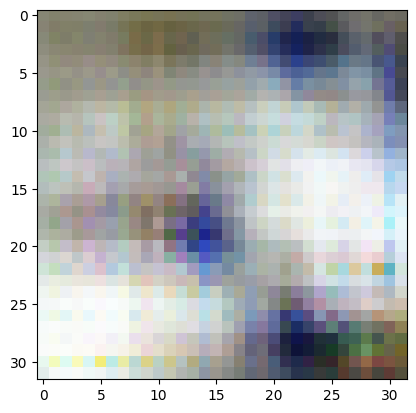

2/2 [==============================] - 0s 7ms/step
>1, 263/390, d1=1.049, d2=0.506 g=1.364


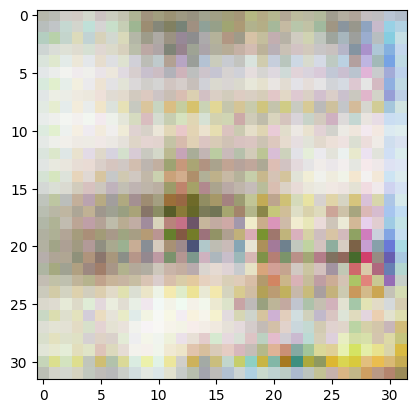

2/2 [==============================] - 0s 7ms/step
>1, 264/390, d1=0.792, d2=0.531 g=1.406


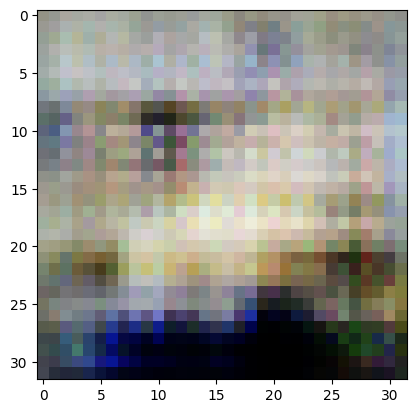

2/2 [==============================] - 0s 7ms/step
>1, 265/390, d1=0.704, d2=0.443 g=1.389


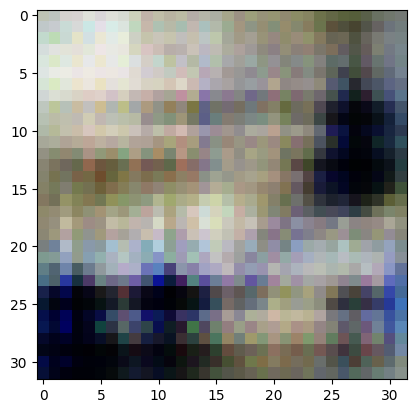

2/2 [==============================] - 0s 8ms/step
>1, 266/390, d1=0.498, d2=0.455 g=1.452


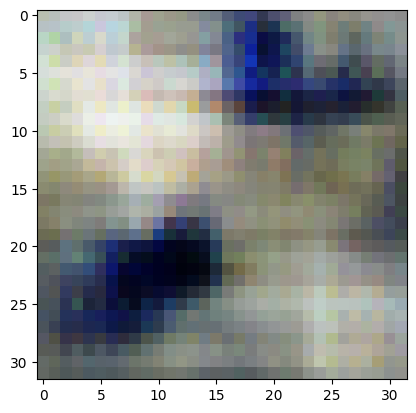

2/2 [==============================] - 0s 7ms/step
>1, 267/390, d1=0.562, d2=0.603 g=1.333


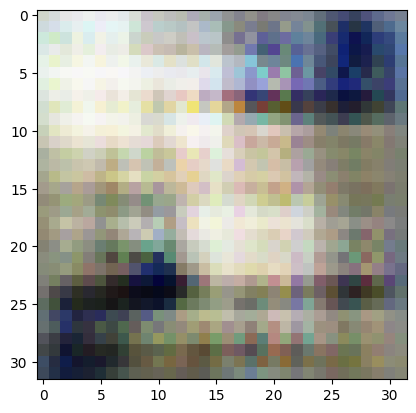

2/2 [==============================] - 0s 6ms/step
>1, 268/390, d1=0.694, d2=0.751 g=1.158


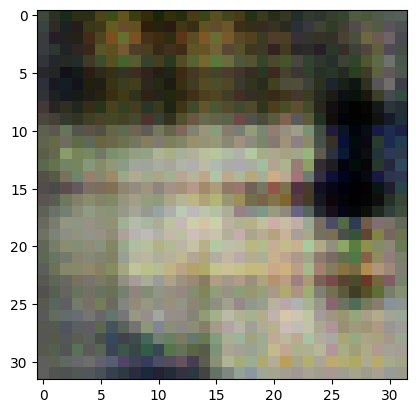

2/2 [==============================] - 0s 11ms/step
>1, 269/390, d1=0.600, d2=0.584 g=1.148


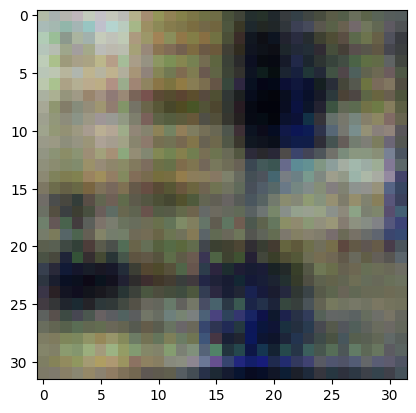

2/2 [==============================] - 0s 9ms/step
>1, 270/390, d1=0.613, d2=0.609 g=1.202


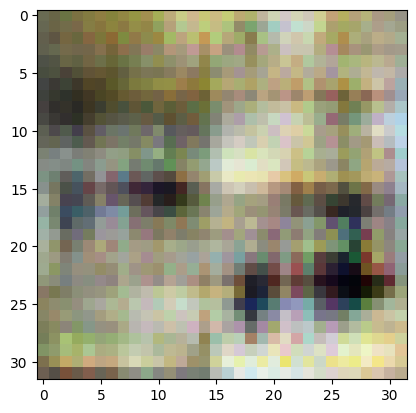

2/2 [==============================] - 0s 6ms/step
>1, 271/390, d1=0.546, d2=0.561 g=1.203


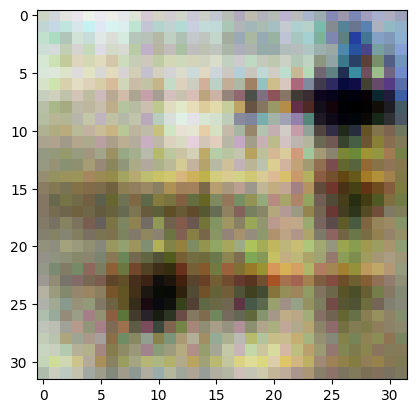

2/2 [==============================] - 0s 7ms/step
>1, 272/390, d1=0.478, d2=0.556 g=1.222


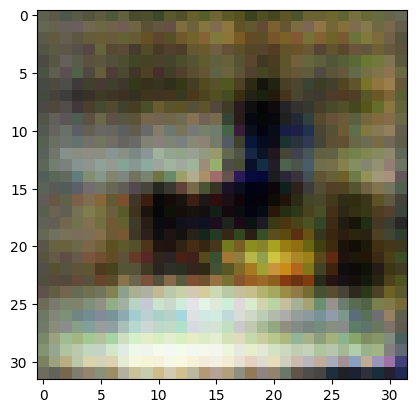

2/2 [==============================] - 0s 7ms/step
>1, 273/390, d1=0.488, d2=0.558 g=1.230


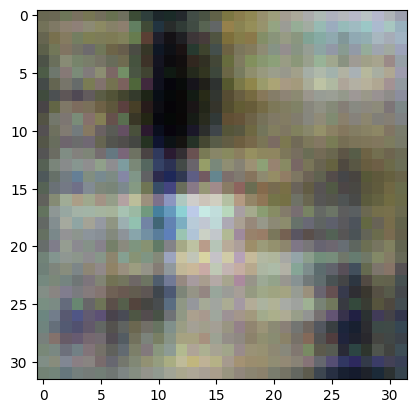

2/2 [==============================] - 0s 9ms/step
>1, 274/390, d1=0.596, d2=0.684 g=1.240


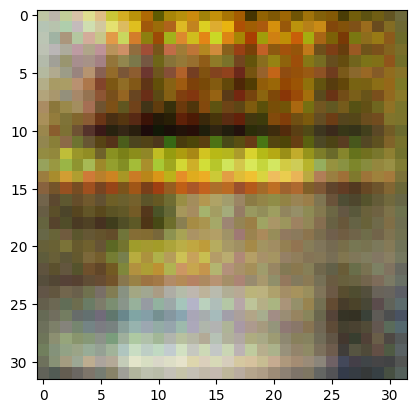

2/2 [==============================] - 0s 8ms/step
>1, 275/390, d1=0.469, d2=0.710 g=1.394


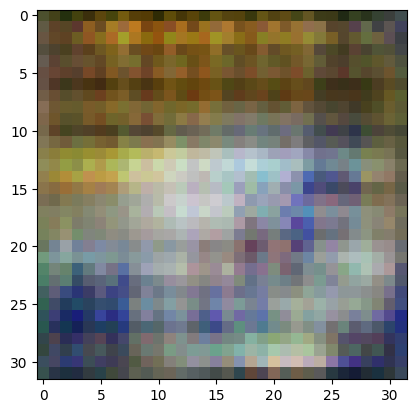

2/2 [==============================] - 0s 8ms/step
>1, 276/390, d1=0.596, d2=0.595 g=1.302


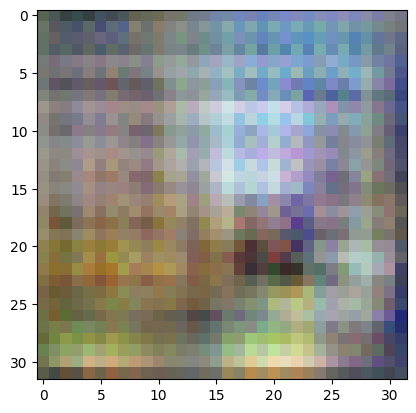

2/2 [==============================] - 0s 7ms/step
>1, 277/390, d1=0.548, d2=0.651 g=1.347


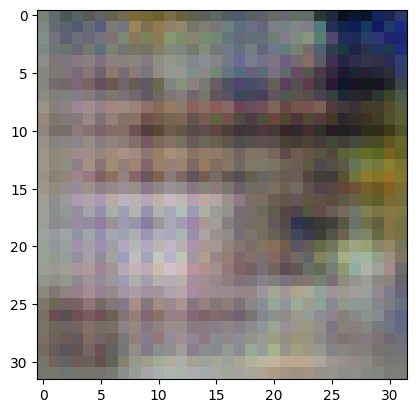

2/2 [==============================] - 0s 7ms/step
>1, 278/390, d1=0.581, d2=0.637 g=1.537


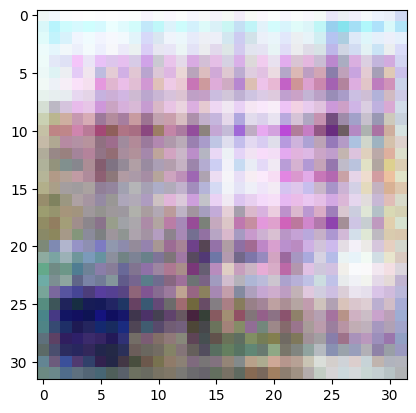

2/2 [==============================] - 0s 7ms/step
>1, 279/390, d1=0.757, d2=0.759 g=1.546


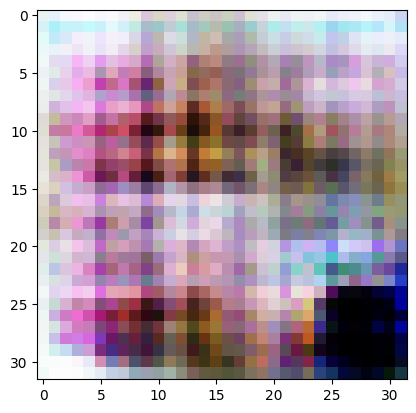

2/2 [==============================] - 0s 7ms/step
>1, 280/390, d1=0.659, d2=0.638 g=1.575


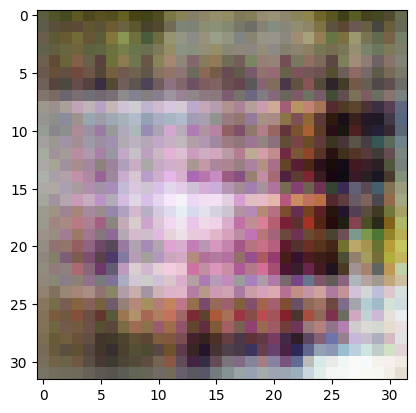

2/2 [==============================] - 0s 6ms/step
>1, 281/390, d1=0.780, d2=0.583 g=1.313


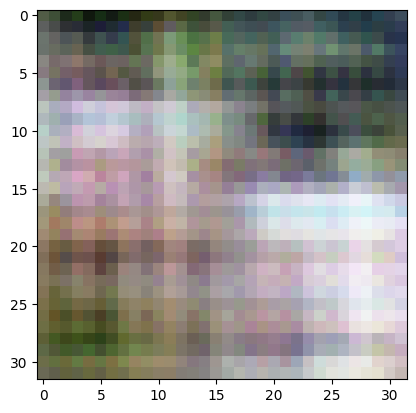

2/2 [==============================] - 0s 6ms/step
>1, 282/390, d1=0.819, d2=0.693 g=1.158


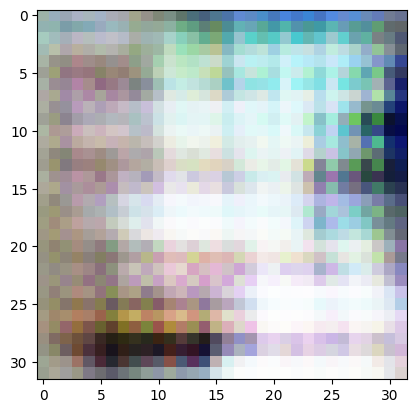

2/2 [==============================] - 0s 6ms/step
>1, 283/390, d1=0.595, d2=0.560 g=1.261


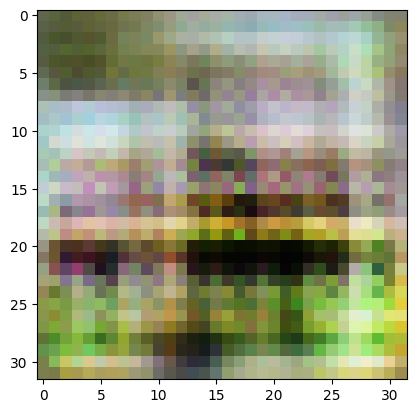

2/2 [==============================] - 0s 6ms/step
>1, 284/390, d1=0.592, d2=0.517 g=1.440


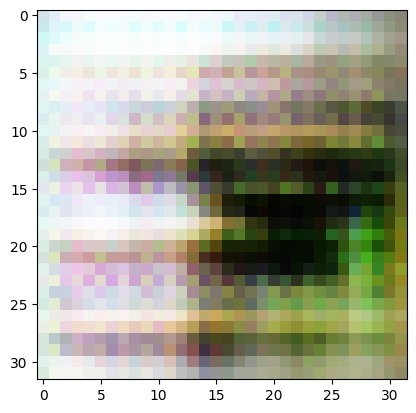

2/2 [==============================] - 0s 7ms/step
>1, 285/390, d1=0.526, d2=0.419 g=1.443


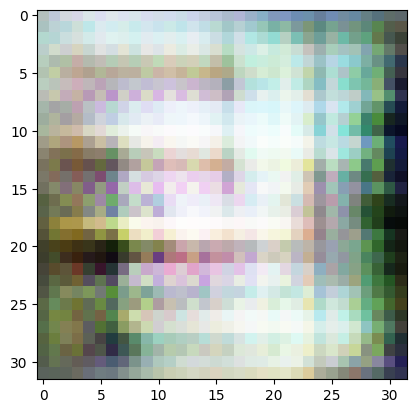

2/2 [==============================] - 0s 7ms/step
>1, 286/390, d1=0.484, d2=0.540 g=1.654


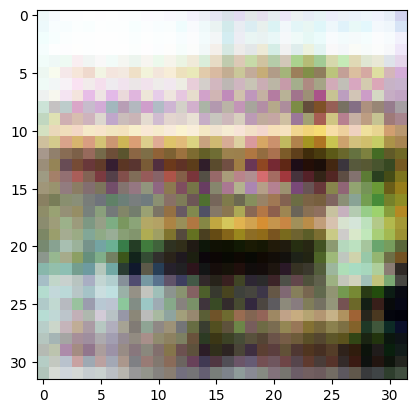

2/2 [==============================] - 0s 7ms/step
>1, 287/390, d1=0.472, d2=0.450 g=1.752


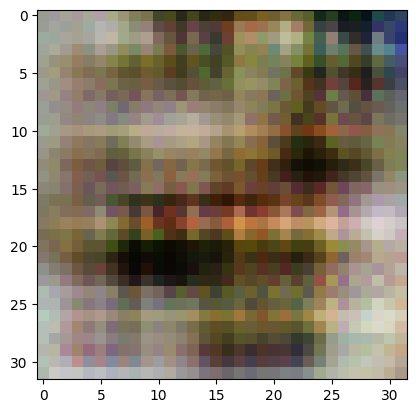

2/2 [==============================] - 0s 7ms/step
>1, 288/390, d1=0.691, d2=0.505 g=1.499


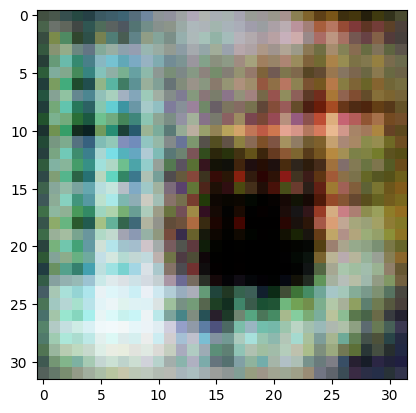

2/2 [==============================] - 0s 7ms/step
>1, 289/390, d1=0.623, d2=0.762 g=1.547


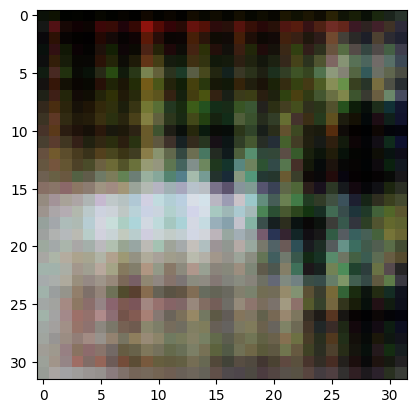

2/2 [==============================] - 0s 7ms/step
>1, 290/390, d1=0.742, d2=0.648 g=1.396


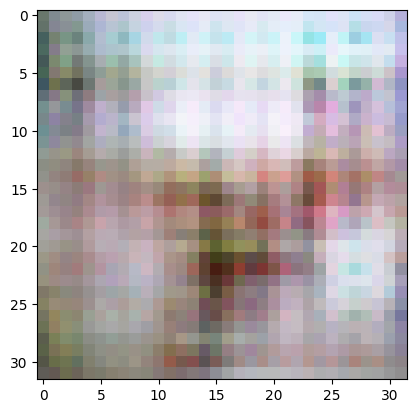

2/2 [==============================] - 0s 6ms/step
>1, 291/390, d1=0.726, d2=0.731 g=1.303


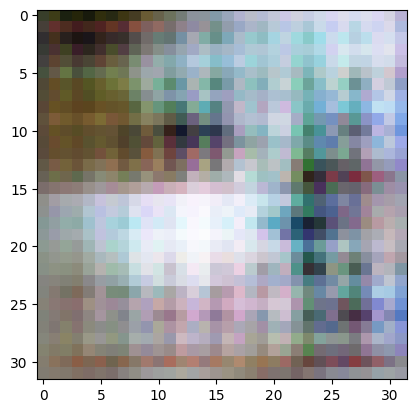

2/2 [==============================] - 0s 6ms/step
>1, 292/390, d1=0.740, d2=0.564 g=1.444


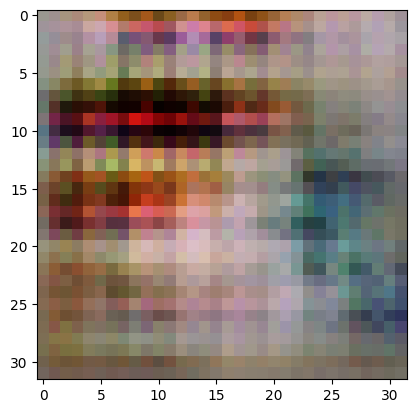

2/2 [==============================] - 0s 6ms/step
>1, 293/390, d1=0.675, d2=0.499 g=1.377


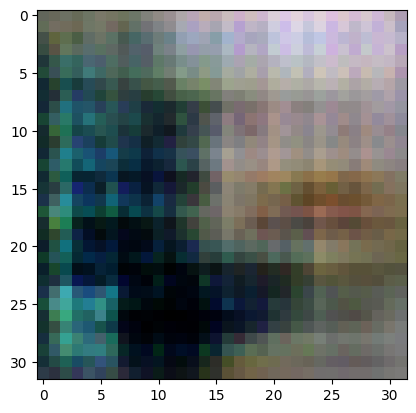

2/2 [==============================] - 0s 6ms/step
>1, 294/390, d1=0.633, d2=0.582 g=1.274


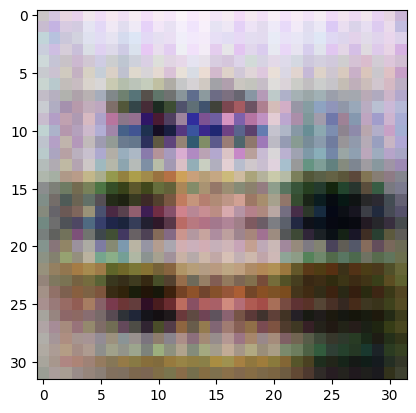

2/2 [==============================] - 0s 7ms/step
>1, 295/390, d1=0.651, d2=0.566 g=1.250


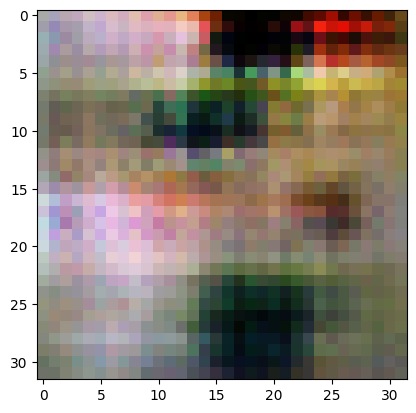

2/2 [==============================] - 0s 6ms/step
>1, 296/390, d1=0.562, d2=0.657 g=1.100


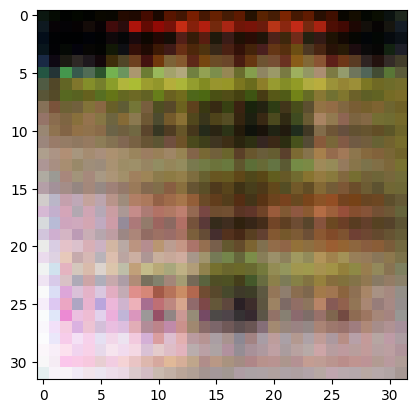

2/2 [==============================] - 0s 6ms/step
>1, 297/390, d1=0.496, d2=0.673 g=1.080


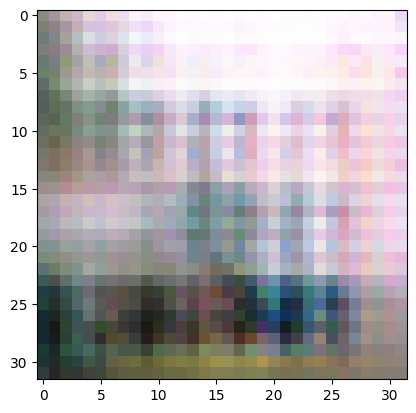

2/2 [==============================] - 0s 6ms/step
>1, 298/390, d1=0.571, d2=0.597 g=1.145


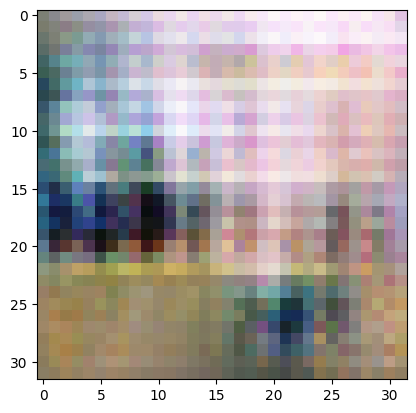

2/2 [==============================] - 0s 7ms/step
>1, 299/390, d1=0.555, d2=0.585 g=1.256


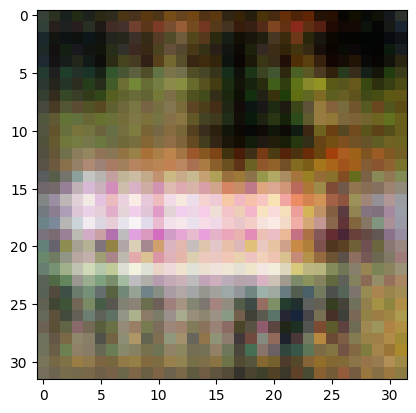

2/2 [==============================] - 0s 6ms/step
>1, 300/390, d1=0.569, d2=0.591 g=1.378


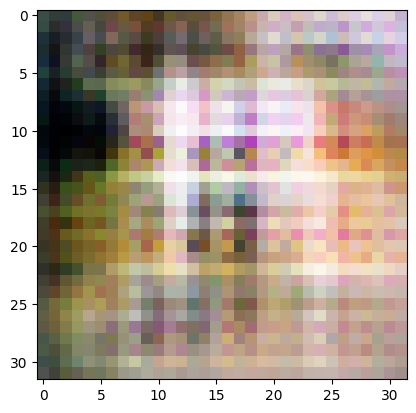

2/2 [==============================] - 0s 10ms/step
>1, 301/390, d1=0.662, d2=0.523 g=1.404


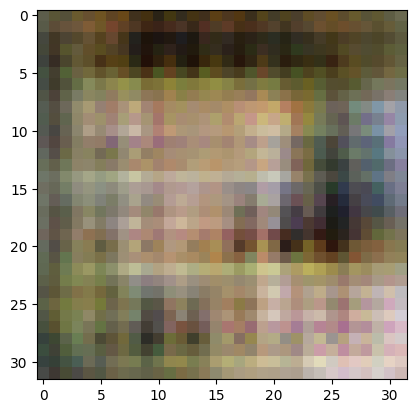

2/2 [==============================] - 0s 8ms/step
>1, 302/390, d1=0.616, d2=0.611 g=1.457


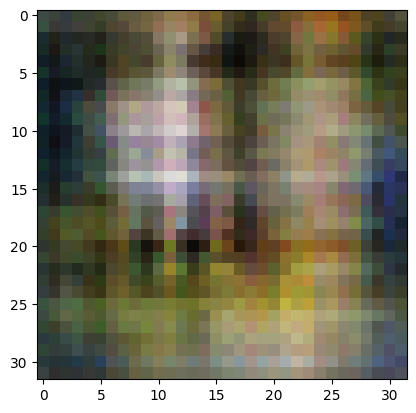

2/2 [==============================] - 0s 7ms/step
>1, 303/390, d1=0.661, d2=0.594 g=1.505


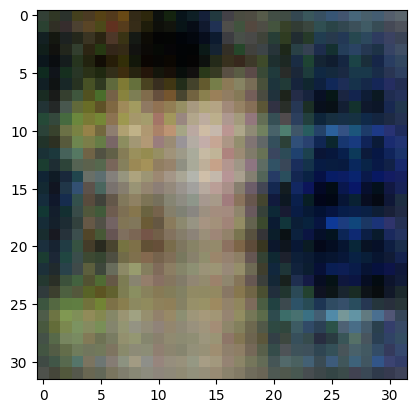

2/2 [==============================] - 0s 6ms/step
>1, 304/390, d1=0.610, d2=0.533 g=1.384


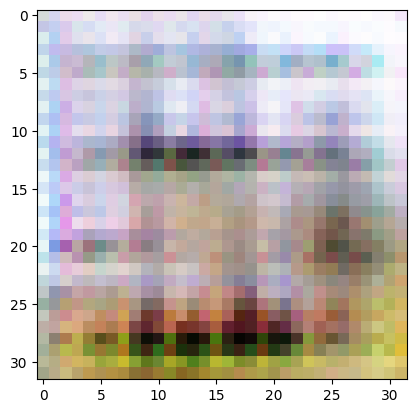

2/2 [==============================] - 0s 6ms/step
>1, 305/390, d1=0.698, d2=0.692 g=1.300


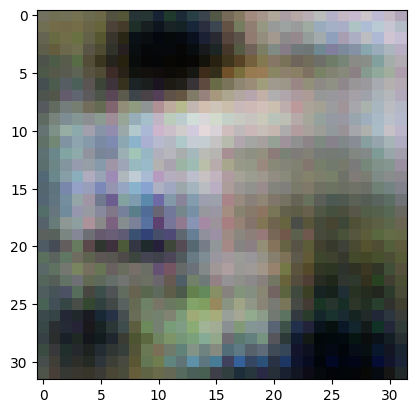

2/2 [==============================] - 0s 6ms/step
>1, 306/390, d1=0.638, d2=0.662 g=1.292


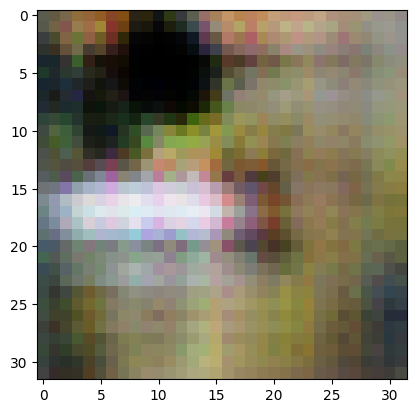

2/2 [==============================] - 0s 6ms/step
>1, 307/390, d1=0.750, d2=0.640 g=1.136


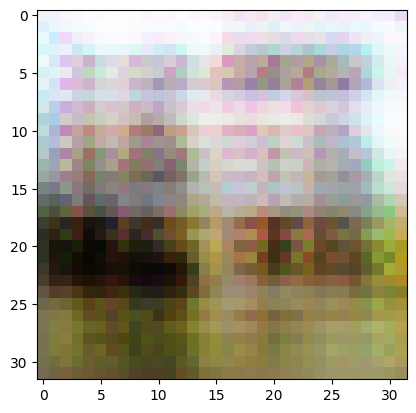

2/2 [==============================] - 0s 6ms/step
>1, 308/390, d1=0.626, d2=0.609 g=1.249


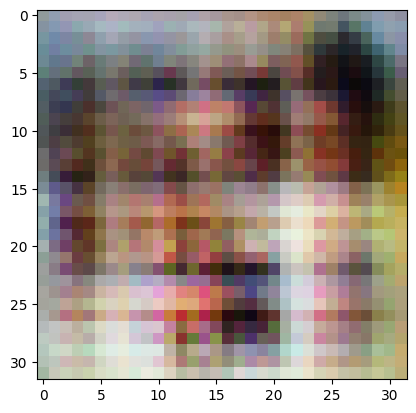

2/2 [==============================] - 0s 7ms/step
>1, 309/390, d1=0.720, d2=0.579 g=1.236


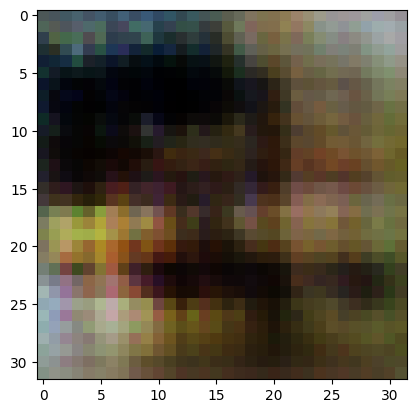

2/2 [==============================] - 0s 7ms/step
>1, 310/390, d1=0.649, d2=0.525 g=1.250


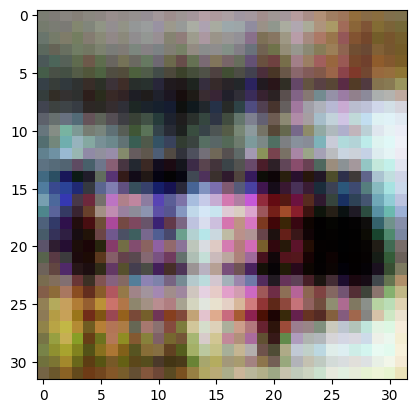

2/2 [==============================] - 0s 7ms/step
>1, 311/390, d1=0.576, d2=0.516 g=1.323


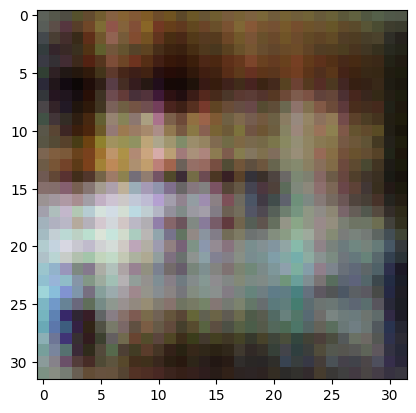

2/2 [==============================] - 0s 7ms/step
>1, 312/390, d1=0.581, d2=0.566 g=1.500


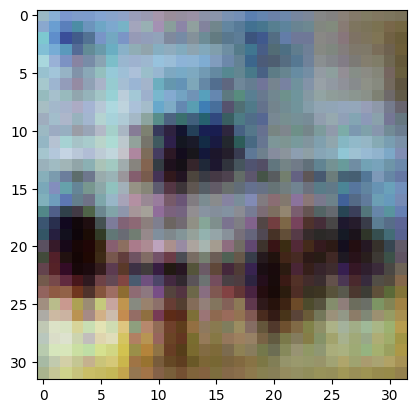

2/2 [==============================] - 0s 7ms/step
>1, 313/390, d1=0.615, d2=0.540 g=1.466


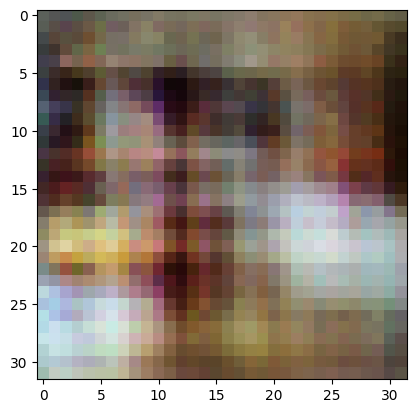

2/2 [==============================] - 0s 6ms/step
>1, 314/390, d1=0.583, d2=0.714 g=1.348


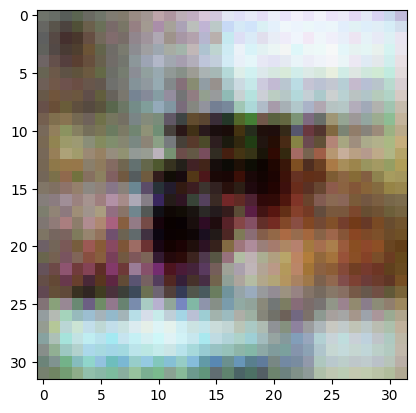

2/2 [==============================] - 0s 7ms/step
>1, 315/390, d1=0.526, d2=0.628 g=1.486


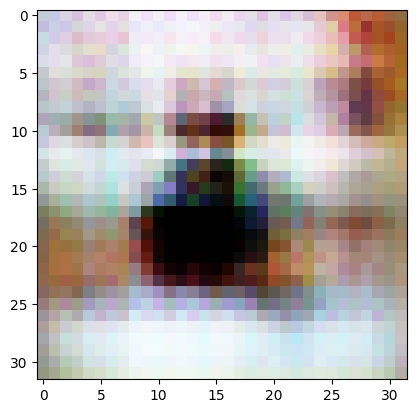

2/2 [==============================] - 0s 7ms/step
>1, 316/390, d1=0.586, d2=0.509 g=1.558


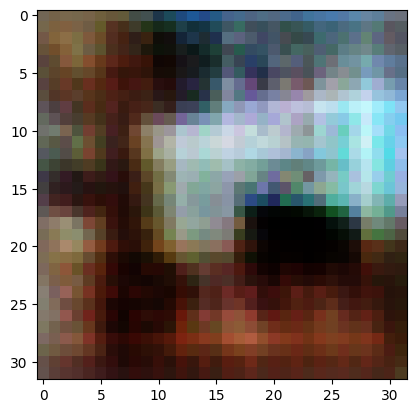

2/2 [==============================] - 0s 7ms/step
>1, 317/390, d1=0.571, d2=0.415 g=1.492


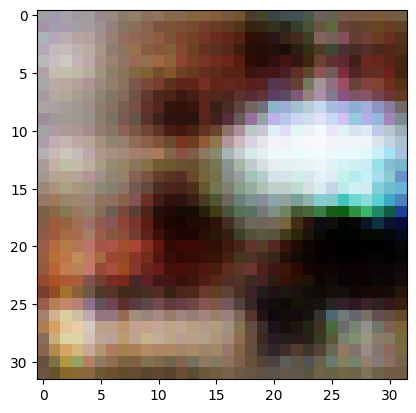

2/2 [==============================] - 0s 7ms/step
>1, 318/390, d1=0.641, d2=0.643 g=1.425


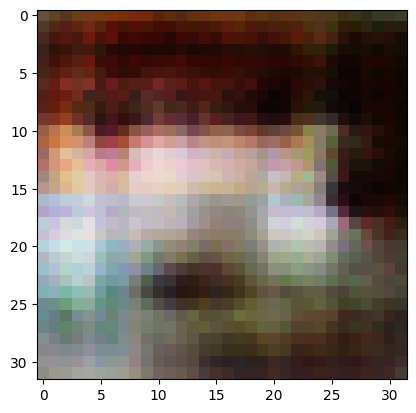

2/2 [==============================] - 0s 8ms/step
>1, 319/390, d1=0.642, d2=0.684 g=1.542


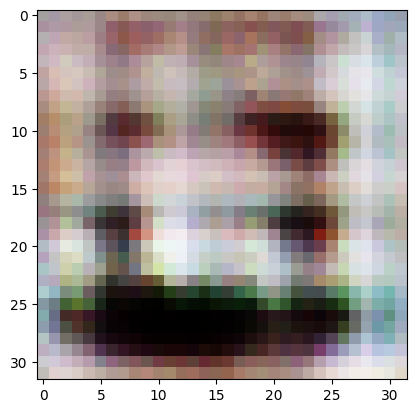

2/2 [==============================] - 0s 7ms/step
>1, 320/390, d1=0.659, d2=0.467 g=1.321


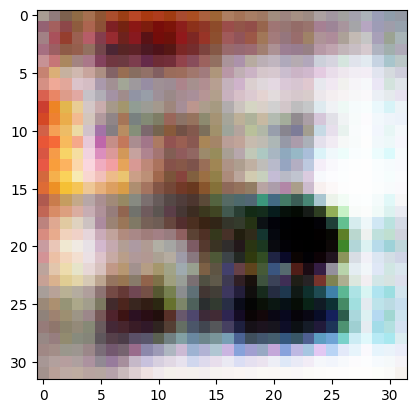

2/2 [==============================] - 0s 7ms/step
>1, 321/390, d1=0.561, d2=0.733 g=1.210


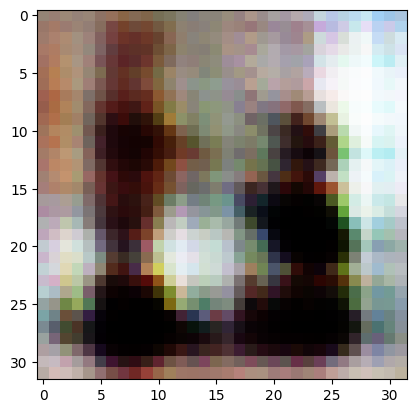

2/2 [==============================] - 0s 8ms/step
>1, 322/390, d1=0.573, d2=0.506 g=1.230


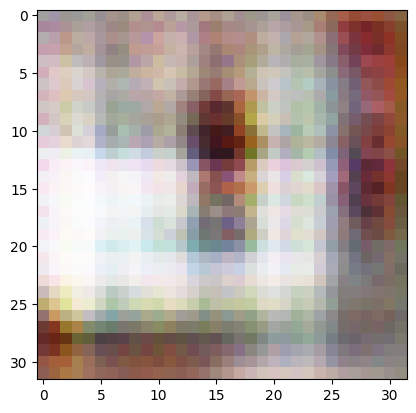

2/2 [==============================] - 0s 8ms/step
>1, 323/390, d1=0.613, d2=0.623 g=1.122


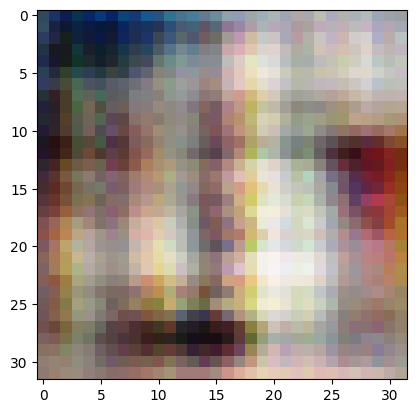

2/2 [==============================] - 0s 10ms/step
>1, 324/390, d1=0.461, d2=0.732 g=1.249


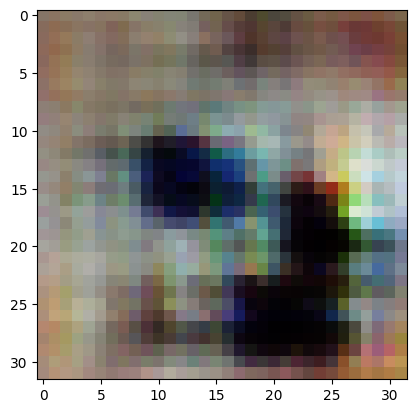

2/2 [==============================] - 0s 6ms/step
>1, 325/390, d1=0.586, d2=0.607 g=1.356


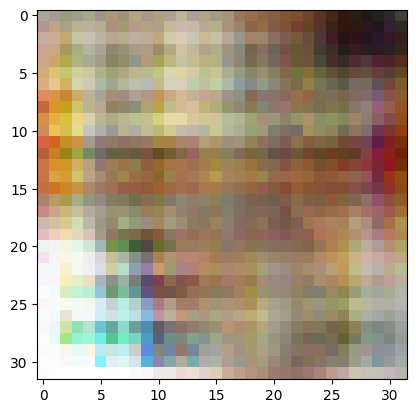

2/2 [==============================] - 0s 10ms/step
>1, 326/390, d1=0.566, d2=0.625 g=1.453


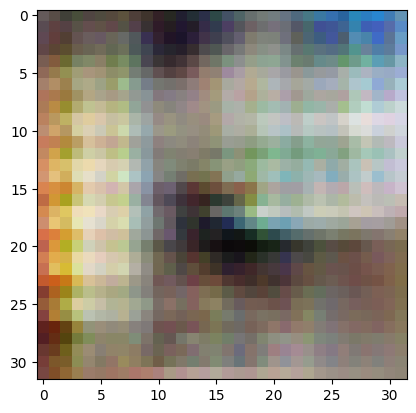

2/2 [==============================] - 0s 11ms/step
>1, 327/390, d1=0.624, d2=0.793 g=1.597


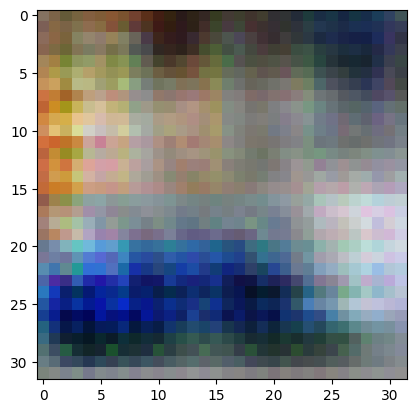

2/2 [==============================] - 0s 7ms/step
>1, 328/390, d1=0.725, d2=0.509 g=1.494


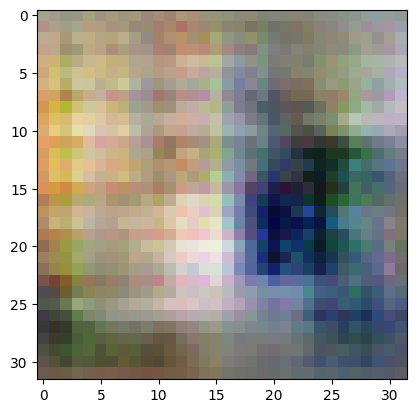

2/2 [==============================] - 0s 7ms/step
>1, 329/390, d1=0.831, d2=0.451 g=1.398


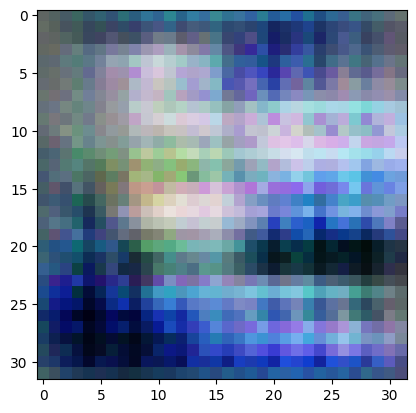

2/2 [==============================] - 0s 7ms/step
>1, 330/390, d1=0.591, d2=0.645 g=1.449


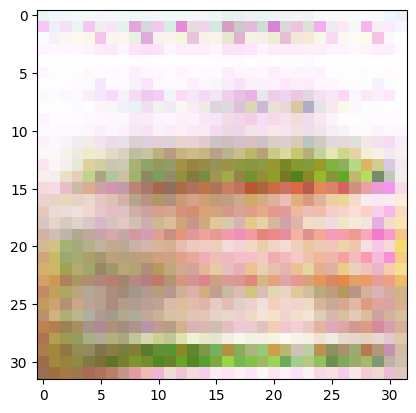

2/2 [==============================] - 0s 6ms/step
>1, 331/390, d1=0.653, d2=0.555 g=1.588


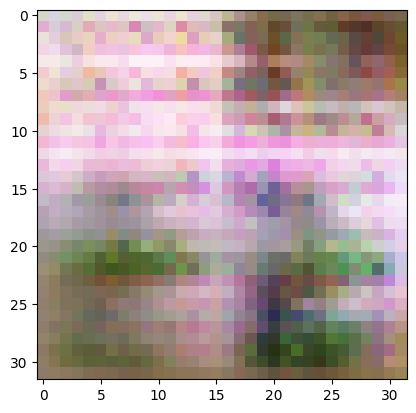

2/2 [==============================] - 0s 6ms/step
>1, 332/390, d1=0.682, d2=0.480 g=1.528


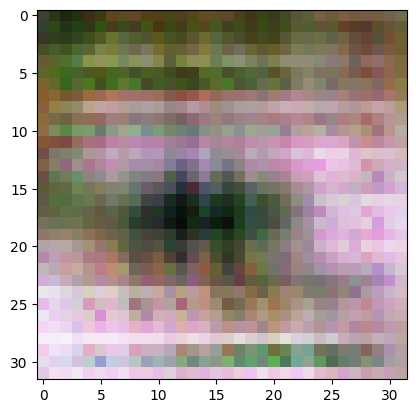

2/2 [==============================] - 0s 6ms/step
>1, 333/390, d1=0.583, d2=0.479 g=1.508


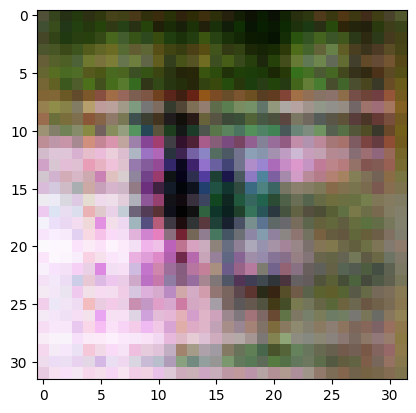

2/2 [==============================] - 0s 7ms/step
>1, 334/390, d1=0.612, d2=0.568 g=1.250


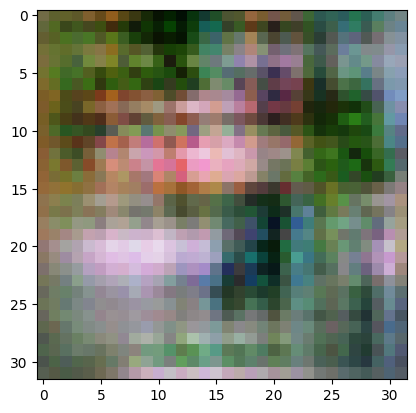

2/2 [==============================] - 0s 7ms/step
>1, 335/390, d1=0.440, d2=0.764 g=1.535


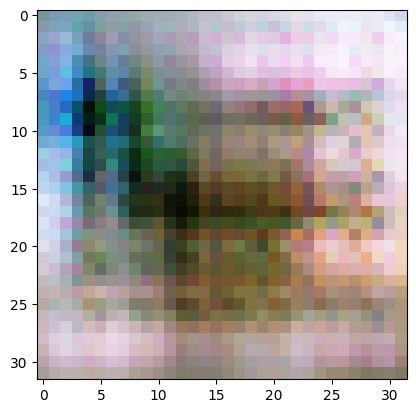

2/2 [==============================] - 0s 7ms/step
>1, 336/390, d1=0.690, d2=0.745 g=1.599


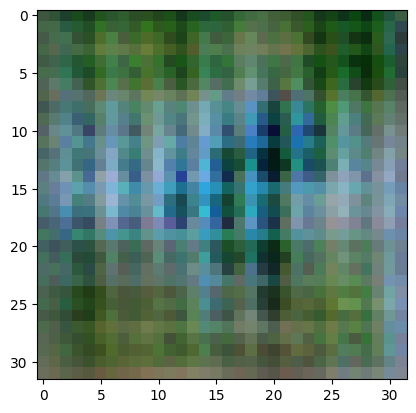

2/2 [==============================] - 0s 6ms/step
>1, 337/390, d1=0.670, d2=0.557 g=1.546


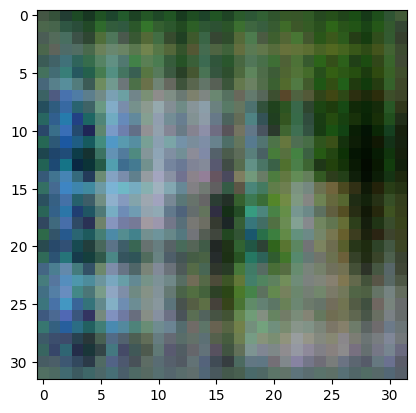

2/2 [==============================] - 0s 6ms/step
>1, 338/390, d1=0.623, d2=0.758 g=2.397


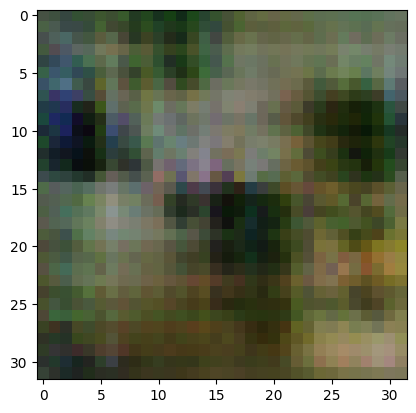

2/2 [==============================] - 0s 6ms/step
>1, 339/390, d1=1.188, d2=0.393 g=1.855


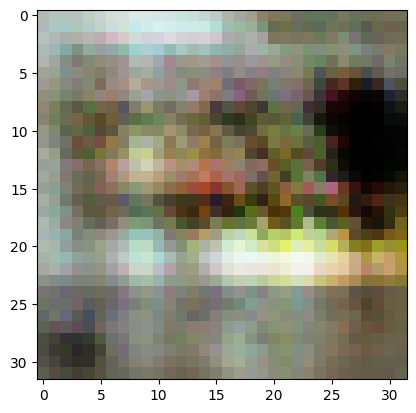

2/2 [==============================] - 0s 6ms/step
>1, 340/390, d1=0.967, d2=0.693 g=1.188


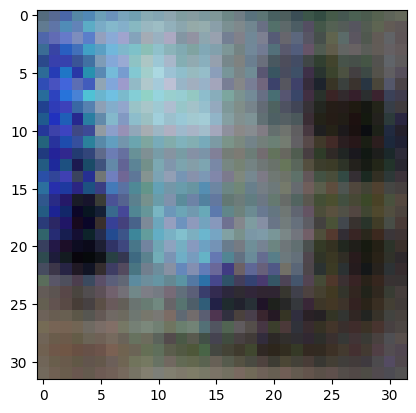

2/2 [==============================] - 0s 6ms/step
>1, 341/390, d1=0.713, d2=0.658 g=1.036


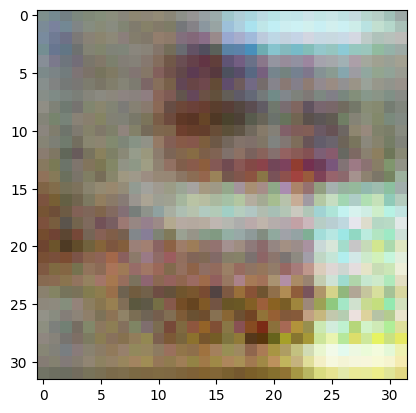

2/2 [==============================] - 0s 7ms/step
>1, 342/390, d1=0.573, d2=0.674 g=0.982


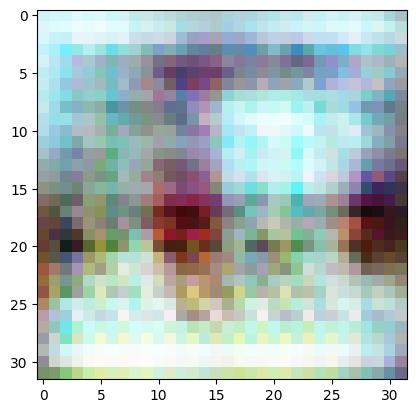

2/2 [==============================] - 0s 9ms/step
>1, 343/390, d1=0.633, d2=0.676 g=0.982


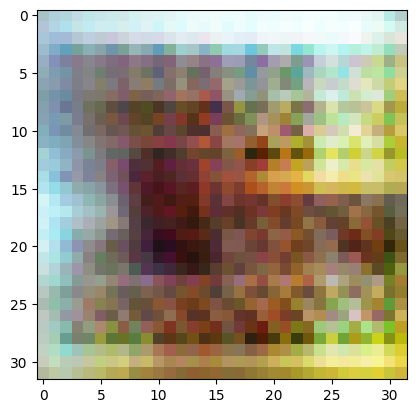

2/2 [==============================] - 0s 7ms/step
>1, 344/390, d1=0.458, d2=0.634 g=1.026


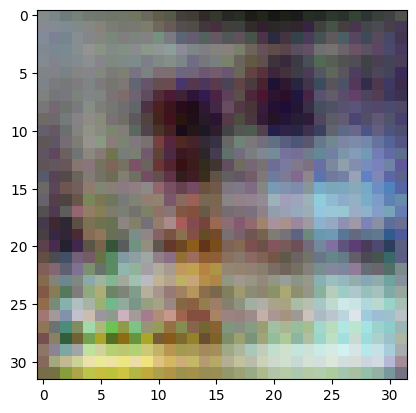

2/2 [==============================] - 0s 7ms/step
>1, 345/390, d1=0.517, d2=0.639 g=1.075


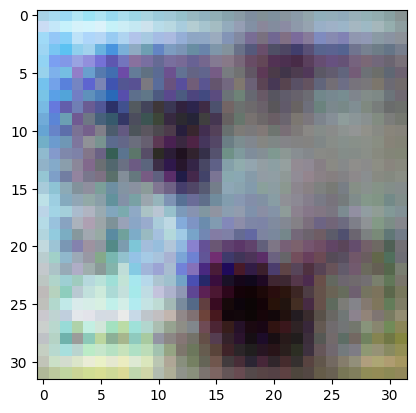

2/2 [==============================] - 0s 9ms/step
>1, 346/390, d1=0.456, d2=0.647 g=1.143


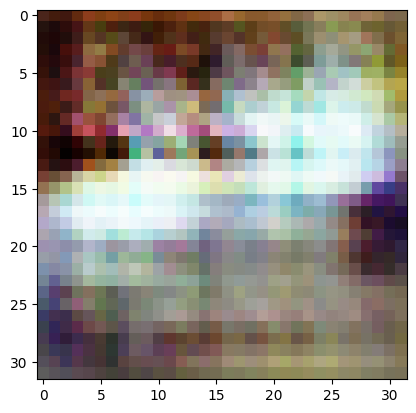

2/2 [==============================] - 0s 6ms/step
>1, 347/390, d1=0.473, d2=0.667 g=1.274


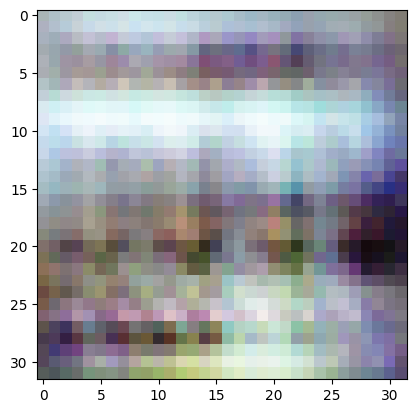

2/2 [==============================] - 0s 6ms/step
>1, 348/390, d1=0.535, d2=0.552 g=1.430


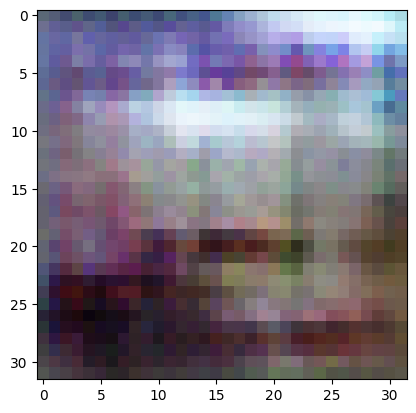

2/2 [==============================] - 0s 10ms/step
>1, 349/390, d1=0.481, d2=0.505 g=1.442


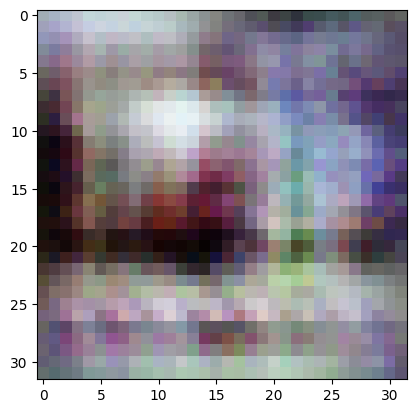

2/2 [==============================] - 0s 6ms/step
>1, 350/390, d1=0.461, d2=0.656 g=1.665


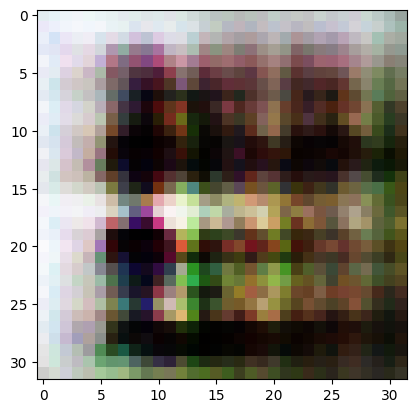

2/2 [==============================] - 0s 10ms/step
>1, 351/390, d1=0.454, d2=0.360 g=1.748


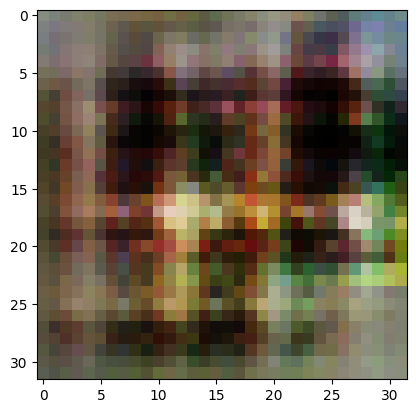

2/2 [==============================] - 0s 8ms/step
>1, 352/390, d1=0.697, d2=0.682 g=1.327


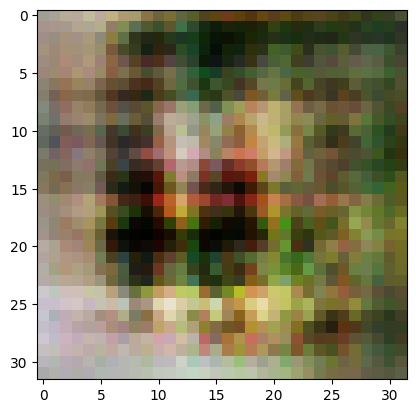

2/2 [==============================] - 0s 7ms/step
>1, 353/390, d1=0.556, d2=0.743 g=1.261


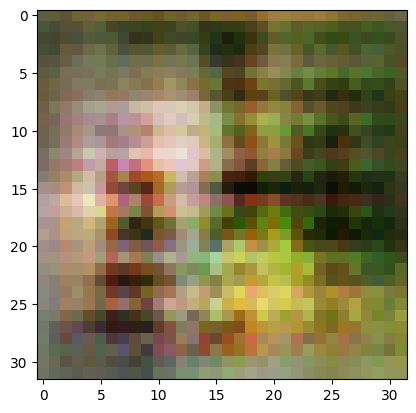

2/2 [==============================] - 0s 7ms/step
>1, 354/390, d1=0.724, d2=0.800 g=1.239


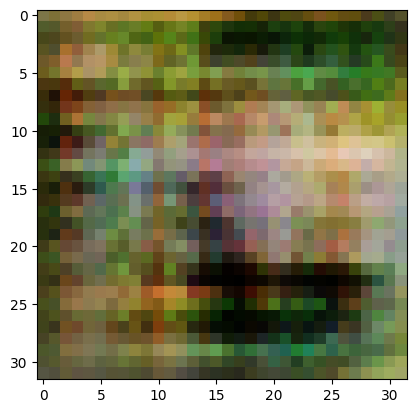

2/2 [==============================] - 0s 7ms/step
>1, 355/390, d1=0.774, d2=0.612 g=1.120


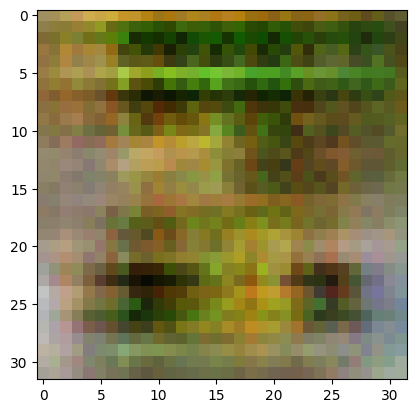

2/2 [==============================] - 0s 6ms/step
>1, 356/390, d1=0.615, d2=0.731 g=1.113


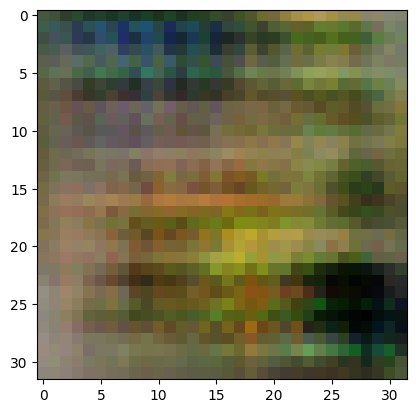

2/2 [==============================] - 0s 6ms/step
>1, 357/390, d1=0.584, d2=0.807 g=1.306


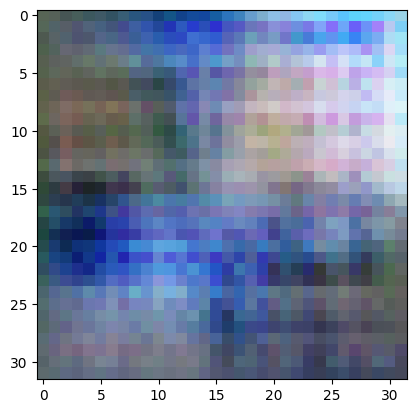

2/2 [==============================] - 0s 7ms/step
>1, 358/390, d1=0.641, d2=0.610 g=1.408


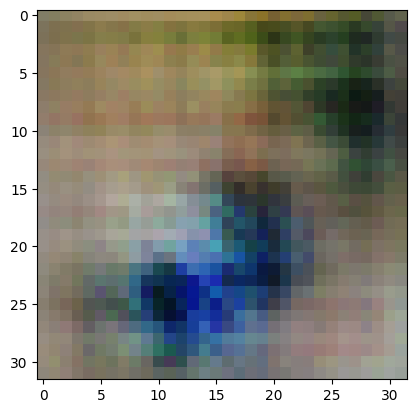

2/2 [==============================] - 0s 6ms/step
>1, 359/390, d1=0.749, d2=0.683 g=1.375


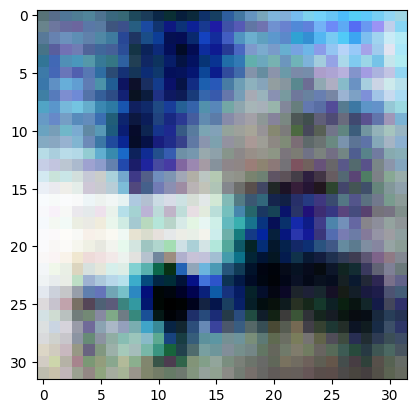

2/2 [==============================] - 0s 6ms/step
>1, 360/390, d1=0.747, d2=0.627 g=1.347


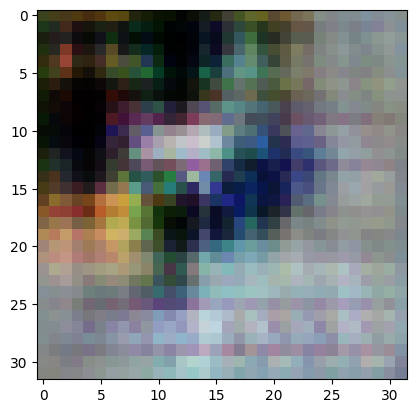

2/2 [==============================] - 0s 6ms/step
>1, 361/390, d1=0.709, d2=0.547 g=1.378


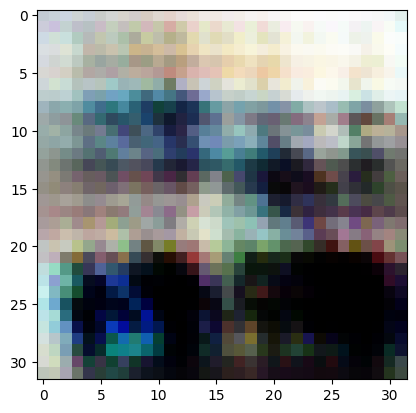

2/2 [==============================] - 0s 7ms/step
>1, 362/390, d1=0.671, d2=0.465 g=1.278


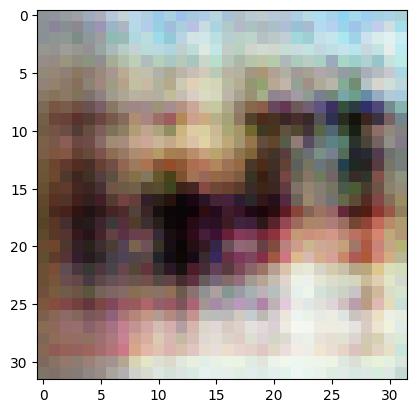

2/2 [==============================] - 0s 9ms/step
>1, 363/390, d1=0.633, d2=0.527 g=1.235


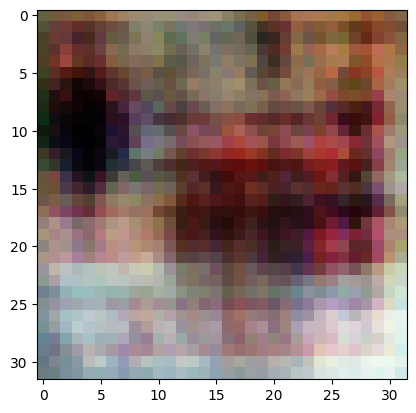

2/2 [==============================] - 0s 7ms/step
>1, 364/390, d1=0.597, d2=0.535 g=1.234


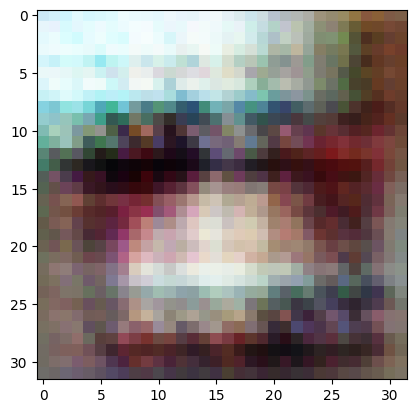

2/2 [==============================] - 0s 6ms/step
>1, 365/390, d1=0.622, d2=0.554 g=1.165


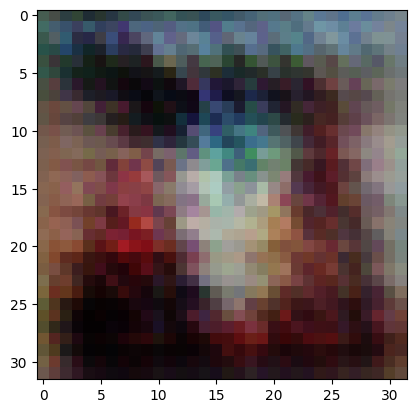

2/2 [==============================] - 0s 7ms/step
>1, 366/390, d1=0.554, d2=0.601 g=1.232


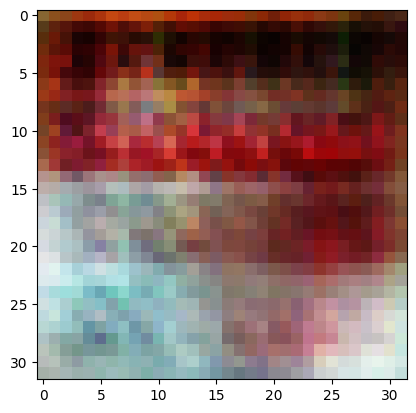

2/2 [==============================] - 0s 6ms/step
>1, 367/390, d1=0.677, d2=0.588 g=1.154


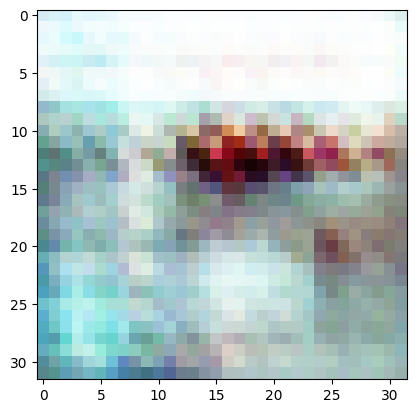

2/2 [==============================] - 0s 6ms/step
>1, 368/390, d1=0.535, d2=0.554 g=1.228


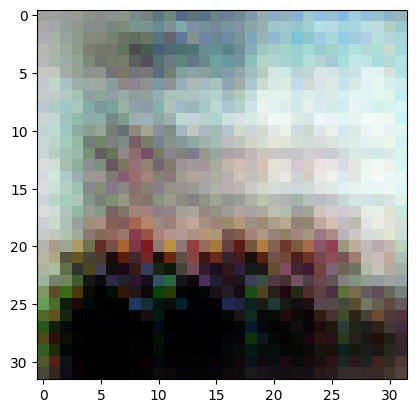

2/2 [==============================] - 0s 10ms/step
>1, 369/390, d1=0.623, d2=0.665 g=1.254


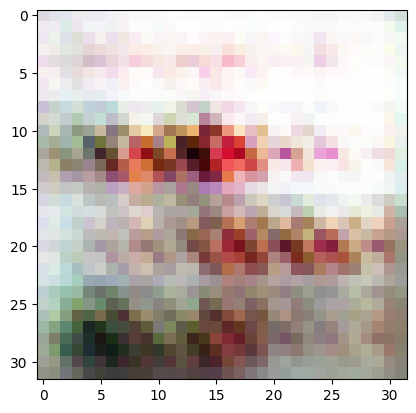

2/2 [==============================] - 0s 7ms/step
>1, 370/390, d1=0.566, d2=0.602 g=1.218


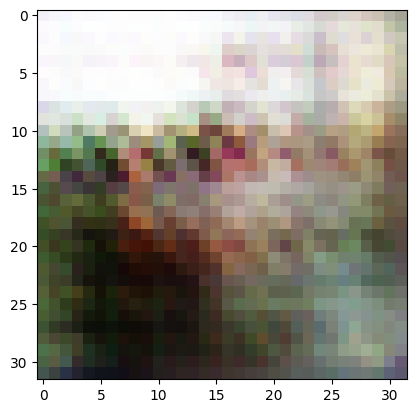

2/2 [==============================] - 0s 7ms/step
>1, 371/390, d1=0.420, d2=0.599 g=1.339


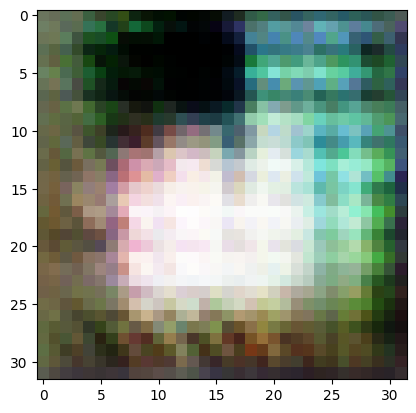

2/2 [==============================] - 0s 7ms/step
>1, 372/390, d1=0.579, d2=0.450 g=1.308


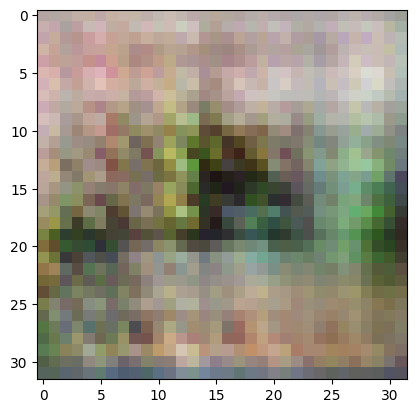

2/2 [==============================] - 0s 12ms/step
>1, 373/390, d1=0.420, d2=0.663 g=1.412


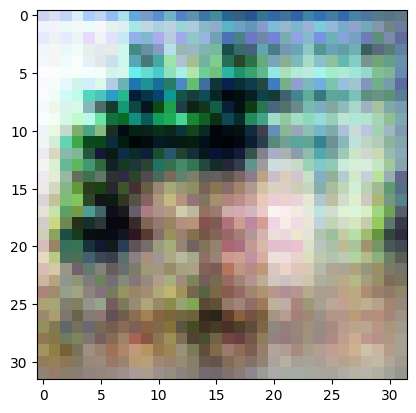

2/2 [==============================] - 0s 7ms/step
>1, 374/390, d1=0.369, d2=0.895 g=1.768


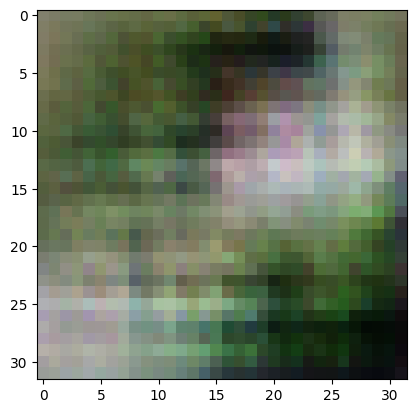

2/2 [==============================] - 0s 7ms/step
>1, 375/390, d1=0.879, d2=0.382 g=1.563


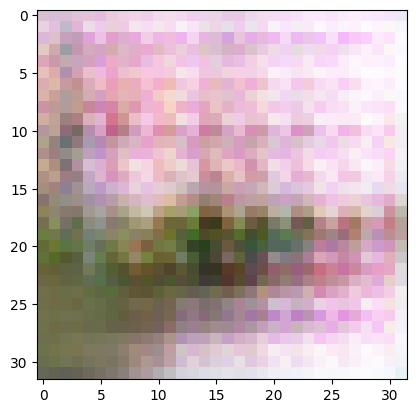

2/2 [==============================] - 0s 7ms/step
>1, 376/390, d1=0.723, d2=0.509 g=1.207


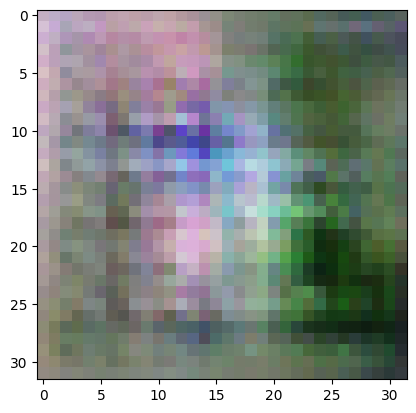

2/2 [==============================] - 0s 7ms/step
>1, 377/390, d1=0.499, d2=0.752 g=1.229


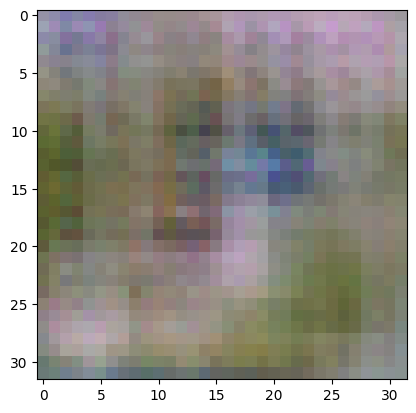

2/2 [==============================] - 0s 7ms/step
>1, 378/390, d1=0.499, d2=0.997 g=1.788


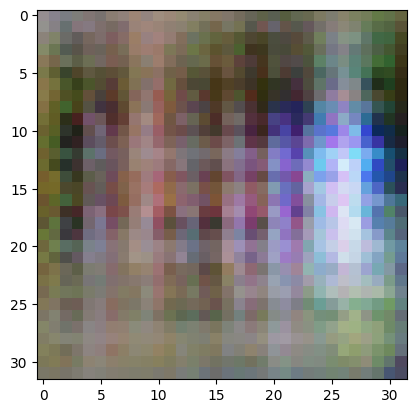

2/2 [==============================] - 0s 7ms/step
>1, 379/390, d1=0.614, d2=0.302 g=1.795


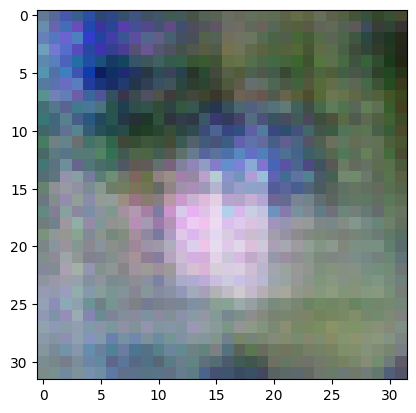

2/2 [==============================] - 0s 7ms/step
>1, 380/390, d1=0.513, d2=1.079 g=1.617


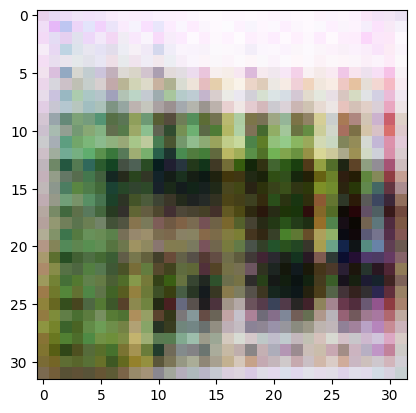

2/2 [==============================] - 0s 8ms/step
>1, 381/390, d1=0.696, d2=0.639 g=1.650


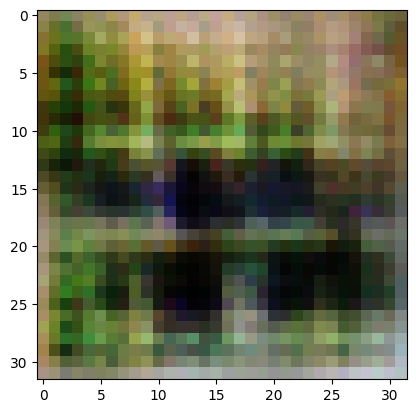

2/2 [==============================] - 0s 6ms/step
>1, 382/390, d1=0.750, d2=0.964 g=1.801


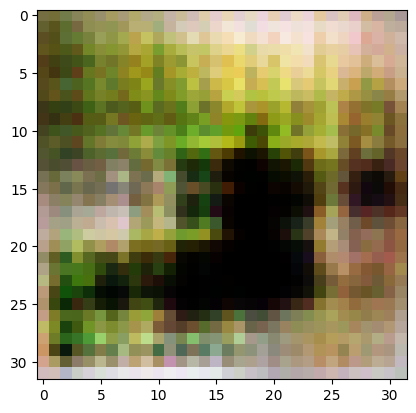

2/2 [==============================] - 0s 7ms/step
>1, 383/390, d1=1.021, d2=0.565 g=1.589


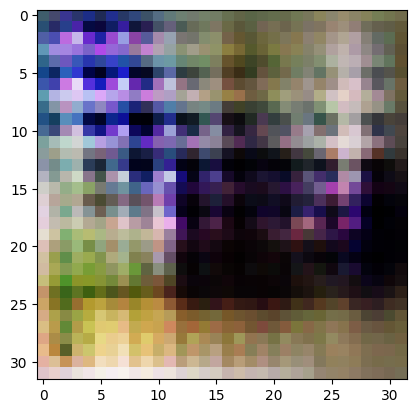

2/2 [==============================] - 0s 7ms/step
>1, 384/390, d1=0.872, d2=0.512 g=1.601


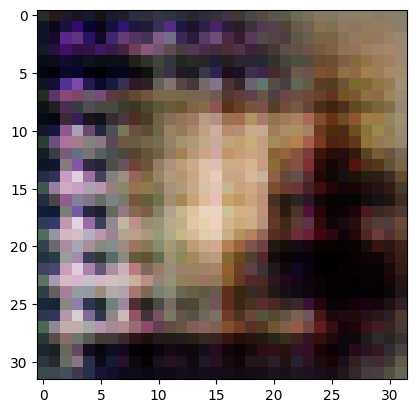

2/2 [==============================] - 0s 6ms/step
>1, 385/390, d1=0.814, d2=0.380 g=1.611


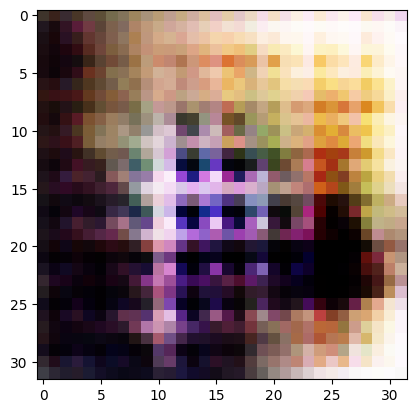

2/2 [==============================] - 0s 6ms/step
>1, 386/390, d1=0.743, d2=0.366 g=1.563


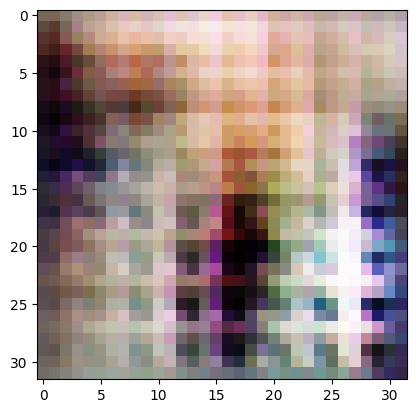

2/2 [==============================] - 0s 7ms/step
>1, 387/390, d1=0.608, d2=0.382 g=1.684


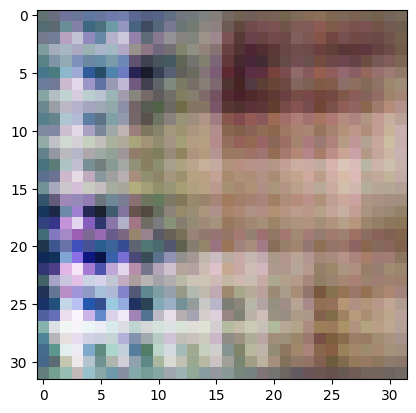

2/2 [==============================] - 0s 6ms/step
>1, 388/390, d1=0.659, d2=0.687 g=1.584


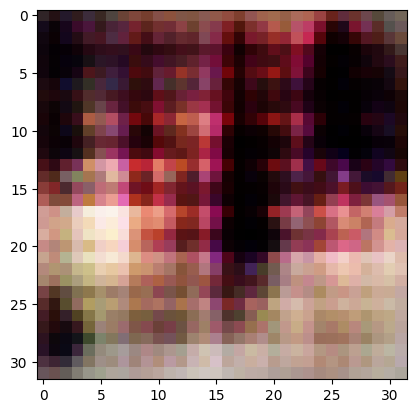

2/2 [==============================] - 0s 7ms/step
>1, 389/390, d1=0.662, d2=0.515 g=1.345


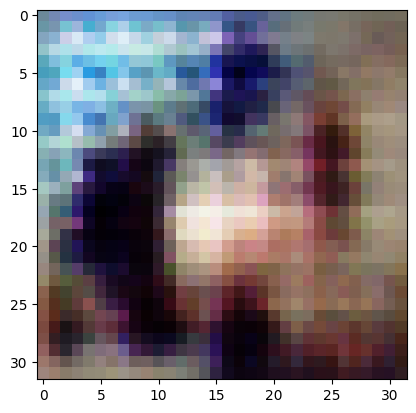

2/2 [==============================] - 0s 6ms/step
>1, 390/390, d1=0.730, d2=0.507 g=1.173


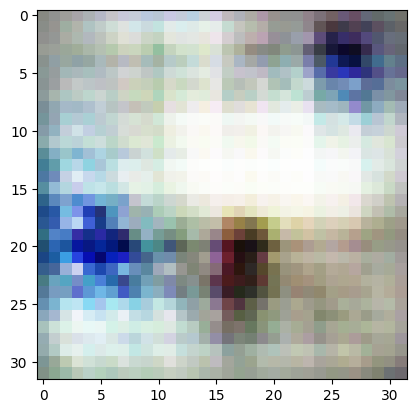

2/2 [==============================] - 0s 7ms/step
>2, 1/390, d1=0.664, d2=0.581 g=1.127


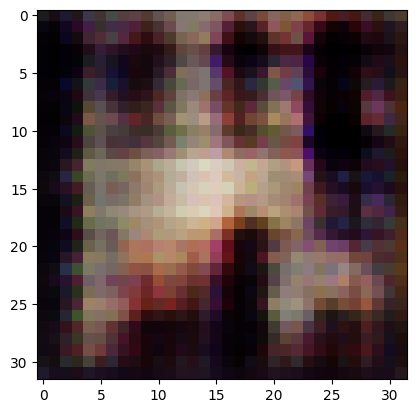

2/2 [==============================] - 0s 6ms/step
>2, 2/390, d1=0.533, d2=0.587 g=1.061


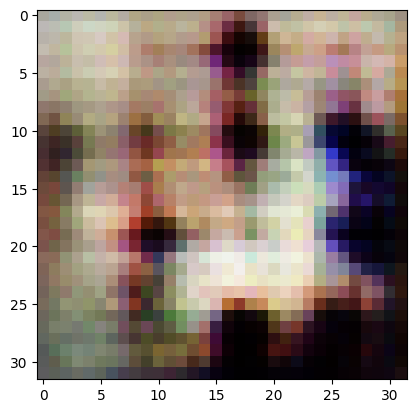

2/2 [==============================] - 0s 6ms/step
>2, 3/390, d1=0.568, d2=0.622 g=1.027


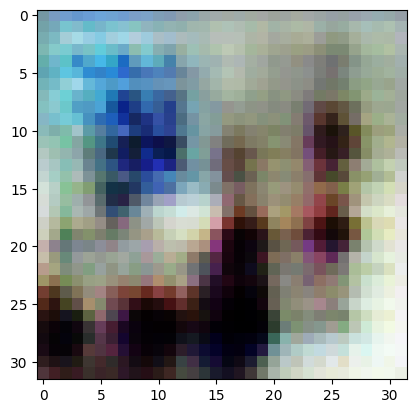

2/2 [==============================] - 0s 6ms/step
>2, 4/390, d1=0.525, d2=0.635 g=1.035


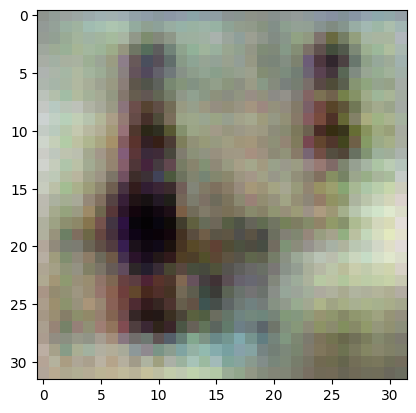

2/2 [==============================] - 0s 7ms/step
>2, 5/390, d1=0.499, d2=0.661 g=1.075


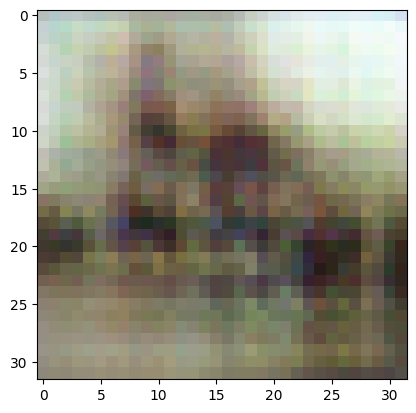

2/2 [==============================] - 0s 6ms/step
>2, 6/390, d1=0.484, d2=0.671 g=1.232


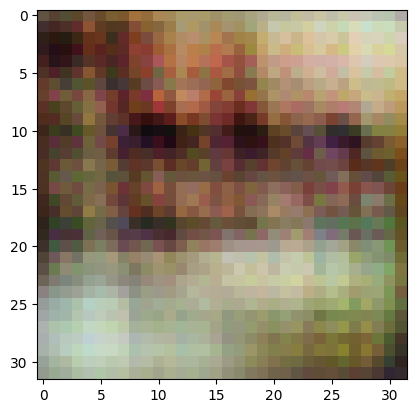

2/2 [==============================] - 0s 6ms/step
>2, 7/390, d1=0.477, d2=0.495 g=1.318


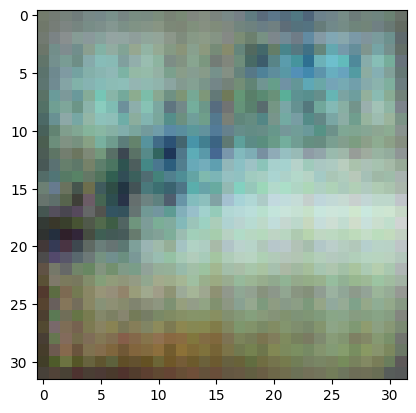

2/2 [==============================] - 0s 7ms/step
>2, 8/390, d1=0.599, d2=0.481 g=1.301


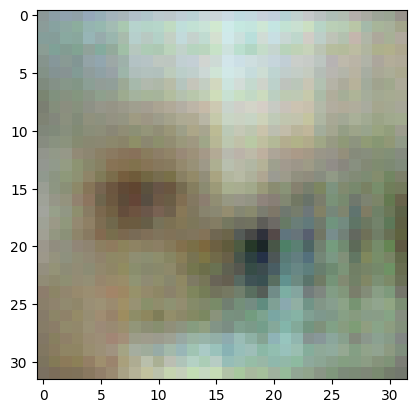

2/2 [==============================] - 0s 7ms/step
>2, 9/390, d1=0.527, d2=0.603 g=1.253


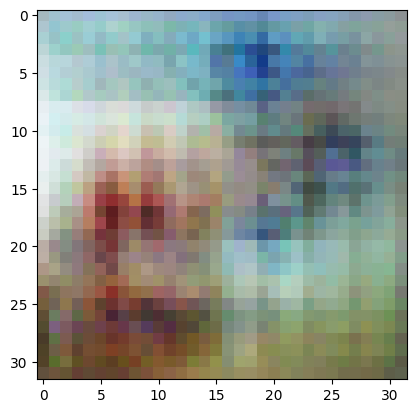

2/2 [==============================] - 0s 7ms/step
>2, 10/390, d1=0.577, d2=0.587 g=1.258


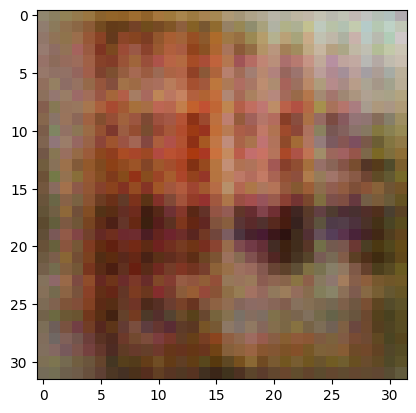

2/2 [==============================] - 0s 6ms/step
>2, 11/390, d1=0.529, d2=0.559 g=1.228


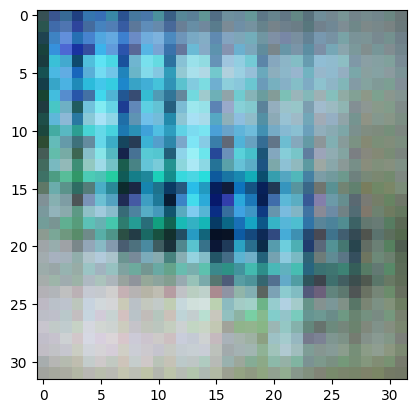

2/2 [==============================] - 0s 6ms/step
>2, 12/390, d1=0.542, d2=0.675 g=1.289


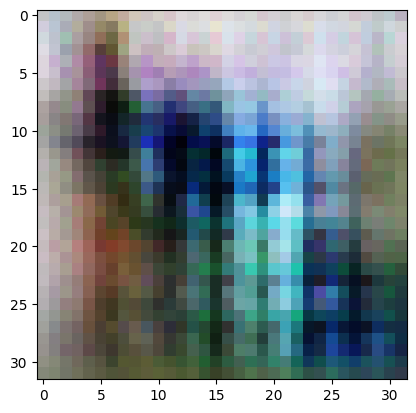

2/2 [==============================] - 0s 7ms/step
>2, 13/390, d1=0.625, d2=0.648 g=1.417


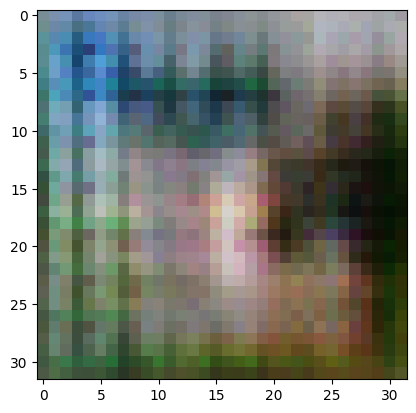

2/2 [==============================] - 0s 8ms/step
>2, 14/390, d1=0.559, d2=0.547 g=1.583


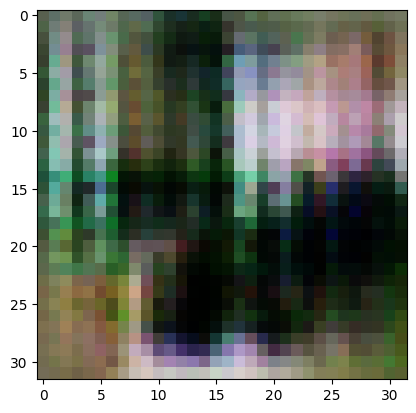

2/2 [==============================] - 0s 7ms/step
>2, 15/390, d1=0.624, d2=0.555 g=1.503


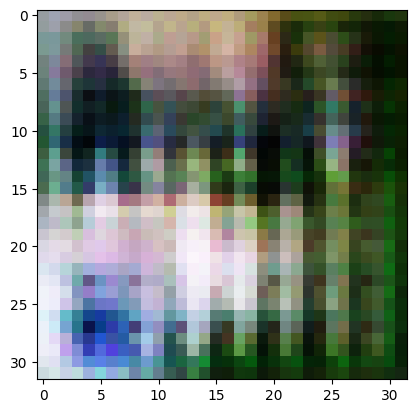

2/2 [==============================] - 0s 6ms/step
>2, 16/390, d1=0.510, d2=0.813 g=1.799


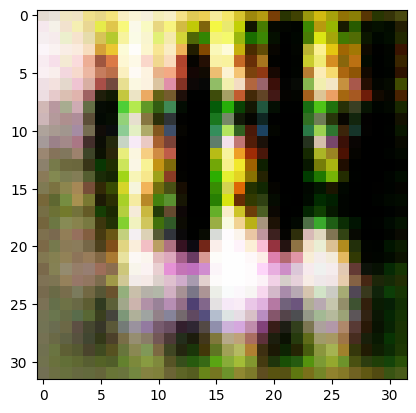

2/2 [==============================] - 0s 7ms/step
>2, 17/390, d1=0.827, d2=0.516 g=1.974


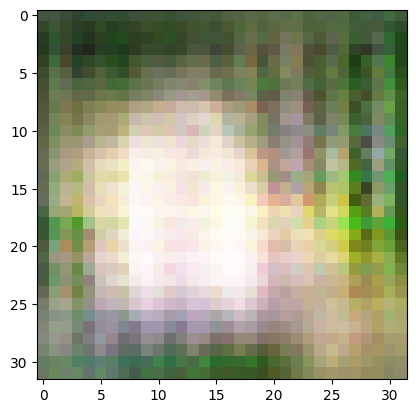

2/2 [==============================] - 0s 6ms/step
>2, 18/390, d1=0.556, d2=0.513 g=2.214


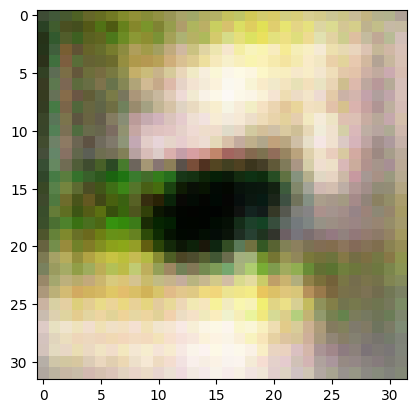

2/2 [==============================] - 0s 7ms/step
>2, 19/390, d1=0.696, d2=0.863 g=1.574


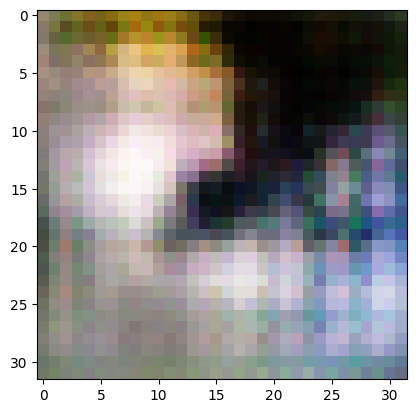

2/2 [==============================] - 0s 6ms/step
>2, 20/390, d1=0.782, d2=0.876 g=1.484


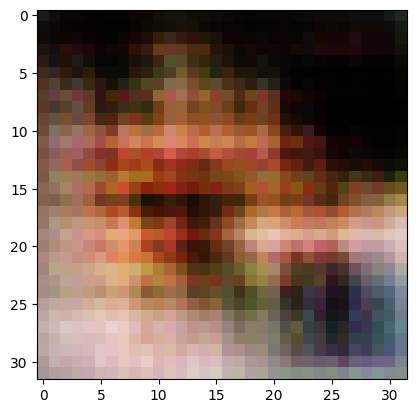

2/2 [==============================] - 0s 6ms/step
>2, 21/390, d1=1.015, d2=0.678 g=1.427


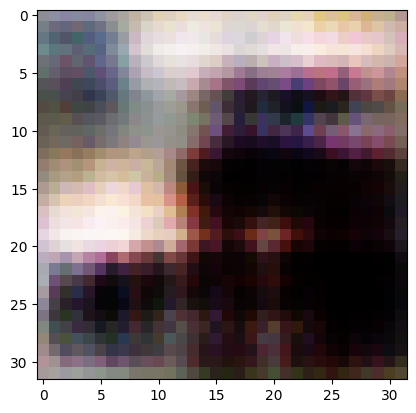

2/2 [==============================] - 0s 6ms/step
>2, 22/390, d1=0.874, d2=0.502 g=1.347


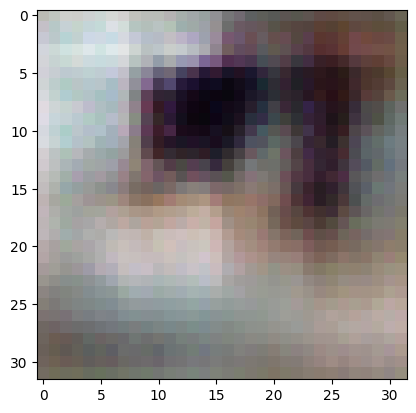

2/2 [==============================] - 0s 6ms/step
>2, 23/390, d1=0.667, d2=0.591 g=1.211


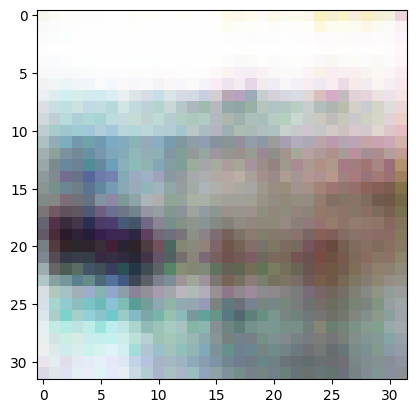

2/2 [==============================] - 0s 7ms/step
>2, 24/390, d1=0.670, d2=0.599 g=1.114


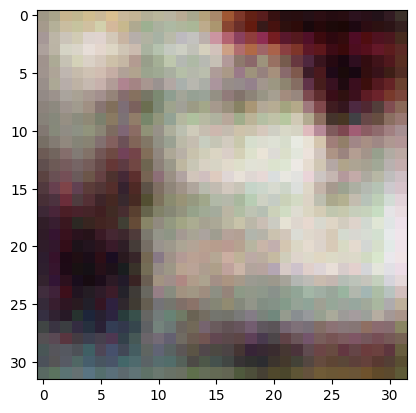

2/2 [==============================] - 0s 6ms/step
>2, 25/390, d1=0.574, d2=0.589 g=1.091


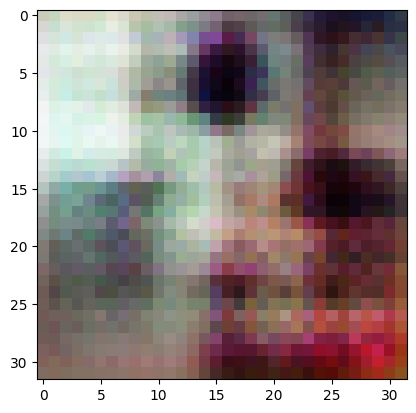

2/2 [==============================] - 0s 7ms/step
>2, 26/390, d1=0.627, d2=0.634 g=1.166


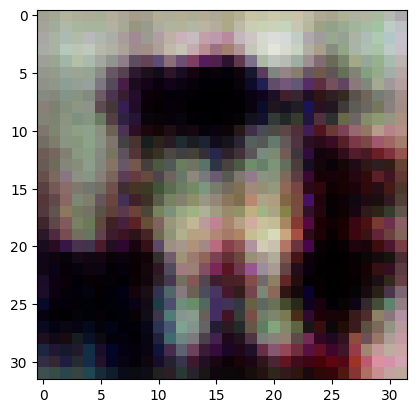

2/2 [==============================] - 0s 6ms/step
>2, 27/390, d1=0.596, d2=0.576 g=1.197


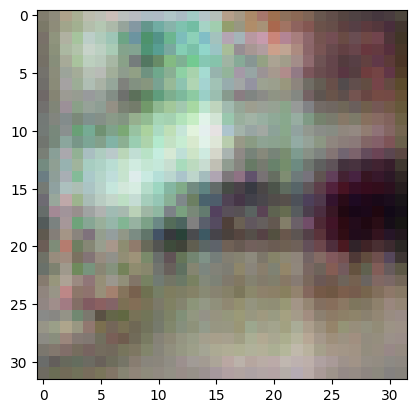

2/2 [==============================] - 0s 7ms/step
>2, 28/390, d1=0.463, d2=0.632 g=1.273


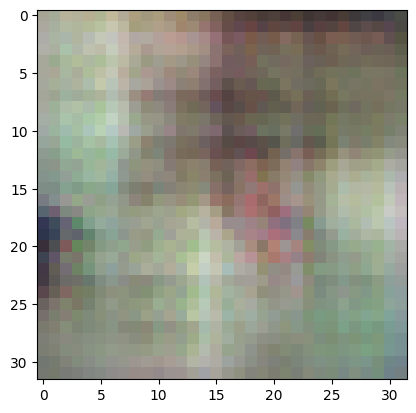

2/2 [==============================] - 0s 6ms/step
>2, 29/390, d1=0.548, d2=0.520 g=1.281


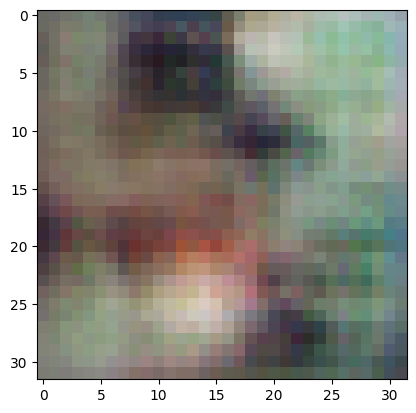

2/2 [==============================] - 0s 6ms/step
>2, 30/390, d1=0.519, d2=0.557 g=1.454


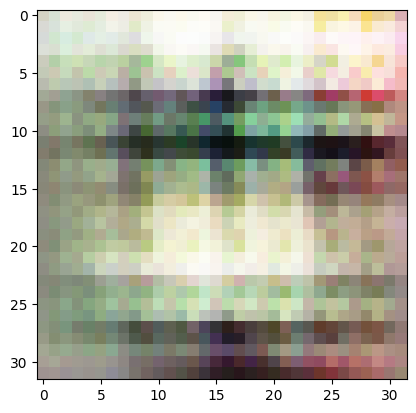

2/2 [==============================] - 0s 6ms/step
>2, 31/390, d1=0.438, d2=0.443 g=1.530


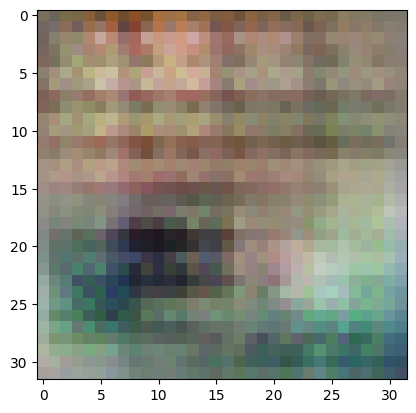

2/2 [==============================] - 0s 9ms/step
>2, 32/390, d1=0.461, d2=0.690 g=1.469


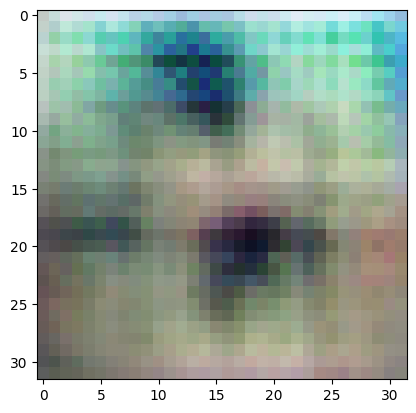

2/2 [==============================] - 0s 6ms/step
>2, 33/390, d1=0.448, d2=0.974 g=1.420


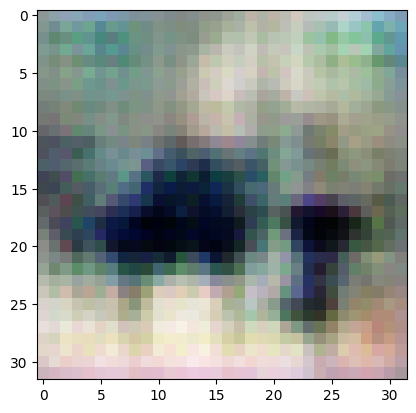

2/2 [==============================] - 0s 6ms/step
>2, 34/390, d1=0.649, d2=0.684 g=1.577


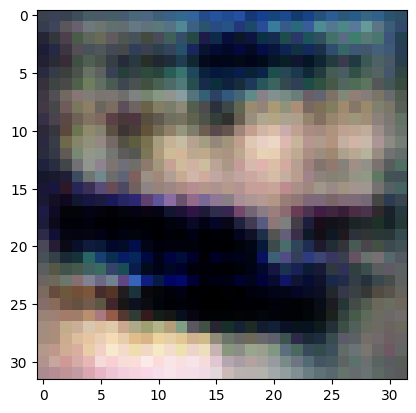

2/2 [==============================] - 0s 11ms/step
>2, 35/390, d1=0.967, d2=0.467 g=1.462


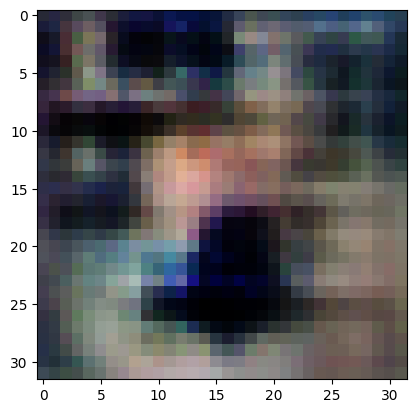

2/2 [==============================] - 0s 7ms/step
>2, 36/390, d1=0.590, d2=0.473 g=1.521


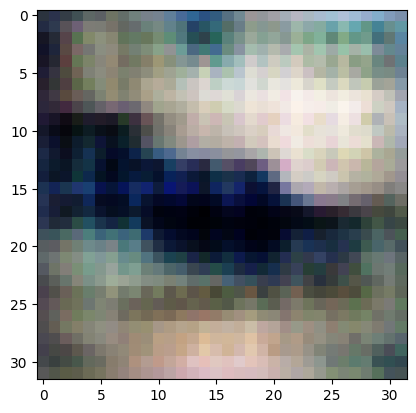

2/2 [==============================] - 0s 10ms/step
>2, 37/390, d1=0.532, d2=0.566 g=1.666


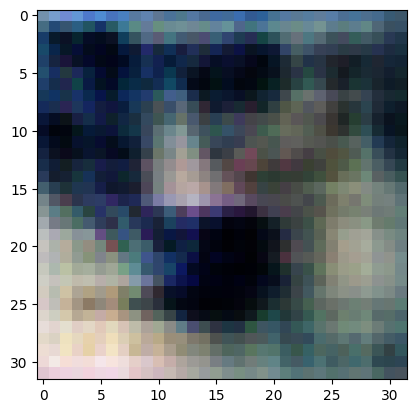

2/2 [==============================] - 0s 8ms/step
>2, 38/390, d1=0.397, d2=0.463 g=1.999


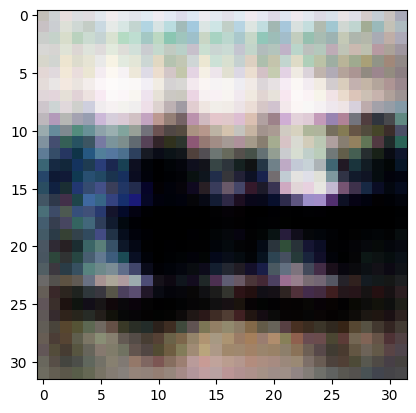

2/2 [==============================] - 0s 8ms/step
>2, 39/390, d1=0.519, d2=0.520 g=1.925


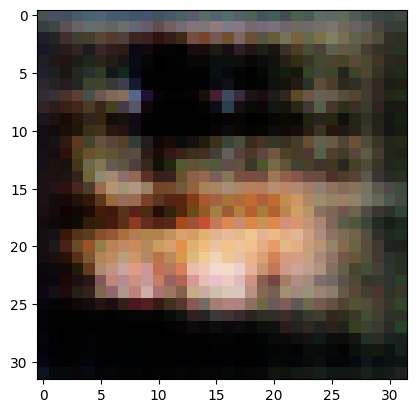

2/2 [==============================] - 0s 7ms/step
>2, 40/390, d1=0.745, d2=0.569 g=1.778


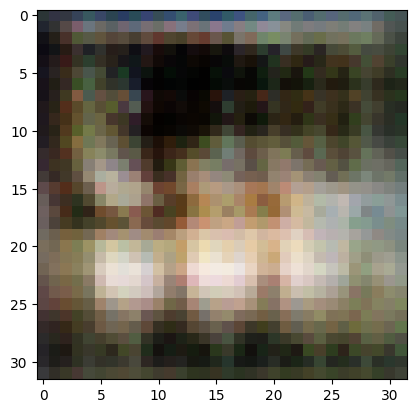

2/2 [==============================] - 0s 7ms/step
>2, 41/390, d1=0.715, d2=0.553 g=1.769


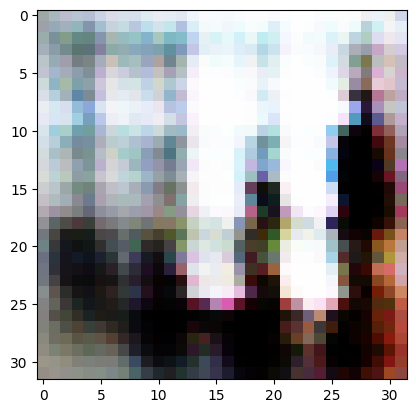

2/2 [==============================] - 0s 7ms/step
>2, 42/390, d1=0.801, d2=0.990 g=1.935


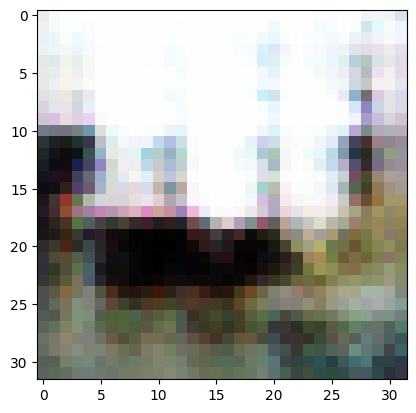

2/2 [==============================] - 0s 7ms/step
>2, 43/390, d1=0.851, d2=0.481 g=1.480


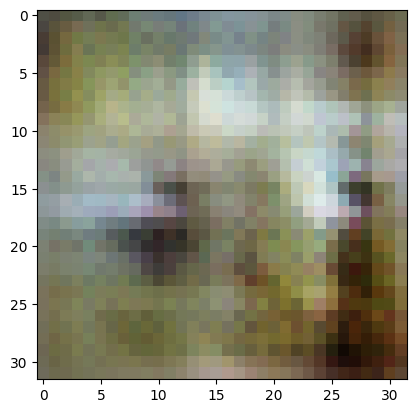

2/2 [==============================] - 0s 7ms/step
>2, 44/390, d1=0.842, d2=0.750 g=1.357


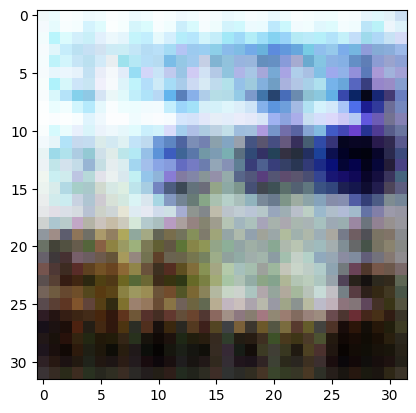

2/2 [==============================] - 0s 7ms/step
>2, 45/390, d1=0.733, d2=0.611 g=1.285


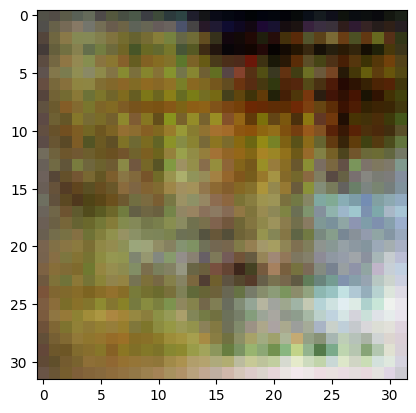

2/2 [==============================] - 0s 7ms/step
>2, 46/390, d1=0.865, d2=0.585 g=1.099


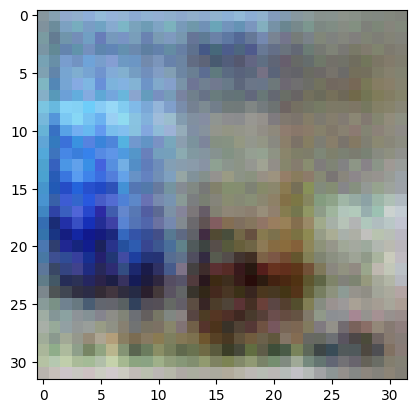

2/2 [==============================] - 0s 8ms/step
>2, 47/390, d1=0.766, d2=0.581 g=1.021


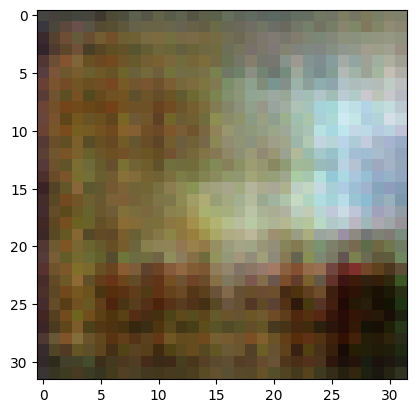

2/2 [==============================] - 0s 5ms/step
>2, 48/390, d1=0.622, d2=0.619 g=1.016


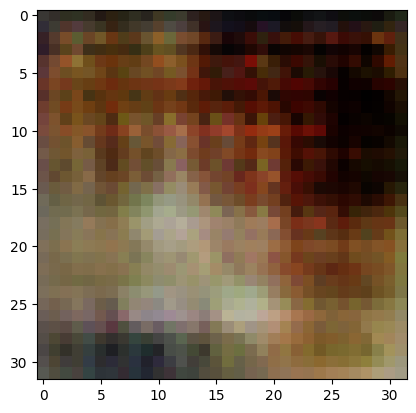

2/2 [==============================] - 0s 6ms/step
>2, 49/390, d1=0.640, d2=0.650 g=1.066


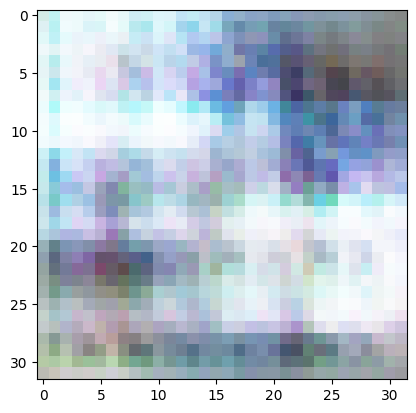

2/2 [==============================] - 0s 7ms/step
>2, 50/390, d1=0.576, d2=0.602 g=1.171


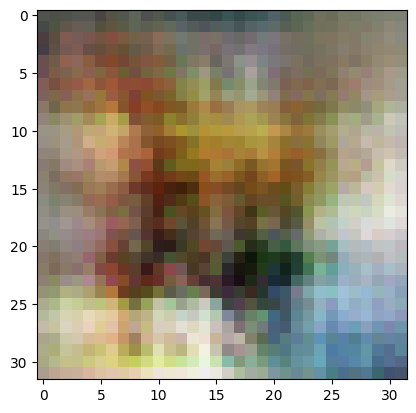

2/2 [==============================] - 0s 6ms/step
>2, 51/390, d1=0.586, d2=0.637 g=1.162


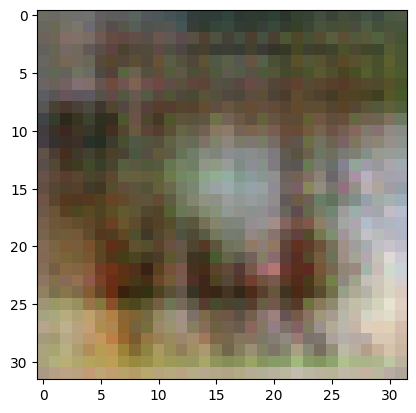

2/2 [==============================] - 0s 6ms/step
>2, 52/390, d1=0.642, d2=0.552 g=1.236


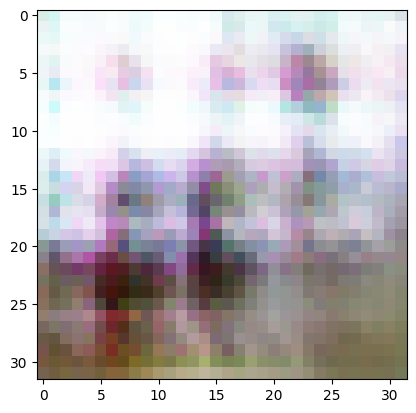

2/2 [==============================] - 0s 6ms/step
>2, 53/390, d1=0.717, d2=0.508 g=1.219


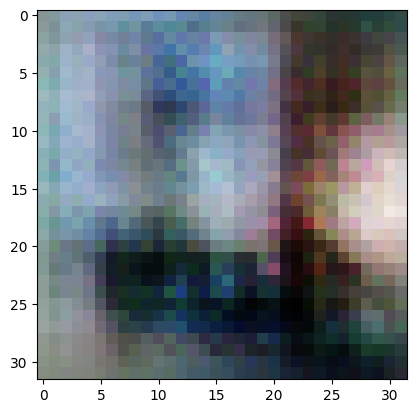

2/2 [==============================] - 0s 6ms/step
>2, 54/390, d1=0.627, d2=0.548 g=1.249


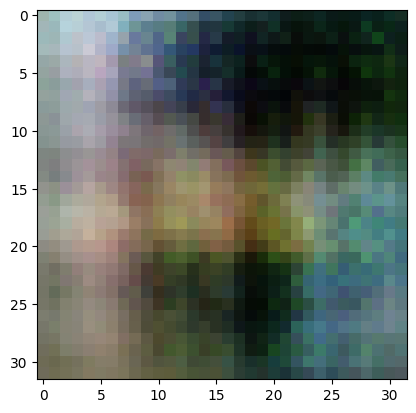

2/2 [==============================] - 0s 7ms/step
>2, 55/390, d1=0.640, d2=0.598 g=1.357


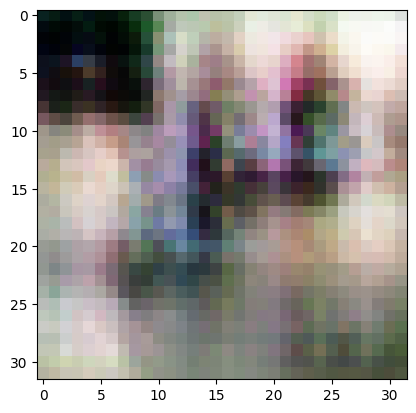

2/2 [==============================] - 0s 7ms/step
>2, 56/390, d1=0.564, d2=0.484 g=1.513


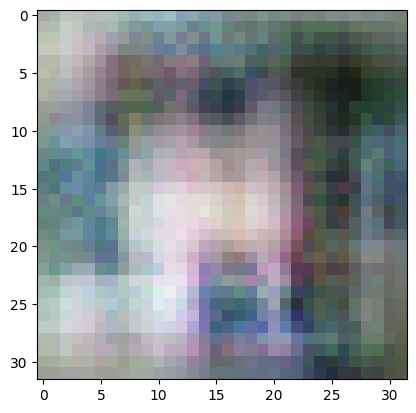

2/2 [==============================] - 0s 7ms/step
>2, 57/390, d1=0.499, d2=0.547 g=1.444


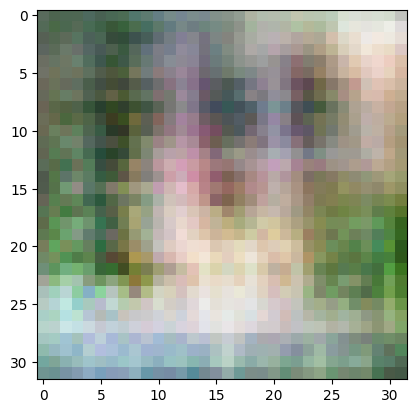

2/2 [==============================] - 0s 7ms/step
>2, 58/390, d1=0.465, d2=0.730 g=1.469


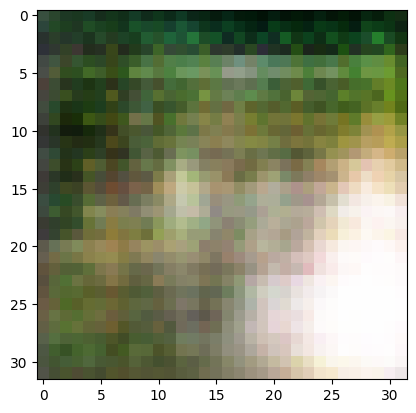

2/2 [==============================] - 0s 6ms/step
>2, 59/390, d1=0.467, d2=0.619 g=1.590


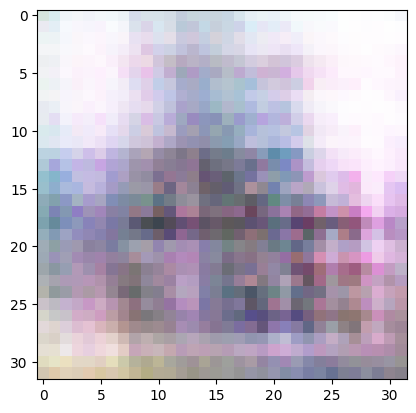

2/2 [==============================] - 0s 7ms/step
>2, 60/390, d1=0.499, d2=0.559 g=1.914


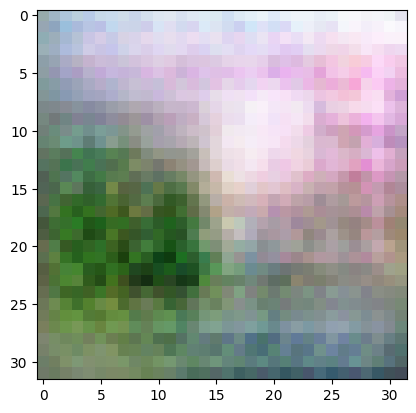

2/2 [==============================] - 0s 9ms/step
>2, 61/390, d1=0.481, d2=0.753 g=2.321


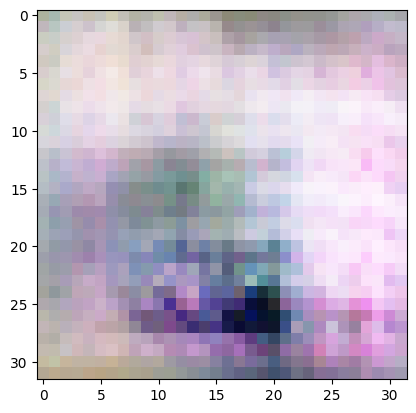

2/2 [==============================] - 0s 7ms/step
>2, 62/390, d1=0.826, d2=1.139 g=1.609


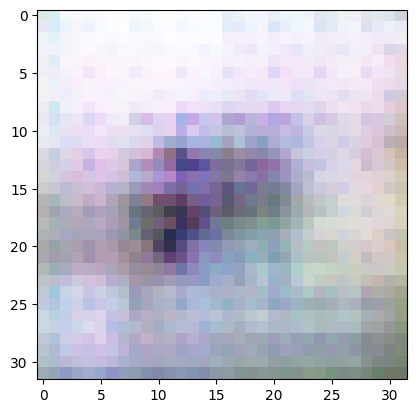

2/2 [==============================] - 0s 11ms/step
>2, 63/390, d1=0.986, d2=0.680 g=1.408


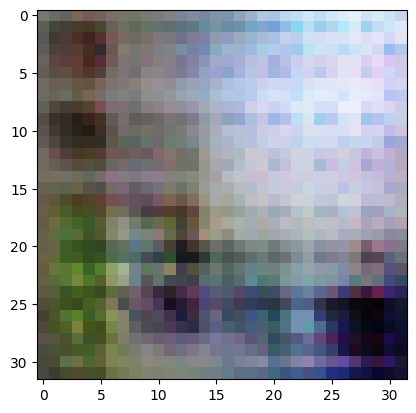

2/2 [==============================] - 0s 8ms/step
>2, 64/390, d1=0.932, d2=0.501 g=1.337


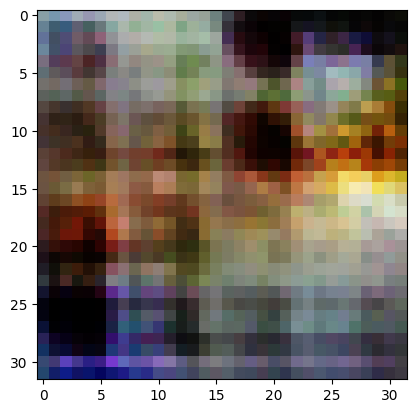

2/2 [==============================] - 0s 7ms/step
>2, 65/390, d1=0.609, d2=0.506 g=1.512


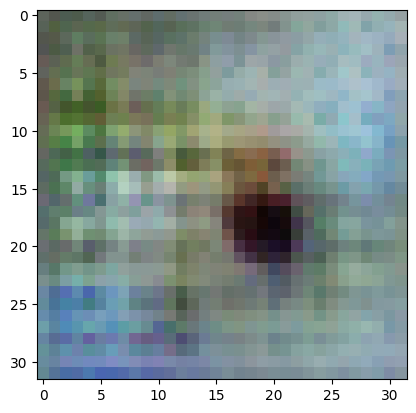

2/2 [==============================] - 0s 8ms/step
>2, 66/390, d1=0.522, d2=0.658 g=1.690


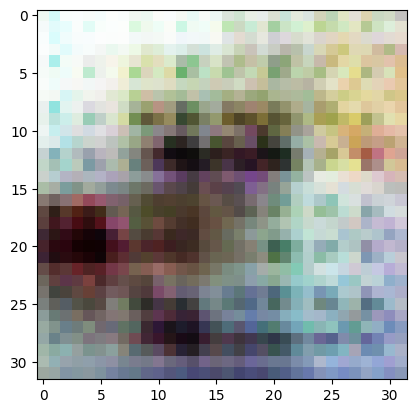

2/2 [==============================] - 0s 7ms/step
>2, 67/390, d1=0.515, d2=0.527 g=1.640


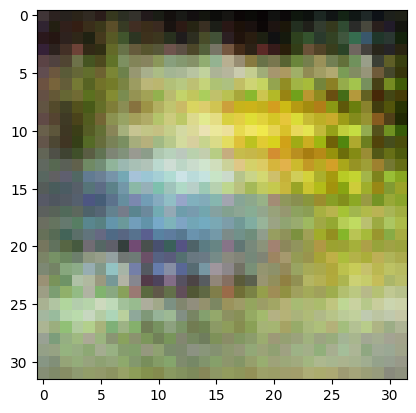

2/2 [==============================] - 0s 8ms/step
>2, 68/390, d1=0.641, d2=0.769 g=1.437


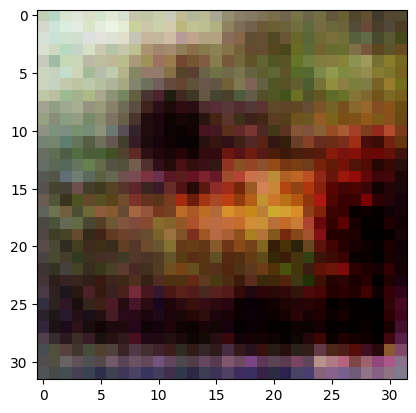

2/2 [==============================] - 0s 6ms/step
>2, 69/390, d1=0.588, d2=0.590 g=1.332


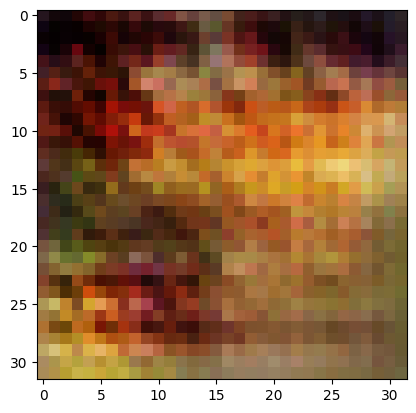

2/2 [==============================] - 0s 7ms/step
>2, 70/390, d1=0.642, d2=0.798 g=1.312


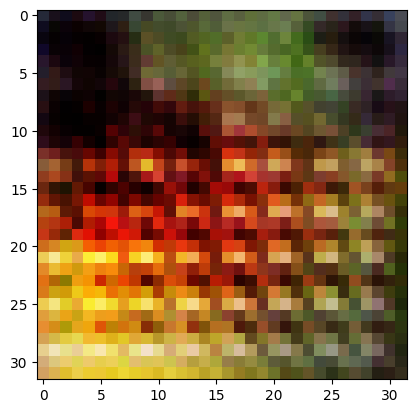

2/2 [==============================] - 0s 7ms/step
>2, 71/390, d1=0.680, d2=0.708 g=1.383


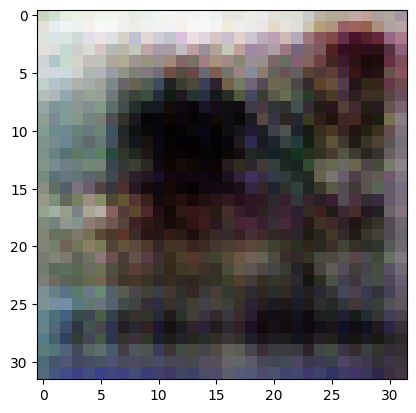

2/2 [==============================] - 0s 7ms/step
>2, 72/390, d1=0.723, d2=0.501 g=1.510


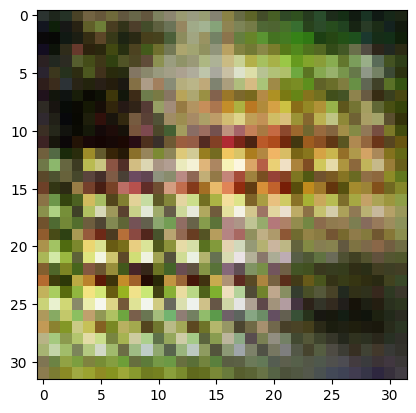

2/2 [==============================] - 0s 9ms/step
>2, 73/390, d1=0.642, d2=0.603 g=1.450


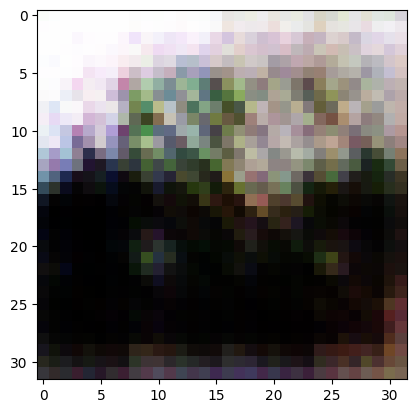

2/2 [==============================] - 0s 7ms/step
>2, 74/390, d1=0.712, d2=0.627 g=1.377


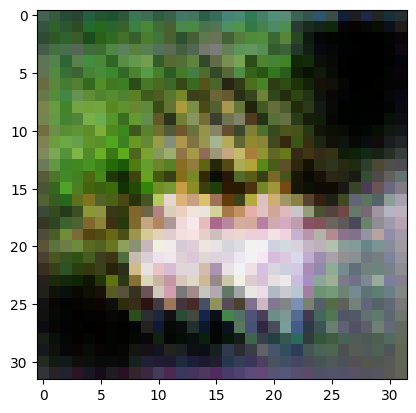

2/2 [==============================] - 0s 7ms/step
>2, 75/390, d1=0.676, d2=0.738 g=1.112


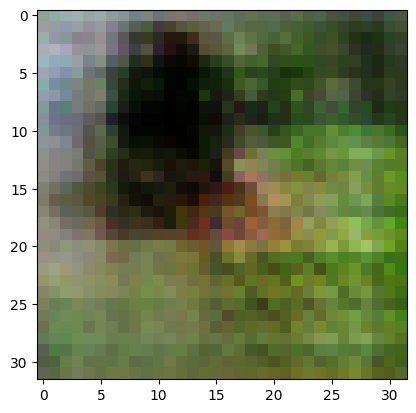

2/2 [==============================] - 0s 6ms/step
>2, 76/390, d1=0.638, d2=0.755 g=0.947


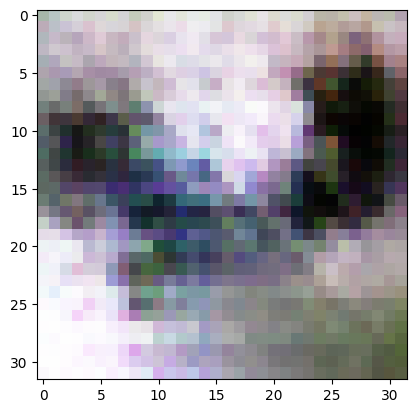

2/2 [==============================] - 0s 8ms/step
>2, 77/390, d1=0.625, d2=0.676 g=1.008


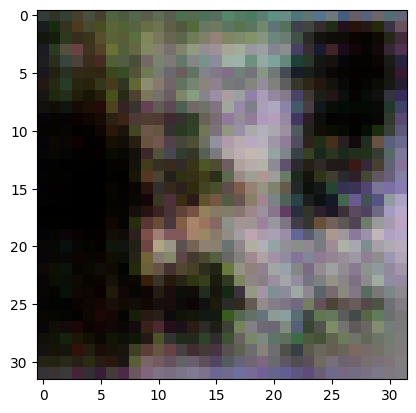

2/2 [==============================] - 0s 7ms/step
>2, 78/390, d1=0.619, d2=0.630 g=1.024


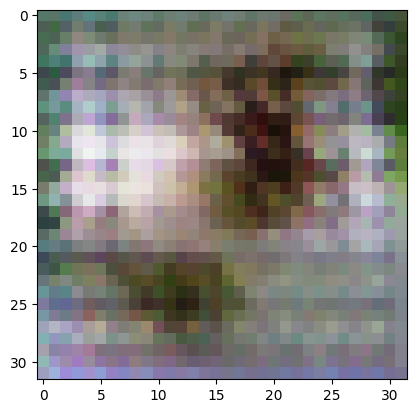

2/2 [==============================] - 0s 7ms/step
>2, 79/390, d1=0.545, d2=0.521 g=1.047


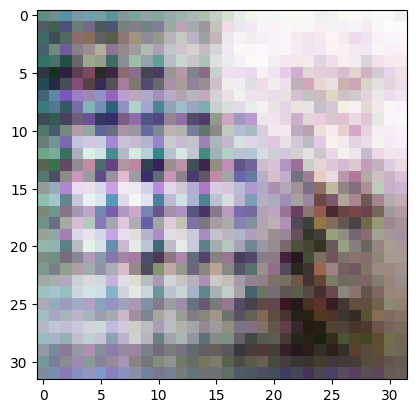

2/2 [==============================] - 0s 6ms/step
>2, 80/390, d1=0.440, d2=0.609 g=1.099


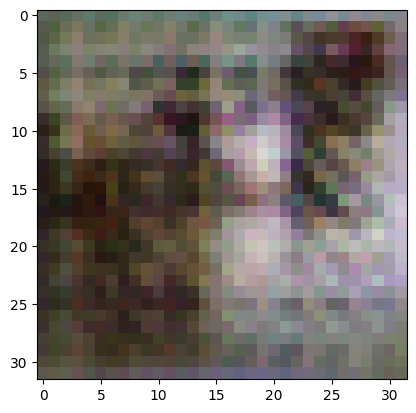

2/2 [==============================] - 0s 8ms/step
>2, 81/390, d1=0.480, d2=0.652 g=1.182


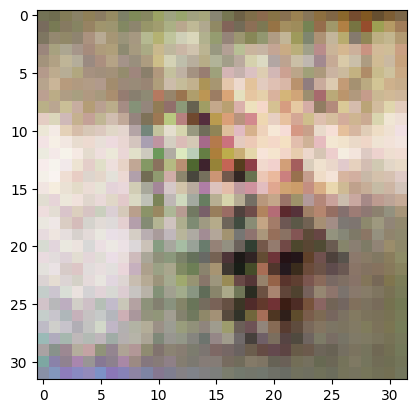

2/2 [==============================] - 0s 7ms/step
>2, 82/390, d1=0.412, d2=0.506 g=1.255


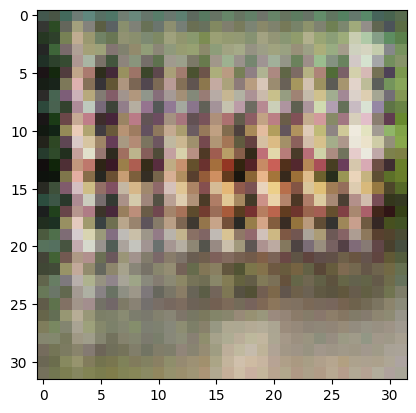

2/2 [==============================] - 0s 7ms/step
>2, 83/390, d1=0.442, d2=0.497 g=1.350


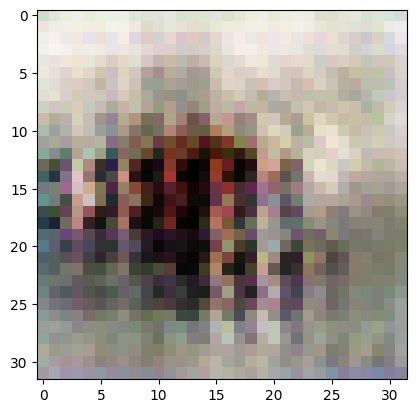

2/2 [==============================] - 0s 7ms/step
>2, 84/390, d1=0.403, d2=0.512 g=1.537


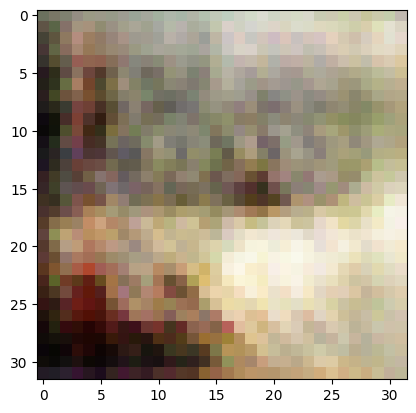

2/2 [==============================] - 0s 7ms/step
>2, 85/390, d1=0.307, d2=0.480 g=1.562


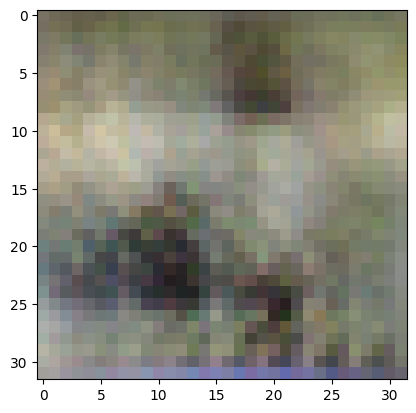

2/2 [==============================] - 0s 11ms/step
>2, 86/390, d1=0.376, d2=1.208 g=1.354


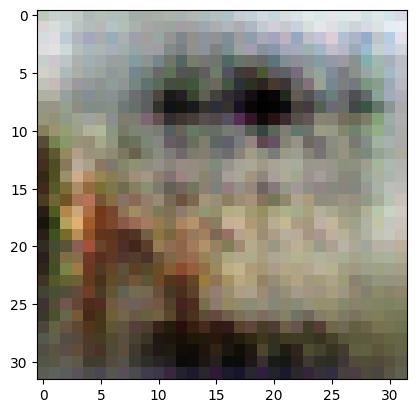

2/2 [==============================] - 0s 6ms/step
>2, 87/390, d1=0.505, d2=2.999 g=1.725


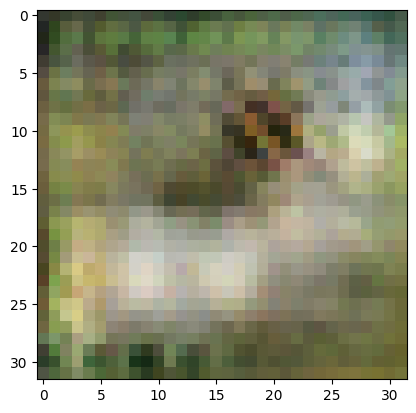

2/2 [==============================] - 0s 6ms/step
>2, 88/390, d1=1.141, d2=0.448 g=1.243


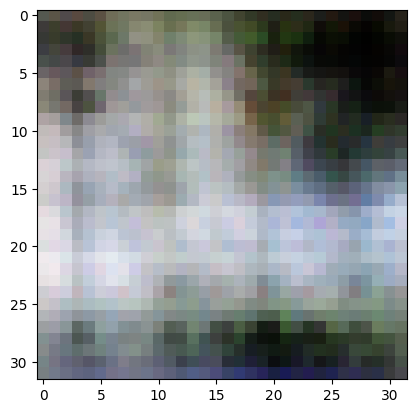

2/2 [==============================] - 0s 7ms/step
>2, 89/390, d1=0.931, d2=0.750 g=1.113


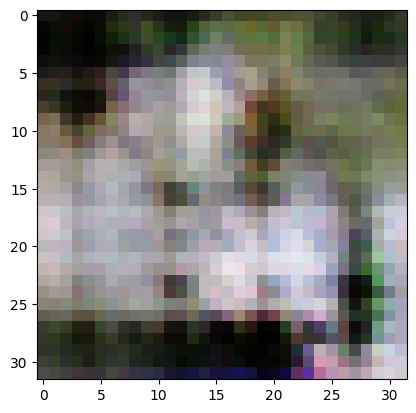

2/2 [==============================] - 0s 7ms/step
>2, 90/390, d1=0.715, d2=0.634 g=1.249


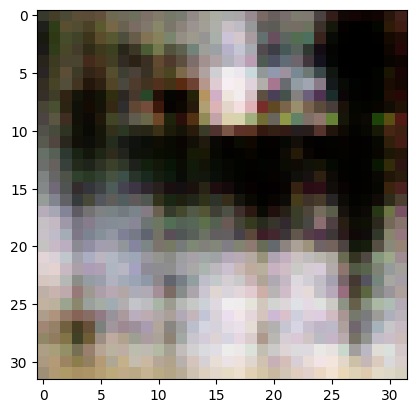

2/2 [==============================] - 0s 7ms/step
>2, 91/390, d1=0.825, d2=0.563 g=1.308


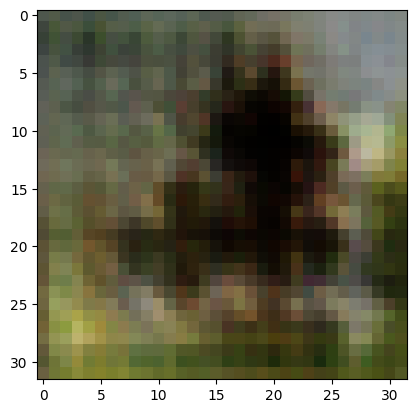

2/2 [==============================] - 0s 8ms/step
>2, 92/390, d1=0.649, d2=0.571 g=1.322


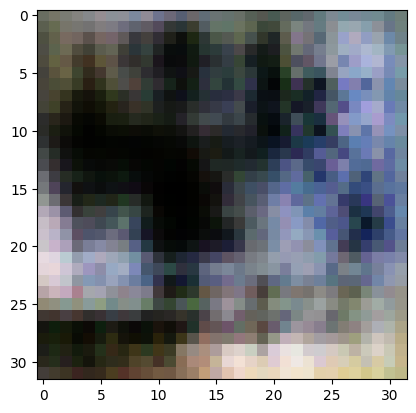

2/2 [==============================] - 0s 8ms/step
>2, 93/390, d1=0.707, d2=0.642 g=1.379


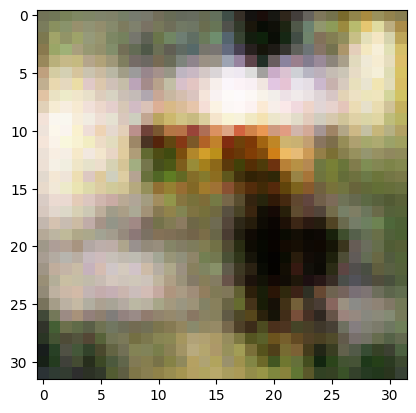

2/2 [==============================] - 0s 10ms/step
>2, 94/390, d1=0.696, d2=0.442 g=1.522


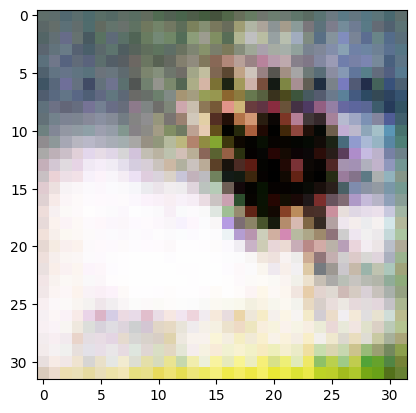

2/2 [==============================] - 0s 7ms/step
>2, 95/390, d1=0.593, d2=0.458 g=1.540


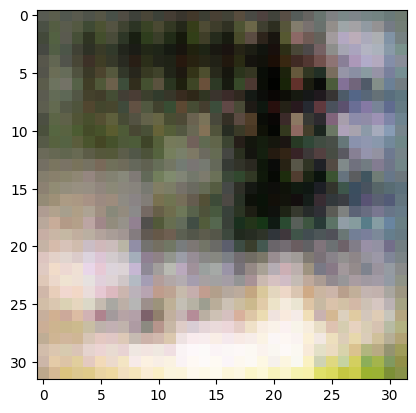

2/2 [==============================] - 0s 8ms/step
>2, 96/390, d1=0.613, d2=0.487 g=1.531


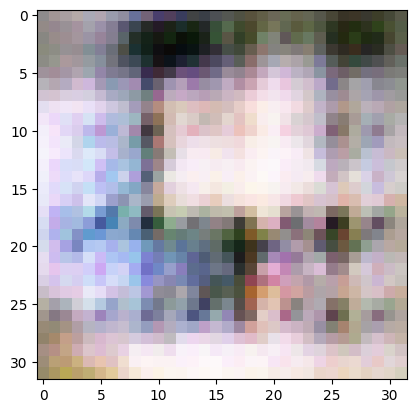

2/2 [==============================] - 0s 8ms/step
>2, 97/390, d1=0.680, d2=0.796 g=1.401


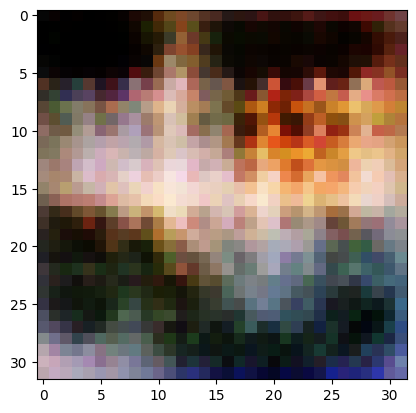

2/2 [==============================] - 0s 8ms/step
>2, 98/390, d1=0.748, d2=0.527 g=1.218


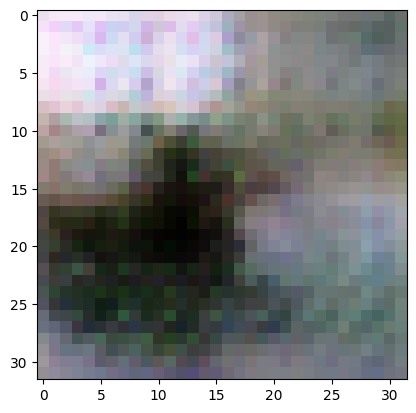

2/2 [==============================] - 0s 8ms/step
>2, 99/390, d1=0.692, d2=0.722 g=0.924


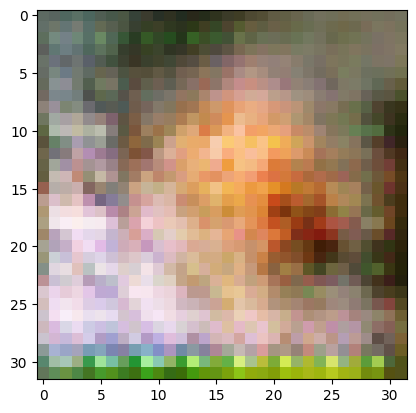

2/2 [==============================] - 0s 7ms/step
>2, 100/390, d1=0.518, d2=0.758 g=0.879


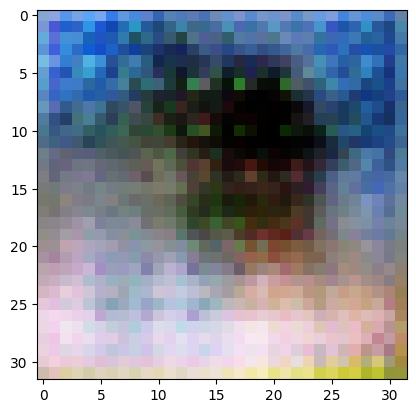

2/2 [==============================] - 0s 6ms/step
>2, 101/390, d1=0.566, d2=0.674 g=0.891


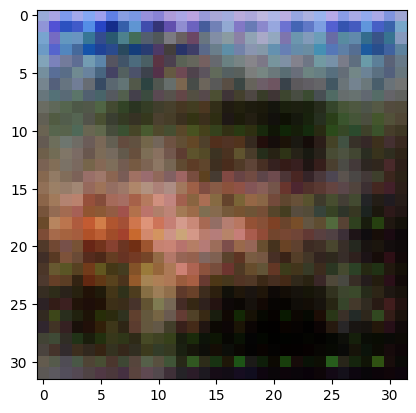

2/2 [==============================] - 0s 6ms/step
>2, 102/390, d1=0.527, d2=0.651 g=0.982


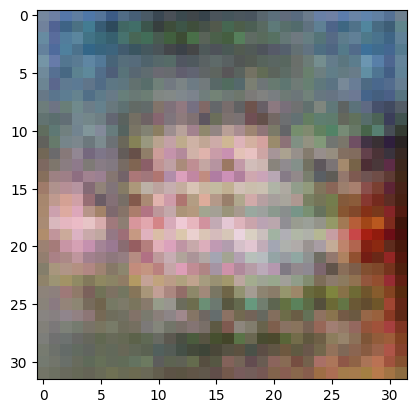

2/2 [==============================] - 0s 6ms/step
>2, 103/390, d1=0.535, d2=0.694 g=1.157


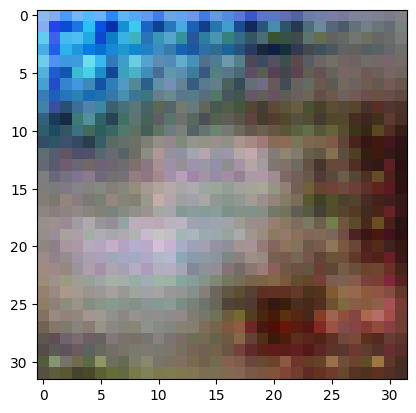

2/2 [==============================] - 0s 7ms/step
>2, 104/390, d1=0.513, d2=0.604 g=1.178


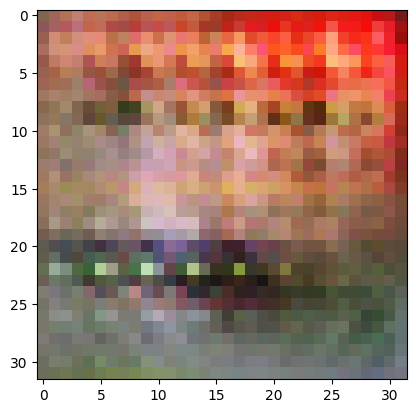

2/2 [==============================] - 0s 7ms/step
>2, 105/390, d1=0.514, d2=0.599 g=1.162


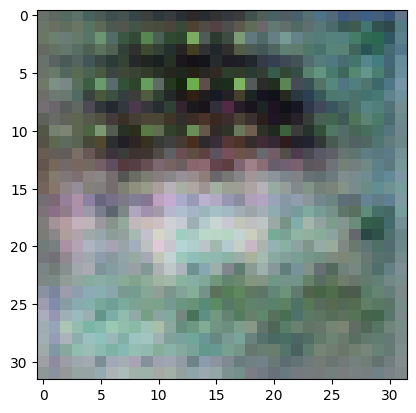

2/2 [==============================] - 0s 6ms/step
>2, 106/390, d1=0.665, d2=0.761 g=1.311


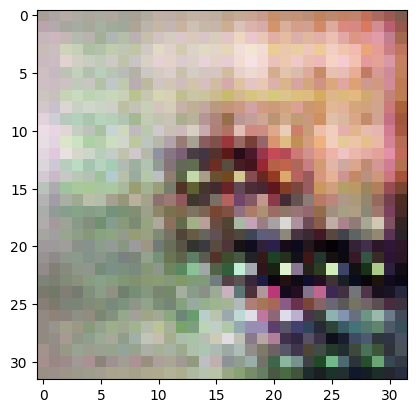

2/2 [==============================] - 0s 7ms/step
>2, 107/390, d1=0.728, d2=0.516 g=1.411


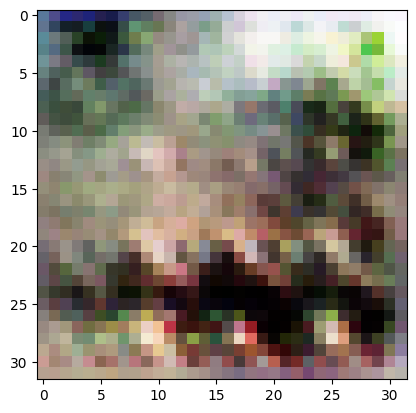

2/2 [==============================] - 0s 6ms/step
>2, 108/390, d1=0.636, d2=0.492 g=1.503


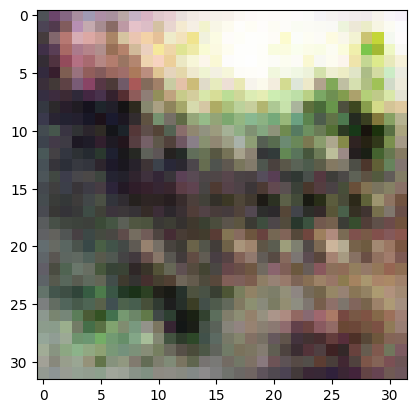

2/2 [==============================] - 0s 6ms/step
>2, 109/390, d1=0.536, d2=0.521 g=1.643


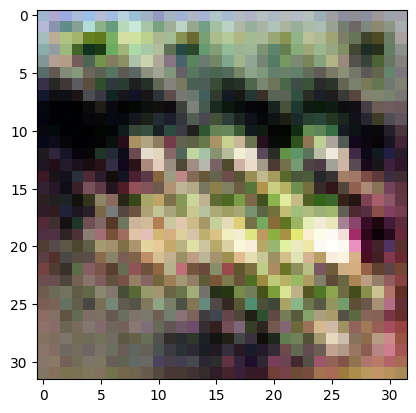

2/2 [==============================] - 0s 12ms/step
>2, 110/390, d1=0.581, d2=0.599 g=1.732


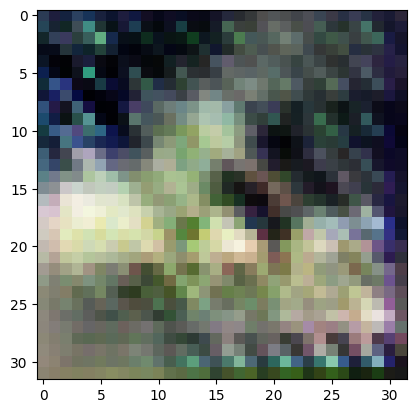

2/2 [==============================] - 0s 7ms/step
>2, 111/390, d1=0.537, d2=0.554 g=1.904


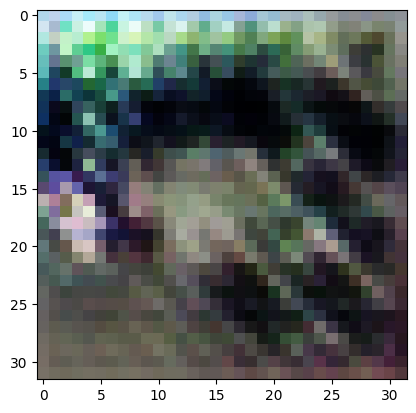

2/2 [==============================] - 0s 13ms/step
>2, 112/390, d1=0.585, d2=0.693 g=1.638


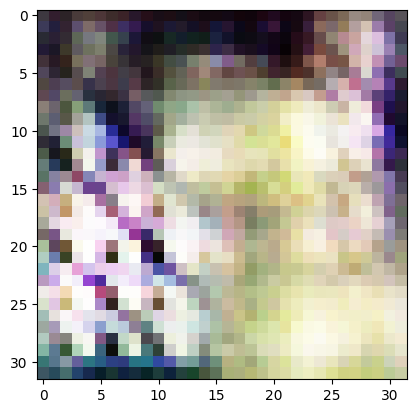

2/2 [==============================] - 0s 6ms/step
>2, 113/390, d1=0.671, d2=0.764 g=1.584


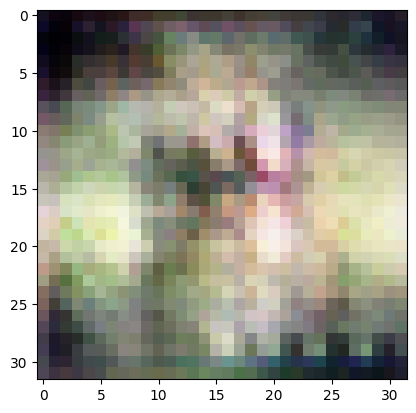

2/2 [==============================] - 0s 8ms/step
>2, 114/390, d1=0.682, d2=0.538 g=1.783


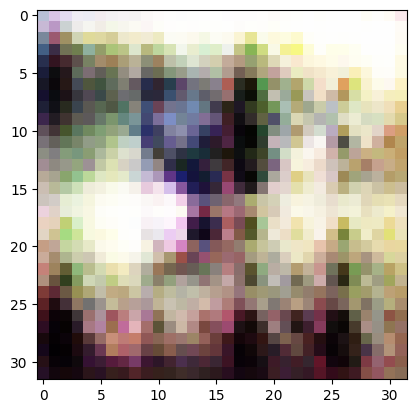

2/2 [==============================] - 0s 7ms/step
>2, 115/390, d1=0.707, d2=0.434 g=1.489


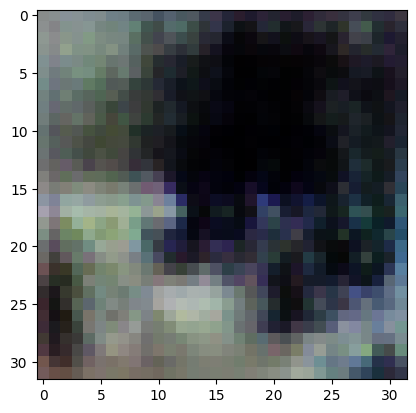

2/2 [==============================] - 0s 7ms/step
>2, 116/390, d1=0.723, d2=0.590 g=1.115


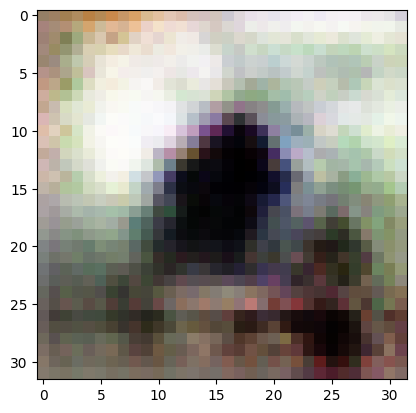

2/2 [==============================] - 0s 6ms/step
>2, 117/390, d1=0.472, d2=0.604 g=1.232


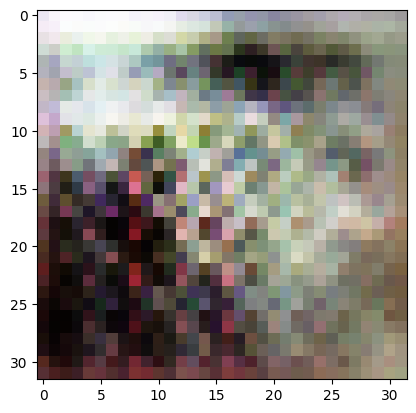

2/2 [==============================] - 0s 7ms/step
>2, 118/390, d1=0.554, d2=0.585 g=1.128


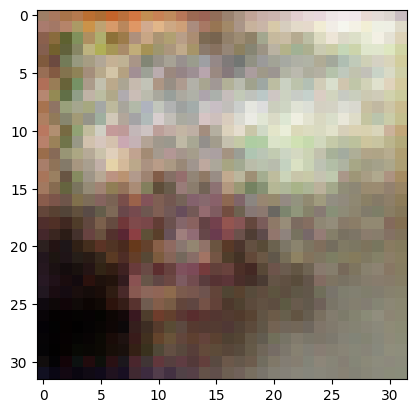

2/2 [==============================] - 0s 8ms/step
>2, 119/390, d1=0.581, d2=0.660 g=1.152


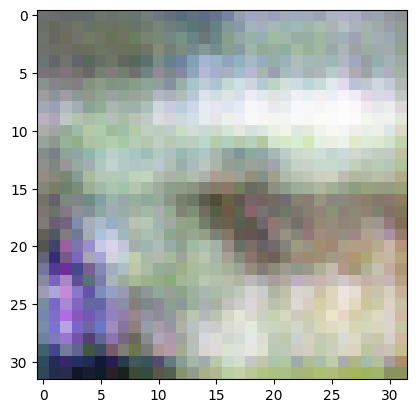

2/2 [==============================] - 0s 7ms/step
>2, 120/390, d1=0.405, d2=0.704 g=1.280


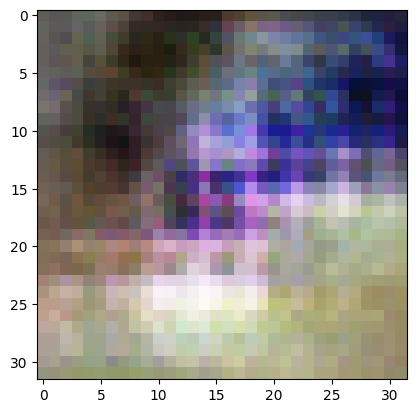

2/2 [==============================] - 0s 7ms/step
>2, 121/390, d1=0.502, d2=0.503 g=1.304


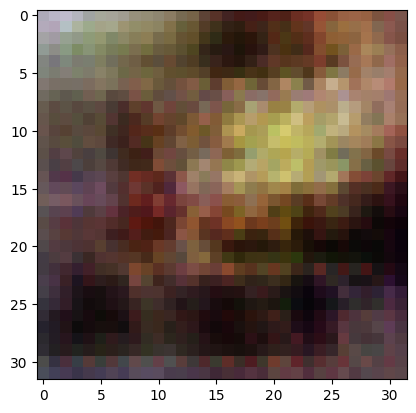

2/2 [==============================] - 0s 7ms/step
>2, 122/390, d1=0.506, d2=0.894 g=1.729


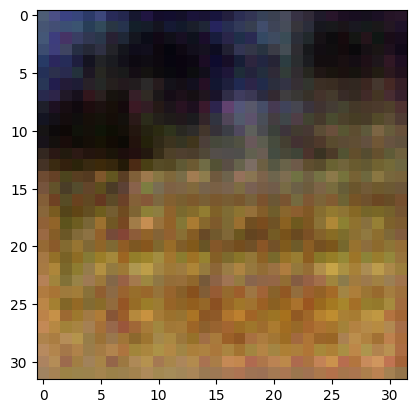

2/2 [==============================] - 0s 6ms/step
>2, 123/390, d1=0.648, d2=0.455 g=1.744


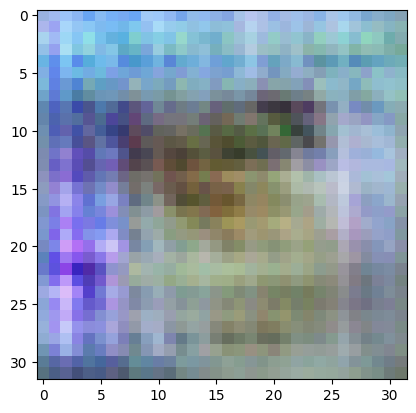

2/2 [==============================] - 0s 6ms/step
>2, 124/390, d1=0.753, d2=0.723 g=1.534


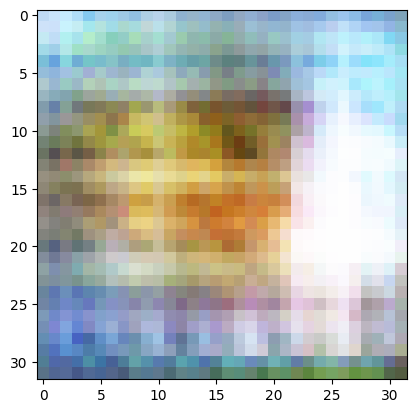

2/2 [==============================] - 0s 6ms/step
>2, 125/390, d1=0.664, d2=0.502 g=1.592


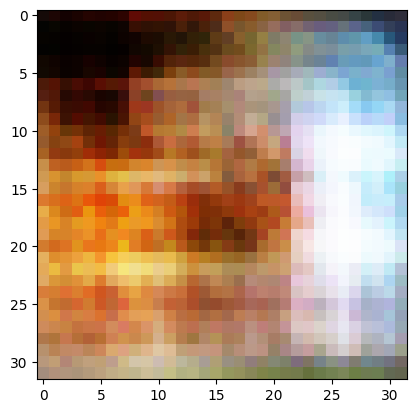

2/2 [==============================] - 0s 7ms/step
>2, 126/390, d1=0.585, d2=0.464 g=1.741


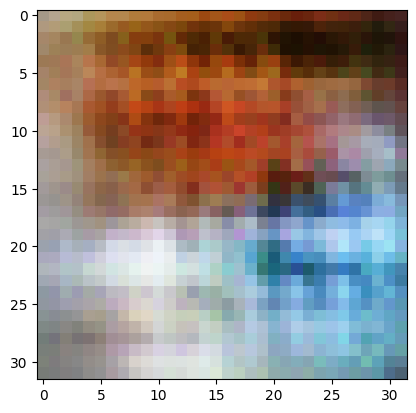

2/2 [==============================] - 0s 8ms/step
>2, 127/390, d1=0.551, d2=0.483 g=1.624


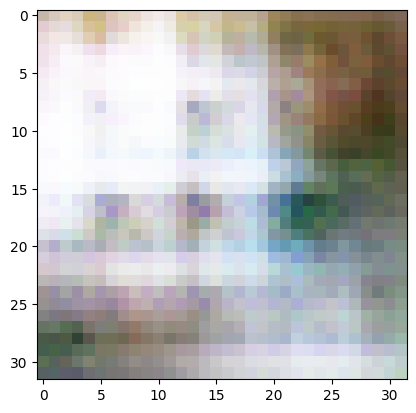

2/2 [==============================] - 0s 7ms/step
>2, 128/390, d1=0.590, d2=0.603 g=1.577


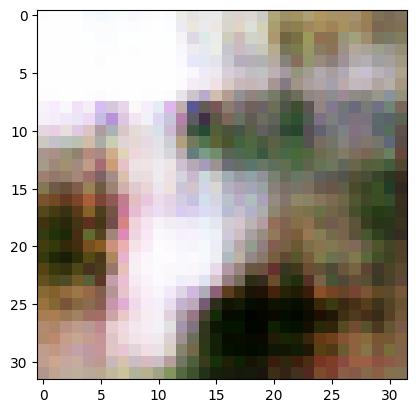

2/2 [==============================] - 0s 6ms/step
>2, 129/390, d1=0.595, d2=0.647 g=1.476


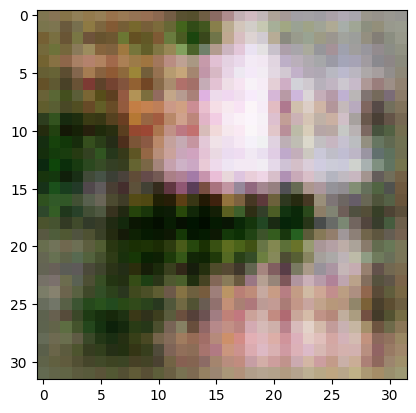

2/2 [==============================] - 0s 7ms/step
>2, 130/390, d1=0.605, d2=0.464 g=1.506


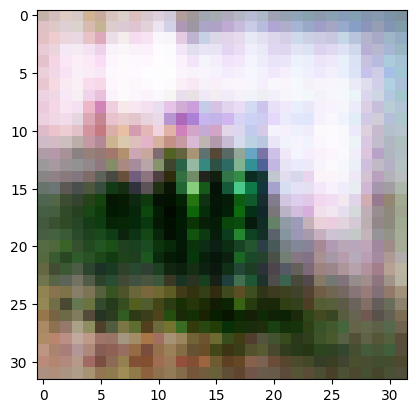

2/2 [==============================] - 0s 7ms/step
>2, 131/390, d1=0.586, d2=0.509 g=1.602


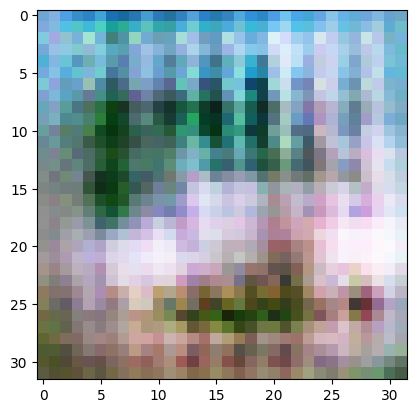

2/2 [==============================] - 0s 8ms/step
>2, 132/390, d1=0.371, d2=0.822 g=1.950


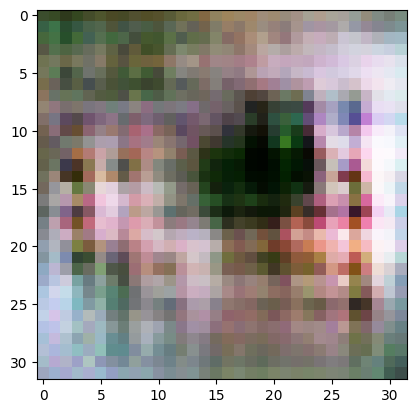

2/2 [==============================] - 0s 7ms/step
>2, 133/390, d1=0.647, d2=0.421 g=1.606


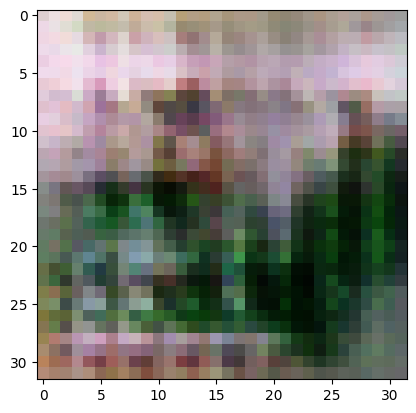

2/2 [==============================] - 0s 12ms/step
>2, 134/390, d1=0.600, d2=0.585 g=1.602


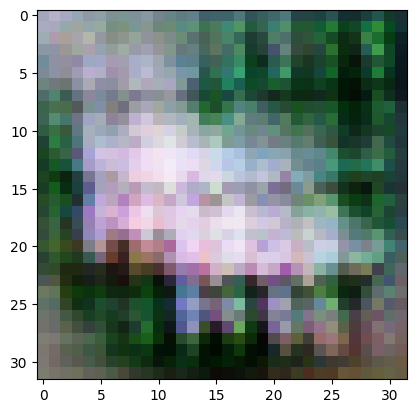

2/2 [==============================] - 0s 9ms/step
>2, 135/390, d1=0.427, d2=0.566 g=1.982


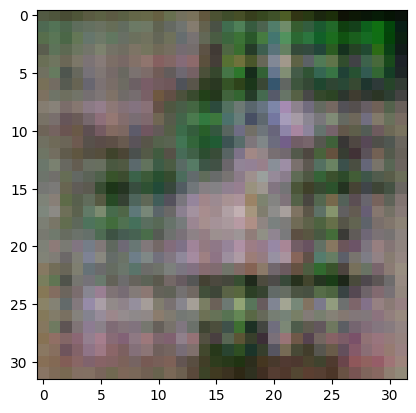

2/2 [==============================] - 0s 8ms/step
>2, 136/390, d1=0.316, d2=0.410 g=2.256


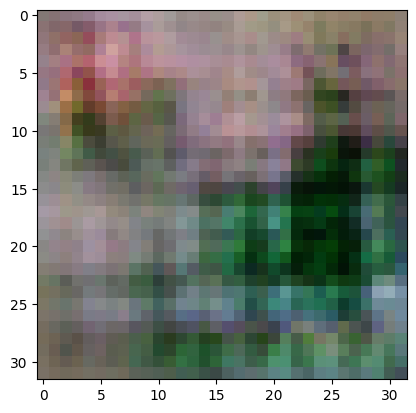

2/2 [==============================] - 0s 7ms/step
>2, 137/390, d1=0.327, d2=0.616 g=2.310


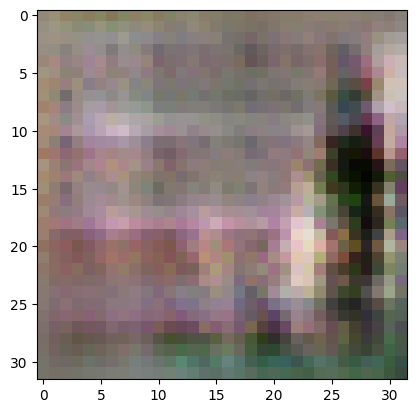

2/2 [==============================] - 0s 7ms/step
>2, 138/390, d1=0.604, d2=3.083 g=3.131


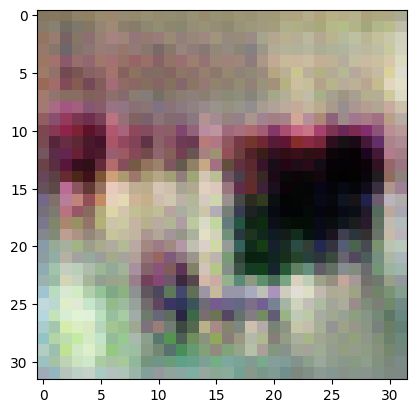

2/2 [==============================] - 0s 6ms/step
>2, 139/390, d1=1.700, d2=0.291 g=1.495


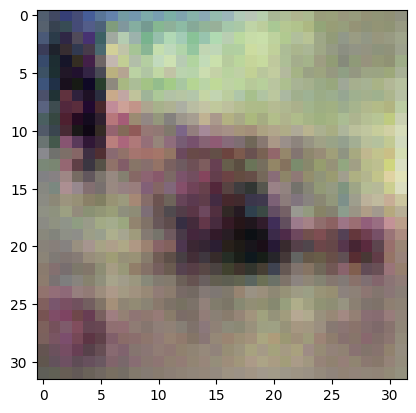

2/2 [==============================] - 0s 8ms/step
>2, 140/390, d1=0.802, d2=0.669 g=1.090


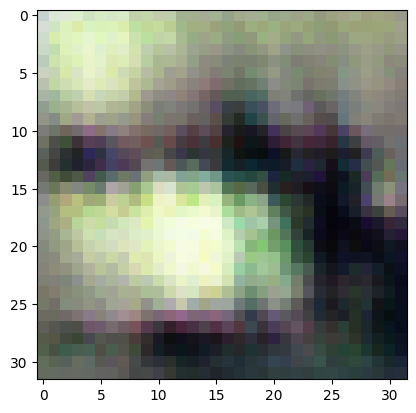

2/2 [==============================] - 0s 7ms/step
>2, 141/390, d1=0.697, d2=0.680 g=1.179


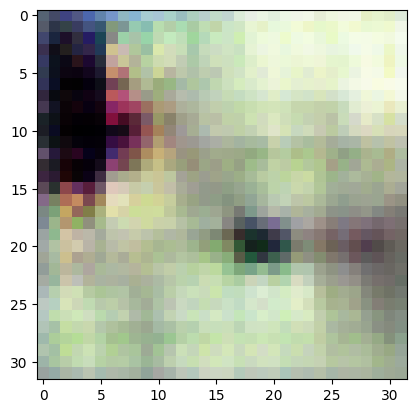

2/2 [==============================] - 0s 7ms/step
>2, 142/390, d1=0.408, d2=0.518 g=1.431


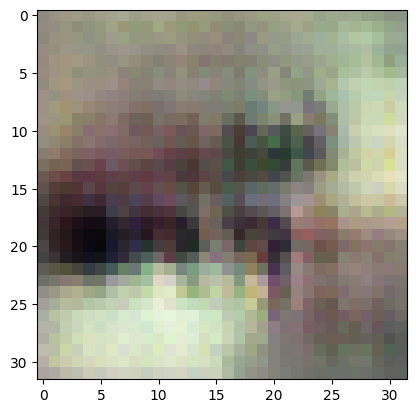

2/2 [==============================] - 0s 8ms/step
>2, 143/390, d1=0.584, d2=0.455 g=1.751


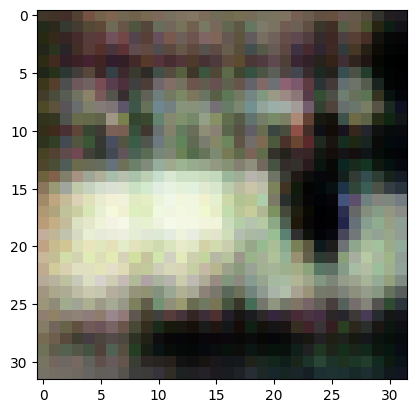

2/2 [==============================] - 0s 6ms/step
>2, 144/390, d1=0.510, d2=0.439 g=1.643


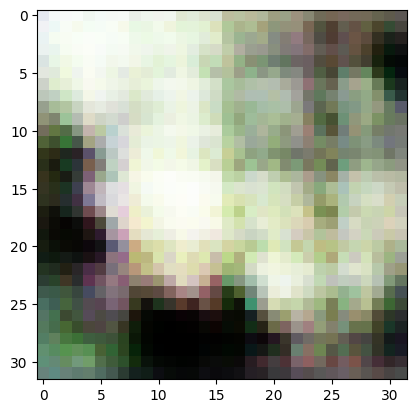

2/2 [==============================] - 0s 7ms/step
>2, 145/390, d1=0.563, d2=0.464 g=1.672


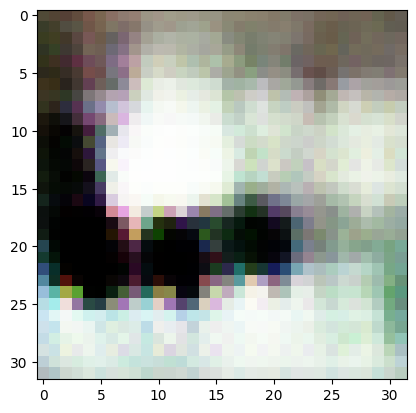

2/2 [==============================] - 0s 7ms/step
>2, 146/390, d1=0.400, d2=0.758 g=1.696


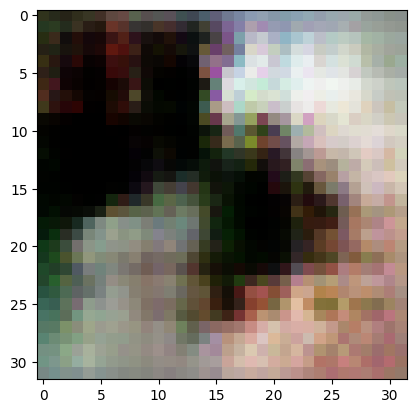

2/2 [==============================] - 0s 8ms/step
>2, 147/390, d1=0.708, d2=0.630 g=1.728


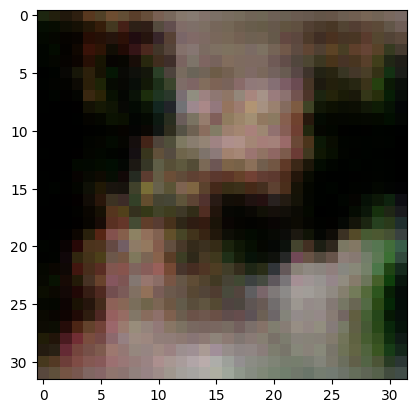

2/2 [==============================] - 0s 7ms/step
>2, 148/390, d1=0.770, d2=0.592 g=2.241


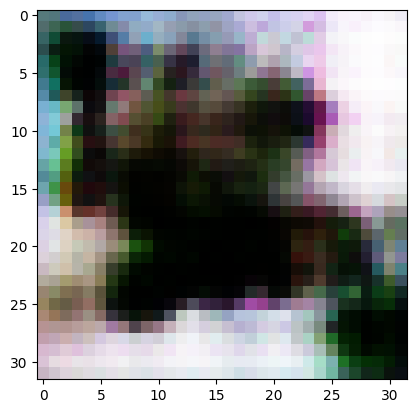

2/2 [==============================] - 0s 8ms/step
>2, 149/390, d1=0.697, d2=0.361 g=2.687


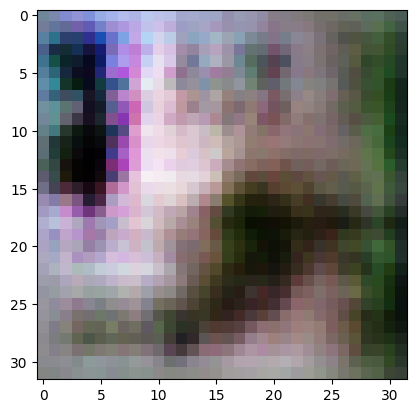

2/2 [==============================] - 0s 7ms/step
>2, 150/390, d1=0.793, d2=0.614 g=2.396


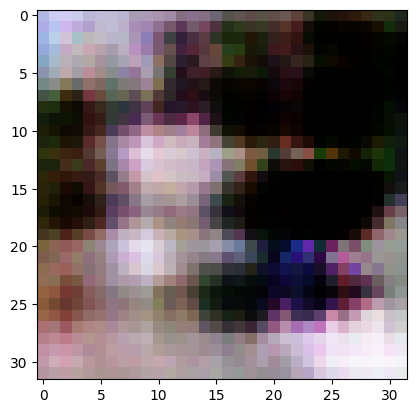

2/2 [==============================] - 0s 7ms/step
>2, 151/390, d1=0.620, d2=0.290 g=2.384


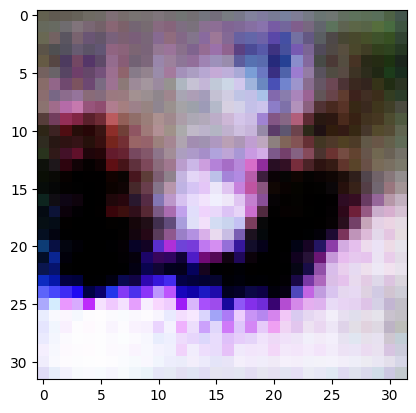

2/2 [==============================] - 0s 8ms/step
>2, 152/390, d1=0.849, d2=0.540 g=1.559


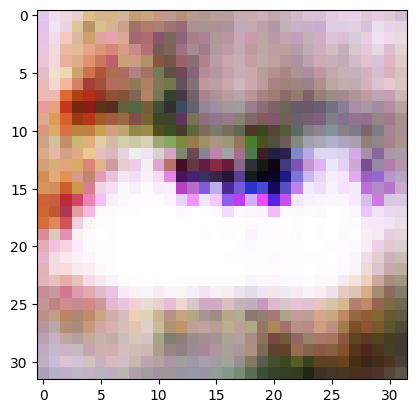

2/2 [==============================] - 0s 7ms/step
>2, 153/390, d1=0.615, d2=0.744 g=1.447


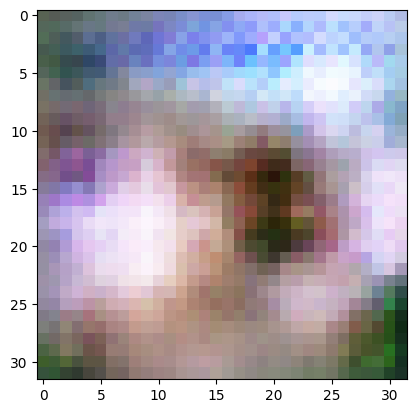

2/2 [==============================] - 0s 6ms/step
>2, 154/390, d1=0.625, d2=0.639 g=1.190


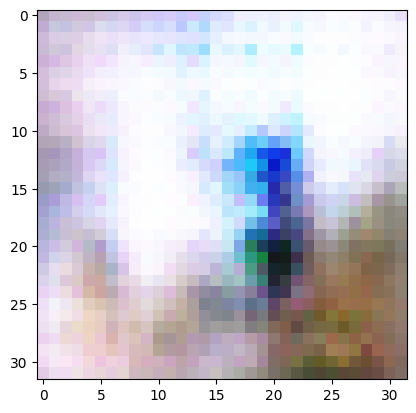

2/2 [==============================] - 0s 6ms/step
>2, 155/390, d1=0.545, d2=0.646 g=1.202


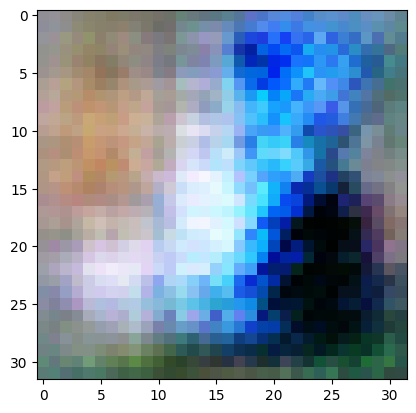

2/2 [==============================] - 0s 7ms/step
>2, 156/390, d1=0.492, d2=0.679 g=1.503


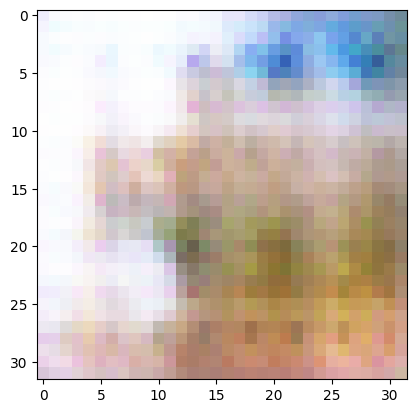

2/2 [==============================] - 0s 6ms/step
>2, 157/390, d1=0.458, d2=0.482 g=1.535


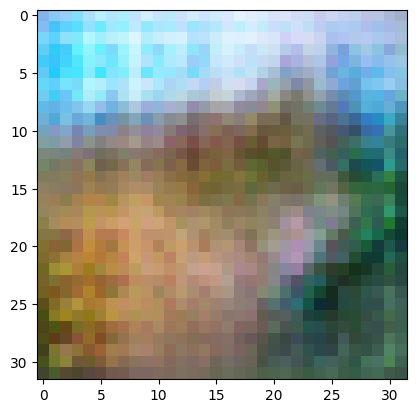

2/2 [==============================] - 0s 12ms/step
>2, 158/390, d1=0.416, d2=0.848 g=1.261


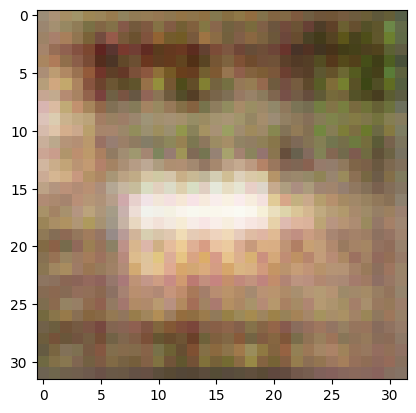

2/2 [==============================] - 0s 10ms/step
>2, 159/390, d1=0.408, d2=0.844 g=1.519


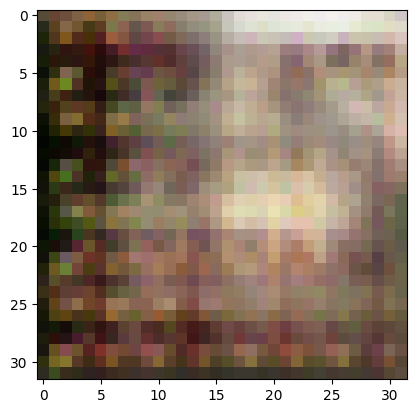

2/2 [==============================] - 0s 6ms/step
>2, 160/390, d1=0.686, d2=0.406 g=1.726


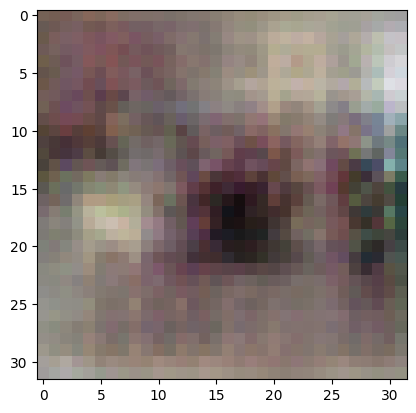

2/2 [==============================] - 0s 8ms/step
>2, 161/390, d1=0.697, d2=0.480 g=1.680


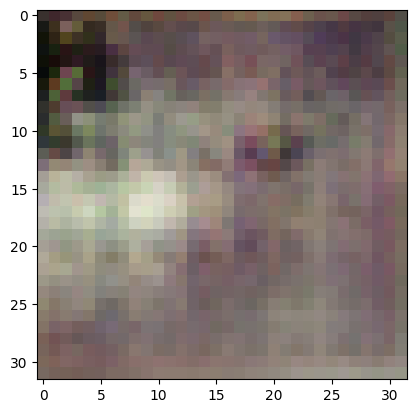

2/2 [==============================] - 0s 8ms/step
>2, 162/390, d1=0.601, d2=0.763 g=2.062


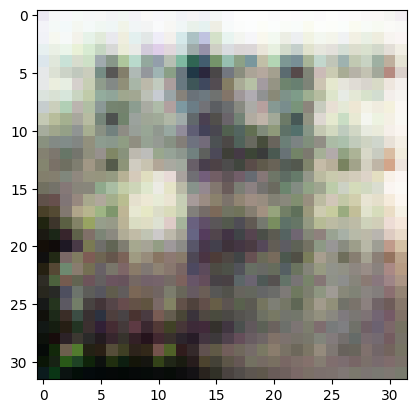

2/2 [==============================] - 0s 9ms/step
>2, 163/390, d1=0.763, d2=0.500 g=1.836


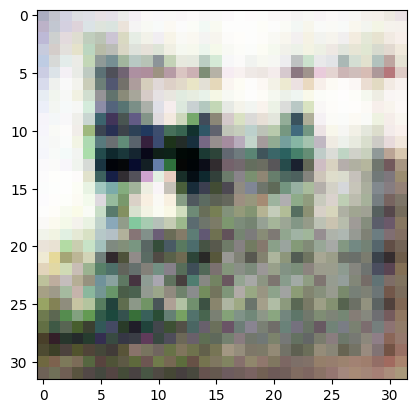

2/2 [==============================] - 0s 8ms/step
>2, 164/390, d1=0.829, d2=0.534 g=1.536


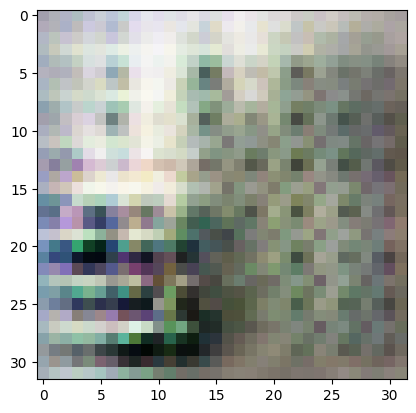

2/2 [==============================] - 0s 8ms/step
>2, 165/390, d1=0.533, d2=0.669 g=1.350


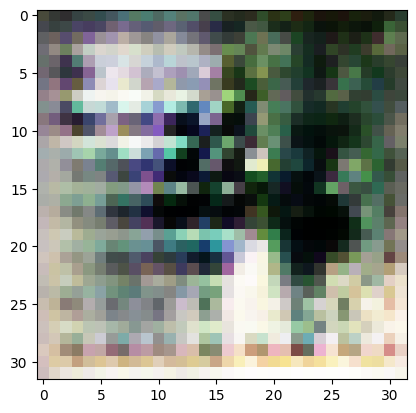

2/2 [==============================] - 0s 8ms/step
>2, 166/390, d1=0.547, d2=0.745 g=1.325


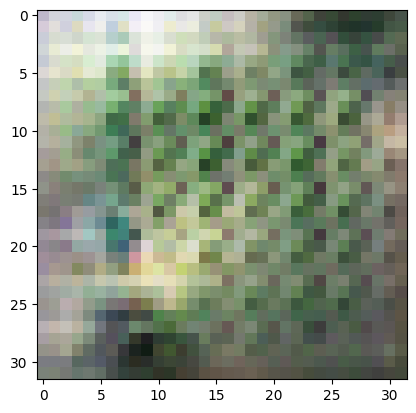

2/2 [==============================] - 0s 7ms/step
>2, 167/390, d1=0.595, d2=0.804 g=1.561


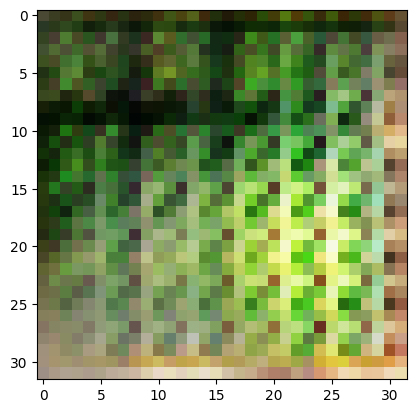

2/2 [==============================] - 0s 8ms/step
>2, 168/390, d1=0.572, d2=0.582 g=1.826


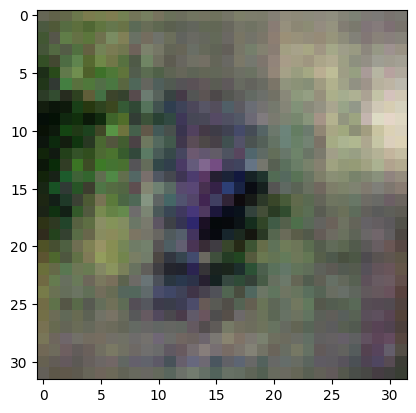

2/2 [==============================] - 0s 7ms/step
>2, 169/390, d1=0.681, d2=0.704 g=1.394


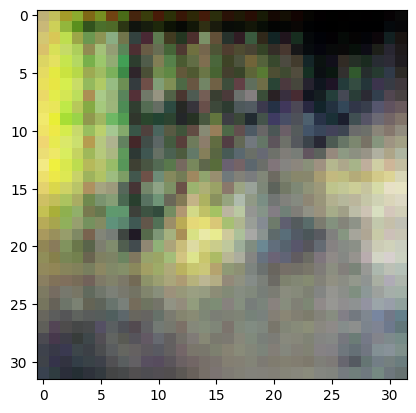

2/2 [==============================] - 0s 9ms/step
>2, 170/390, d1=0.766, d2=0.704 g=0.961


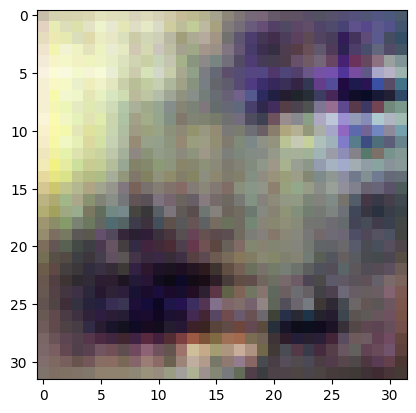

2/2 [==============================] - 0s 8ms/step
>2, 171/390, d1=0.702, d2=0.749 g=1.040


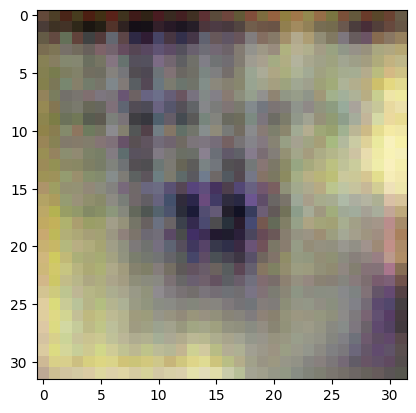

2/2 [==============================] - 0s 7ms/step
>2, 172/390, d1=0.588, d2=0.660 g=1.173


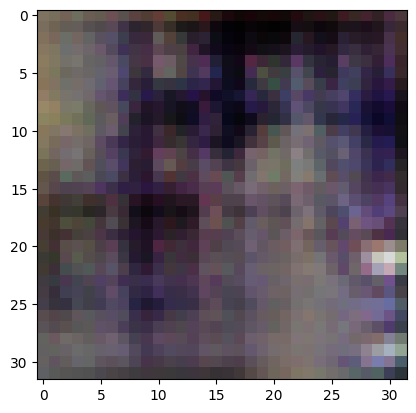

2/2 [==============================] - 0s 8ms/step
>2, 173/390, d1=0.635, d2=0.567 g=1.190


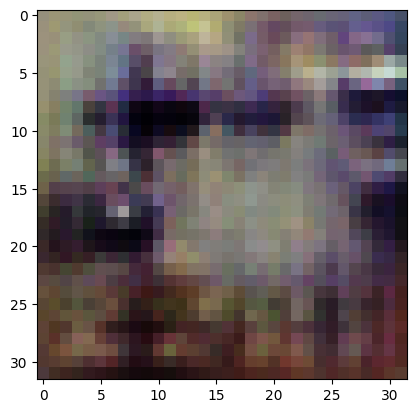

2/2 [==============================] - 0s 7ms/step
>2, 174/390, d1=0.491, d2=0.575 g=1.318


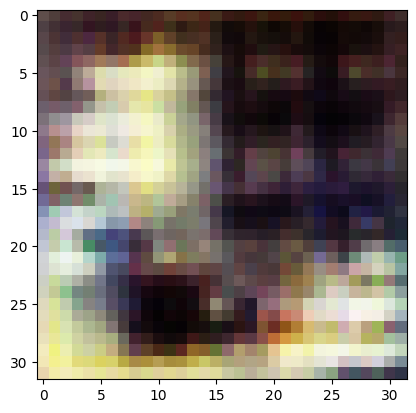

2/2 [==============================] - 0s 7ms/step
>2, 175/390, d1=0.496, d2=0.551 g=1.479


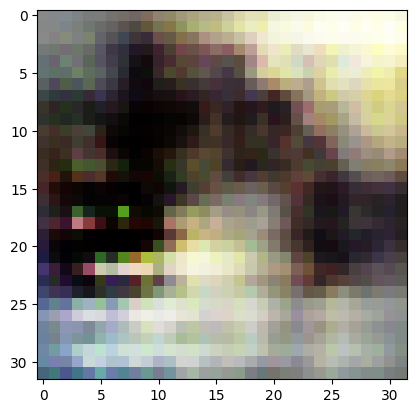

2/2 [==============================] - 0s 8ms/step
>2, 176/390, d1=0.549, d2=0.497 g=1.570


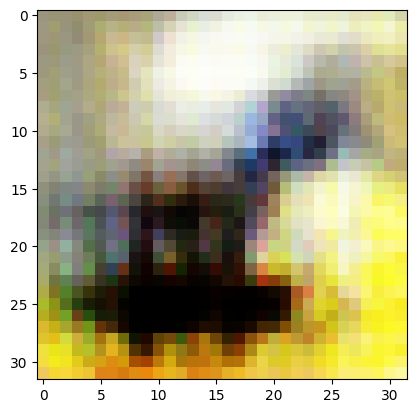

2/2 [==============================] - 0s 8ms/step
>2, 177/390, d1=0.603, d2=0.395 g=1.513


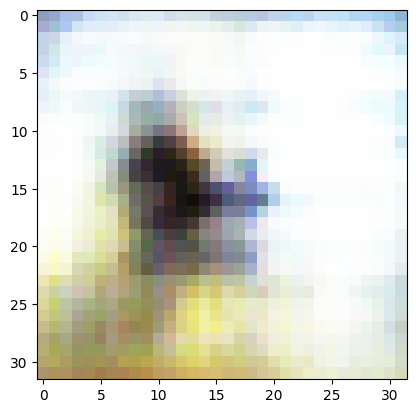

2/2 [==============================] - 0s 7ms/step
>2, 178/390, d1=0.626, d2=0.591 g=1.278


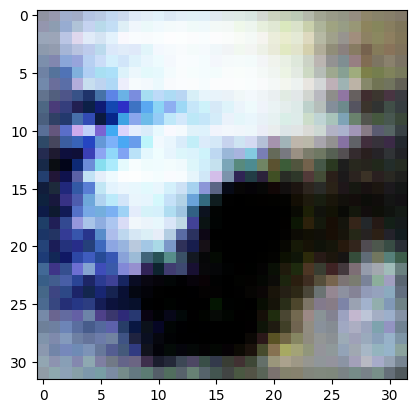

2/2 [==============================] - 0s 7ms/step
>2, 179/390, d1=0.570, d2=0.794 g=1.364


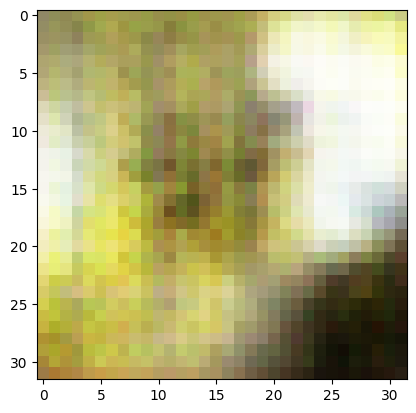

2/2 [==============================] - 0s 7ms/step
>2, 180/390, d1=0.732, d2=0.532 g=1.470


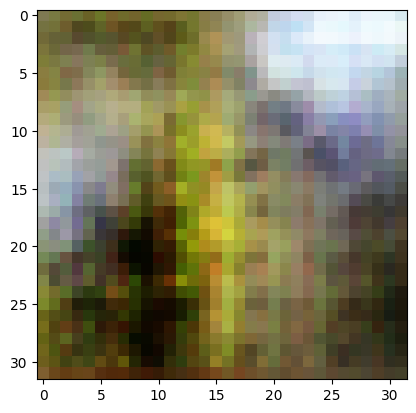

2/2 [==============================] - 0s 9ms/step
>2, 181/390, d1=0.544, d2=0.544 g=1.371


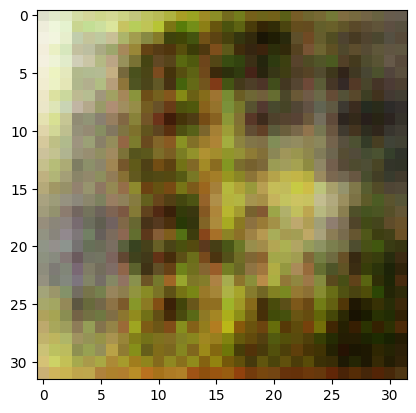

2/2 [==============================] - 0s 6ms/step
>2, 182/390, d1=0.454, d2=0.728 g=1.417


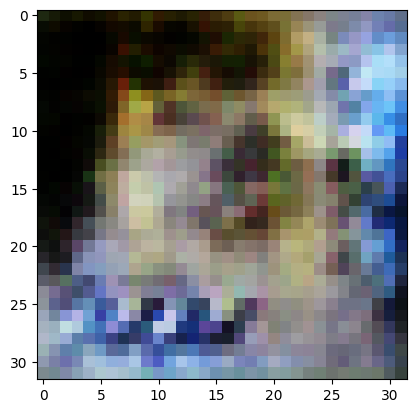

2/2 [==============================] - 0s 7ms/step
>2, 183/390, d1=0.491, d2=0.822 g=1.650


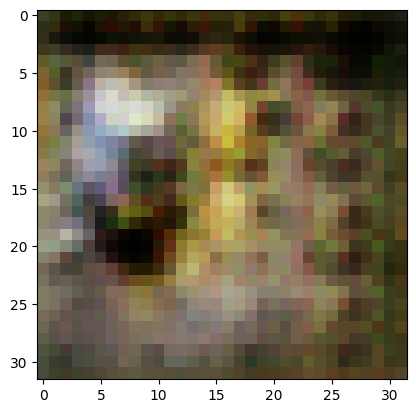

2/2 [==============================] - 0s 5ms/step
>2, 184/390, d1=0.791, d2=0.447 g=1.508


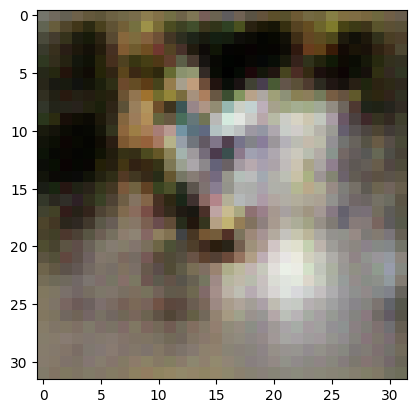

2/2 [==============================] - 0s 9ms/step
>2, 185/390, d1=0.807, d2=0.491 g=1.466


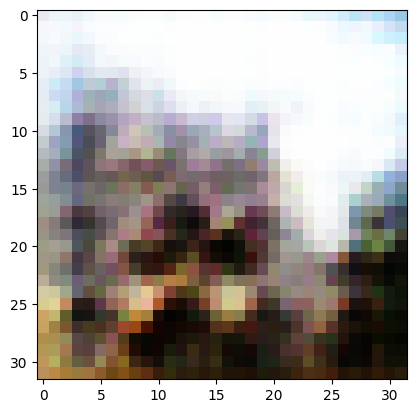

2/2 [==============================] - 0s 7ms/step
>2, 186/390, d1=0.674, d2=0.483 g=1.737


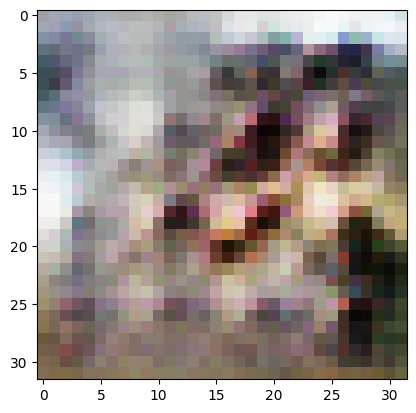

2/2 [==============================] - 0s 6ms/step
>2, 187/390, d1=0.626, d2=0.414 g=1.852


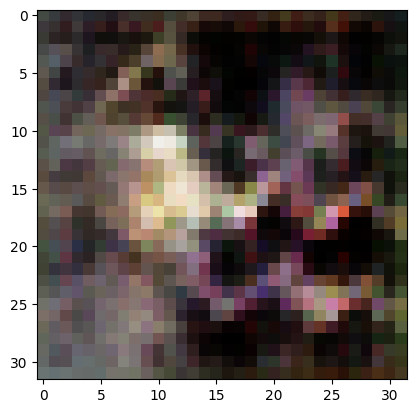

2/2 [==============================] - 0s 7ms/step
>2, 188/390, d1=0.513, d2=0.454 g=1.499


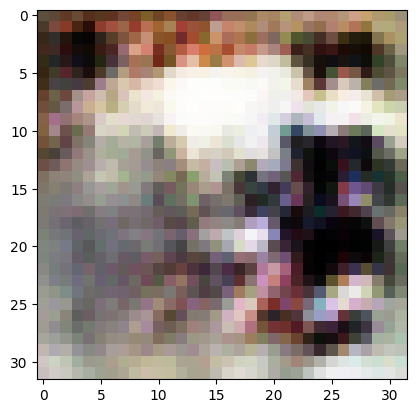

2/2 [==============================] - 0s 6ms/step
>2, 189/390, d1=0.621, d2=0.548 g=1.227


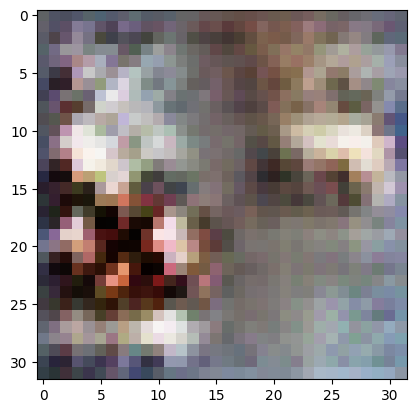

2/2 [==============================] - 0s 8ms/step
>2, 190/390, d1=0.416, d2=0.625 g=1.139


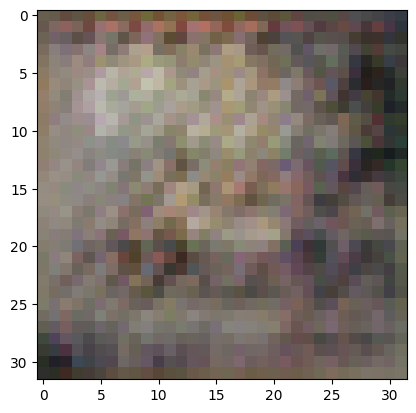

2/2 [==============================] - 0s 6ms/step
>2, 191/390, d1=0.483, d2=0.854 g=1.098


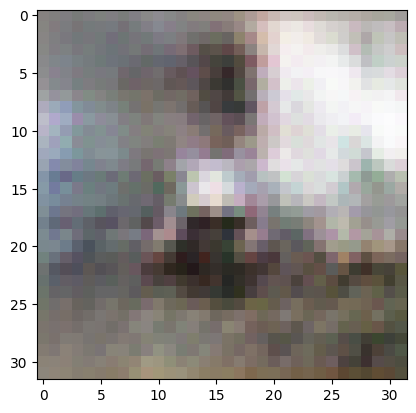

2/2 [==============================] - 0s 7ms/step
>2, 192/390, d1=0.579, d2=0.685 g=1.071


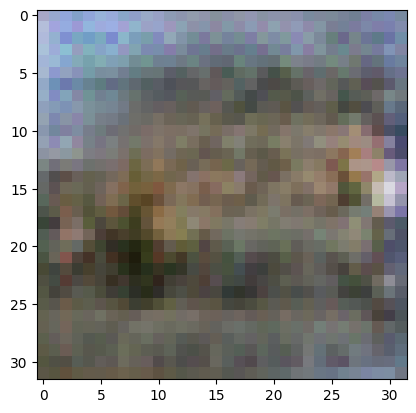

2/2 [==============================] - 0s 11ms/step
>2, 193/390, d1=0.626, d2=0.663 g=1.093


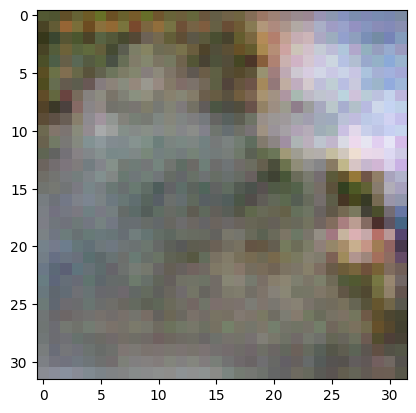

2/2 [==============================] - 0s 5ms/step
>2, 194/390, d1=0.530, d2=0.737 g=1.128


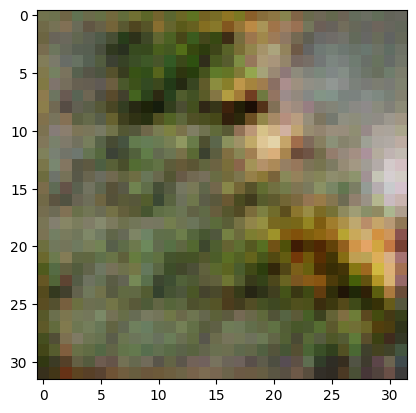

2/2 [==============================] - 0s 5ms/step
>2, 195/390, d1=0.524, d2=0.692 g=1.245


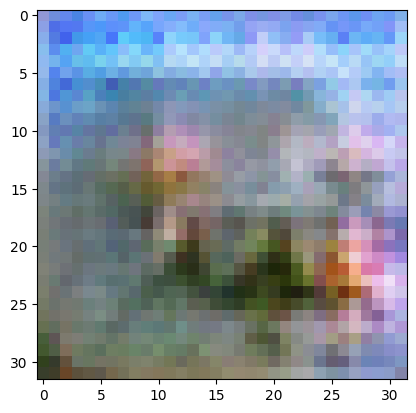

2/2 [==============================] - 0s 6ms/step
>2, 196/390, d1=0.530, d2=0.698 g=1.398


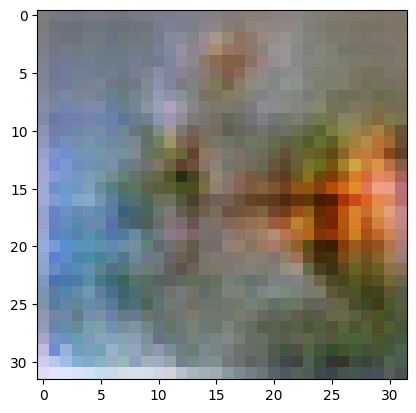

2/2 [==============================] - 0s 9ms/step
>2, 197/390, d1=0.503, d2=0.762 g=1.640


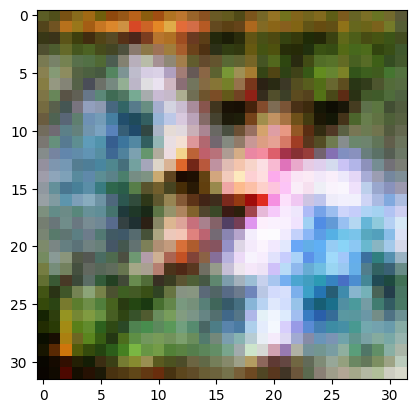

2/2 [==============================] - 0s 7ms/step
>2, 198/390, d1=0.693, d2=0.606 g=1.750


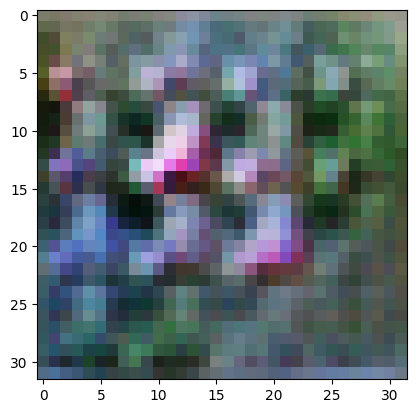

2/2 [==============================] - 0s 12ms/step
>2, 199/390, d1=0.904, d2=0.745 g=1.619


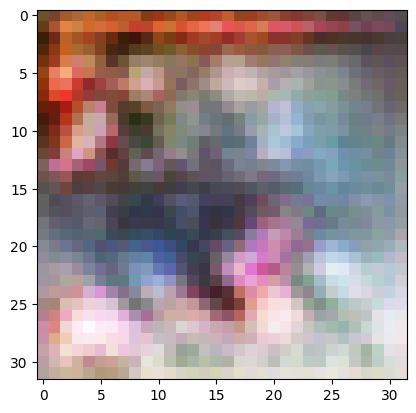

2/2 [==============================] - 0s 8ms/step
>2, 200/390, d1=0.774, d2=0.440 g=1.751


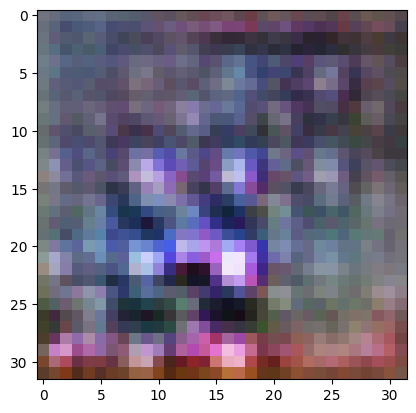

2/2 [==============================] - 0s 7ms/step
>2, 201/390, d1=0.788, d2=0.518 g=1.551


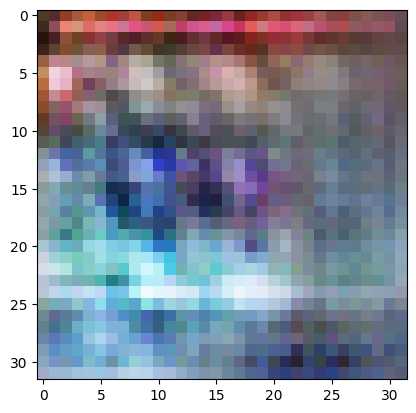

2/2 [==============================] - 0s 7ms/step
>2, 202/390, d1=0.785, d2=0.662 g=1.663


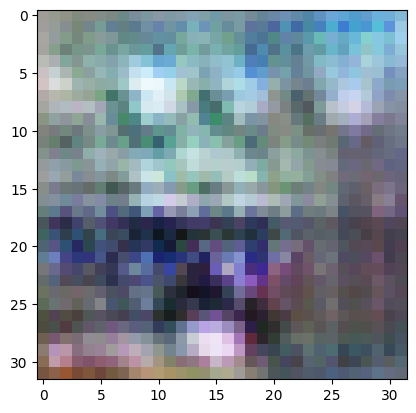

2/2 [==============================] - 0s 7ms/step
>2, 203/390, d1=0.699, d2=0.485 g=1.419


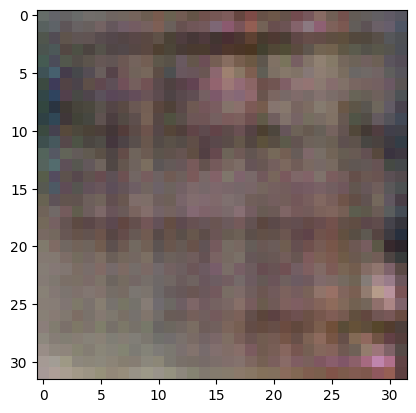

2/2 [==============================] - 0s 11ms/step
>2, 204/390, d1=0.693, d2=0.544 g=1.258


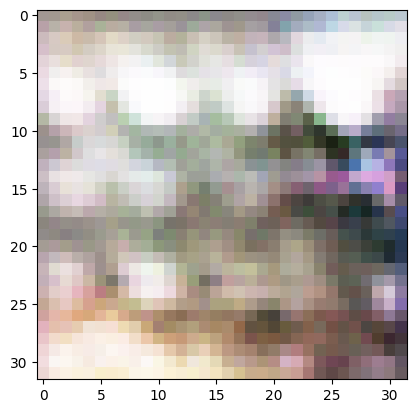

2/2 [==============================] - 0s 13ms/step
>2, 205/390, d1=0.561, d2=0.553 g=1.240


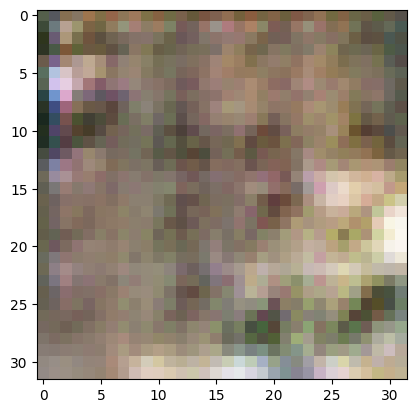

2/2 [==============================] - 0s 8ms/step
>2, 206/390, d1=0.555, d2=0.705 g=1.224


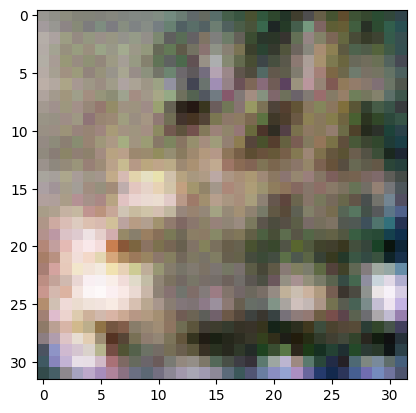

2/2 [==============================] - 0s 8ms/step
>2, 207/390, d1=0.392, d2=0.727 g=1.366


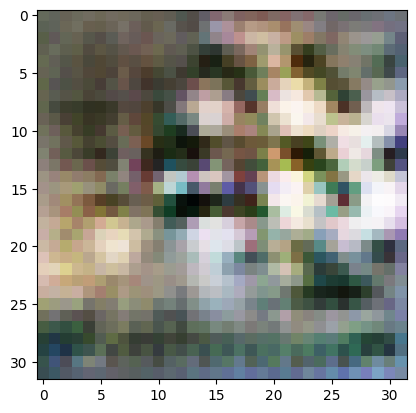

2/2 [==============================] - 0s 14ms/step
>2, 208/390, d1=0.589, d2=0.650 g=1.583


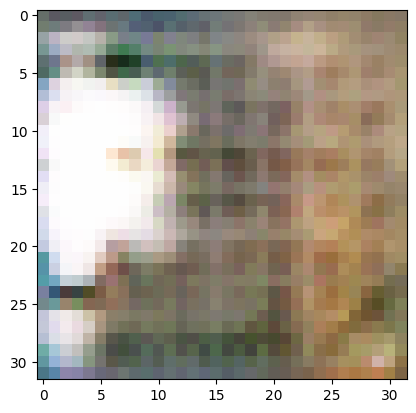

2/2 [==============================] - 0s 7ms/step
>2, 209/390, d1=0.525, d2=0.436 g=1.741


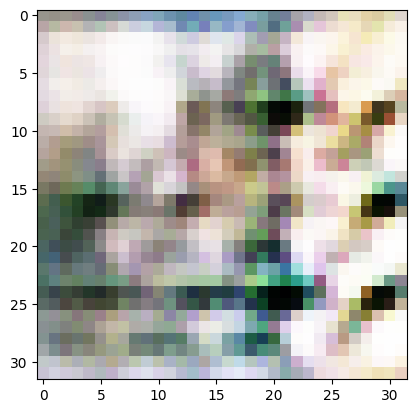

2/2 [==============================] - 0s 8ms/step
>2, 210/390, d1=0.521, d2=0.562 g=1.817


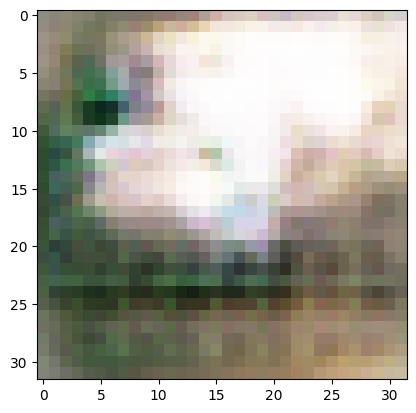

2/2 [==============================] - 0s 10ms/step
>2, 211/390, d1=0.442, d2=0.635 g=1.626


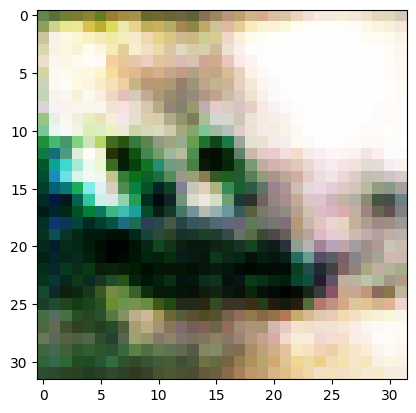

2/2 [==============================] - 0s 8ms/step
>2, 212/390, d1=0.593, d2=0.717 g=1.620


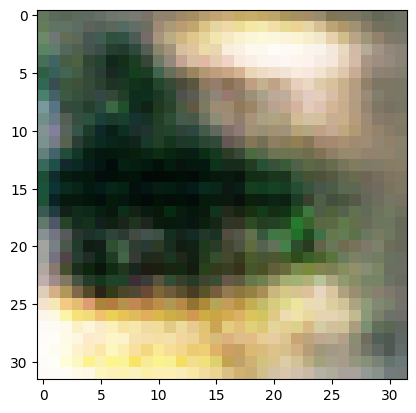

2/2 [==============================] - 0s 10ms/step
>2, 213/390, d1=0.771, d2=0.847 g=1.730


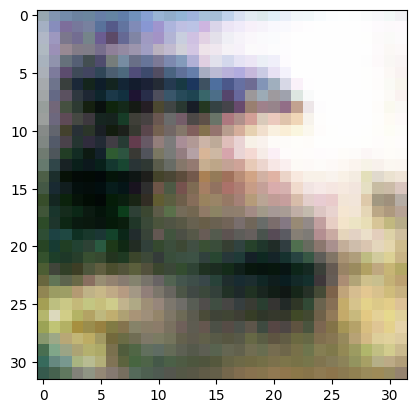

2/2 [==============================] - 0s 7ms/step
>2, 214/390, d1=0.927, d2=0.639 g=1.458


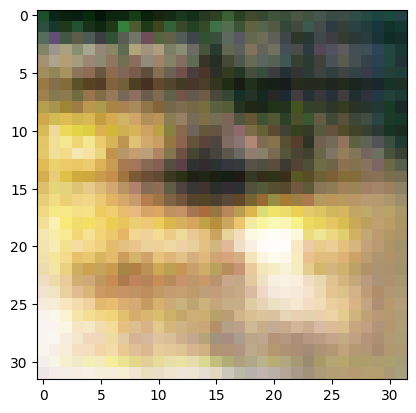

2/2 [==============================] - 0s 7ms/step
>2, 215/390, d1=0.840, d2=0.465 g=1.311


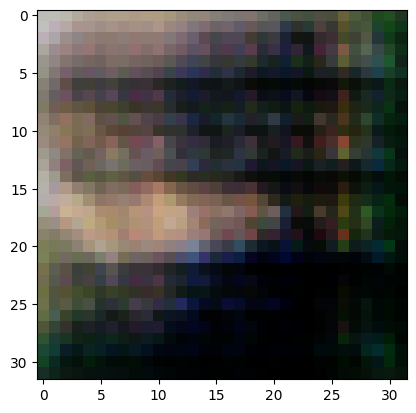

2/2 [==============================] - 0s 8ms/step
>2, 216/390, d1=0.708, d2=0.586 g=1.193


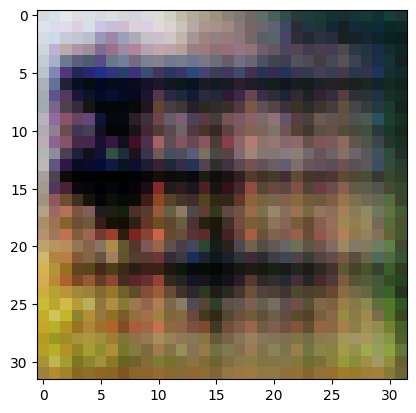

2/2 [==============================] - 0s 8ms/step
>2, 217/390, d1=0.677, d2=0.643 g=1.193


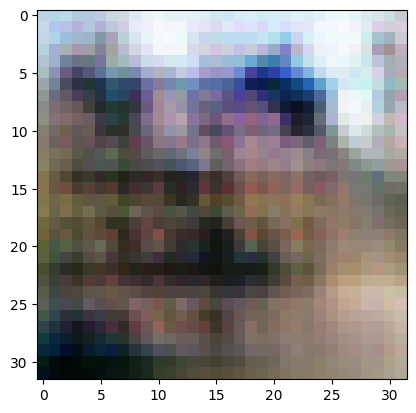

2/2 [==============================] - 0s 7ms/step
>2, 218/390, d1=0.649, d2=0.561 g=1.252


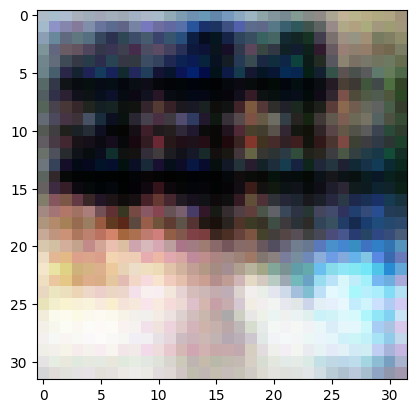

2/2 [==============================] - 0s 9ms/step
>2, 219/390, d1=0.527, d2=0.592 g=1.341


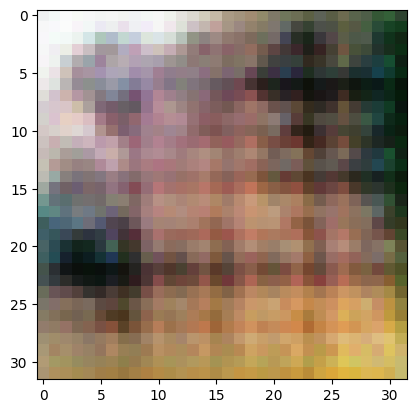

2/2 [==============================] - 0s 8ms/step
>2, 220/390, d1=0.533, d2=0.492 g=1.382


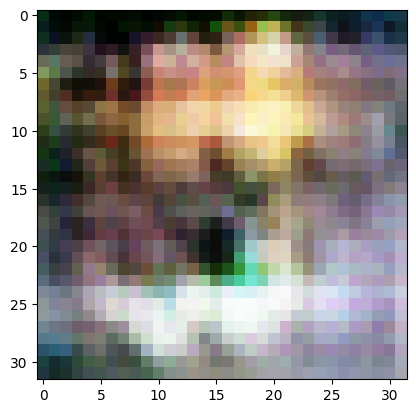

2/2 [==============================] - 0s 8ms/step
>2, 221/390, d1=0.457, d2=0.624 g=1.434


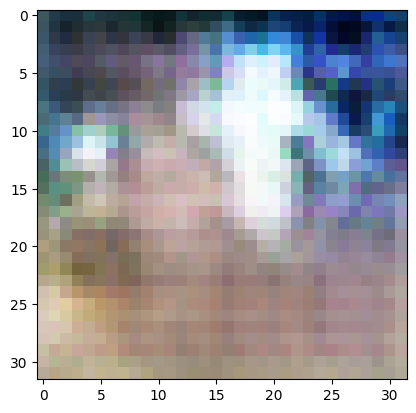

2/2 [==============================] - 0s 7ms/step
>2, 222/390, d1=0.453, d2=0.663 g=1.331


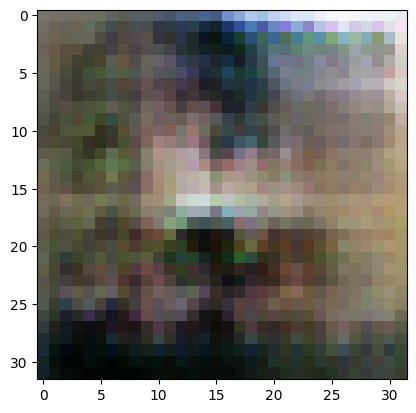

2/2 [==============================] - 0s 10ms/step
>2, 223/390, d1=0.461, d2=0.690 g=1.401


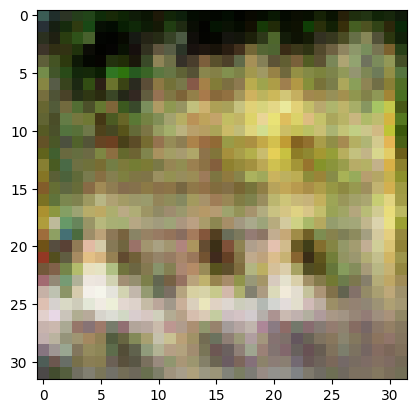

2/2 [==============================] - 0s 8ms/step
>2, 224/390, d1=0.452, d2=0.591 g=1.453


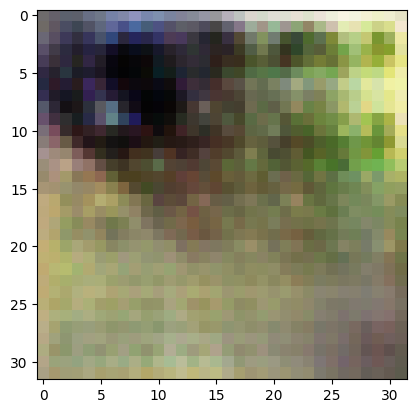

2/2 [==============================] - 0s 8ms/step
>2, 225/390, d1=0.372, d2=0.541 g=1.587


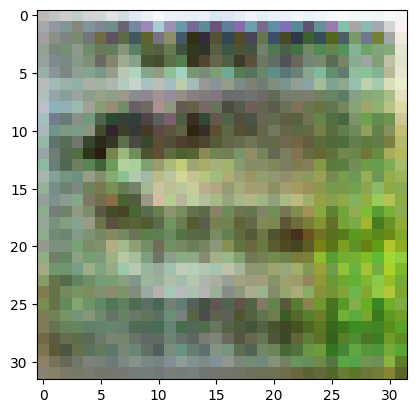

2/2 [==============================] - 0s 8ms/step
>2, 226/390, d1=0.440, d2=0.790 g=1.485


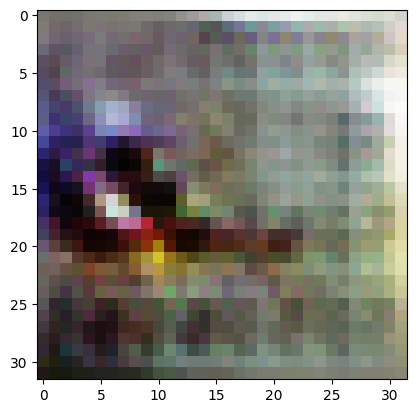

2/2 [==============================] - 0s 10ms/step
>2, 227/390, d1=0.553, d2=0.789 g=1.811


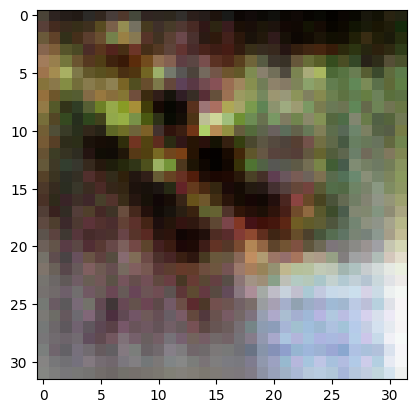

2/2 [==============================] - 0s 10ms/step
>2, 228/390, d1=0.803, d2=0.544 g=1.815


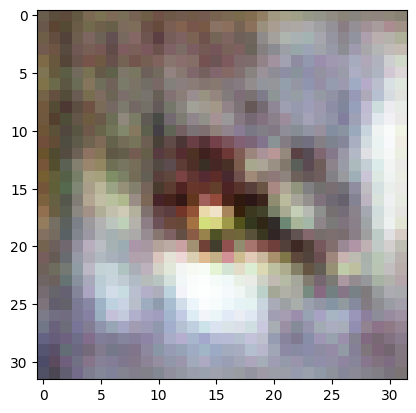

2/2 [==============================] - 0s 13ms/step
>2, 229/390, d1=0.863, d2=0.762 g=1.965


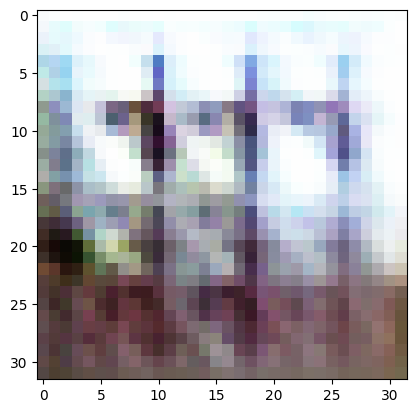

2/2 [==============================] - 0s 6ms/step
>2, 230/390, d1=0.839, d2=0.523 g=2.210


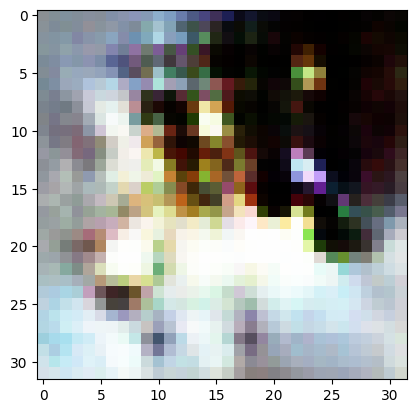

2/2 [==============================] - 0s 7ms/step
>2, 231/390, d1=0.685, d2=0.364 g=2.035


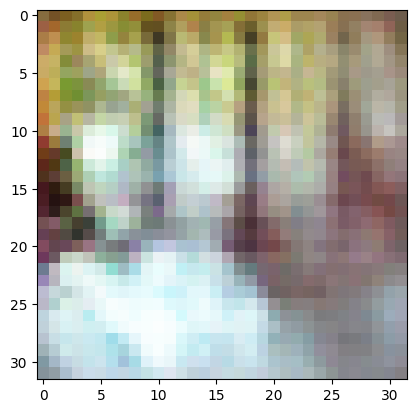

2/2 [==============================] - 0s 9ms/step
>2, 232/390, d1=0.606, d2=0.591 g=1.653


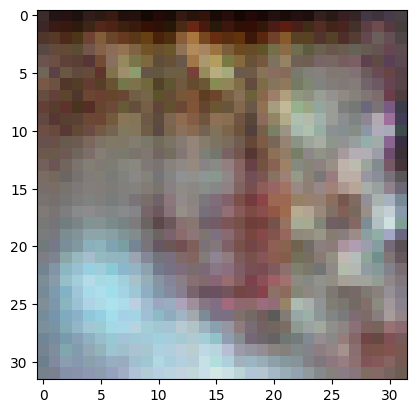

2/2 [==============================] - 0s 9ms/step
>2, 233/390, d1=0.583, d2=0.501 g=1.263


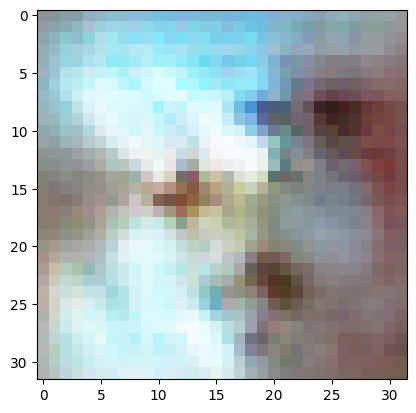

2/2 [==============================] - 0s 8ms/step
>2, 234/390, d1=0.427, d2=0.981 g=1.305


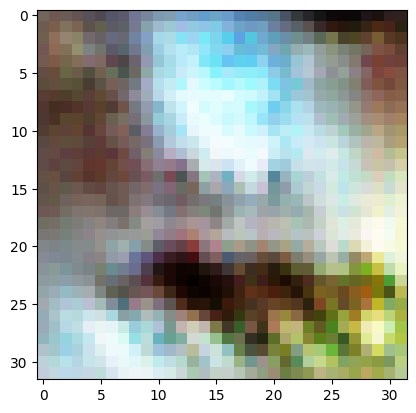

2/2 [==============================] - 0s 9ms/step
>2, 235/390, d1=0.542, d2=0.676 g=1.257


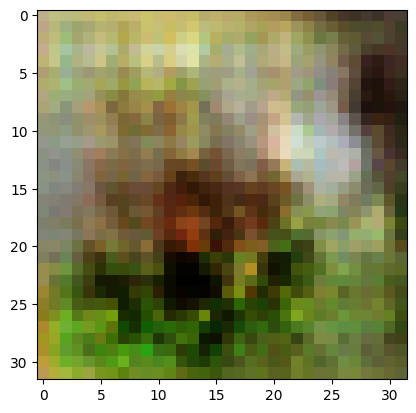

2/2 [==============================] - 0s 8ms/step
>2, 236/390, d1=0.702, d2=0.574 g=1.399


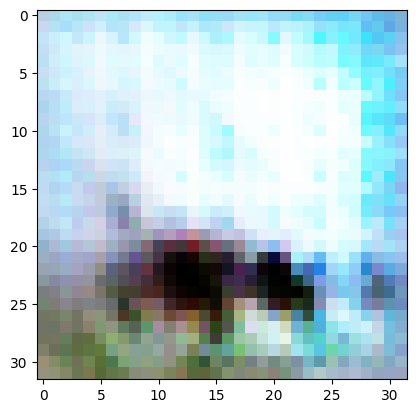

2/2 [==============================] - 0s 7ms/step
>2, 237/390, d1=0.494, d2=0.550 g=1.430


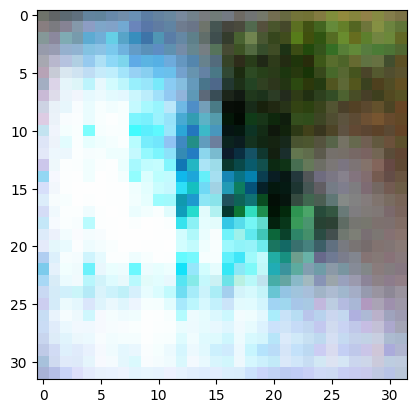

2/2 [==============================] - 0s 8ms/step
>2, 238/390, d1=0.586, d2=1.073 g=1.627


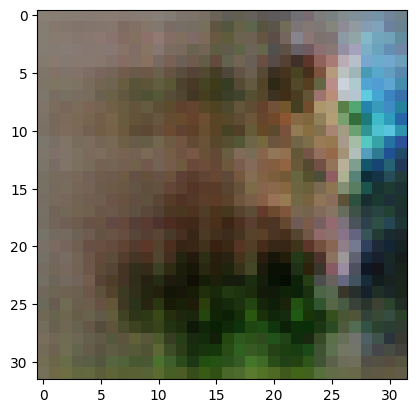

2/2 [==============================] - 0s 7ms/step
>2, 239/390, d1=0.688, d2=0.622 g=1.606


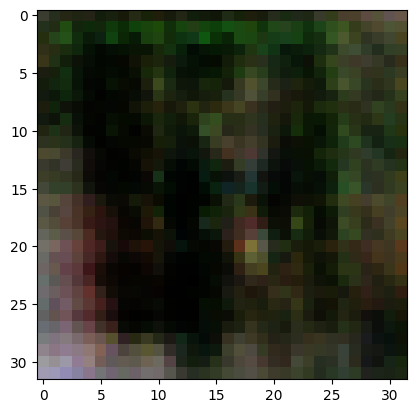

2/2 [==============================] - 0s 7ms/step
>2, 240/390, d1=0.916, d2=0.509 g=1.565


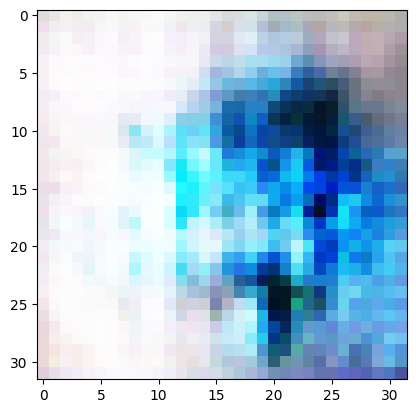

2/2 [==============================] - 0s 8ms/step
>2, 241/390, d1=0.654, d2=0.388 g=1.553


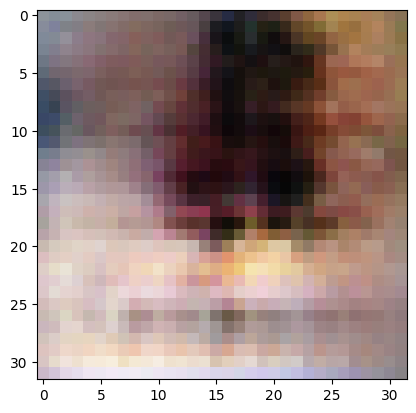

2/2 [==============================] - 0s 8ms/step
>2, 242/390, d1=0.467, d2=0.590 g=1.738


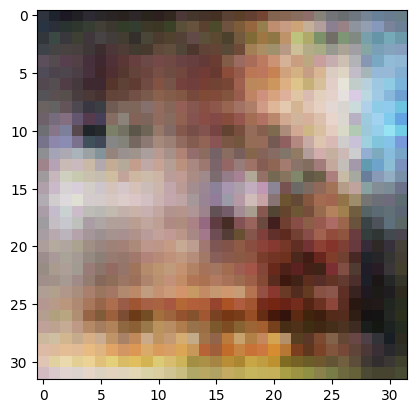

2/2 [==============================] - 0s 6ms/step
>2, 243/390, d1=0.508, d2=0.591 g=2.045


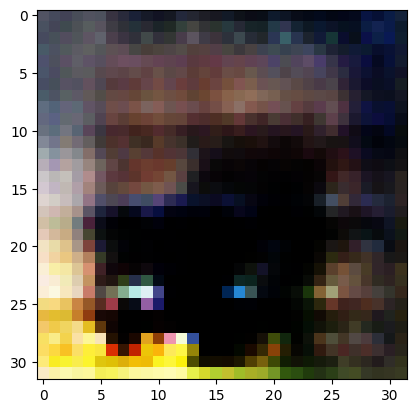

2/2 [==============================] - 0s 7ms/step
>2, 244/390, d1=0.731, d2=0.547 g=2.260


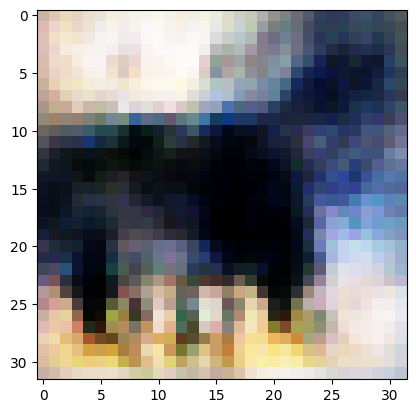

2/2 [==============================] - 0s 7ms/step
>2, 245/390, d1=0.678, d2=0.486 g=2.023


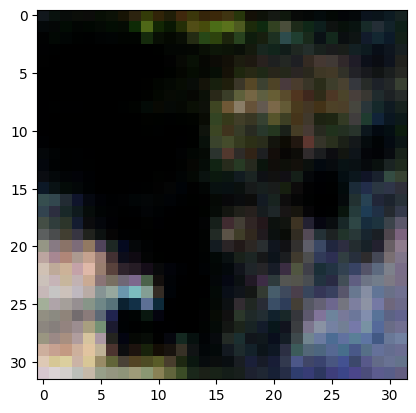

2/2 [==============================] - 0s 7ms/step
>2, 246/390, d1=0.718, d2=0.823 g=1.338


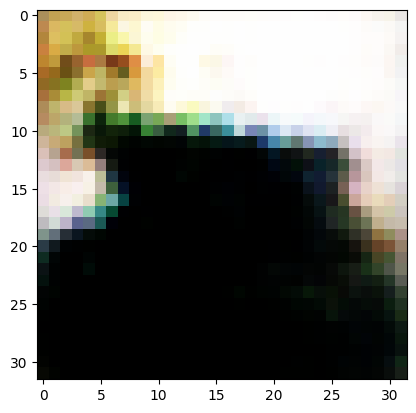

2/2 [==============================] - 0s 7ms/step
>2, 247/390, d1=0.739, d2=0.841 g=1.462


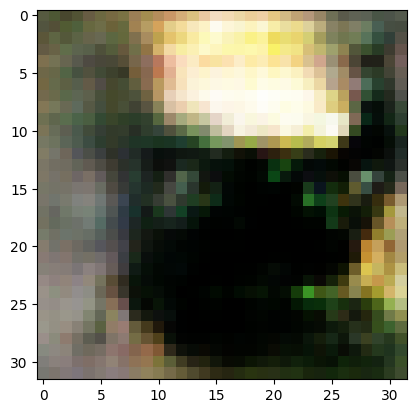

2/2 [==============================] - 0s 8ms/step
>2, 248/390, d1=0.967, d2=0.828 g=1.344


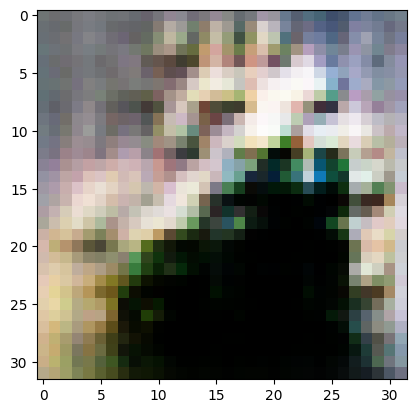

2/2 [==============================] - 0s 7ms/step
>2, 249/390, d1=0.899, d2=0.543 g=1.596


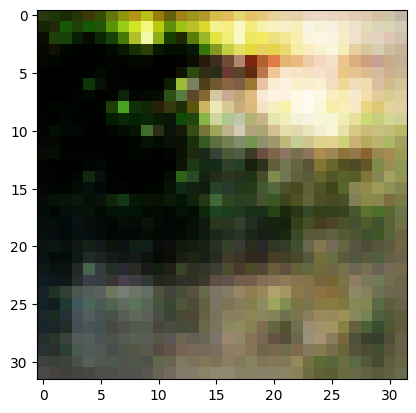

2/2 [==============================] - 0s 6ms/step
>2, 250/390, d1=0.680, d2=0.426 g=1.578


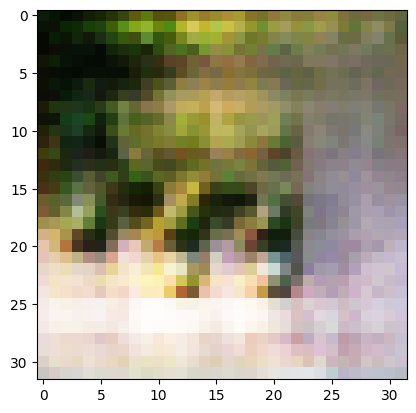

2/2 [==============================] - 0s 7ms/step
>2, 251/390, d1=0.647, d2=0.479 g=1.474


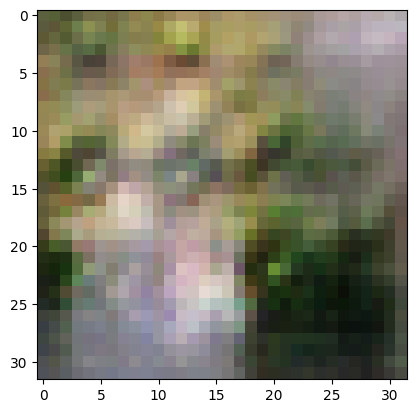

2/2 [==============================] - 0s 7ms/step
>2, 252/390, d1=0.625, d2=0.631 g=1.533


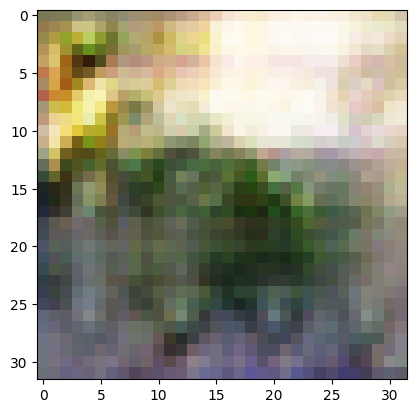

2/2 [==============================] - 0s 8ms/step
>2, 253/390, d1=0.693, d2=0.700 g=1.334


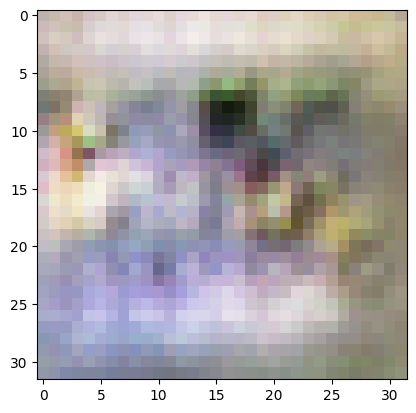

2/2 [==============================] - 0s 7ms/step
>2, 254/390, d1=0.695, d2=0.625 g=1.361


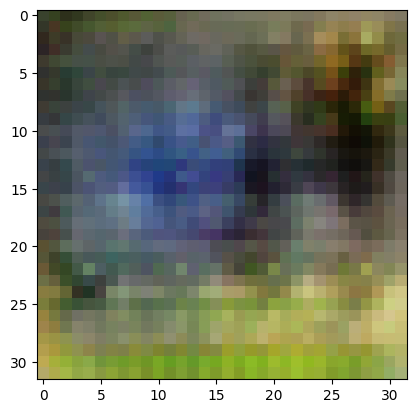

2/2 [==============================] - 0s 18ms/step
>2, 255/390, d1=0.694, d2=0.597 g=1.165


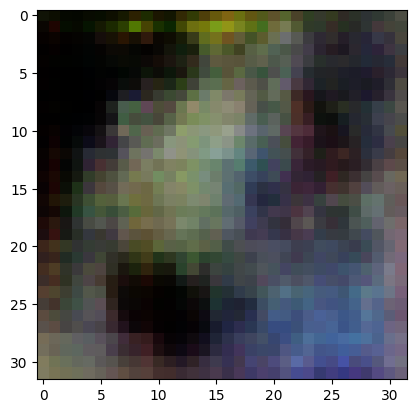

2/2 [==============================] - 0s 7ms/step
>2, 256/390, d1=0.685, d2=0.601 g=1.149


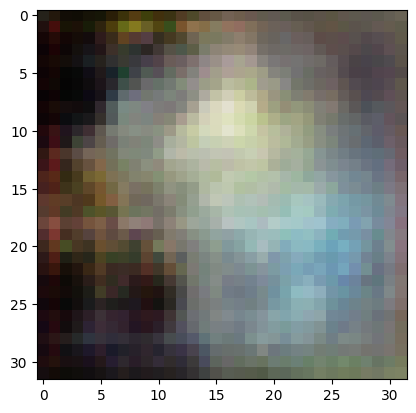

2/2 [==============================] - 0s 11ms/step
>2, 257/390, d1=0.596, d2=0.648 g=1.158


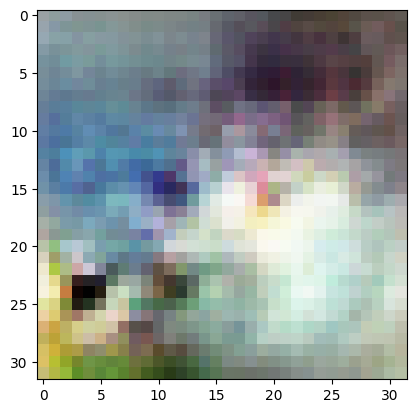

2/2 [==============================] - 0s 7ms/step
>2, 258/390, d1=0.596, d2=0.597 g=1.106


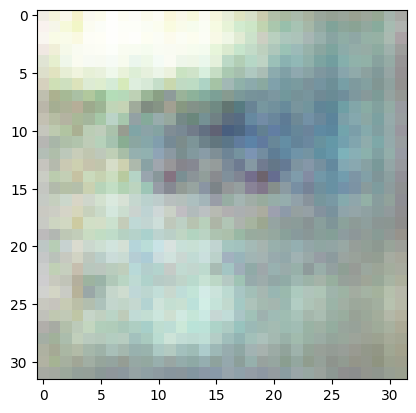

2/2 [==============================] - 0s 7ms/step
>2, 259/390, d1=0.522, d2=0.613 g=1.148


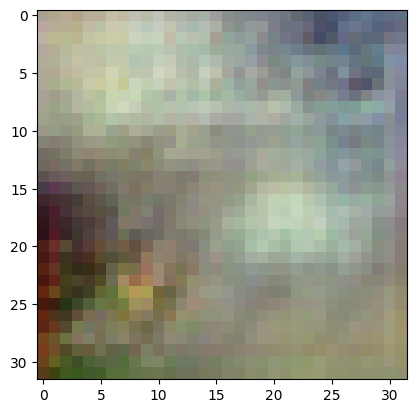

2/2 [==============================] - 0s 10ms/step
>2, 260/390, d1=0.573, d2=0.630 g=1.323


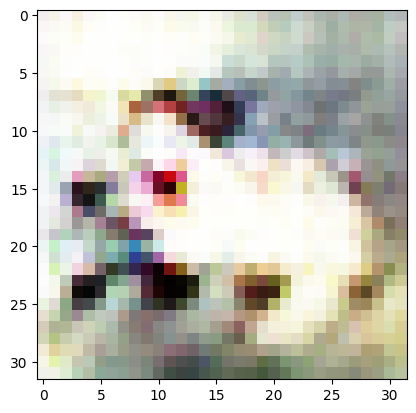

2/2 [==============================] - 0s 8ms/step
>2, 261/390, d1=0.650, d2=0.504 g=1.281


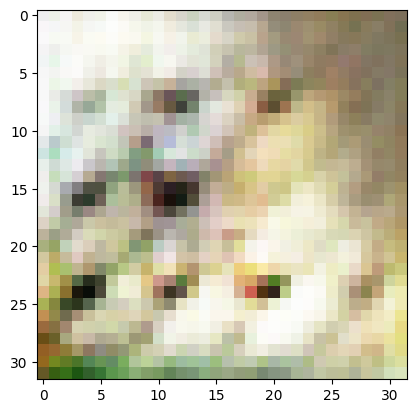

2/2 [==============================] - 0s 7ms/step
>2, 262/390, d1=0.641, d2=0.713 g=1.476


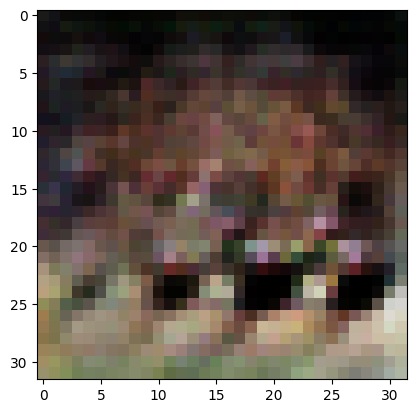

2/2 [==============================] - 0s 8ms/step
>2, 263/390, d1=0.584, d2=0.447 g=1.652


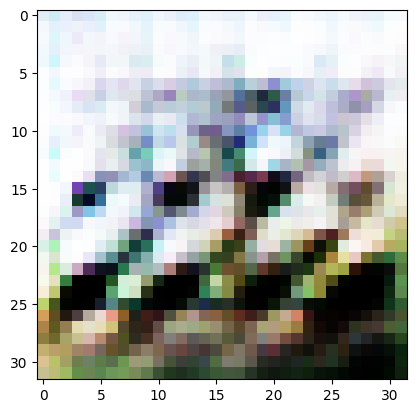

2/2 [==============================] - 0s 7ms/step
>2, 264/390, d1=0.644, d2=0.410 g=1.841


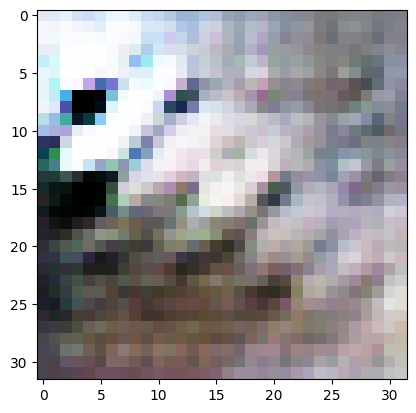

2/2 [==============================] - 0s 8ms/step
>2, 265/390, d1=0.462, d2=0.527 g=1.755


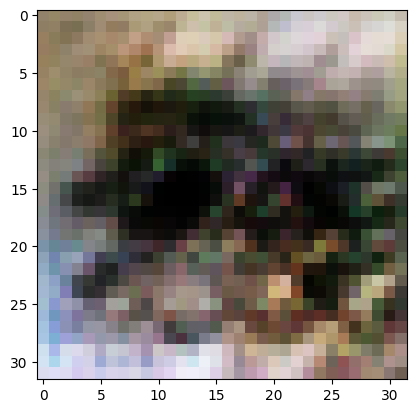

2/2 [==============================] - 0s 6ms/step
>2, 266/390, d1=0.490, d2=0.745 g=1.701


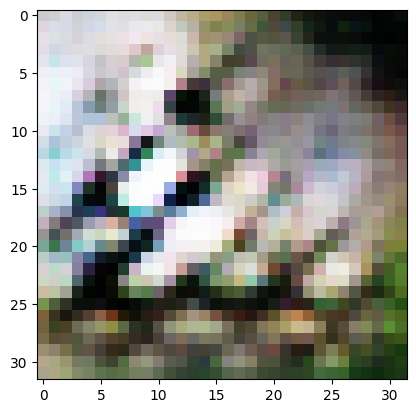

2/2 [==============================] - 0s 7ms/step
>2, 267/390, d1=0.685, d2=0.695 g=1.330


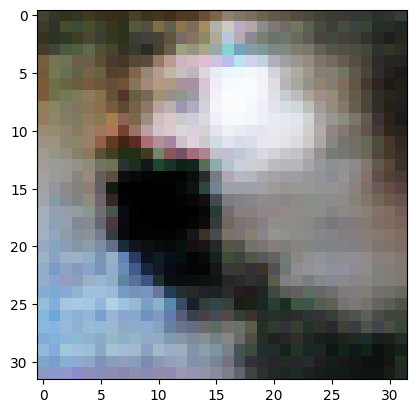

2/2 [==============================] - 0s 7ms/step
>2, 268/390, d1=0.674, d2=0.584 g=1.285


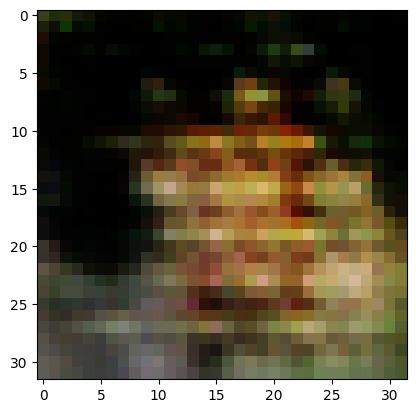

2/2 [==============================] - 0s 8ms/step
>2, 269/390, d1=0.801, d2=0.655 g=1.160


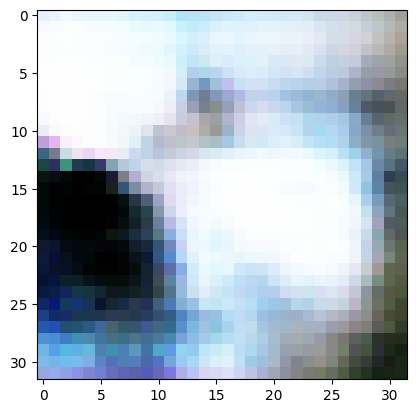

2/2 [==============================] - 0s 6ms/step
>2, 270/390, d1=0.619, d2=0.565 g=1.217


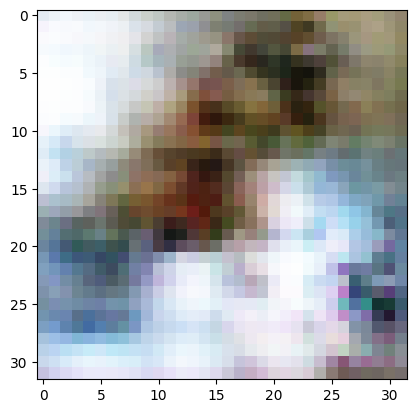

2/2 [==============================] - 0s 8ms/step
>2, 271/390, d1=0.569, d2=0.593 g=1.453


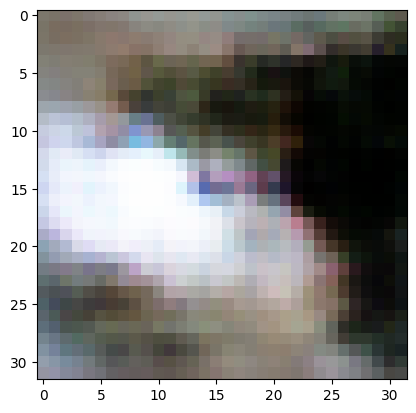

2/2 [==============================] - 0s 7ms/step
>2, 272/390, d1=0.663, d2=0.521 g=1.516


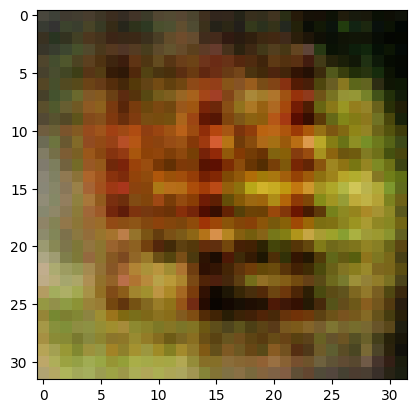

2/2 [==============================] - 0s 8ms/step
>2, 273/390, d1=0.635, d2=0.515 g=1.404


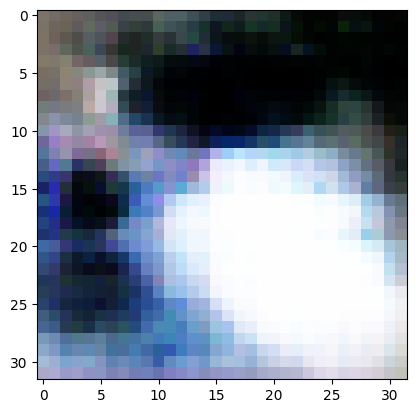

2/2 [==============================] - 0s 8ms/step
>2, 274/390, d1=0.545, d2=0.646 g=1.388


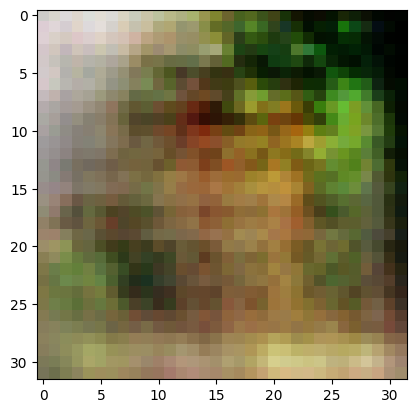

2/2 [==============================] - 0s 11ms/step
>2, 275/390, d1=0.663, d2=0.710 g=1.329


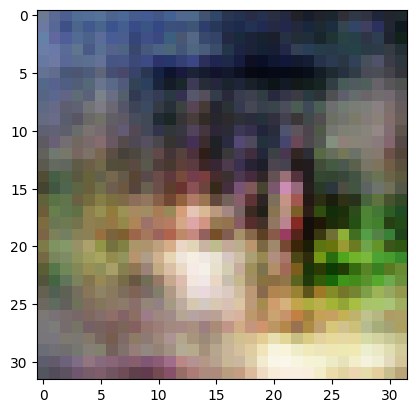

2/2 [==============================] - 0s 8ms/step
>2, 276/390, d1=0.614, d2=0.735 g=1.269


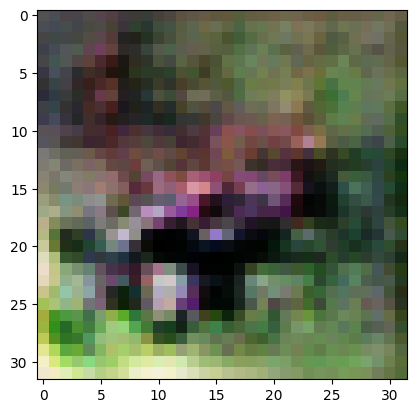

2/2 [==============================] - 0s 8ms/step
>2, 277/390, d1=0.688, d2=0.691 g=1.303


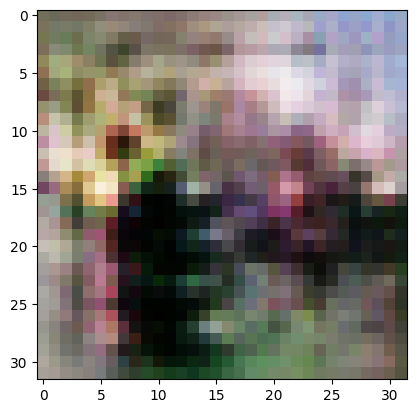

2/2 [==============================] - 0s 12ms/step
>2, 278/390, d1=0.694, d2=0.627 g=1.490


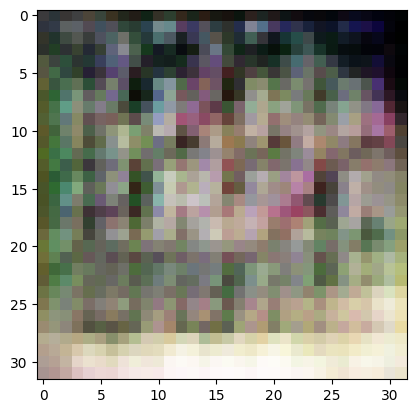

2/2 [==============================] - 0s 6ms/step
>2, 279/390, d1=0.627, d2=0.521 g=1.418


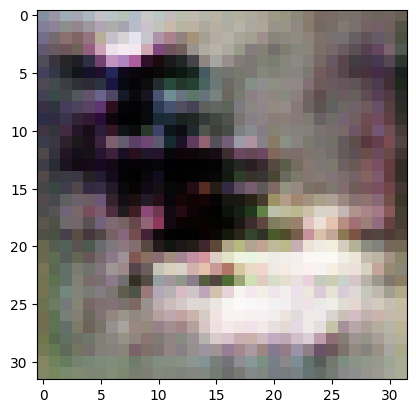

2/2 [==============================] - 0s 9ms/step
>2, 280/390, d1=0.577, d2=0.622 g=1.391


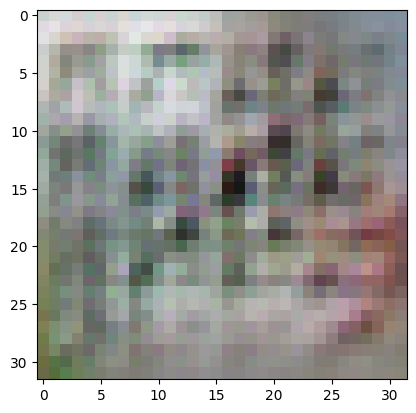

2/2 [==============================] - 0s 11ms/step
>2, 281/390, d1=0.545, d2=0.828 g=1.343


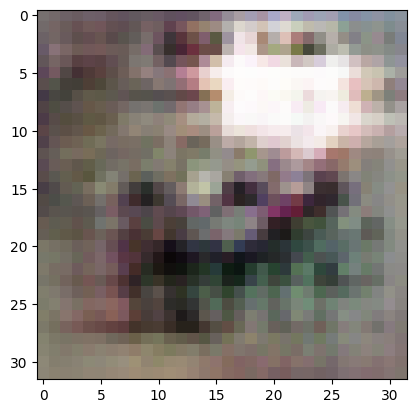

2/2 [==============================] - 0s 8ms/step
>2, 282/390, d1=0.572, d2=0.704 g=1.469


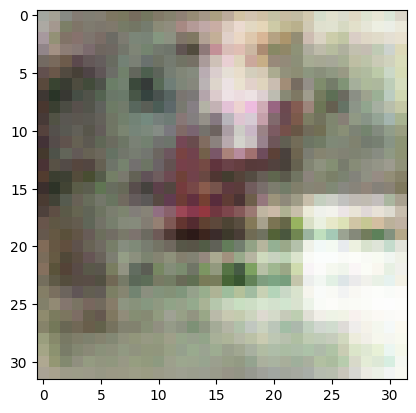

2/2 [==============================] - 0s 6ms/step
>2, 283/390, d1=0.710, d2=0.610 g=1.500


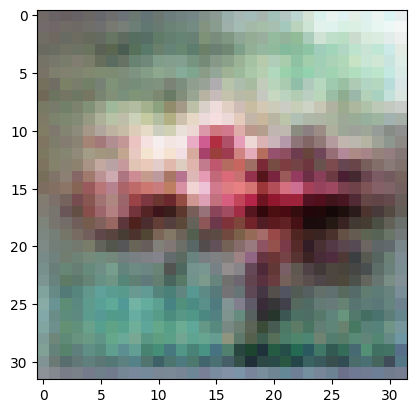

2/2 [==============================] - 0s 8ms/step
>2, 284/390, d1=0.673, d2=0.731 g=1.858


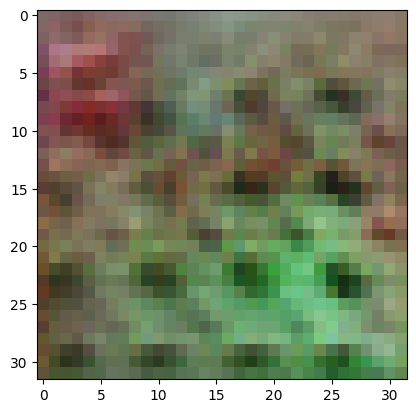

2/2 [==============================] - 0s 6ms/step
>2, 285/390, d1=0.669, d2=0.441 g=1.827


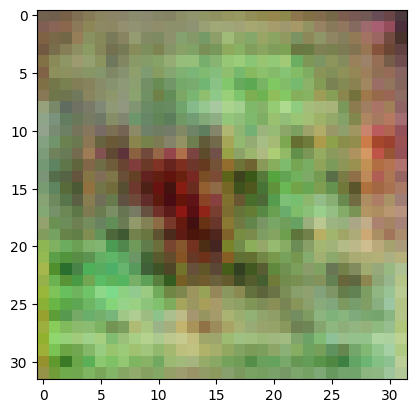

2/2 [==============================] - 0s 7ms/step
>2, 286/390, d1=0.603, d2=0.662 g=1.300


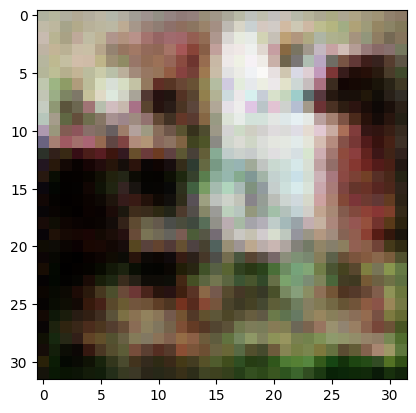

2/2 [==============================] - 0s 8ms/step
>2, 287/390, d1=0.681, d2=0.723 g=1.557


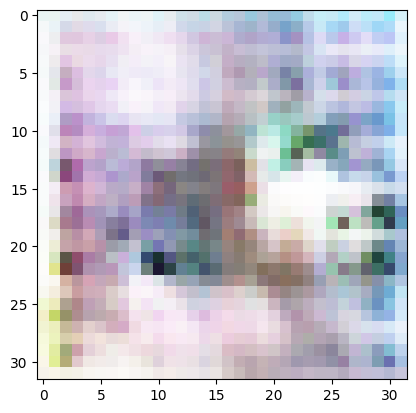

2/2 [==============================] - 0s 8ms/step
>2, 288/390, d1=0.935, d2=0.460 g=1.407


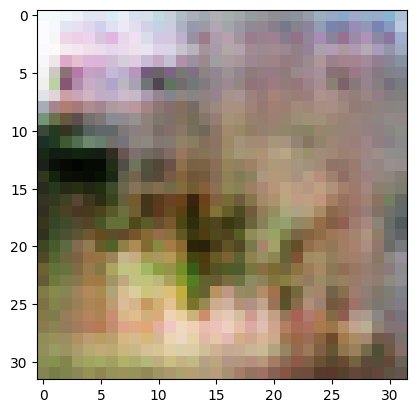

2/2 [==============================] - 0s 8ms/step
>2, 289/390, d1=0.678, d2=0.501 g=1.431


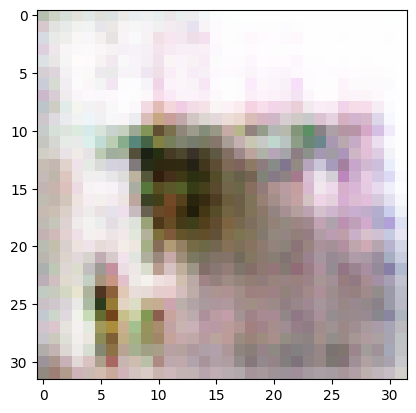

2/2 [==============================] - 0s 9ms/step
>2, 290/390, d1=0.652, d2=0.554 g=1.284


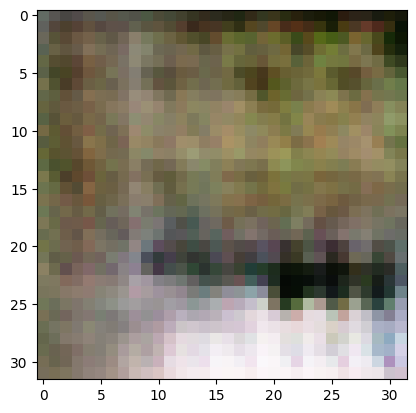

2/2 [==============================] - 0s 8ms/step
>2, 291/390, d1=0.526, d2=0.653 g=1.264


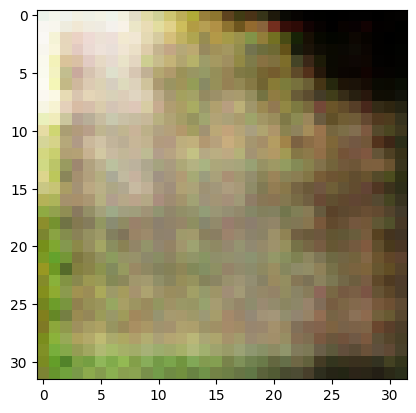

2/2 [==============================] - 0s 7ms/step
>2, 292/390, d1=0.652, d2=0.656 g=1.070


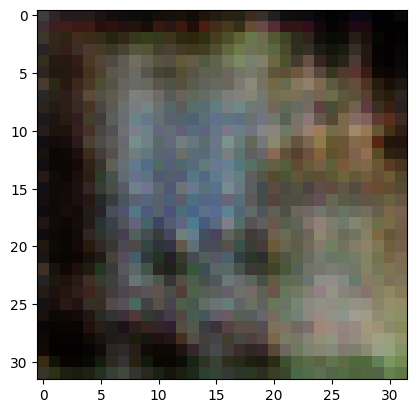

2/2 [==============================] - 0s 9ms/step
>2, 293/390, d1=0.750, d2=0.735 g=1.030


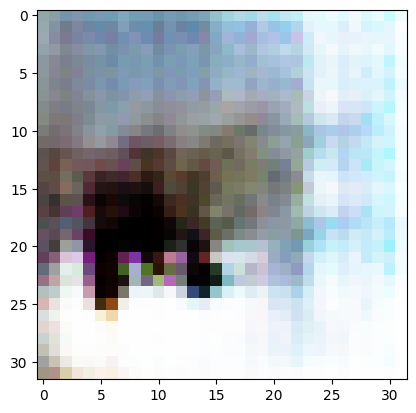

2/2 [==============================] - 0s 8ms/step
>2, 294/390, d1=0.621, d2=0.680 g=1.167


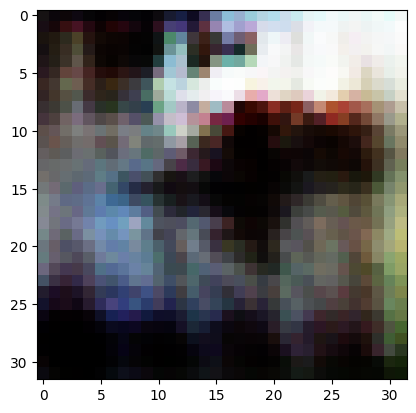

2/2 [==============================] - 0s 9ms/step
>2, 295/390, d1=0.659, d2=0.660 g=1.279


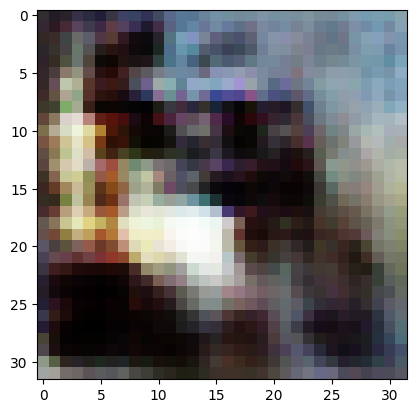

2/2 [==============================] - 0s 8ms/step
>2, 296/390, d1=0.762, d2=0.592 g=1.205


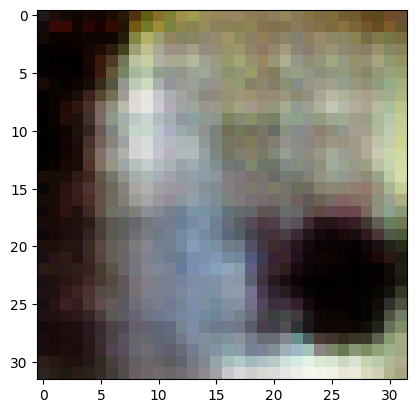

2/2 [==============================] - 0s 7ms/step
>2, 297/390, d1=0.801, d2=0.646 g=1.040


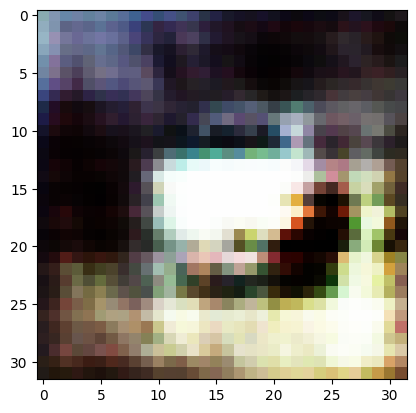

2/2 [==============================] - 0s 8ms/step
>2, 298/390, d1=0.676, d2=0.697 g=1.174


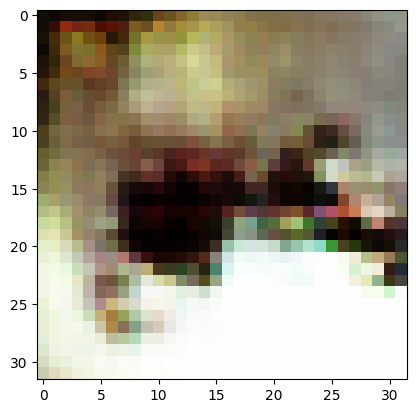

2/2 [==============================] - 0s 8ms/step
>2, 299/390, d1=0.632, d2=0.597 g=1.308


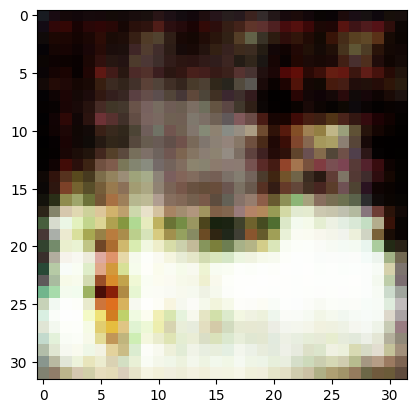

2/2 [==============================] - 0s 6ms/step
>2, 300/390, d1=0.696, d2=0.540 g=1.314


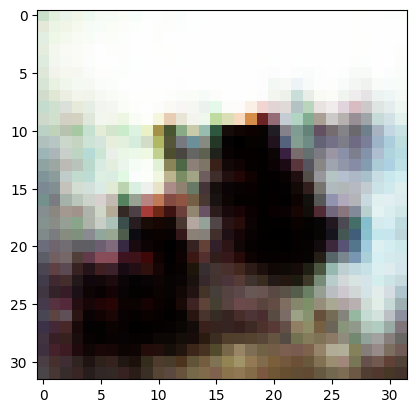

2/2 [==============================] - 0s 5ms/step
>2, 301/390, d1=0.760, d2=0.603 g=1.383


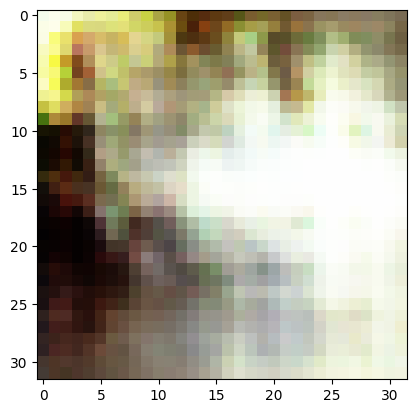

2/2 [==============================] - 0s 7ms/step
>2, 302/390, d1=0.740, d2=0.612 g=1.244


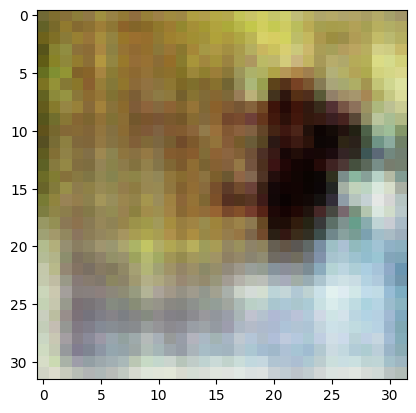

2/2 [==============================] - 0s 8ms/step
>2, 303/390, d1=0.685, d2=0.649 g=1.218


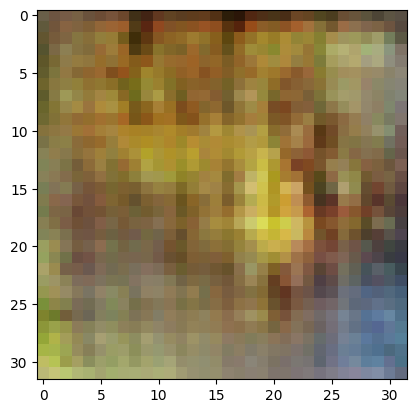

2/2 [==============================] - 0s 8ms/step
>2, 304/390, d1=0.675, d2=0.569 g=1.165


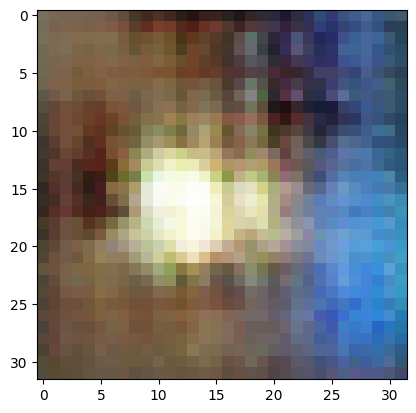

2/2 [==============================] - 0s 7ms/step
>2, 305/390, d1=0.667, d2=0.597 g=1.102


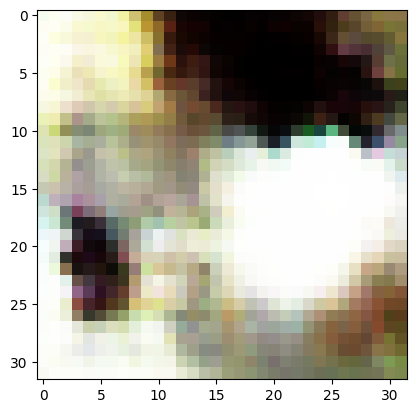

2/2 [==============================] - 0s 7ms/step
>2, 306/390, d1=0.697, d2=0.652 g=1.095


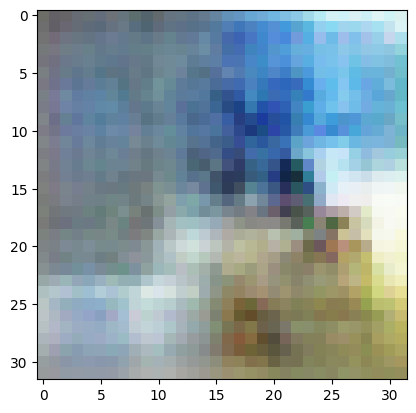

2/2 [==============================] - 0s 8ms/step
>2, 307/390, d1=0.665, d2=0.592 g=1.071


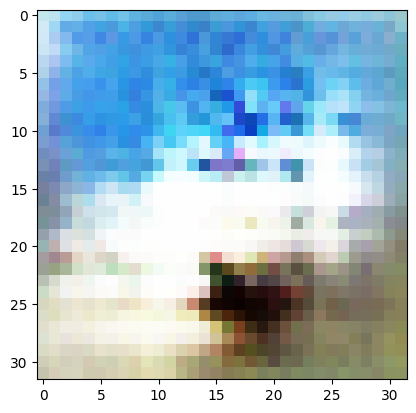

2/2 [==============================] - 0s 8ms/step
>2, 308/390, d1=0.654, d2=0.567 g=1.129


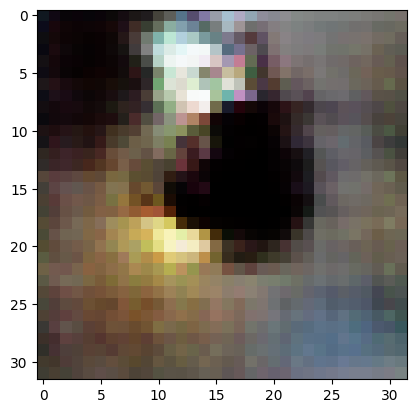

2/2 [==============================] - 0s 7ms/step
>2, 309/390, d1=0.621, d2=0.661 g=1.105


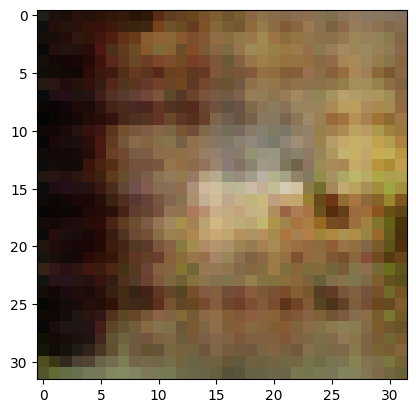

2/2 [==============================] - 0s 7ms/step
>2, 310/390, d1=0.582, d2=0.577 g=1.118


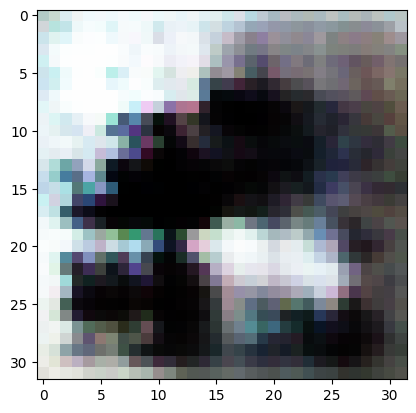

2/2 [==============================] - 0s 8ms/step
>2, 311/390, d1=0.496, d2=0.673 g=1.233


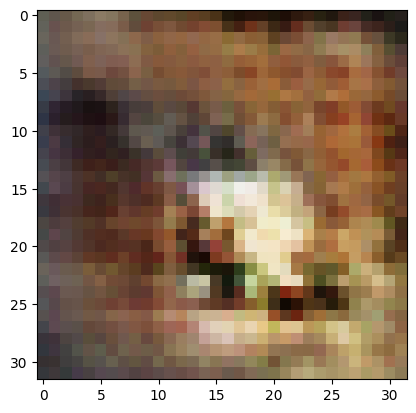

2/2 [==============================] - 0s 7ms/step
>2, 312/390, d1=0.568, d2=0.576 g=1.336


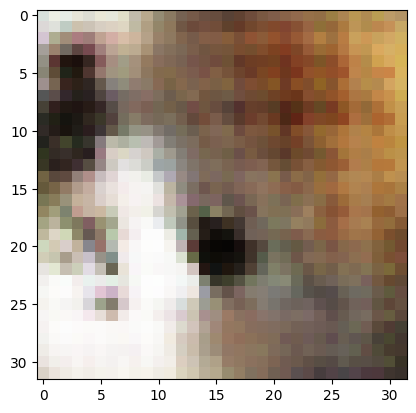

2/2 [==============================] - 0s 7ms/step
>2, 313/390, d1=0.600, d2=0.663 g=1.297


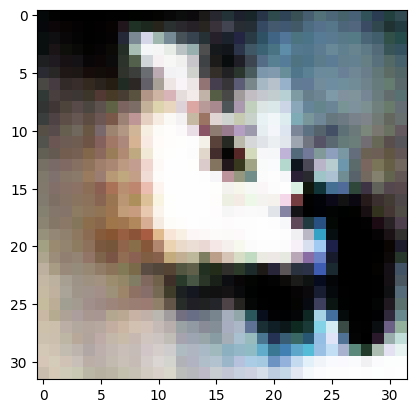

2/2 [==============================] - 0s 7ms/step
>2, 314/390, d1=0.630, d2=0.770 g=1.252


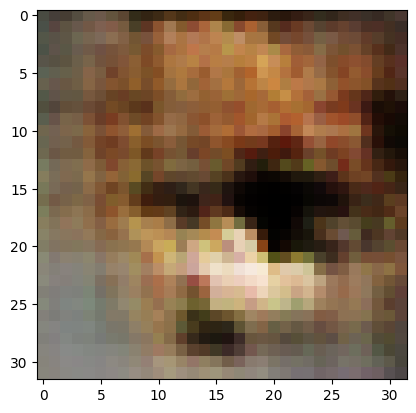

2/2 [==============================] - 0s 7ms/step
>2, 315/390, d1=0.747, d2=0.706 g=1.245


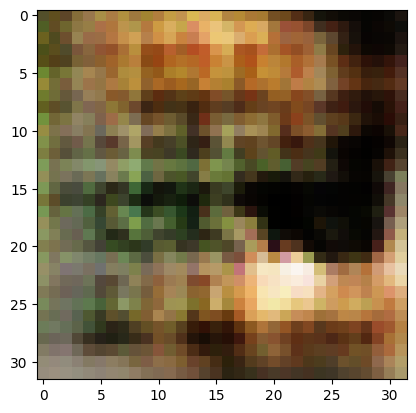

2/2 [==============================] - 0s 8ms/step
>2, 316/390, d1=0.742, d2=0.598 g=1.225


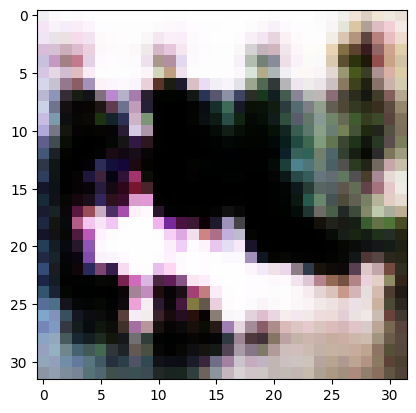

2/2 [==============================] - 0s 7ms/step
>2, 317/390, d1=0.719, d2=0.665 g=1.288


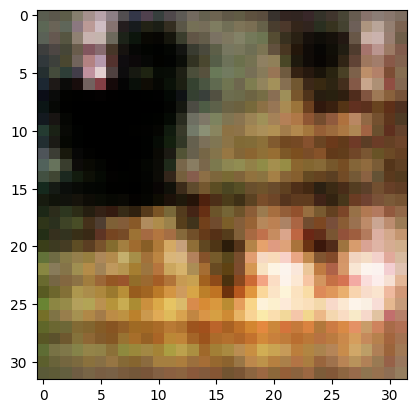

2/2 [==============================] - 0s 7ms/step
>2, 318/390, d1=0.798, d2=0.594 g=1.297


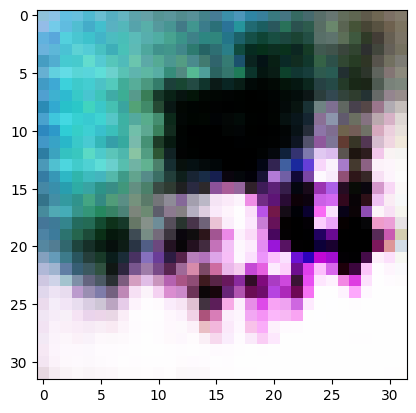

2/2 [==============================] - 0s 6ms/step
>2, 319/390, d1=0.692, d2=0.537 g=1.474


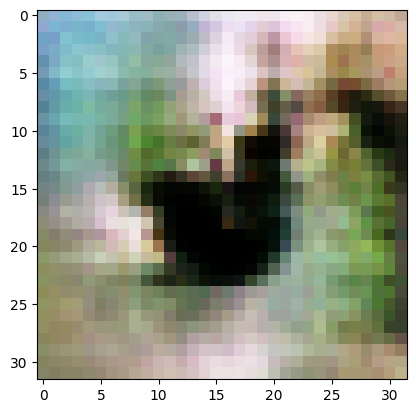

2/2 [==============================] - 0s 6ms/step
>2, 320/390, d1=0.678, d2=0.453 g=1.462


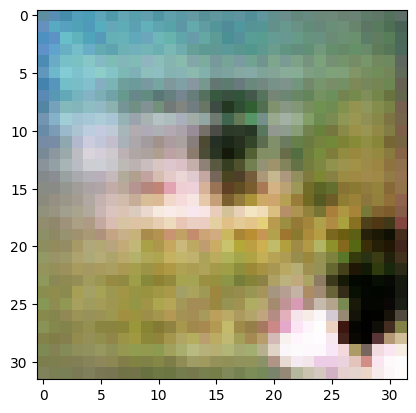

2/2 [==============================] - 0s 10ms/step
>2, 321/390, d1=0.730, d2=0.498 g=1.314


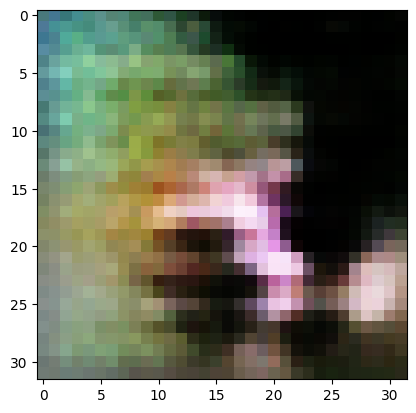

2/2 [==============================] - 0s 7ms/step
>2, 322/390, d1=0.604, d2=0.470 g=1.348


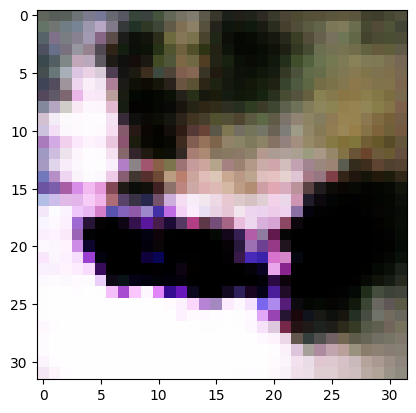

2/2 [==============================] - 0s 8ms/step
>2, 323/390, d1=0.614, d2=0.649 g=1.279


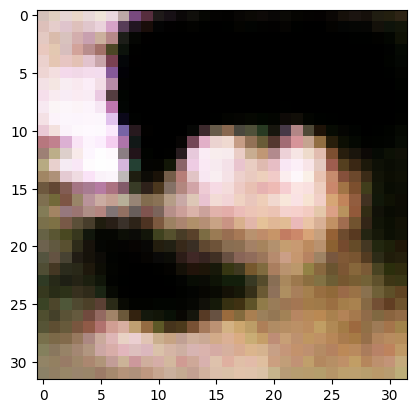

2/2 [==============================] - 0s 8ms/step
>2, 324/390, d1=0.599, d2=0.597 g=1.280


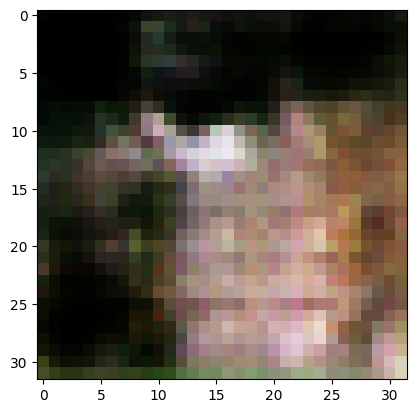

2/2 [==============================] - 0s 7ms/step
>2, 325/390, d1=0.680, d2=0.538 g=1.232


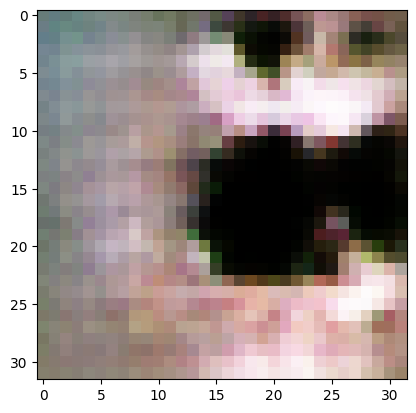

2/2 [==============================] - 0s 8ms/step
>2, 326/390, d1=0.675, d2=0.626 g=1.138


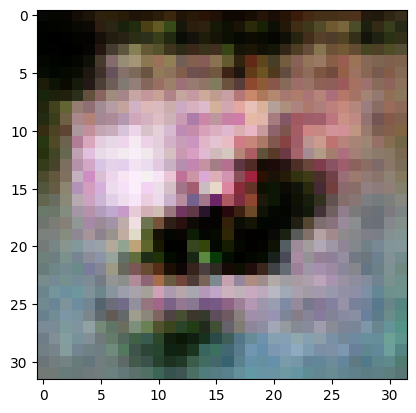

2/2 [==============================] - 0s 6ms/step
>2, 327/390, d1=0.659, d2=0.649 g=1.205


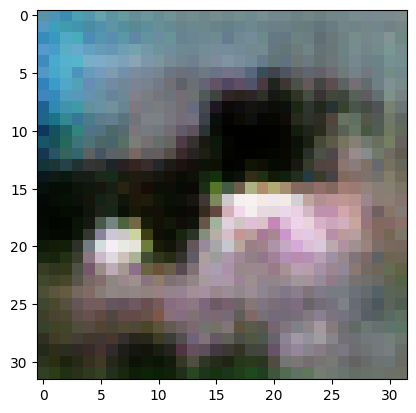

2/2 [==============================] - 0s 6ms/step
>2, 328/390, d1=0.618, d2=0.512 g=1.262


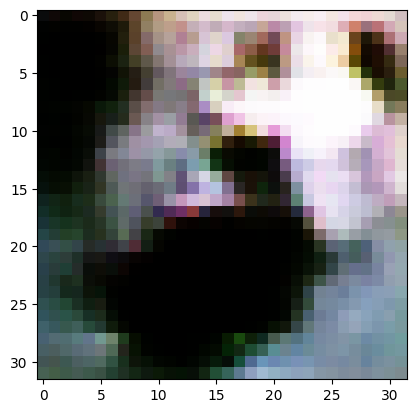

2/2 [==============================] - 0s 8ms/step
>2, 329/390, d1=0.544, d2=0.616 g=1.315


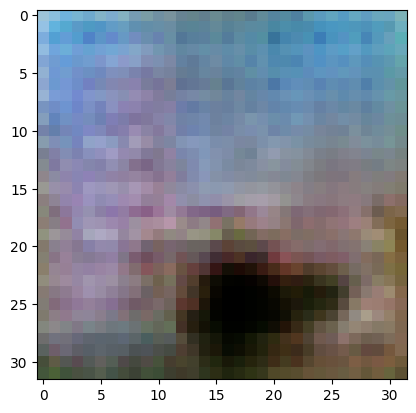

2/2 [==============================] - 0s 9ms/step
>2, 330/390, d1=0.647, d2=0.526 g=1.385


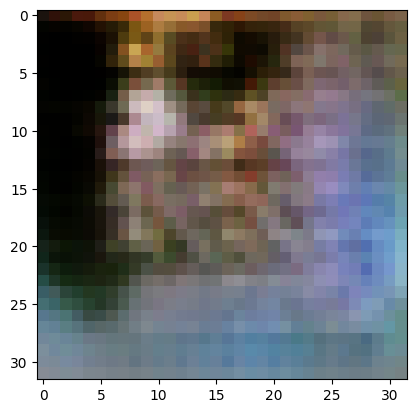

2/2 [==============================] - 0s 7ms/step
>2, 331/390, d1=0.598, d2=0.574 g=1.351


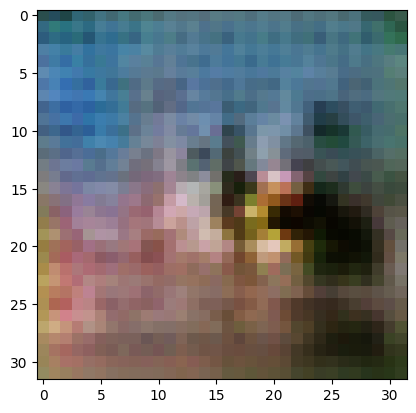

2/2 [==============================] - 0s 8ms/step
>2, 332/390, d1=0.711, d2=0.736 g=1.383


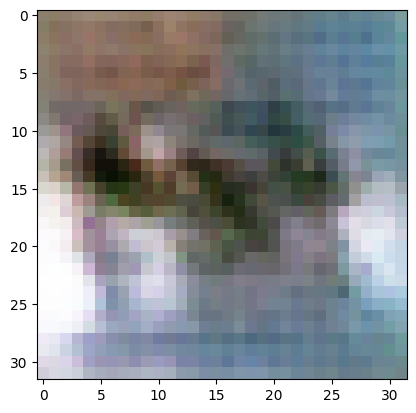

2/2 [==============================] - 0s 8ms/step
>2, 333/390, d1=0.681, d2=0.528 g=1.439


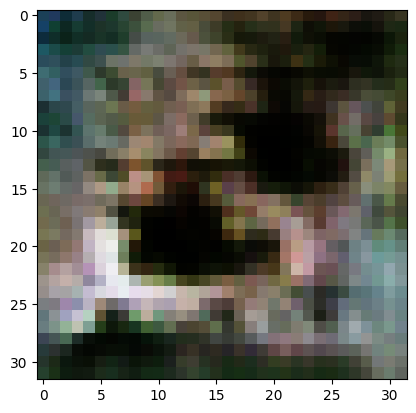

2/2 [==============================] - 0s 7ms/step
>2, 334/390, d1=0.633, d2=0.433 g=1.559


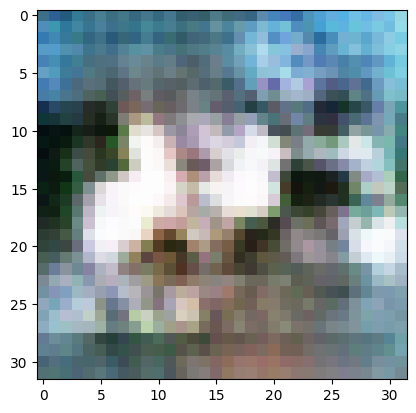

2/2 [==============================] - 0s 8ms/step
>2, 335/390, d1=0.513, d2=0.485 g=1.514


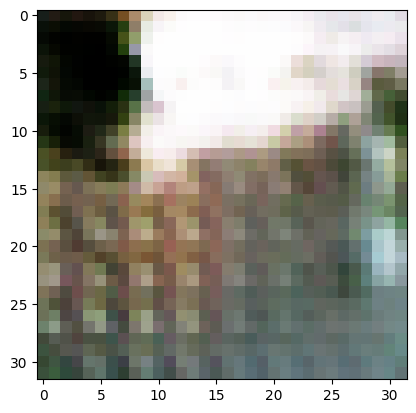

2/2 [==============================] - 0s 7ms/step
>2, 336/390, d1=0.590, d2=0.550 g=1.378


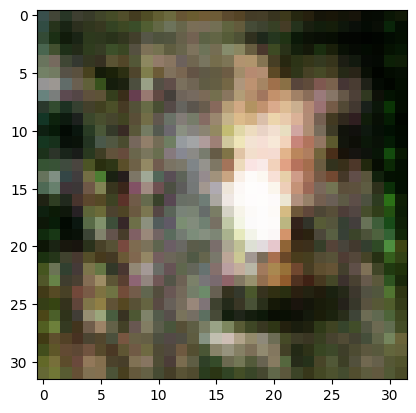

2/2 [==============================] - 0s 7ms/step
>2, 337/390, d1=0.505, d2=0.648 g=1.305


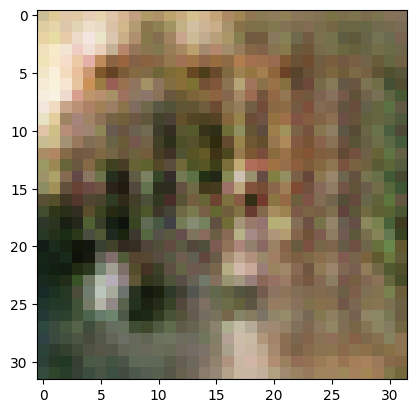

2/2 [==============================] - 0s 6ms/step
>2, 338/390, d1=0.534, d2=0.599 g=1.340


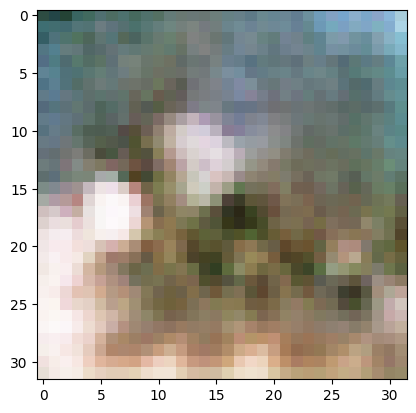

2/2 [==============================] - 0s 7ms/step
>2, 339/390, d1=0.579, d2=0.515 g=1.317


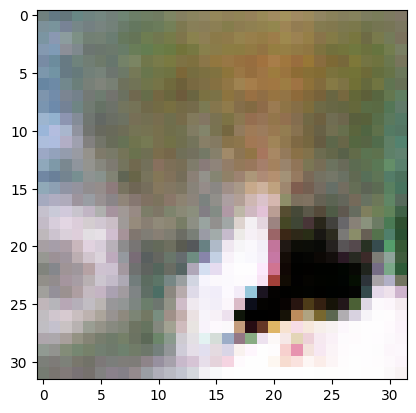

2/2 [==============================] - 0s 8ms/step
>2, 340/390, d1=0.466, d2=0.507 g=1.324


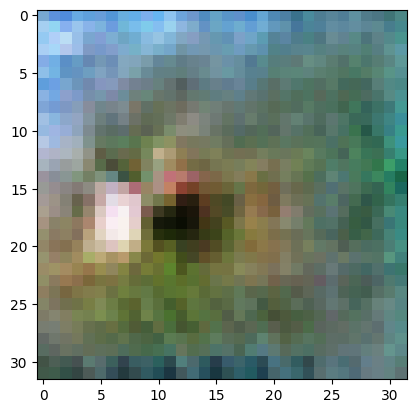

2/2 [==============================] - 0s 7ms/step
>2, 341/390, d1=0.573, d2=0.694 g=1.403


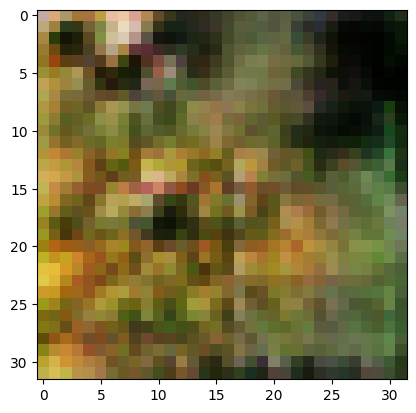

2/2 [==============================] - 0s 8ms/step
>2, 342/390, d1=0.401, d2=0.799 g=1.480


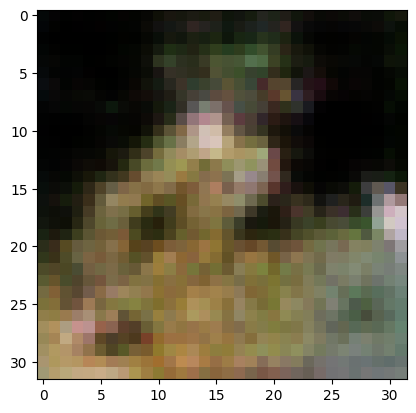

2/2 [==============================] - 0s 8ms/step
>2, 343/390, d1=0.737, d2=0.725 g=1.348


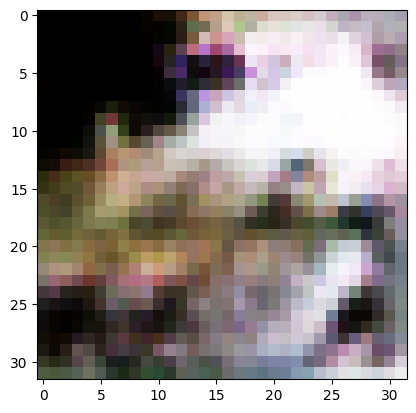

2/2 [==============================] - 0s 8ms/step
>2, 344/390, d1=0.826, d2=0.637 g=1.341


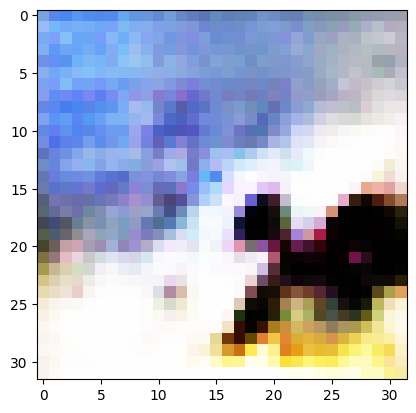

2/2 [==============================] - 0s 5ms/step
>2, 345/390, d1=0.908, d2=0.697 g=1.275


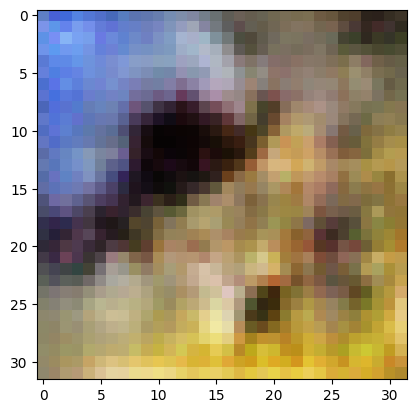

2/2 [==============================] - 0s 9ms/step
>2, 346/390, d1=0.785, d2=0.575 g=1.276


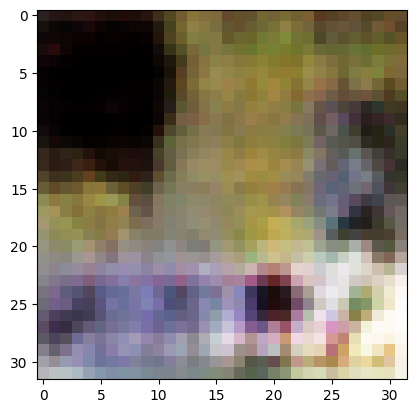

2/2 [==============================] - 0s 7ms/step
>2, 347/390, d1=0.816, d2=0.536 g=1.196


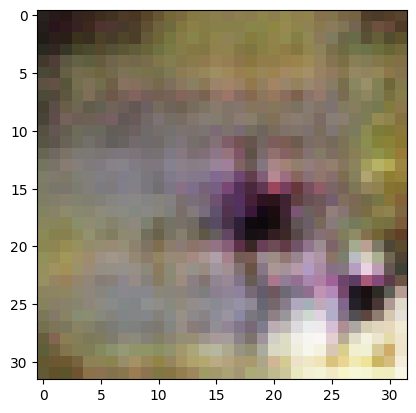

2/2 [==============================] - 0s 7ms/step
>2, 348/390, d1=0.769, d2=0.600 g=1.197


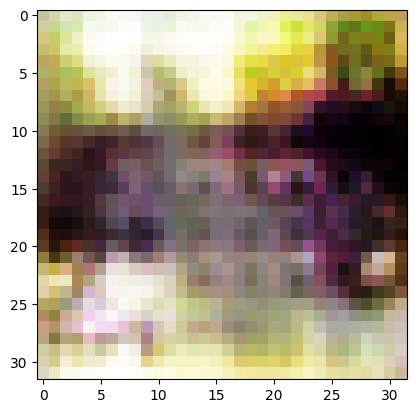

2/2 [==============================] - 0s 7ms/step
>2, 349/390, d1=0.713, d2=0.644 g=1.198


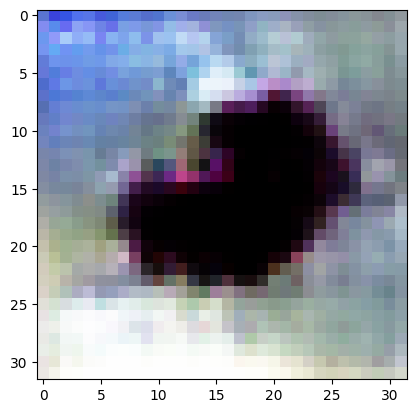

2/2 [==============================] - 0s 8ms/step
>2, 350/390, d1=0.803, d2=0.666 g=1.197


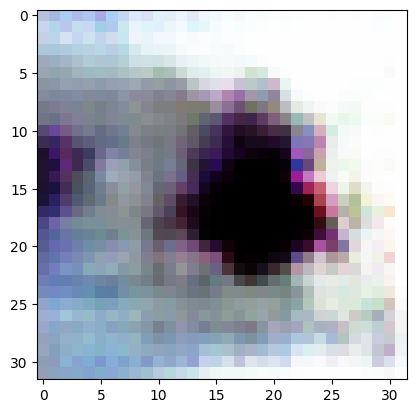

2/2 [==============================] - 0s 7ms/step
>2, 351/390, d1=0.646, d2=0.548 g=1.258


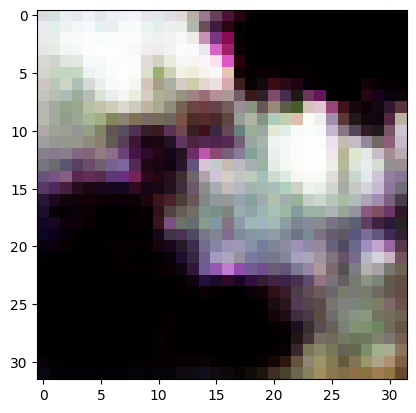

2/2 [==============================] - 0s 7ms/step
>2, 352/390, d1=0.736, d2=0.601 g=1.285


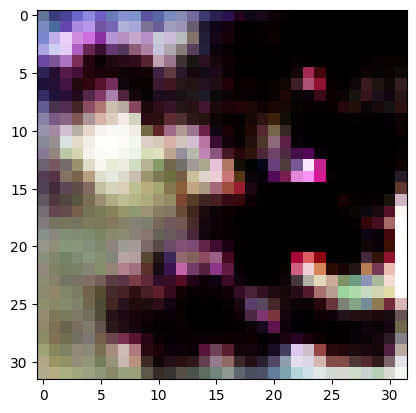

2/2 [==============================] - 0s 8ms/step
>2, 353/390, d1=0.523, d2=0.526 g=1.309


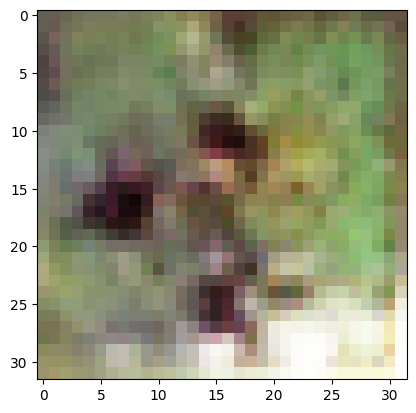

2/2 [==============================] - 0s 7ms/step
>2, 354/390, d1=0.470, d2=0.674 g=1.379


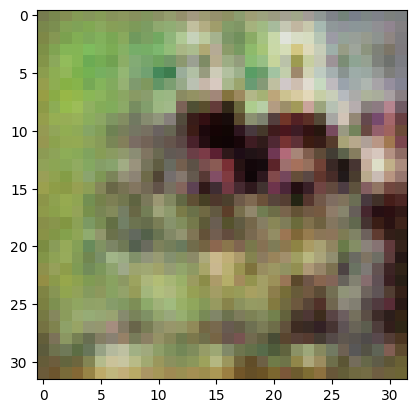

2/2 [==============================] - 0s 8ms/step
>2, 355/390, d1=0.551, d2=0.591 g=1.429


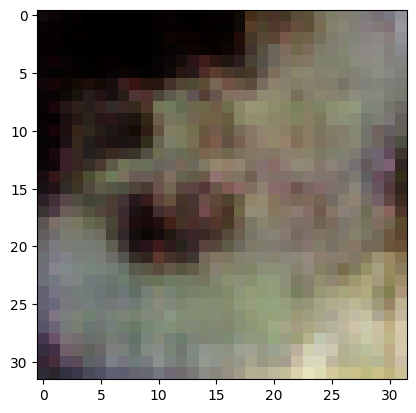

2/2 [==============================] - 0s 8ms/step
>2, 356/390, d1=0.624, d2=0.666 g=1.419


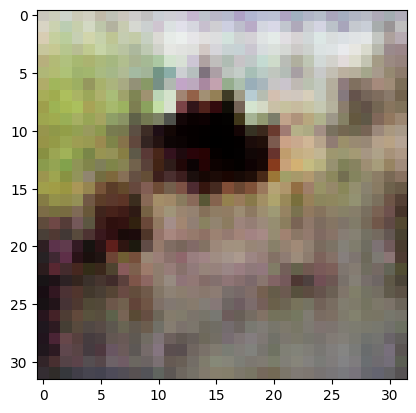

2/2 [==============================] - 0s 8ms/step
>2, 357/390, d1=0.708, d2=0.642 g=1.468


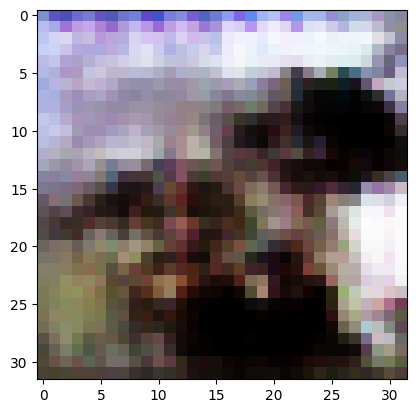

2/2 [==============================] - 0s 7ms/step
>2, 358/390, d1=0.670, d2=0.612 g=1.612


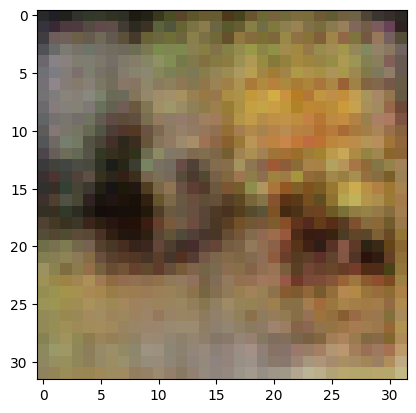

2/2 [==============================] - 0s 6ms/step
>2, 359/390, d1=0.764, d2=0.706 g=1.428


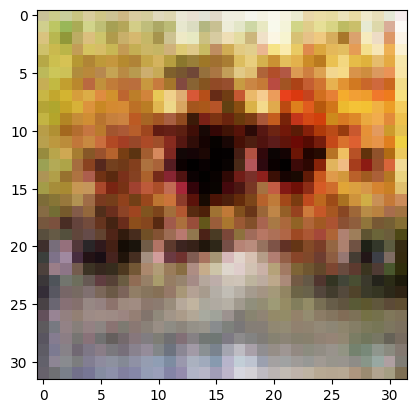

2/2 [==============================] - 0s 8ms/step
>2, 360/390, d1=0.757, d2=0.761 g=1.387


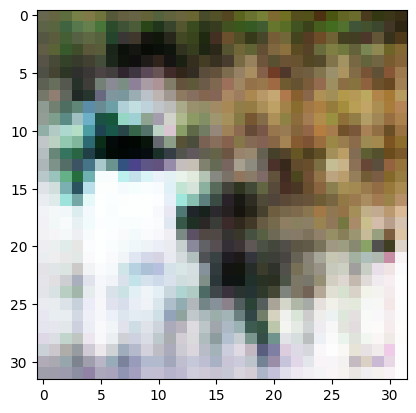

2/2 [==============================] - 0s 6ms/step
>2, 361/390, d1=0.740, d2=0.466 g=1.597


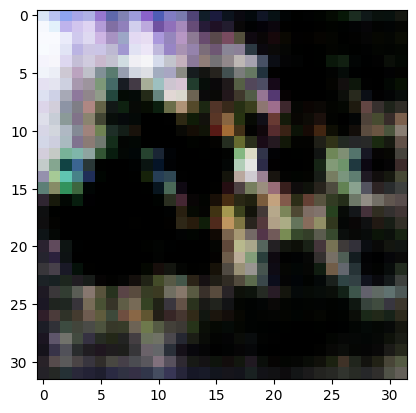

2/2 [==============================] - 0s 7ms/step
>2, 362/390, d1=0.657, d2=0.404 g=1.598


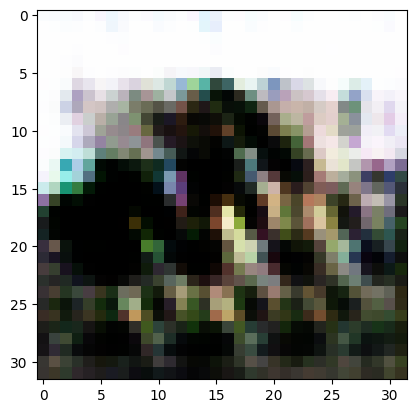

2/2 [==============================] - 0s 9ms/step
>2, 363/390, d1=0.563, d2=0.512 g=1.484


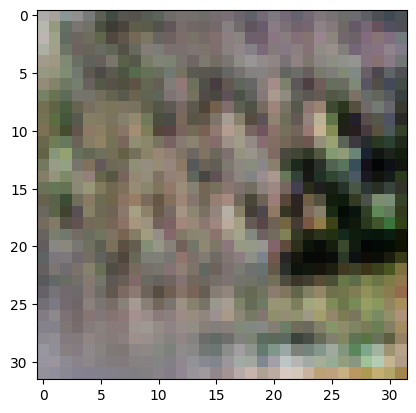

2/2 [==============================] - 0s 7ms/step
>2, 364/390, d1=0.497, d2=0.604 g=1.305


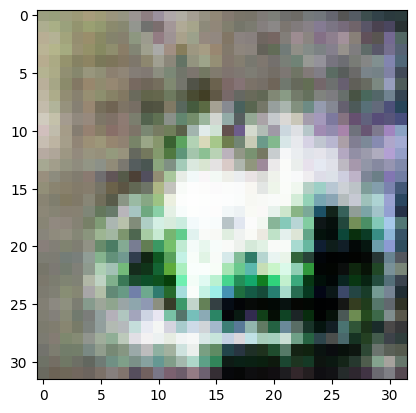

2/2 [==============================] - 0s 8ms/step
>2, 365/390, d1=0.456, d2=0.725 g=1.204


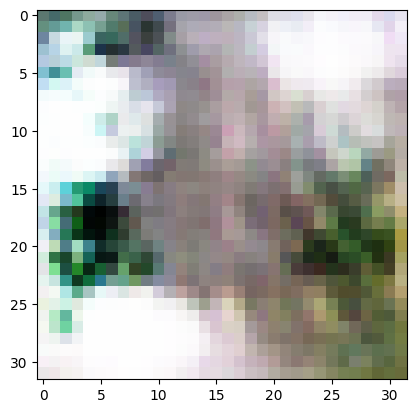

2/2 [==============================] - 0s 7ms/step
>2, 366/390, d1=0.536, d2=0.686 g=1.127


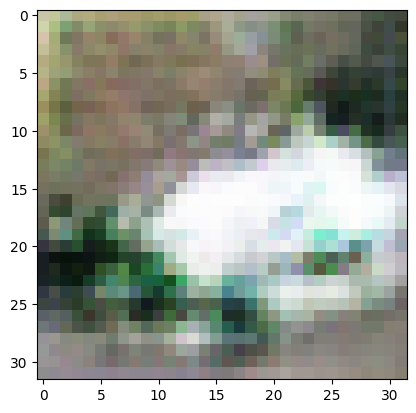

2/2 [==============================] - 0s 6ms/step
>2, 367/390, d1=0.564, d2=0.559 g=1.133


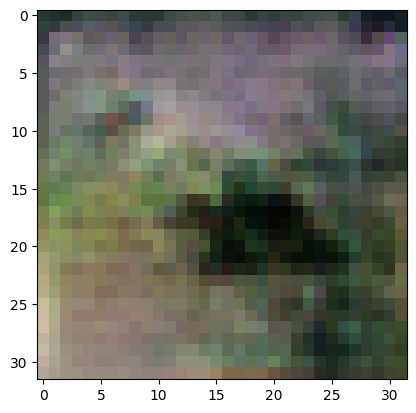

2/2 [==============================] - 0s 8ms/step
>2, 368/390, d1=0.602, d2=0.618 g=1.150


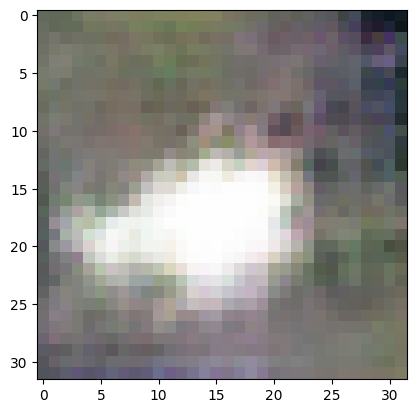

2/2 [==============================] - 0s 7ms/step
>2, 369/390, d1=0.523, d2=0.654 g=1.129


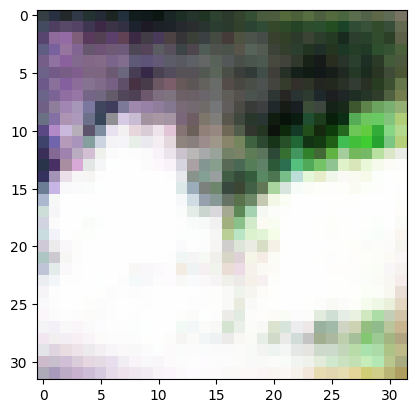

2/2 [==============================] - 0s 8ms/step
>2, 370/390, d1=0.509, d2=0.763 g=1.268


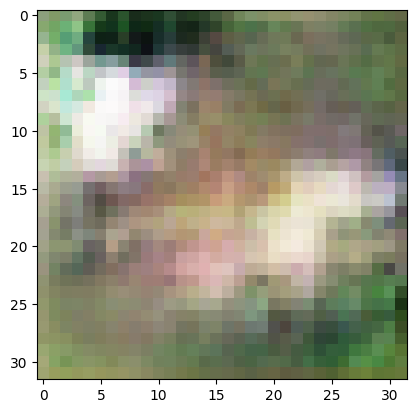

2/2 [==============================] - 0s 8ms/step
>2, 371/390, d1=0.572, d2=0.533 g=1.319


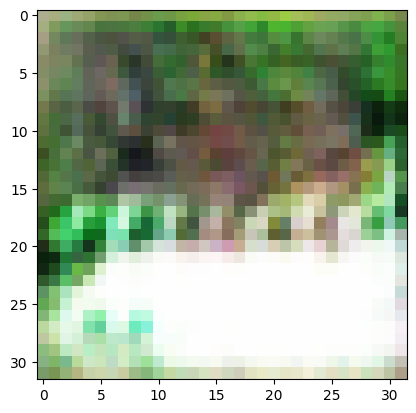

2/2 [==============================] - 0s 10ms/step
>2, 372/390, d1=0.614, d2=0.629 g=1.370


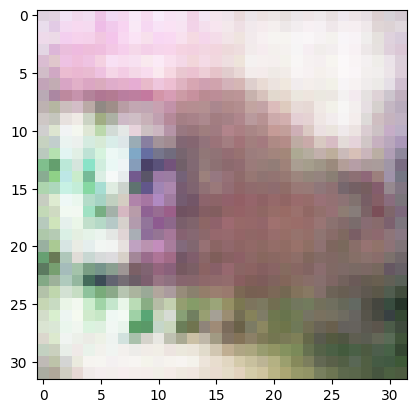

2/2 [==============================] - 0s 8ms/step
>2, 373/390, d1=0.661, d2=0.704 g=1.531


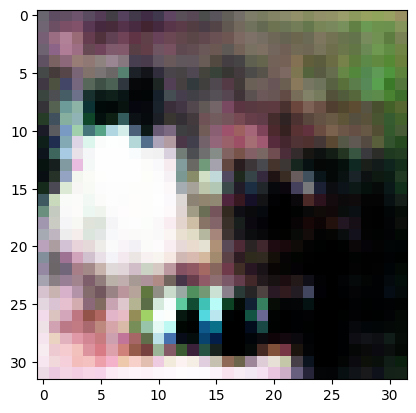

2/2 [==============================] - 0s 8ms/step
>2, 374/390, d1=0.707, d2=0.448 g=1.484


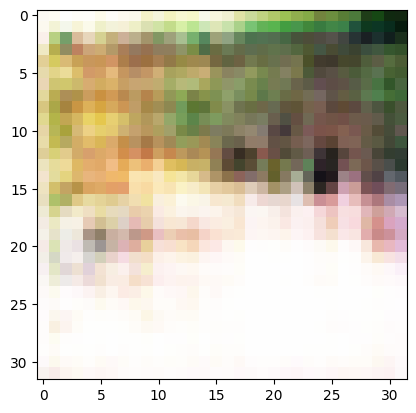

2/2 [==============================] - 0s 7ms/step
>2, 375/390, d1=0.748, d2=0.564 g=1.341


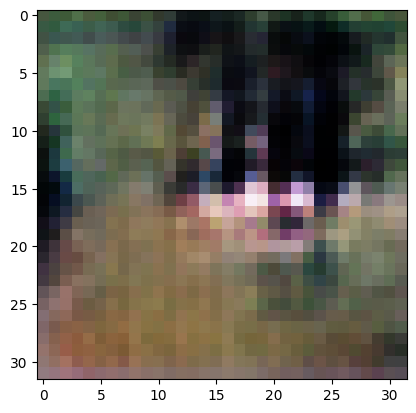

2/2 [==============================] - 0s 9ms/step
>2, 376/390, d1=0.638, d2=0.562 g=1.360


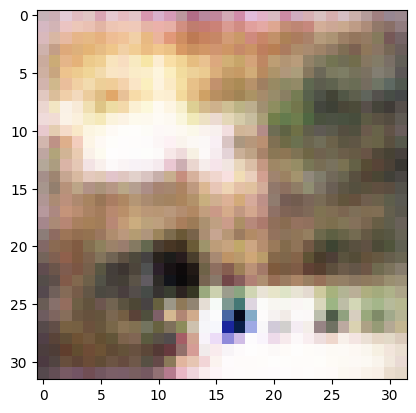

2/2 [==============================] - 0s 7ms/step
>2, 377/390, d1=0.617, d2=0.618 g=1.324


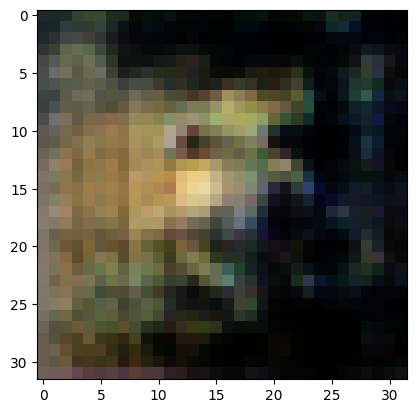

2/2 [==============================] - 0s 8ms/step
>2, 378/390, d1=0.648, d2=0.696 g=1.509


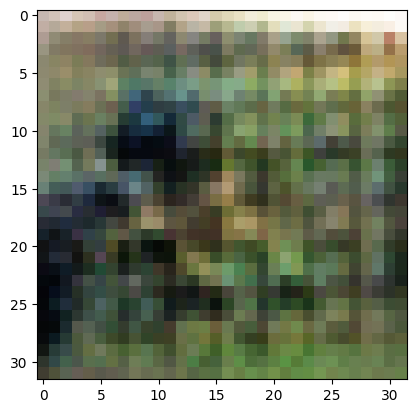

2/2 [==============================] - 0s 9ms/step
>2, 379/390, d1=0.677, d2=0.657 g=1.549


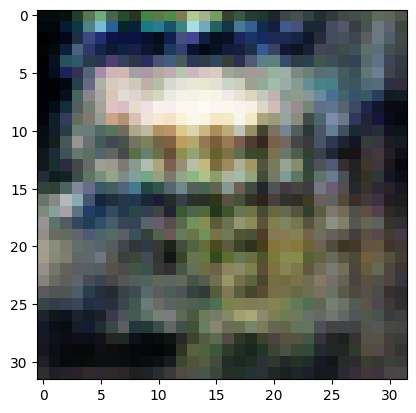

2/2 [==============================] - 0s 7ms/step
>2, 380/390, d1=0.794, d2=0.531 g=1.486


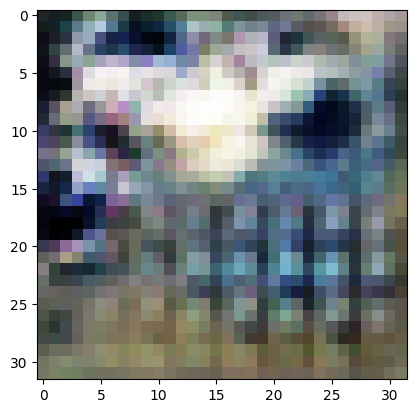

2/2 [==============================] - 0s 7ms/step
>2, 381/390, d1=0.653, d2=0.592 g=1.536


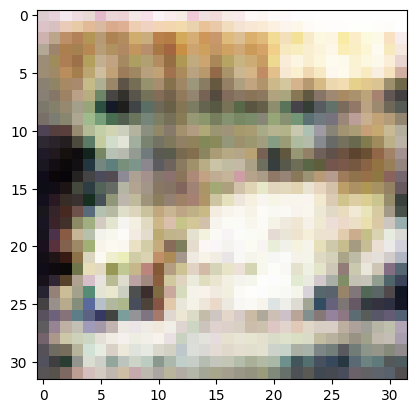

2/2 [==============================] - 0s 7ms/step
>2, 382/390, d1=0.500, d2=0.745 g=1.595


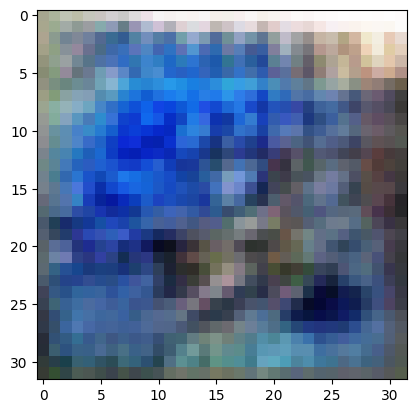

2/2 [==============================] - 0s 8ms/step
>2, 383/390, d1=0.646, d2=0.708 g=1.357


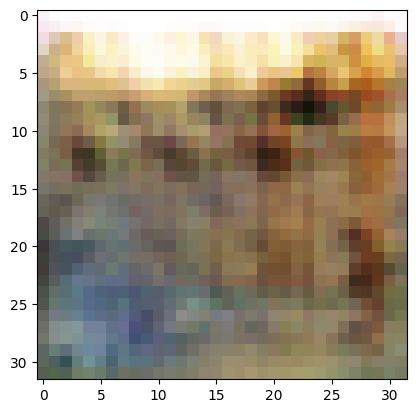

2/2 [==============================] - 0s 7ms/step
>2, 384/390, d1=0.674, d2=0.582 g=1.313


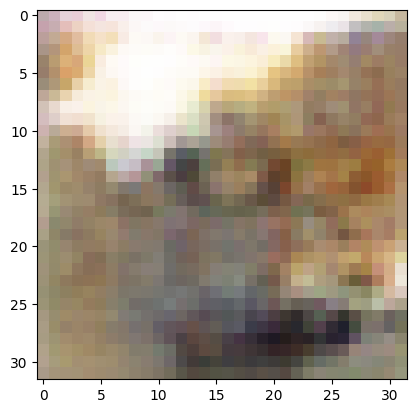

2/2 [==============================] - 0s 7ms/step
>2, 385/390, d1=0.724, d2=0.625 g=1.536


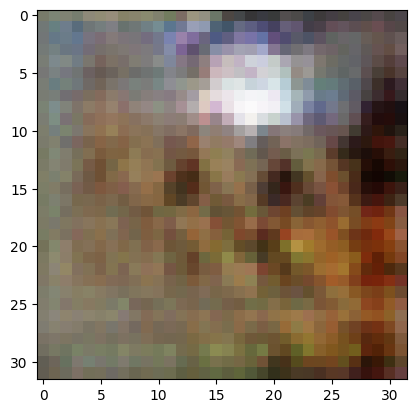

2/2 [==============================] - 0s 7ms/step
>2, 386/390, d1=0.604, d2=0.407 g=1.719


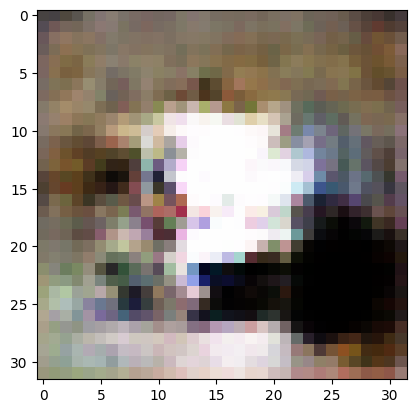

2/2 [==============================] - 0s 9ms/step
>2, 387/390, d1=0.817, d2=0.684 g=1.322


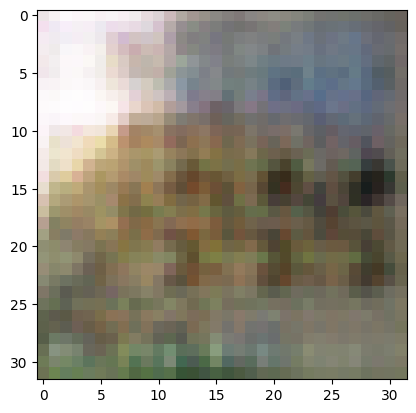

2/2 [==============================] - 0s 7ms/step
>2, 388/390, d1=0.651, d2=0.622 g=1.176


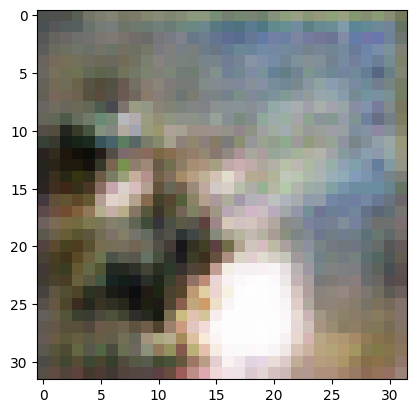

2/2 [==============================] - 0s 8ms/step
>2, 389/390, d1=0.675, d2=0.625 g=1.267


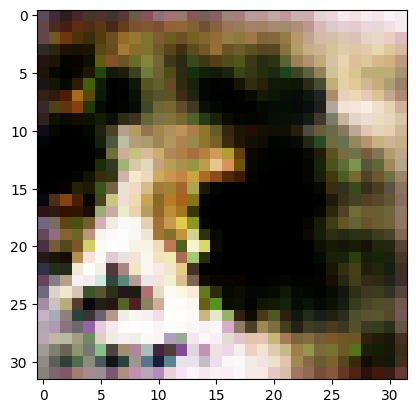

2/2 [==============================] - 0s 7ms/step
>2, 390/390, d1=0.562, d2=0.654 g=1.322


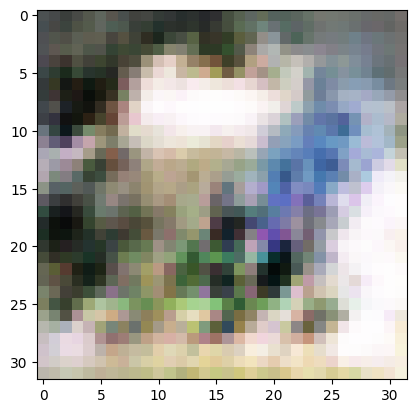

2/2 [==============================] - 0s 8ms/step
>3, 1/390, d1=0.721, d2=0.590 g=1.237


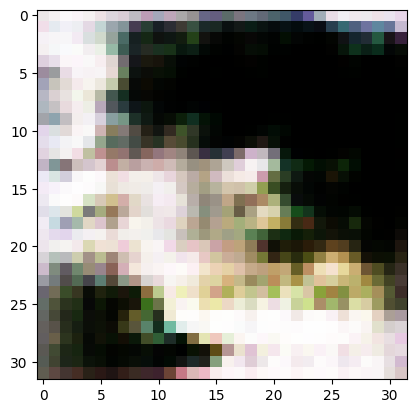

2/2 [==============================] - 0s 7ms/step
>3, 2/390, d1=0.664, d2=0.566 g=1.275


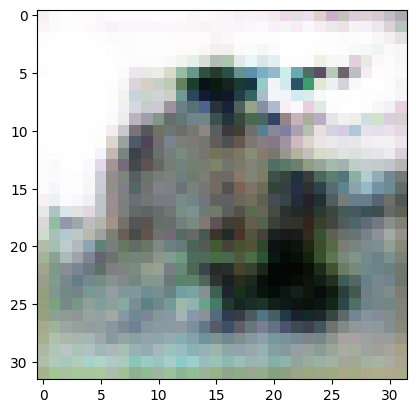

2/2 [==============================] - 0s 7ms/step
>3, 3/390, d1=0.680, d2=0.570 g=1.420


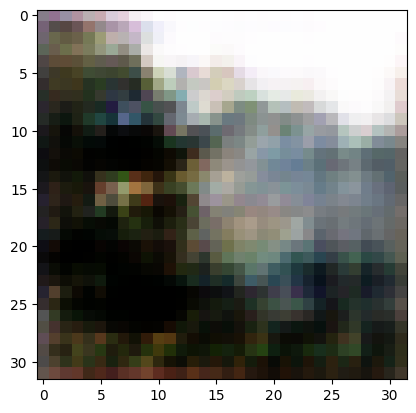

2/2 [==============================] - 0s 7ms/step
>3, 4/390, d1=0.602, d2=0.567 g=1.417


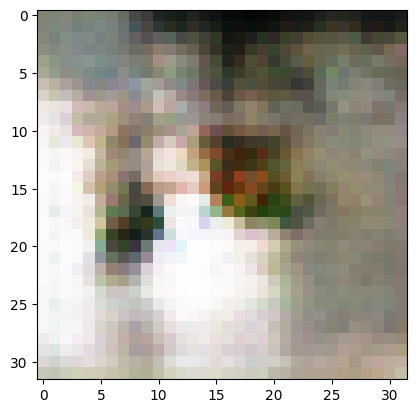

2/2 [==============================] - 0s 7ms/step
>3, 5/390, d1=0.709, d2=0.718 g=1.263


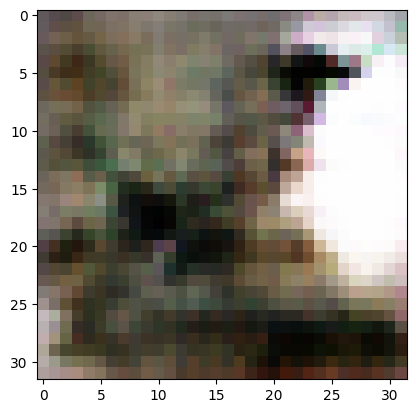

2/2 [==============================] - 0s 8ms/step
>3, 6/390, d1=0.685, d2=0.724 g=1.094


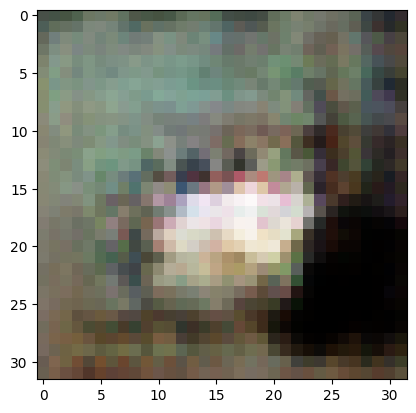

2/2 [==============================] - 0s 7ms/step
>3, 7/390, d1=0.726, d2=0.647 g=1.187


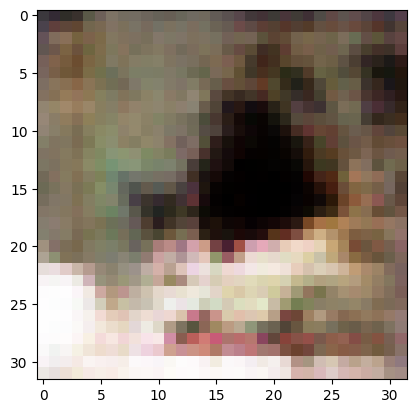

2/2 [==============================] - 0s 6ms/step
>3, 8/390, d1=0.573, d2=0.570 g=1.264


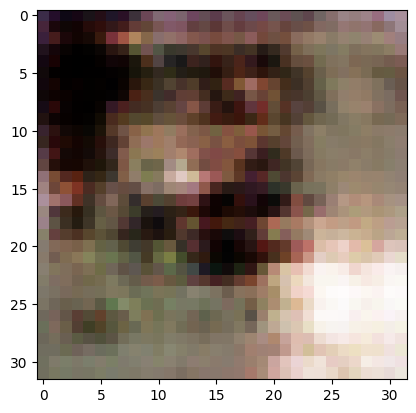

2/2 [==============================] - 0s 8ms/step
>3, 9/390, d1=0.645, d2=0.633 g=1.456


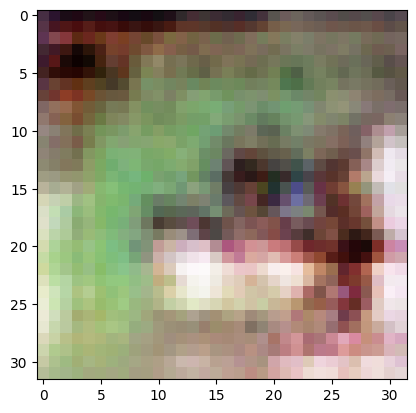

2/2 [==============================] - 0s 9ms/step
>3, 10/390, d1=0.665, d2=0.496 g=1.611


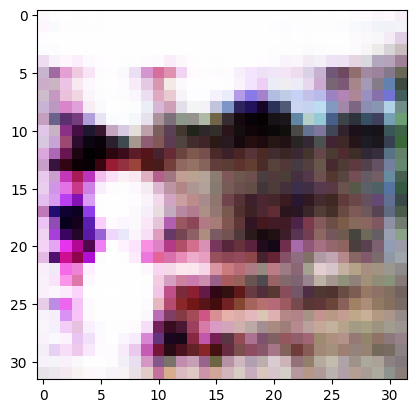

2/2 [==============================] - 0s 8ms/step
>3, 11/390, d1=0.709, d2=0.596 g=1.604


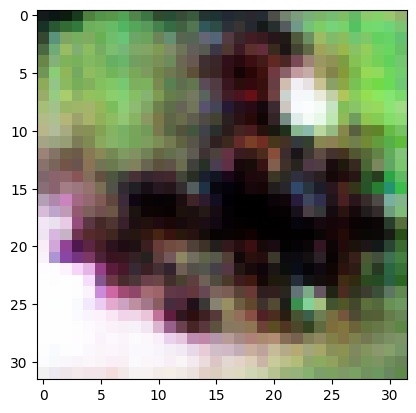

2/2 [==============================] - 0s 7ms/step
>3, 12/390, d1=0.738, d2=0.592 g=1.579


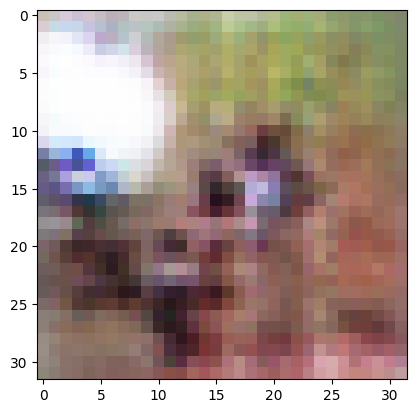

2/2 [==============================] - 0s 6ms/step
>3, 13/390, d1=0.790, d2=0.448 g=1.745


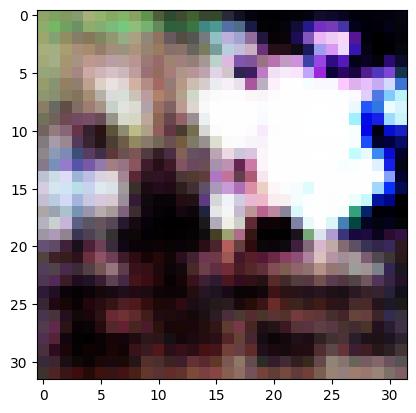

2/2 [==============================] - 0s 7ms/step
>3, 14/390, d1=0.721, d2=0.456 g=1.795


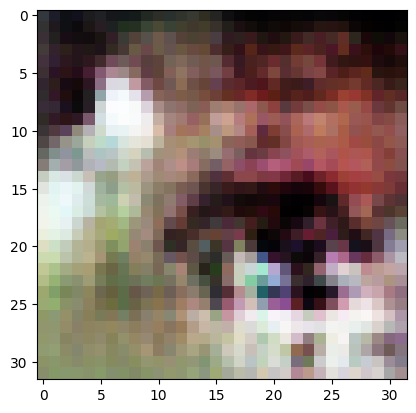

2/2 [==============================] - 0s 7ms/step
>3, 15/390, d1=0.628, d2=0.605 g=1.536


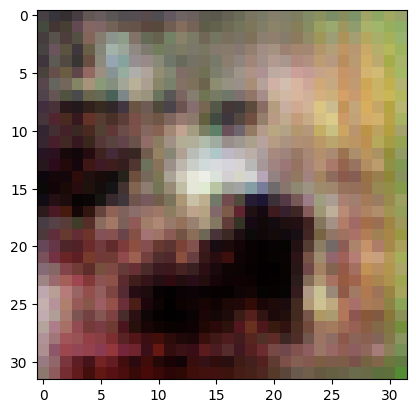

2/2 [==============================] - 0s 8ms/step
>3, 16/390, d1=0.730, d2=0.533 g=1.560


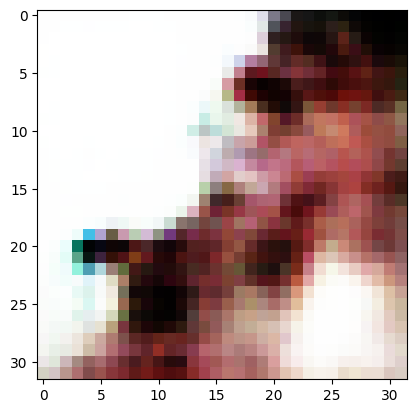

2/2 [==============================] - 0s 10ms/step
>3, 17/390, d1=0.826, d2=0.448 g=1.358


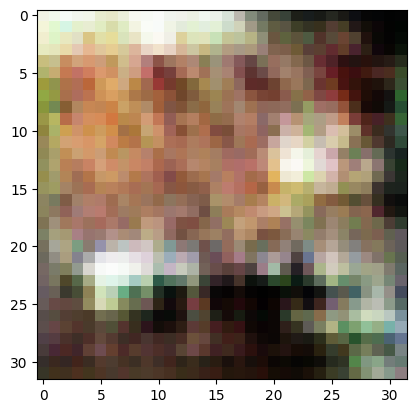

2/2 [==============================] - 0s 10ms/step
>3, 18/390, d1=0.524, d2=0.447 g=1.304


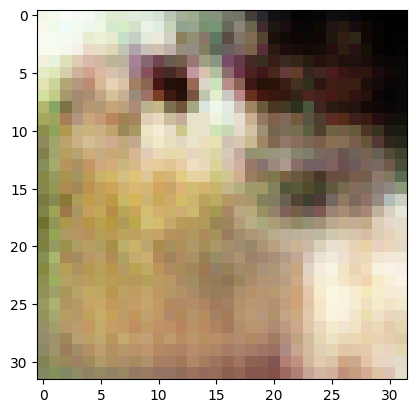

2/2 [==============================] - 0s 6ms/step
>3, 19/390, d1=0.479, d2=0.484 g=1.429


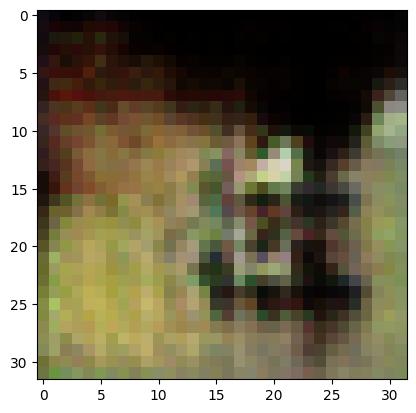

2/2 [==============================] - 0s 7ms/step
>3, 20/390, d1=0.539, d2=0.484 g=1.373


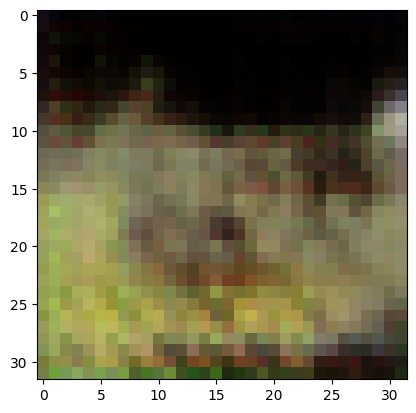

2/2 [==============================] - 0s 7ms/step
>3, 21/390, d1=0.678, d2=0.519 g=1.363


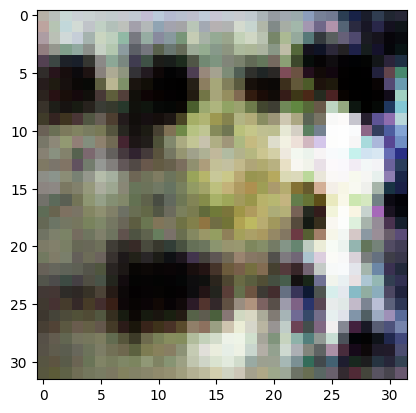

2/2 [==============================] - 0s 10ms/step
>3, 22/390, d1=0.614, d2=0.465 g=1.468


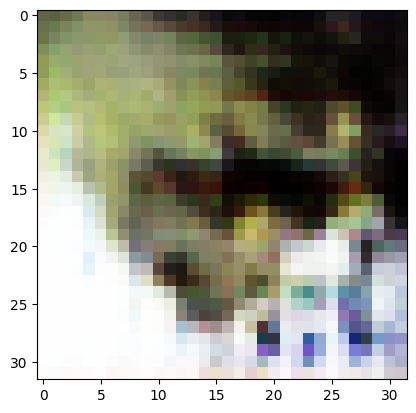

2/2 [==============================] - 0s 7ms/step
>3, 23/390, d1=0.527, d2=0.459 g=1.365


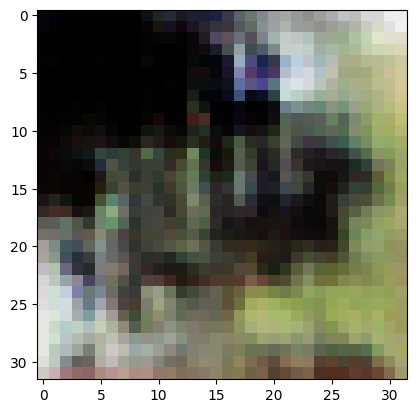

2/2 [==============================] - 0s 8ms/step
>3, 24/390, d1=0.381, d2=0.558 g=1.298


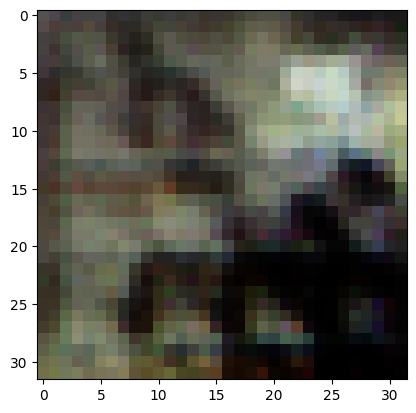

2/2 [==============================] - 0s 7ms/step
>3, 25/390, d1=0.547, d2=0.713 g=1.246


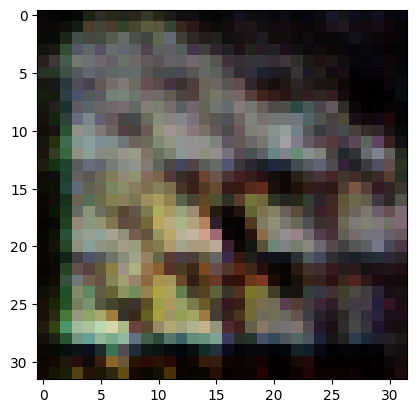

2/2 [==============================] - 0s 7ms/step
>3, 26/390, d1=0.640, d2=0.695 g=1.216


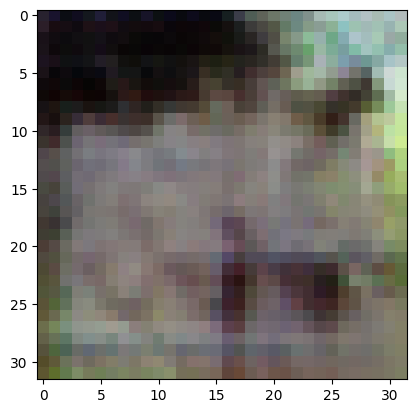

2/2 [==============================] - 0s 7ms/step
>3, 27/390, d1=0.621, d2=0.613 g=1.390


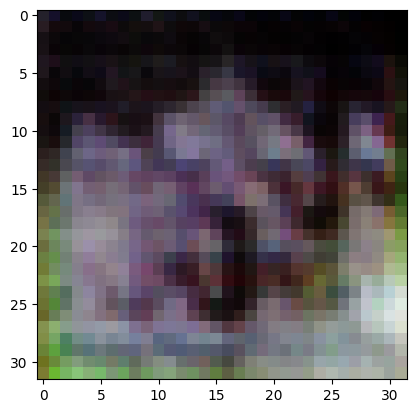

2/2 [==============================] - 0s 9ms/step
>3, 28/390, d1=0.730, d2=0.505 g=1.551


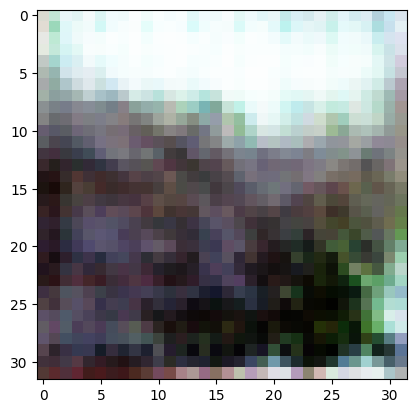

2/2 [==============================] - 0s 8ms/step
>3, 29/390, d1=0.442, d2=0.452 g=2.133


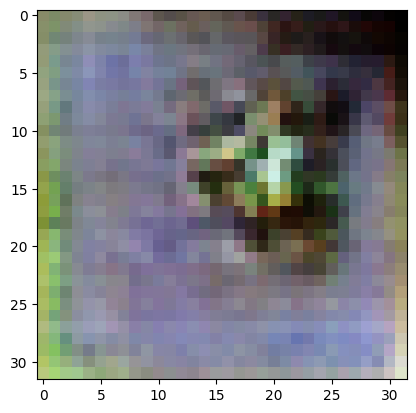

2/2 [==============================] - 0s 8ms/step
>3, 30/390, d1=0.510, d2=0.726 g=1.621


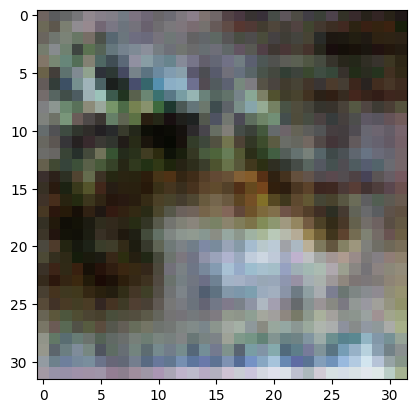

2/2 [==============================] - 0s 8ms/step
>3, 31/390, d1=0.629, d2=1.271 g=1.594


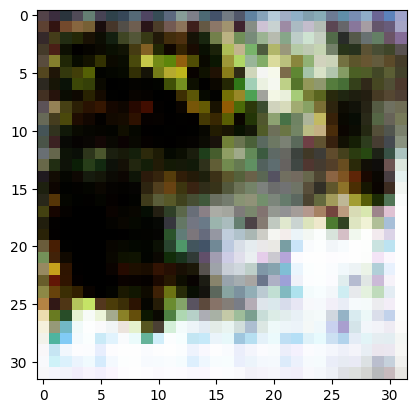

2/2 [==============================] - 0s 13ms/step
>3, 32/390, d1=0.960, d2=0.553 g=1.458


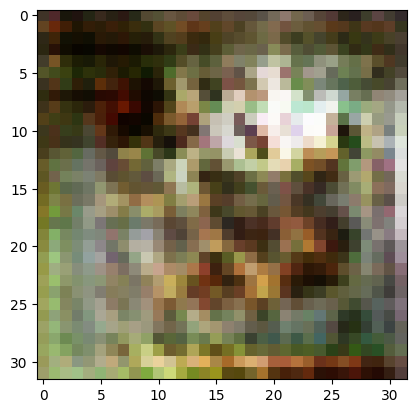

2/2 [==============================] - 0s 9ms/step
>3, 33/390, d1=0.765, d2=0.525 g=1.544


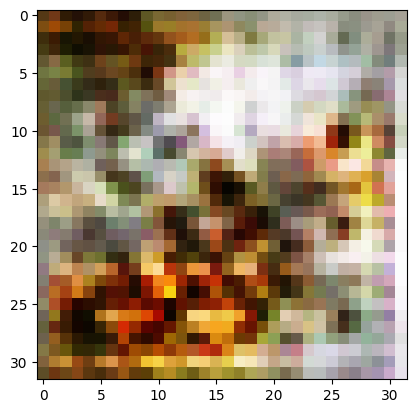

2/2 [==============================] - 0s 7ms/step
>3, 34/390, d1=0.708, d2=0.417 g=1.782


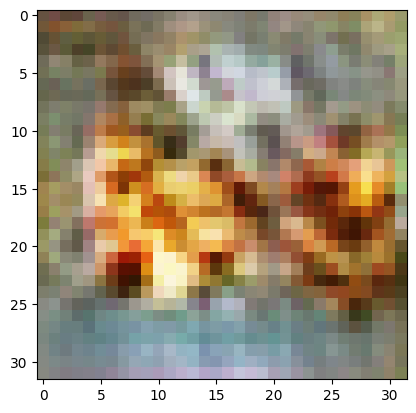

2/2 [==============================] - 0s 11ms/step
>3, 35/390, d1=0.533, d2=0.334 g=1.981


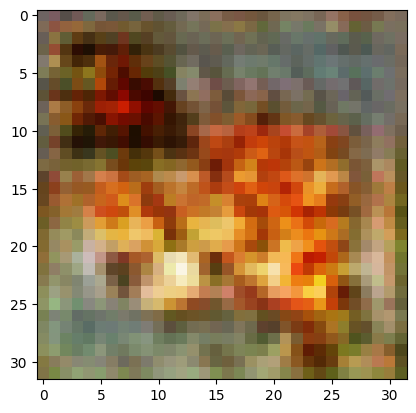

2/2 [==============================] - 0s 8ms/step
>3, 36/390, d1=0.476, d2=0.586 g=1.807


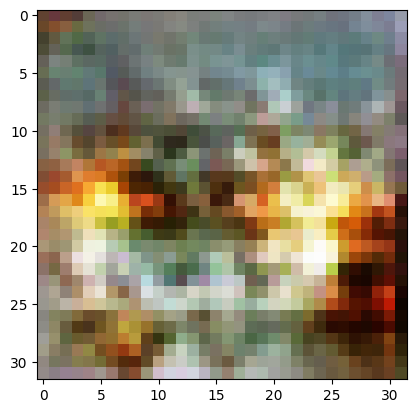

2/2 [==============================] - 0s 10ms/step
>3, 37/390, d1=0.708, d2=0.925 g=1.326


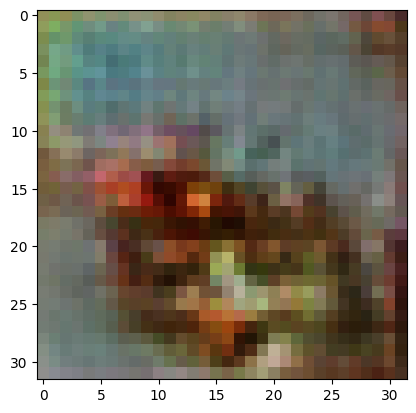

2/2 [==============================] - 0s 8ms/step
>3, 38/390, d1=0.743, d2=0.527 g=1.283


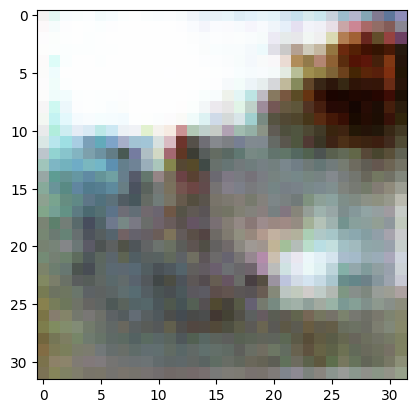

2/2 [==============================] - 0s 6ms/step
>3, 39/390, d1=0.571, d2=0.544 g=1.349


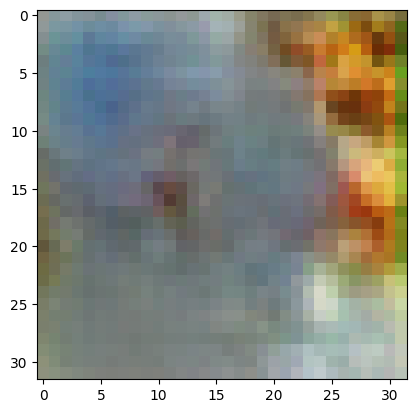

2/2 [==============================] - 0s 9ms/step
>3, 40/390, d1=0.653, d2=0.510 g=1.343


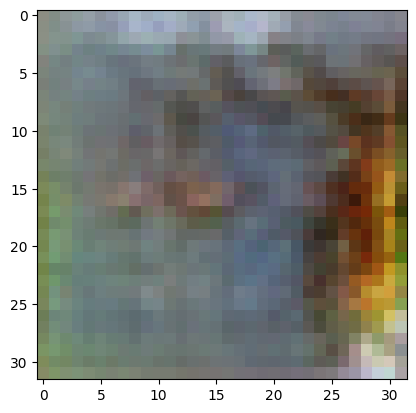

2/2 [==============================] - 0s 7ms/step
>3, 41/390, d1=0.582, d2=0.650 g=1.439


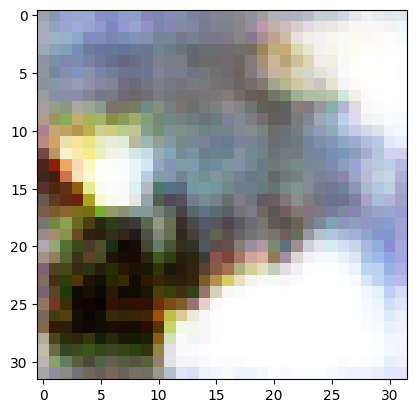

2/2 [==============================] - 0s 8ms/step
>3, 42/390, d1=0.596, d2=0.588 g=1.210


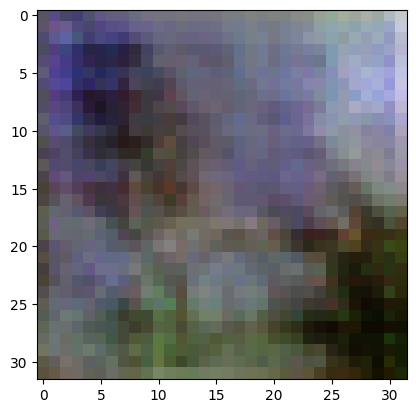

2/2 [==============================] - 0s 8ms/step
>3, 43/390, d1=0.452, d2=0.674 g=1.207


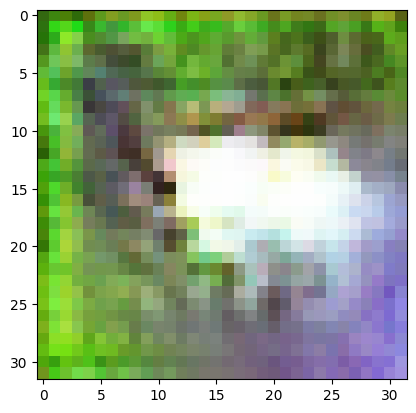

2/2 [==============================] - 0s 6ms/step
>3, 44/390, d1=0.537, d2=0.628 g=1.305


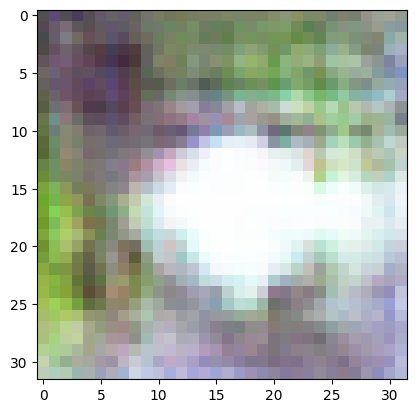

2/2 [==============================] - 0s 6ms/step
>3, 45/390, d1=0.644, d2=0.584 g=1.324


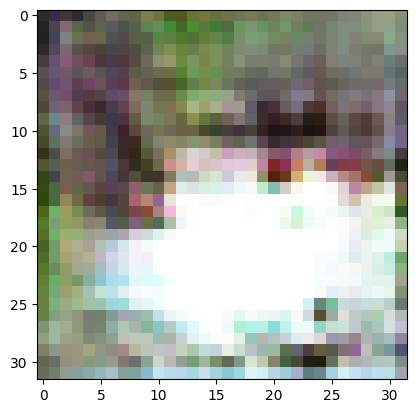

2/2 [==============================] - 0s 6ms/step
>3, 46/390, d1=0.666, d2=0.449 g=1.485


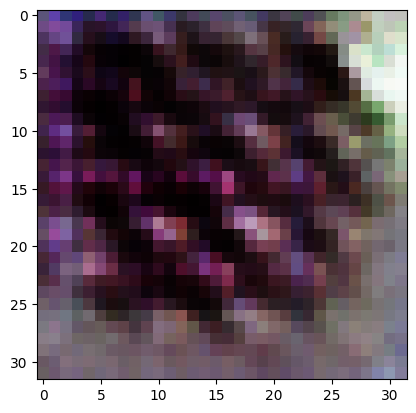

2/2 [==============================] - 0s 8ms/step
>3, 47/390, d1=0.530, d2=0.449 g=1.552


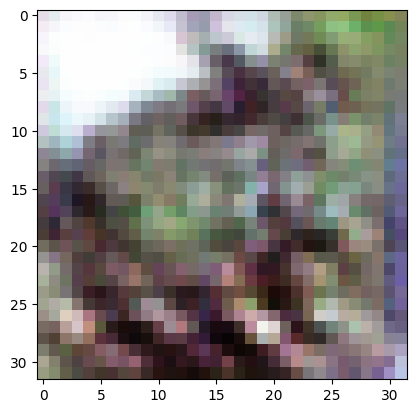

2/2 [==============================] - 0s 7ms/step
>3, 48/390, d1=0.457, d2=0.548 g=1.392


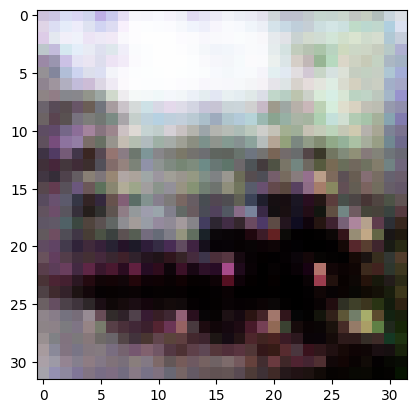

2/2 [==============================] - 0s 7ms/step
>3, 49/390, d1=0.391, d2=0.607 g=1.474


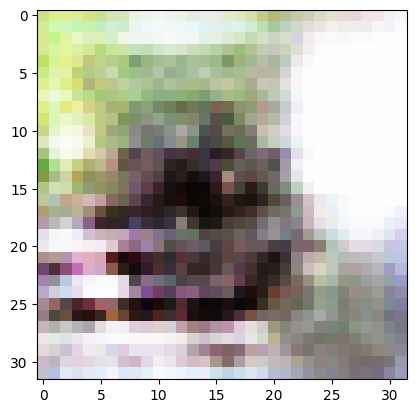

2/2 [==============================] - 0s 8ms/step
>3, 50/390, d1=0.547, d2=0.526 g=1.548


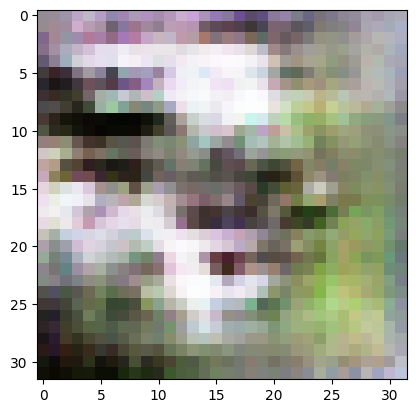

2/2 [==============================] - 0s 8ms/step
>3, 51/390, d1=0.515, d2=0.596 g=1.638


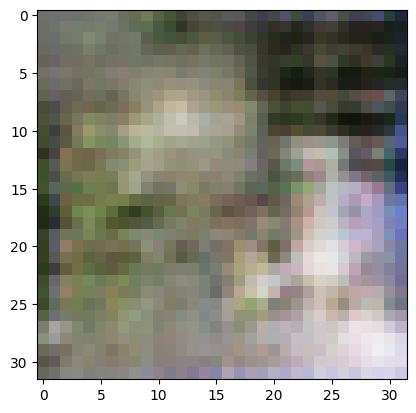

2/2 [==============================] - 0s 7ms/step
>3, 52/390, d1=0.600, d2=0.418 g=1.530


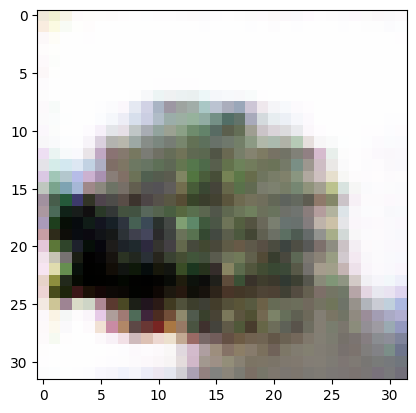

2/2 [==============================] - 0s 7ms/step
>3, 53/390, d1=0.515, d2=0.822 g=1.388


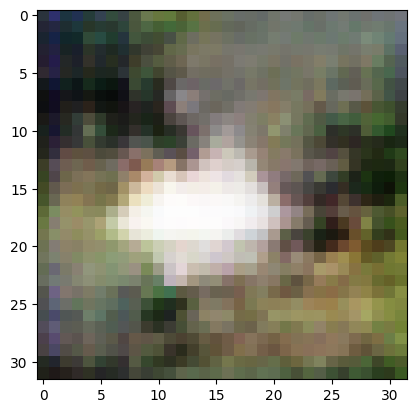

2/2 [==============================] - 0s 7ms/step
>3, 54/390, d1=0.656, d2=0.618 g=1.349


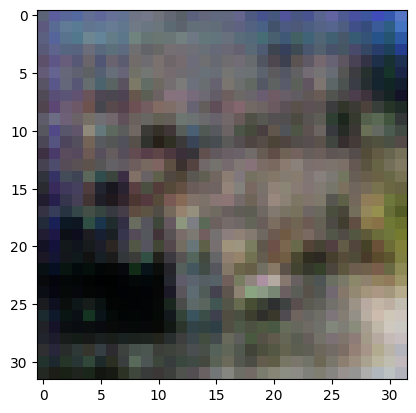

2/2 [==============================] - 0s 7ms/step
>3, 55/390, d1=0.717, d2=0.663 g=1.230


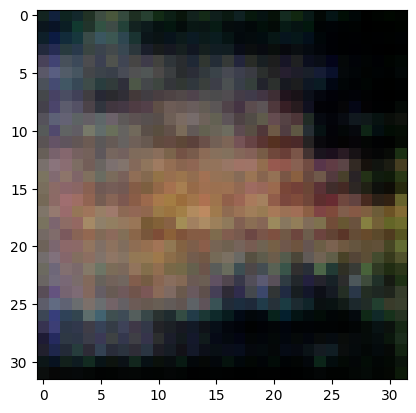

2/2 [==============================] - 0s 7ms/step
>3, 56/390, d1=0.713, d2=0.941 g=1.369


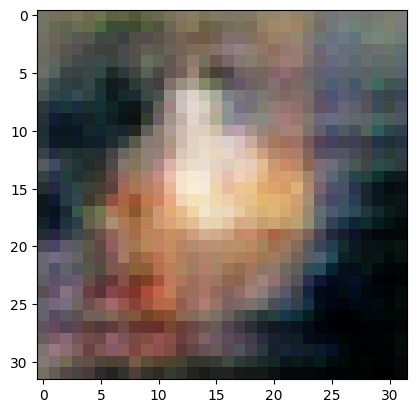

2/2 [==============================] - 0s 10ms/step
>3, 57/390, d1=0.844, d2=0.878 g=1.542


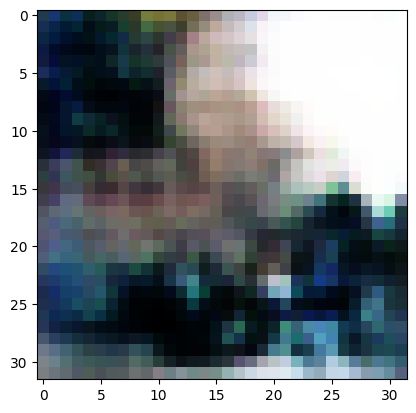

2/2 [==============================] - 0s 7ms/step
>3, 58/390, d1=0.757, d2=0.518 g=1.596


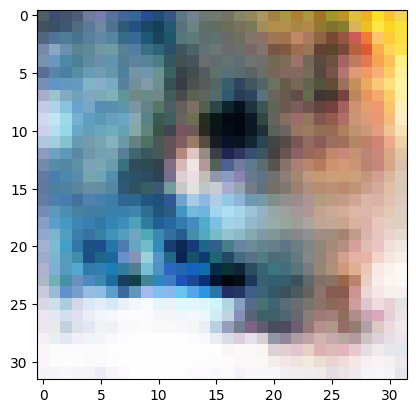

2/2 [==============================] - 0s 9ms/step
>3, 59/390, d1=0.807, d2=0.595 g=1.497


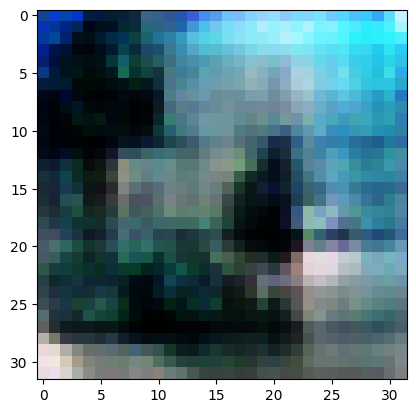

2/2 [==============================] - 0s 9ms/step
>3, 60/390, d1=0.782, d2=0.772 g=1.558


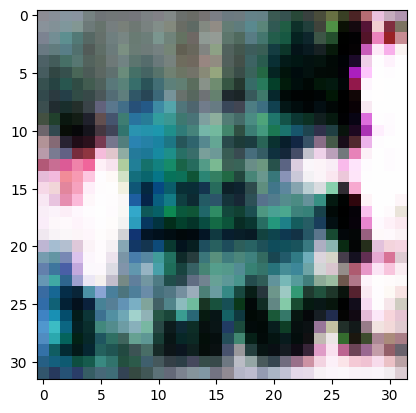

2/2 [==============================] - 0s 9ms/step
>3, 61/390, d1=0.784, d2=0.586 g=1.541


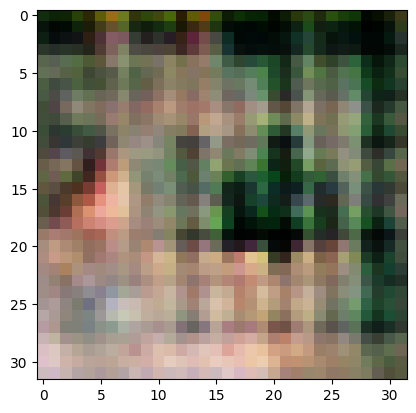

2/2 [==============================] - 0s 8ms/step
>3, 62/390, d1=0.693, d2=0.511 g=1.431


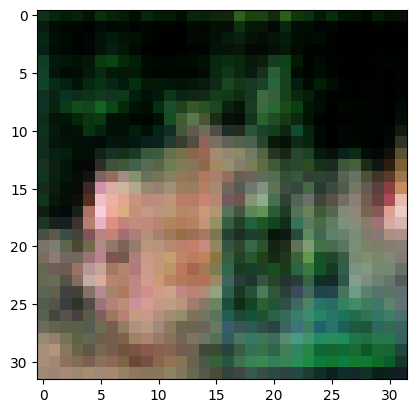

2/2 [==============================] - 0s 7ms/step
>3, 63/390, d1=0.614, d2=0.515 g=1.457


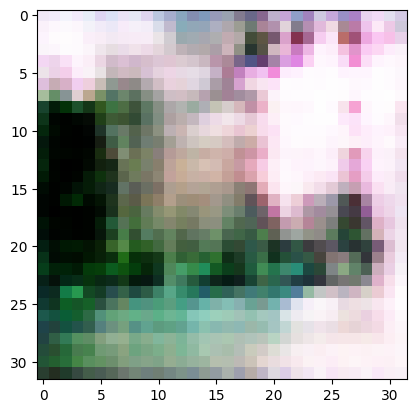

2/2 [==============================] - 0s 8ms/step
>3, 64/390, d1=0.616, d2=0.580 g=1.542


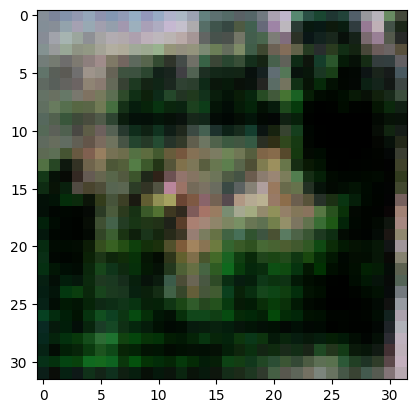

2/2 [==============================] - 0s 8ms/step
>3, 65/390, d1=0.684, d2=0.512 g=1.559


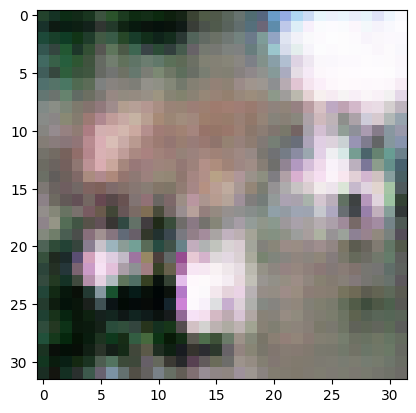

2/2 [==============================] - 0s 8ms/step
>3, 66/390, d1=0.642, d2=0.567 g=1.437


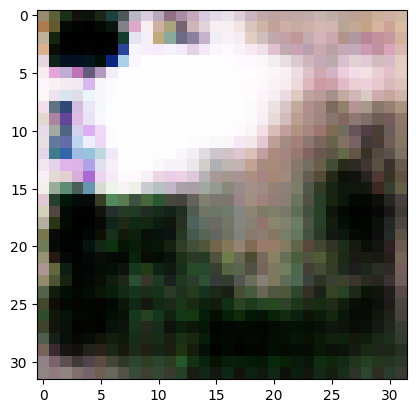

2/2 [==============================] - 0s 7ms/step
>3, 67/390, d1=0.674, d2=0.549 g=1.261


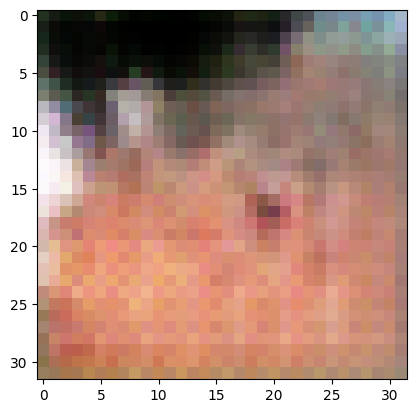

2/2 [==============================] - 0s 8ms/step
>3, 68/390, d1=0.732, d2=0.626 g=1.081


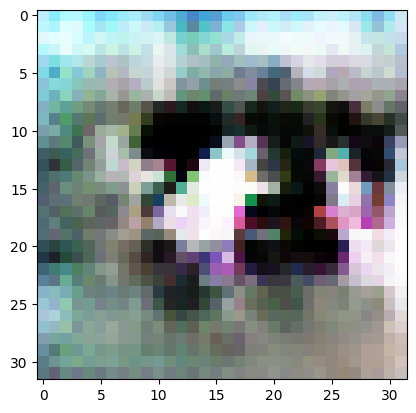

2/2 [==============================] - 0s 6ms/step
>3, 69/390, d1=0.617, d2=0.696 g=1.044


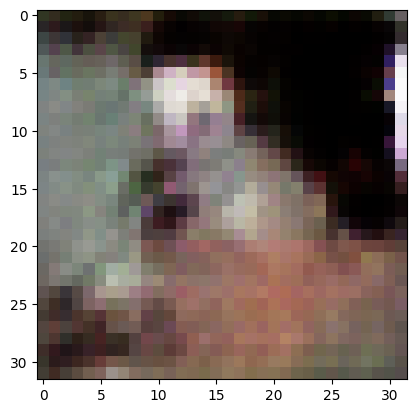

2/2 [==============================] - 0s 8ms/step
>3, 70/390, d1=0.549, d2=0.719 g=1.095


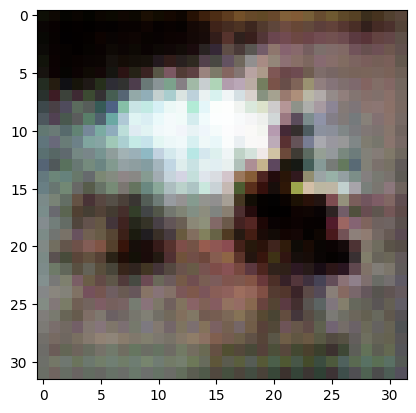

2/2 [==============================] - 0s 8ms/step
>3, 71/390, d1=0.640, d2=0.665 g=1.100


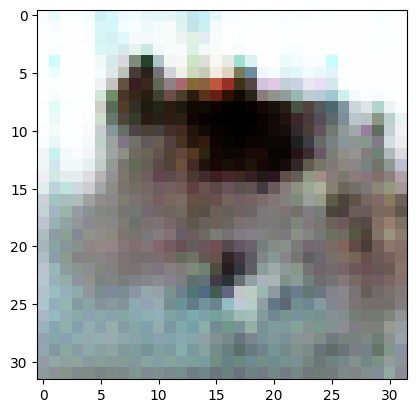

2/2 [==============================] - 0s 12ms/step
>3, 72/390, d1=0.609, d2=0.741 g=1.055


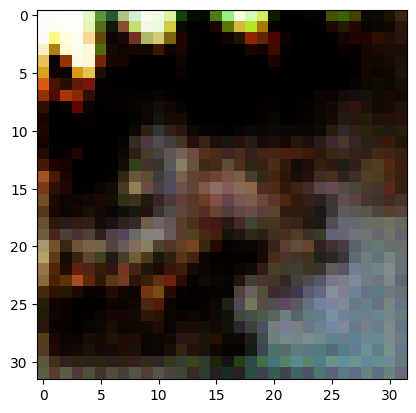

2/2 [==============================] - 0s 7ms/step
>3, 73/390, d1=0.609, d2=0.663 g=1.327


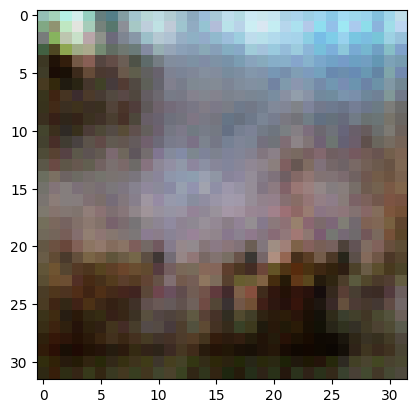

2/2 [==============================] - 0s 7ms/step
>3, 74/390, d1=0.669, d2=0.631 g=1.450


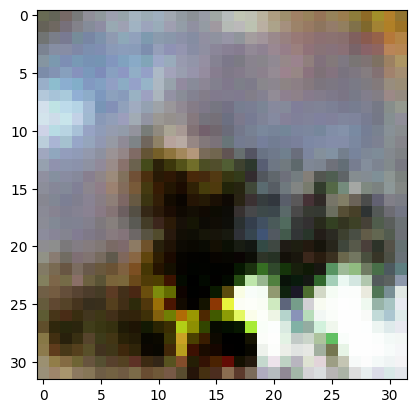

2/2 [==============================] - 0s 9ms/step
>3, 75/390, d1=0.697, d2=0.557 g=1.349


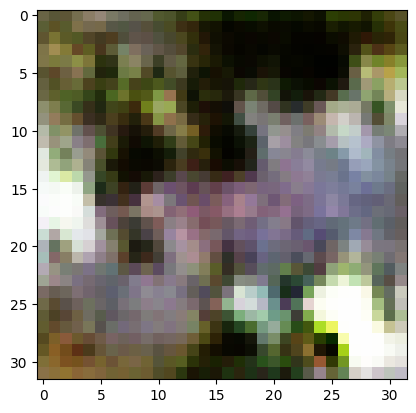

2/2 [==============================] - 0s 8ms/step
>3, 76/390, d1=0.643, d2=0.537 g=1.551


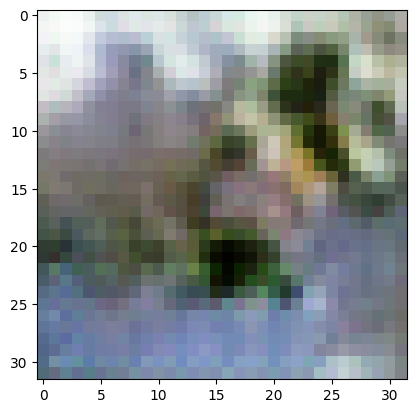

2/2 [==============================] - 0s 6ms/step
>3, 77/390, d1=0.639, d2=0.476 g=1.628


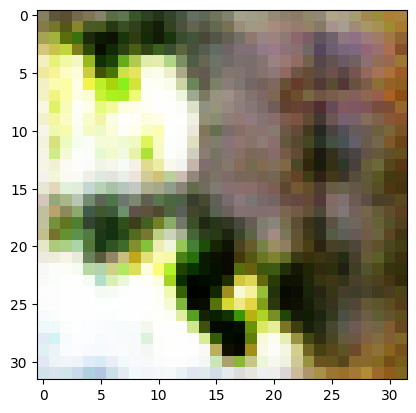

2/2 [==============================] - 0s 7ms/step
>3, 78/390, d1=0.720, d2=0.474 g=1.484


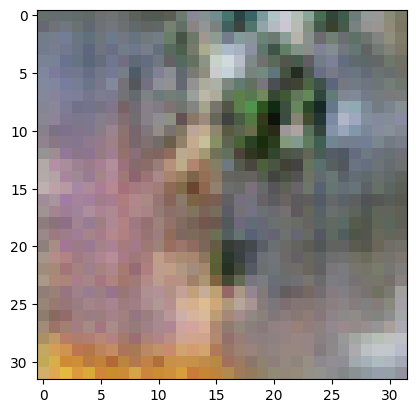

2/2 [==============================] - 0s 8ms/step
>3, 79/390, d1=0.597, d2=0.727 g=1.679


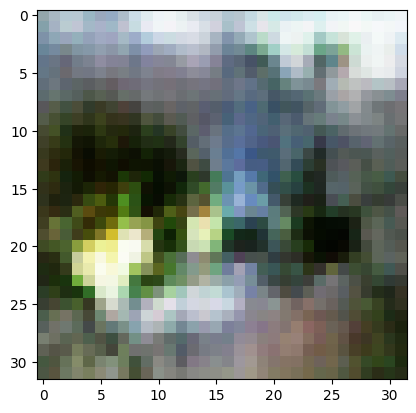

2/2 [==============================] - 0s 7ms/step
>3, 80/390, d1=0.799, d2=0.563 g=1.536


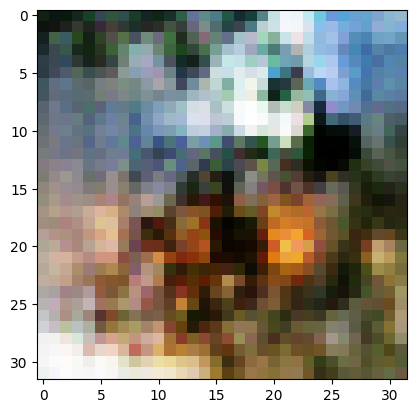

2/2 [==============================] - 0s 9ms/step
>3, 81/390, d1=0.743, d2=0.581 g=1.248


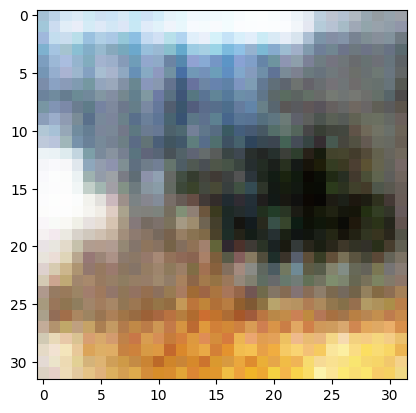

2/2 [==============================] - 0s 6ms/step
>3, 82/390, d1=0.736, d2=0.646 g=1.196


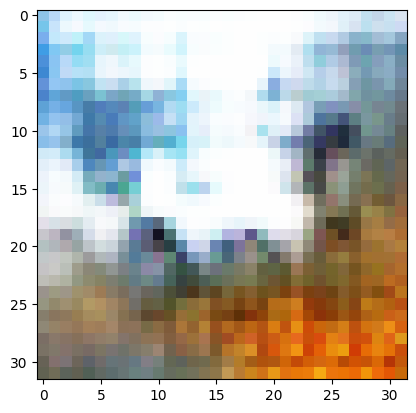

2/2 [==============================] - 0s 7ms/step
>3, 83/390, d1=0.591, d2=0.591 g=1.369


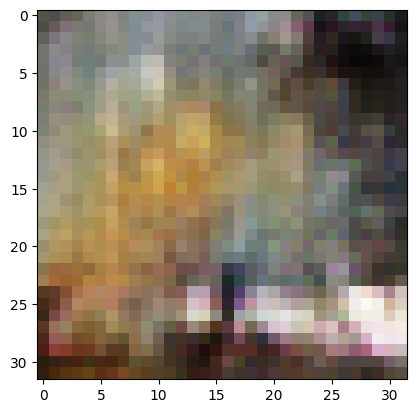

2/2 [==============================] - 0s 8ms/step
>3, 84/390, d1=0.696, d2=0.500 g=1.317


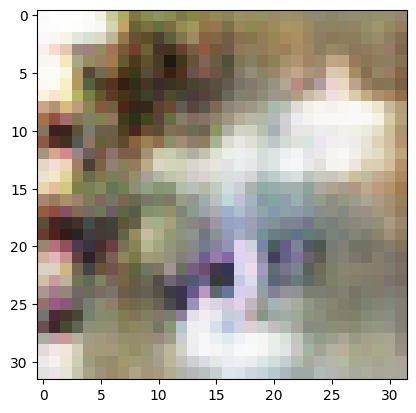

2/2 [==============================] - 0s 8ms/step
>3, 85/390, d1=0.639, d2=0.589 g=1.313


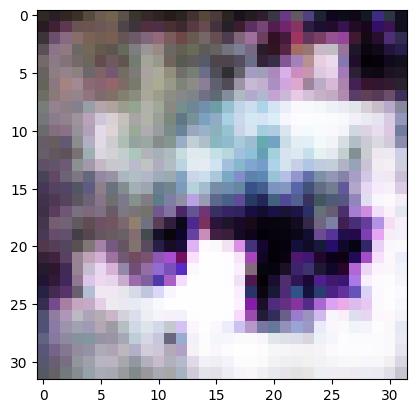

2/2 [==============================] - 0s 7ms/step
>3, 86/390, d1=0.618, d2=0.581 g=1.248


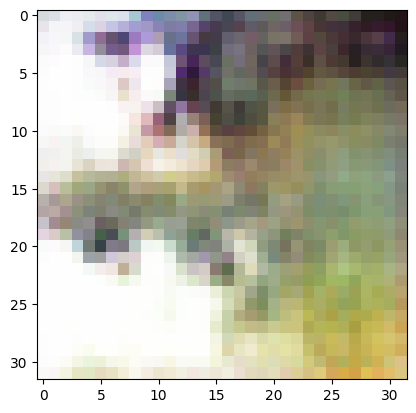

2/2 [==============================] - 0s 8ms/step
>3, 87/390, d1=0.543, d2=0.530 g=1.184


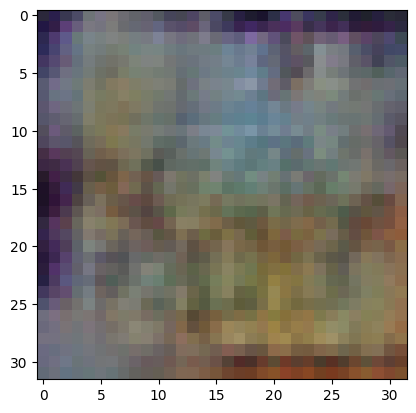

2/2 [==============================] - 0s 7ms/step
>3, 88/390, d1=0.467, d2=0.681 g=1.369


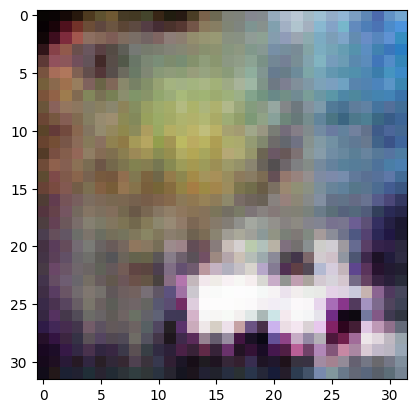

2/2 [==============================] - 0s 8ms/step
>3, 89/390, d1=0.679, d2=0.470 g=1.383


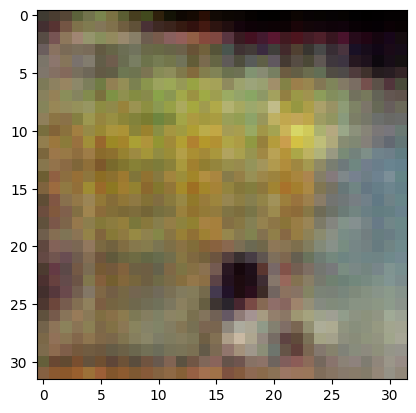

2/2 [==============================] - 0s 7ms/step
>3, 90/390, d1=0.641, d2=0.565 g=1.196


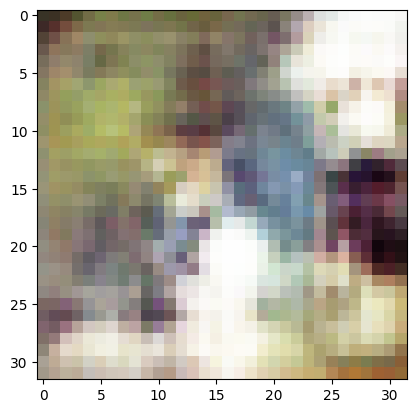

2/2 [==============================] - 0s 8ms/step
>3, 91/390, d1=0.519, d2=0.730 g=1.278


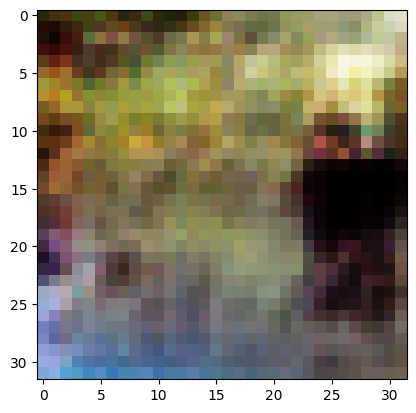

2/2 [==============================] - 0s 8ms/step
>3, 92/390, d1=0.666, d2=0.562 g=1.116


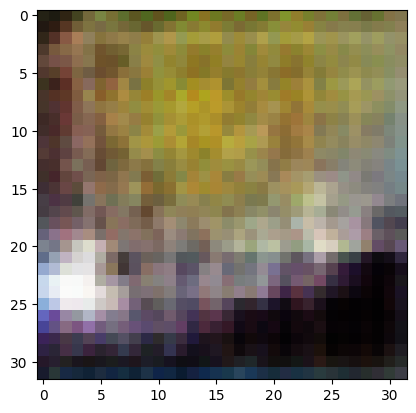

2/2 [==============================] - 0s 8ms/step
>3, 93/390, d1=0.576, d2=0.661 g=1.141


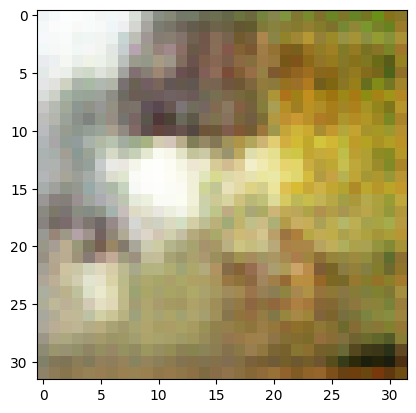

2/2 [==============================] - 0s 8ms/step
>3, 94/390, d1=0.560, d2=0.636 g=1.216


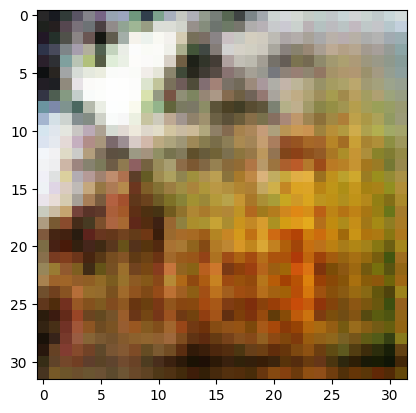

2/2 [==============================] - 0s 7ms/step
>3, 95/390, d1=0.599, d2=0.548 g=1.255


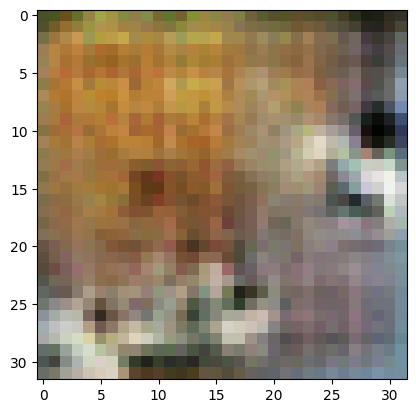

2/2 [==============================] - 0s 7ms/step
>3, 96/390, d1=0.596, d2=0.567 g=1.333


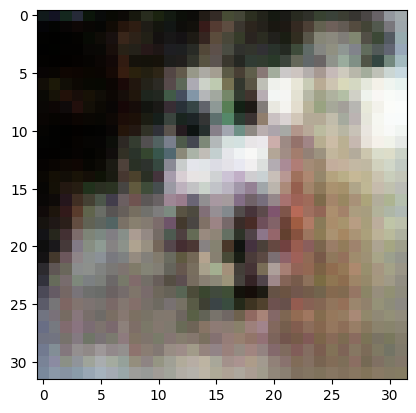

2/2 [==============================] - 0s 8ms/step
>3, 97/390, d1=0.704, d2=0.508 g=1.355


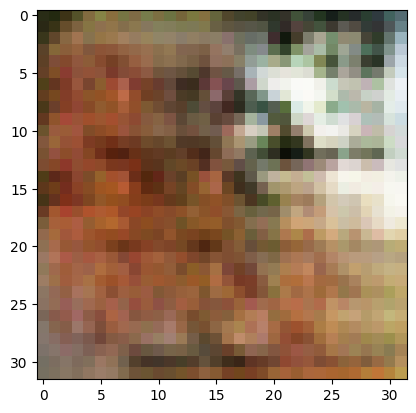

2/2 [==============================] - 0s 7ms/step
>3, 98/390, d1=0.527, d2=0.712 g=1.534


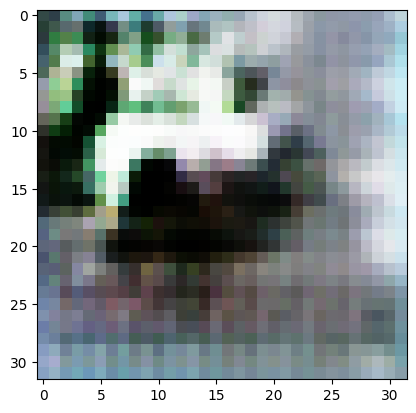

2/2 [==============================] - 0s 8ms/step
>3, 99/390, d1=0.695, d2=0.752 g=1.314


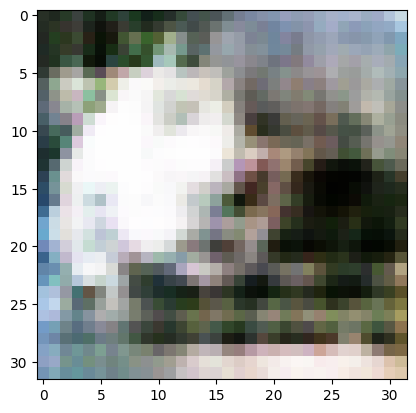

2/2 [==============================] - 0s 7ms/step
>3, 100/390, d1=0.653, d2=0.799 g=1.610


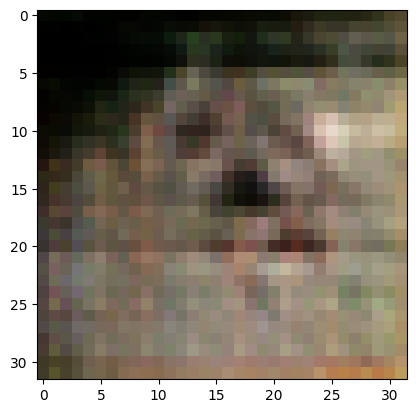

2/2 [==============================] - 0s 8ms/step
>3, 101/390, d1=0.810, d2=0.689 g=1.437


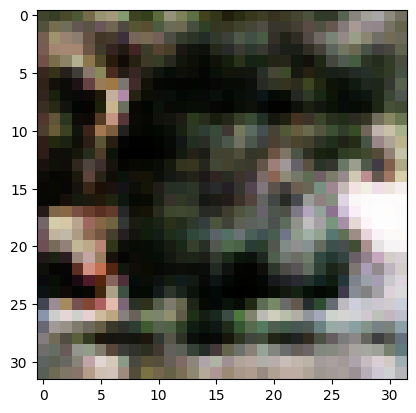

2/2 [==============================] - 0s 7ms/step
>3, 102/390, d1=0.759, d2=0.432 g=1.463


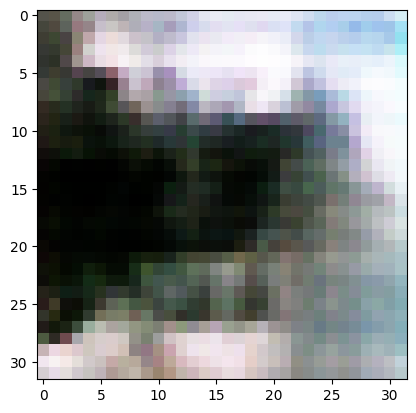

2/2 [==============================] - 0s 7ms/step
>3, 103/390, d1=0.630, d2=0.570 g=1.357


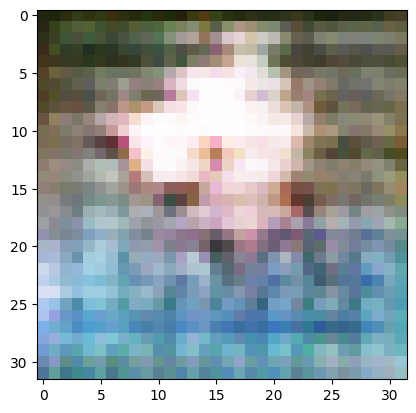

2/2 [==============================] - 0s 7ms/step
>3, 104/390, d1=0.629, d2=0.581 g=1.354


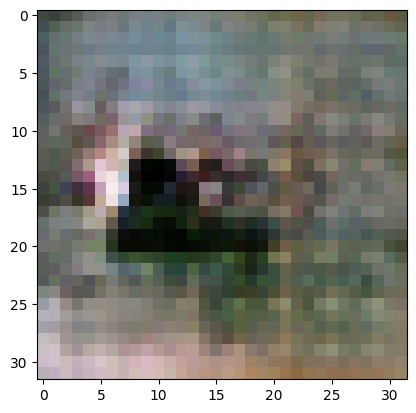

2/2 [==============================] - 0s 8ms/step
>3, 105/390, d1=0.606, d2=0.585 g=1.204


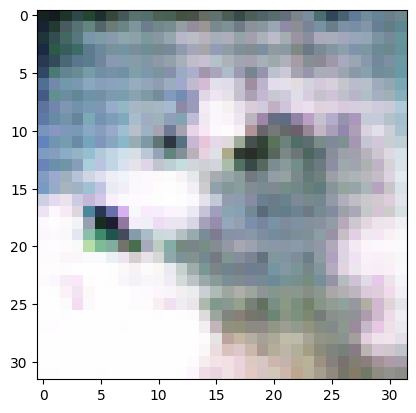

2/2 [==============================] - 0s 9ms/step
>3, 106/390, d1=0.506, d2=0.695 g=1.292


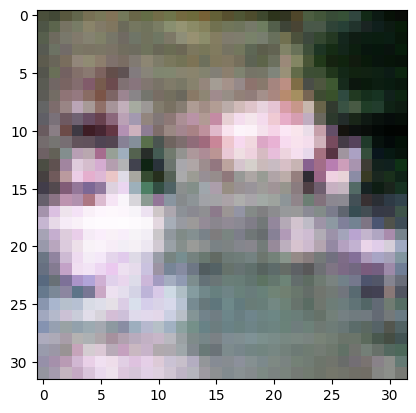

2/2 [==============================] - 0s 10ms/step
>3, 107/390, d1=0.627, d2=0.786 g=1.463


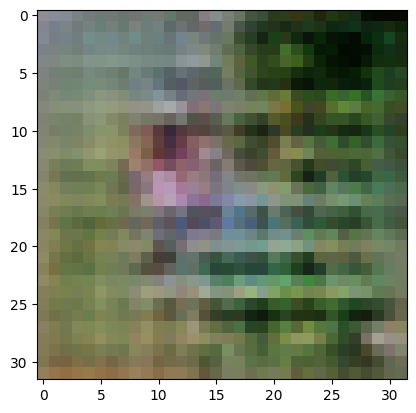

2/2 [==============================] - 0s 6ms/step
>3, 108/390, d1=0.683, d2=0.537 g=1.850


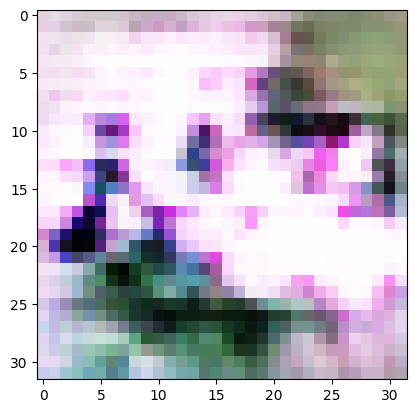

2/2 [==============================] - 0s 8ms/step
>3, 109/390, d1=0.748, d2=0.419 g=1.518


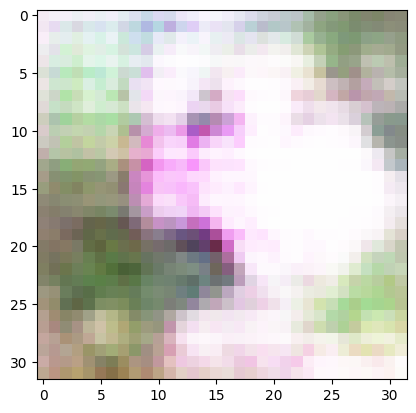

2/2 [==============================] - 0s 8ms/step
>3, 110/390, d1=0.731, d2=0.886 g=1.385


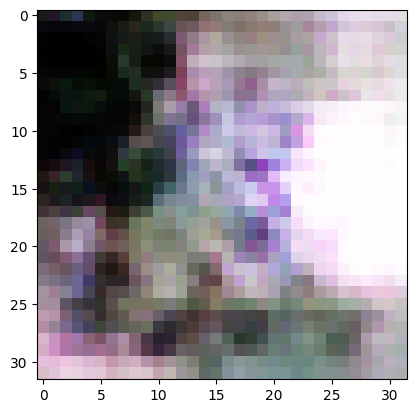

2/2 [==============================] - 0s 8ms/step
>3, 111/390, d1=0.720, d2=0.641 g=1.339


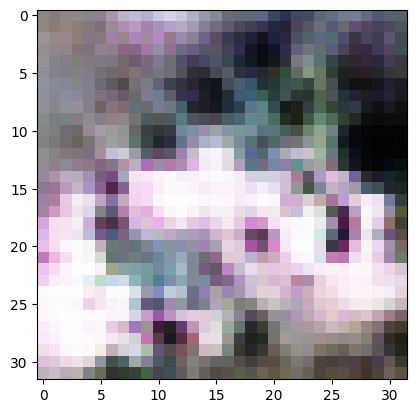

2/2 [==============================] - 0s 11ms/step
>3, 112/390, d1=0.733, d2=0.638 g=1.286


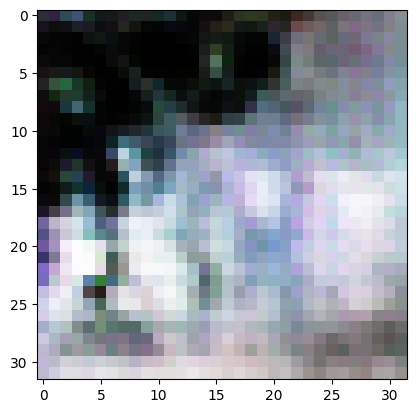

2/2 [==============================] - 0s 7ms/step
>3, 113/390, d1=0.796, d2=0.639 g=1.153


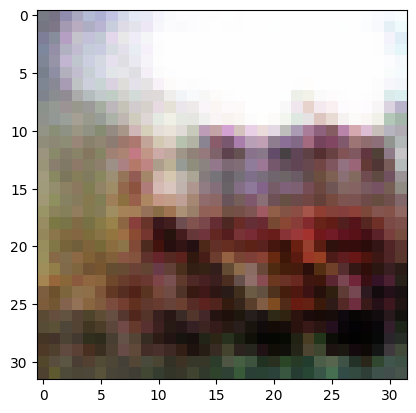

2/2 [==============================] - 0s 7ms/step
>3, 114/390, d1=0.567, d2=0.688 g=1.140


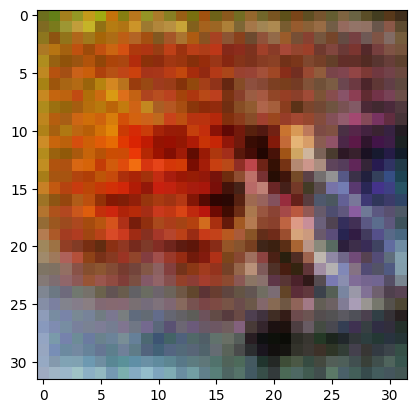

2/2 [==============================] - 0s 6ms/step
>3, 115/390, d1=0.527, d2=0.629 g=1.210


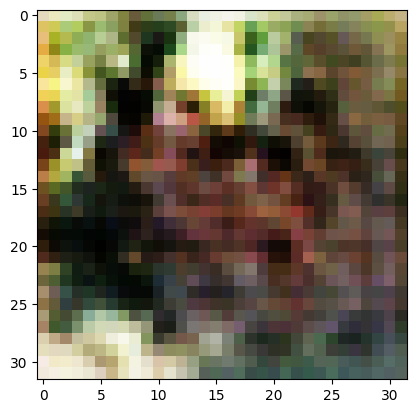

2/2 [==============================] - 0s 7ms/step
>3, 116/390, d1=0.687, d2=0.583 g=1.250


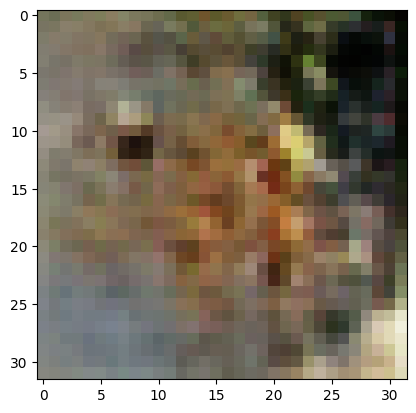

2/2 [==============================] - 0s 7ms/step
>3, 117/390, d1=0.583, d2=0.613 g=1.363


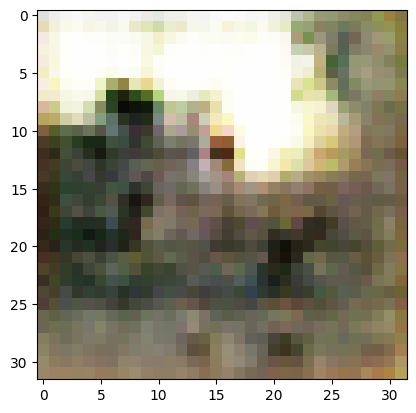

2/2 [==============================] - 0s 7ms/step
>3, 118/390, d1=0.545, d2=0.578 g=1.263


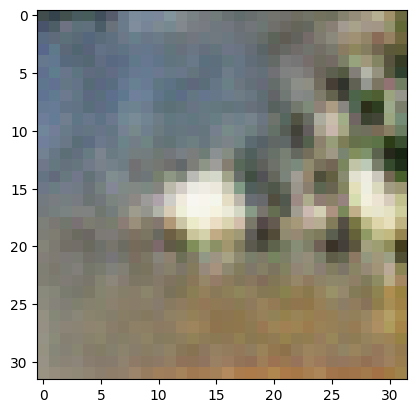

2/2 [==============================] - 0s 7ms/step
>3, 119/390, d1=0.550, d2=0.574 g=1.139


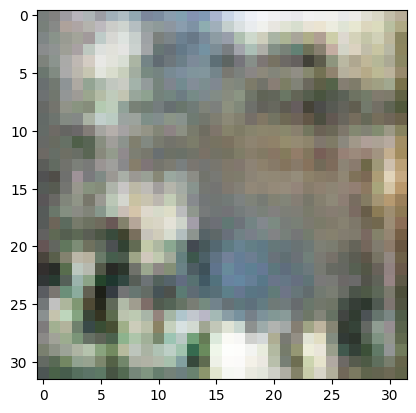

2/2 [==============================] - 0s 7ms/step
>3, 120/390, d1=0.601, d2=0.665 g=1.148


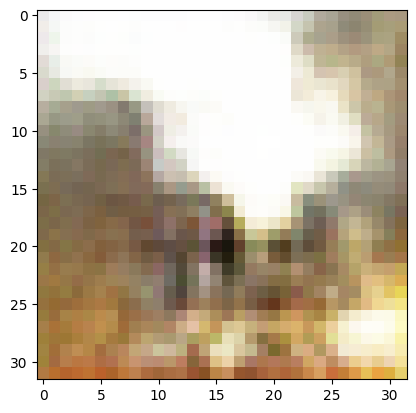

2/2 [==============================] - 0s 8ms/step
>3, 121/390, d1=0.490, d2=0.689 g=1.147


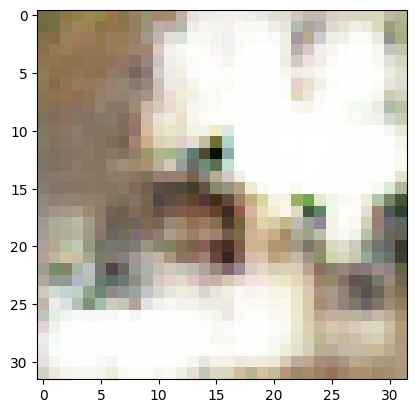

2/2 [==============================] - 0s 7ms/step
>3, 122/390, d1=0.599, d2=0.672 g=1.183


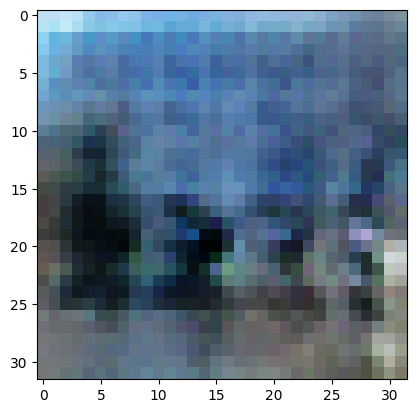

2/2 [==============================] - 0s 8ms/step
>3, 123/390, d1=0.544, d2=0.713 g=1.290


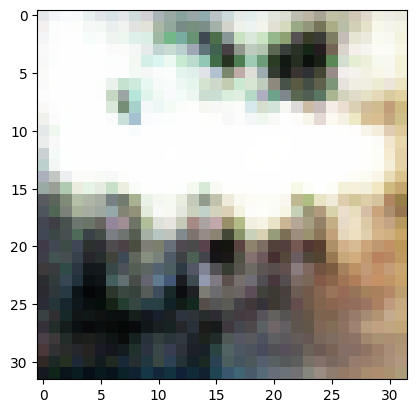

2/2 [==============================] - 0s 7ms/step
>3, 124/390, d1=0.602, d2=0.534 g=1.358


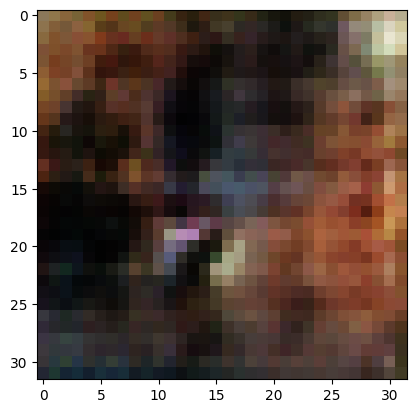

2/2 [==============================] - 0s 8ms/step
>3, 125/390, d1=0.572, d2=0.517 g=1.351


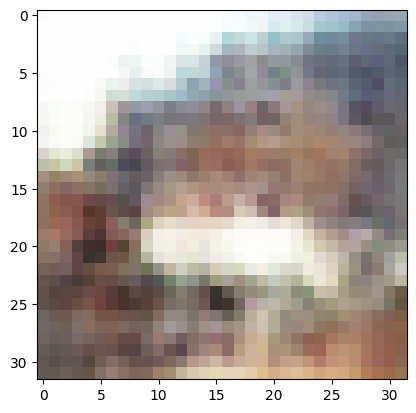

2/2 [==============================] - 0s 8ms/step
>3, 126/390, d1=0.563, d2=0.554 g=1.394


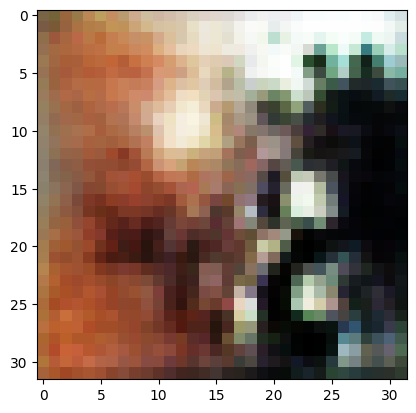

2/2 [==============================] - 0s 6ms/step
>3, 127/390, d1=0.536, d2=0.413 g=1.427


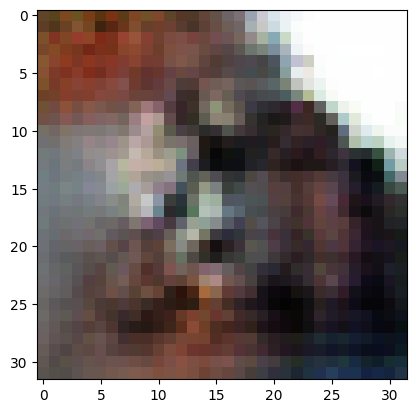

2/2 [==============================] - 0s 7ms/step
>3, 128/390, d1=0.537, d2=0.572 g=1.403


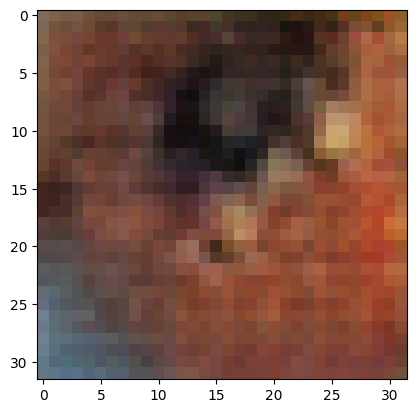

2/2 [==============================] - 0s 7ms/step
>3, 129/390, d1=0.717, d2=0.643 g=1.290


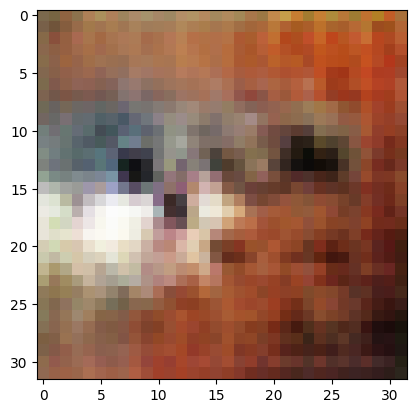

2/2 [==============================] - 0s 8ms/step
>3, 130/390, d1=0.658, d2=0.632 g=1.223


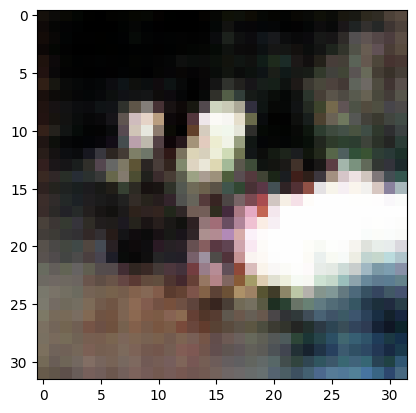

2/2 [==============================] - 0s 9ms/step
>3, 131/390, d1=0.491, d2=0.553 g=1.276


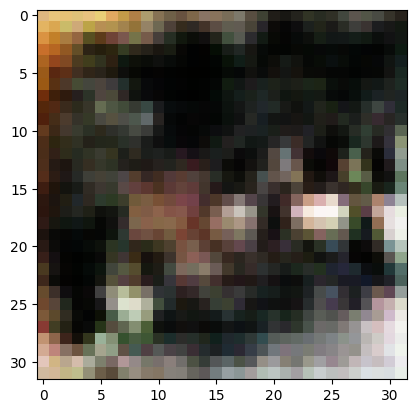

2/2 [==============================] - 0s 6ms/step
>3, 132/390, d1=0.566, d2=0.703 g=1.266


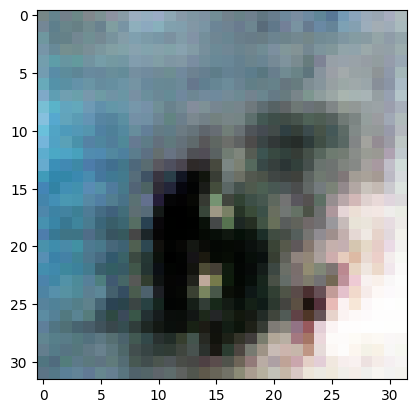

2/2 [==============================] - 0s 7ms/step
>3, 133/390, d1=0.702, d2=0.541 g=1.326


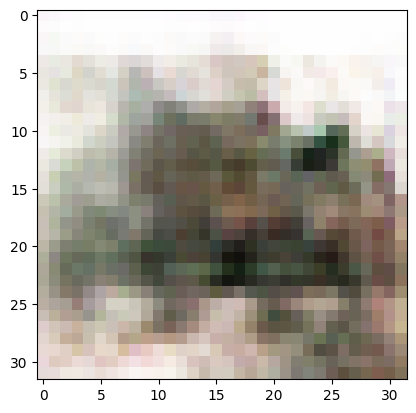

2/2 [==============================] - 0s 7ms/step
>3, 134/390, d1=0.732, d2=0.552 g=1.339


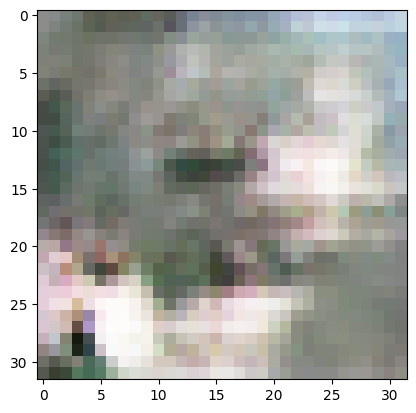

2/2 [==============================] - 0s 10ms/step
>3, 135/390, d1=0.655, d2=0.813 g=1.421


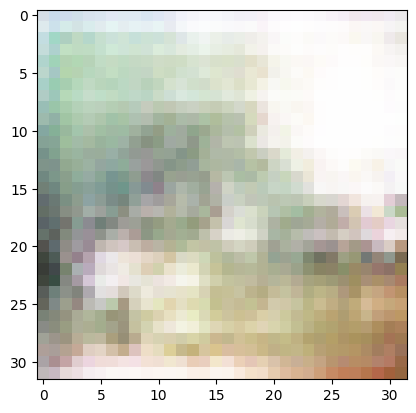

2/2 [==============================] - 0s 10ms/step
>3, 136/390, d1=0.782, d2=0.653 g=1.616


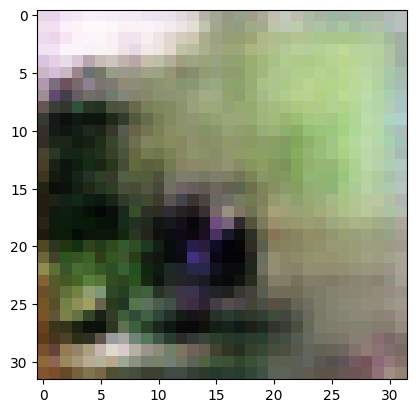

2/2 [==============================] - 0s 7ms/step
>3, 137/390, d1=0.644, d2=0.435 g=1.808


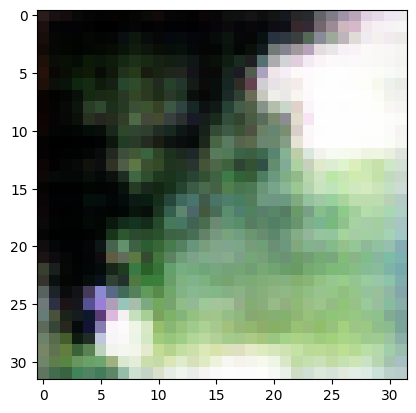

2/2 [==============================] - 0s 7ms/step
>3, 138/390, d1=0.701, d2=0.698 g=1.452


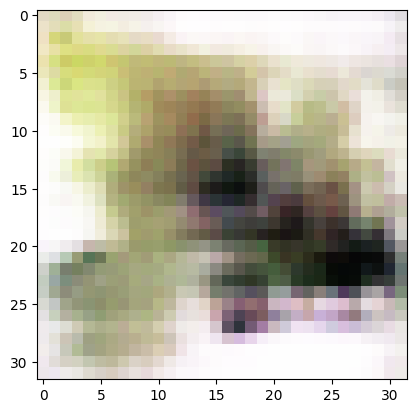

2/2 [==============================] - 0s 7ms/step
>3, 139/390, d1=0.688, d2=0.530 g=1.355


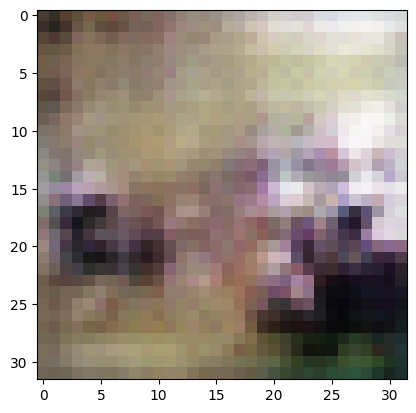

2/2 [==============================] - 0s 8ms/step
>3, 140/390, d1=0.675, d2=0.476 g=1.273


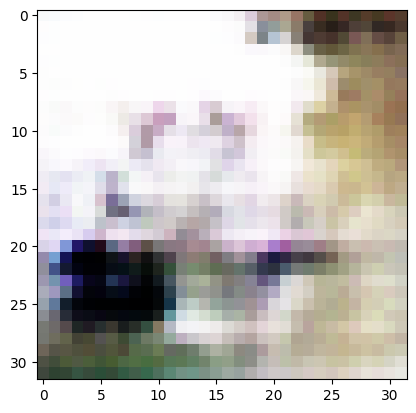

2/2 [==============================] - 0s 8ms/step
>3, 141/390, d1=0.754, d2=0.484 g=1.206


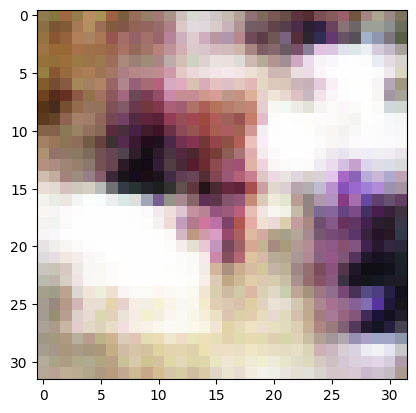

2/2 [==============================] - 0s 8ms/step
>3, 142/390, d1=0.598, d2=0.489 g=1.245


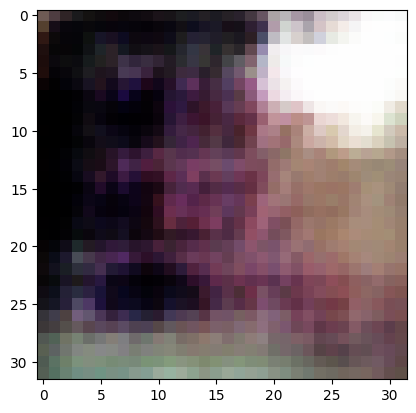

2/2 [==============================] - 0s 8ms/step
>3, 143/390, d1=0.590, d2=0.542 g=1.242


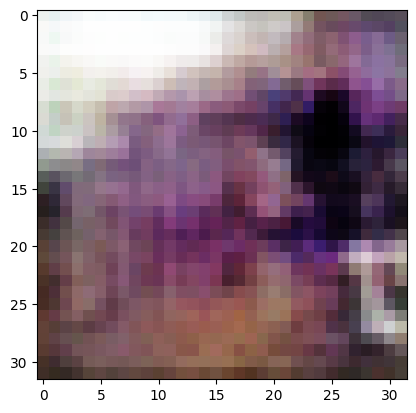

2/2 [==============================] - 0s 8ms/step
>3, 144/390, d1=0.531, d2=0.519 g=1.324


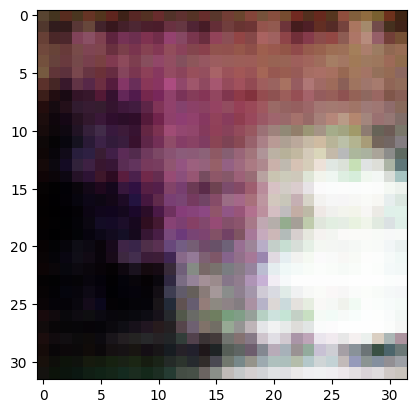

2/2 [==============================] - 0s 11ms/step
>3, 145/390, d1=0.459, d2=0.443 g=1.336


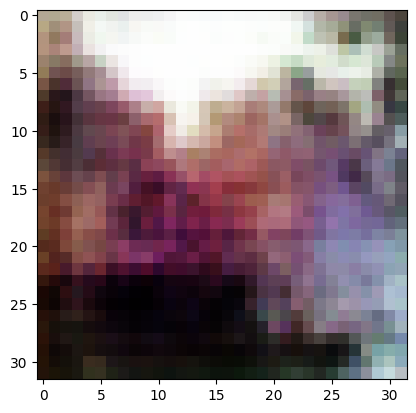

2/2 [==============================] - 0s 7ms/step
>3, 146/390, d1=0.417, d2=0.914 g=1.542


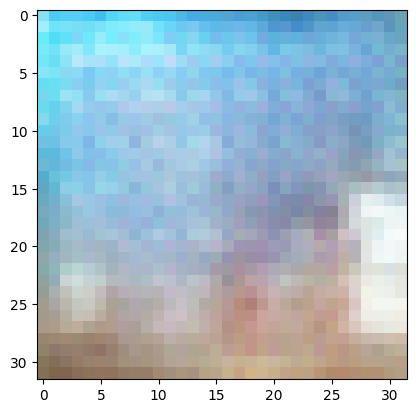

2/2 [==============================] - 0s 7ms/step
>3, 147/390, d1=0.563, d2=0.702 g=1.603


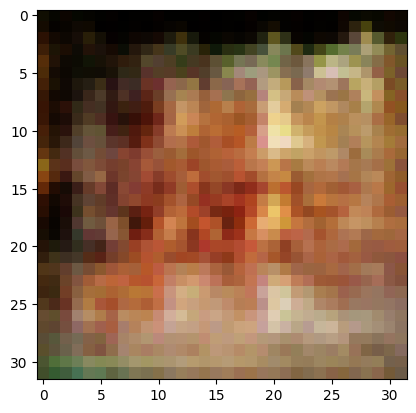

2/2 [==============================] - 0s 9ms/step
>3, 148/390, d1=0.933, d2=0.461 g=1.354


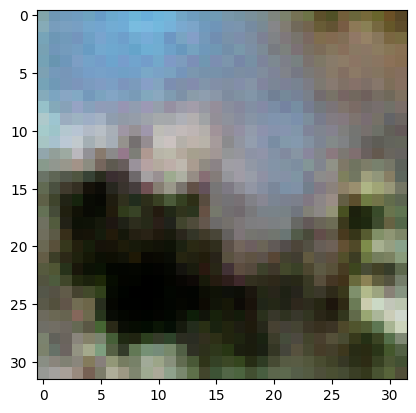

2/2 [==============================] - 0s 8ms/step
>3, 149/390, d1=0.760, d2=0.594 g=1.120


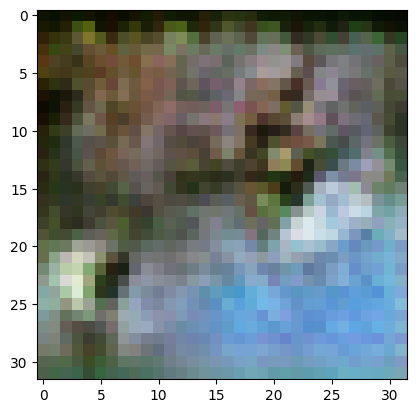

2/2 [==============================] - 0s 8ms/step
>3, 150/390, d1=0.570, d2=0.730 g=1.207


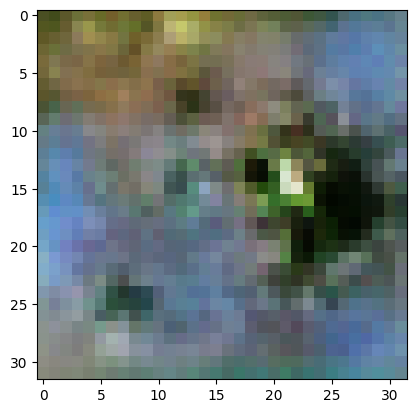

2/2 [==============================] - 0s 6ms/step
>3, 151/390, d1=0.614, d2=0.740 g=1.330


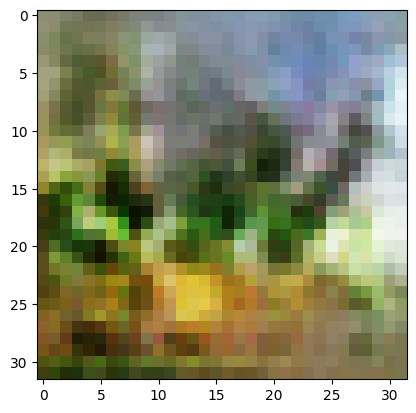

2/2 [==============================] - 0s 17ms/step
>3, 152/390, d1=0.637, d2=0.581 g=1.441


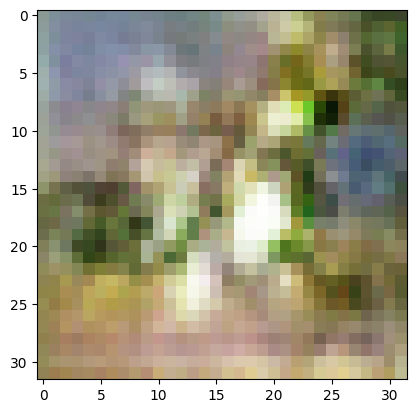

2/2 [==============================] - 0s 7ms/step
>3, 153/390, d1=0.622, d2=0.674 g=1.527


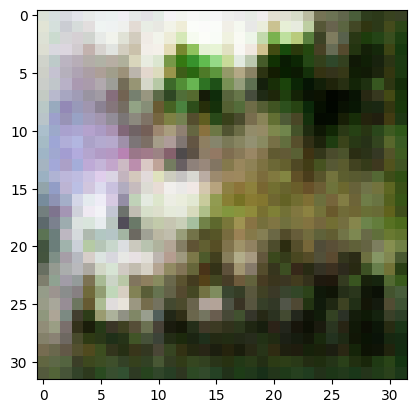

2/2 [==============================] - 0s 6ms/step
>3, 154/390, d1=0.630, d2=0.745 g=1.684


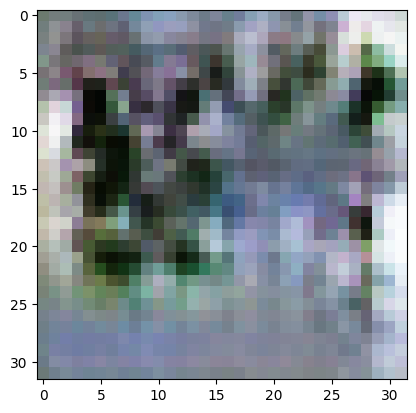

2/2 [==============================] - 0s 9ms/step
>3, 155/390, d1=0.567, d2=0.417 g=1.657


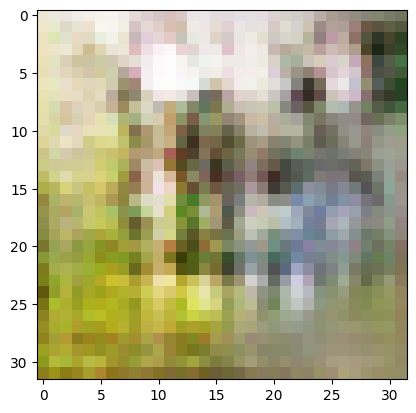

2/2 [==============================] - 0s 7ms/step
>3, 156/390, d1=0.800, d2=0.675 g=1.212


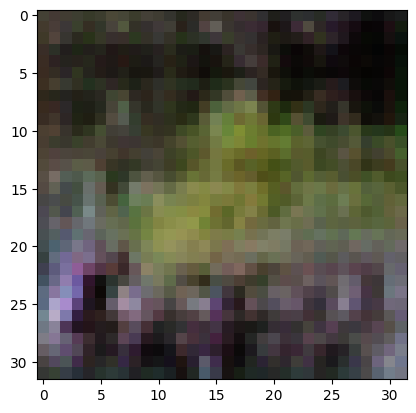

2/2 [==============================] - 0s 8ms/step
>3, 157/390, d1=0.636, d2=0.723 g=1.079


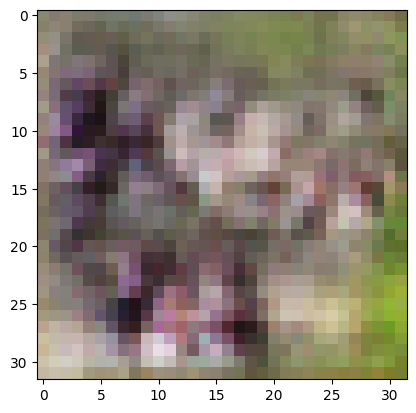

2/2 [==============================] - 0s 7ms/step
>3, 158/390, d1=0.649, d2=0.734 g=1.058


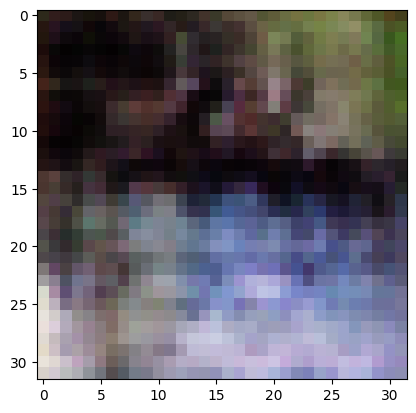

2/2 [==============================] - 0s 8ms/step
>3, 159/390, d1=0.663, d2=0.774 g=1.135


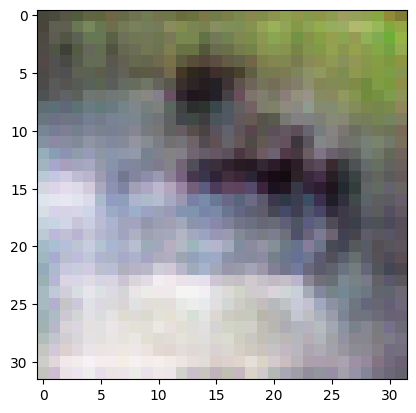

2/2 [==============================] - 0s 7ms/step
>3, 160/390, d1=0.753, d2=0.654 g=1.175


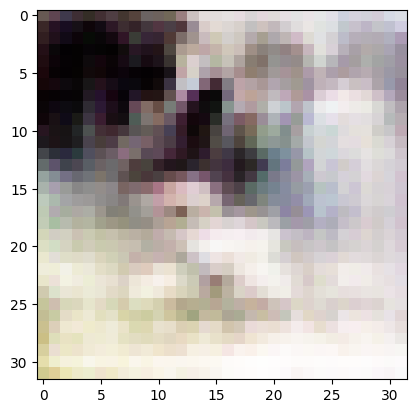

2/2 [==============================] - 0s 7ms/step
>3, 161/390, d1=0.777, d2=0.578 g=1.164


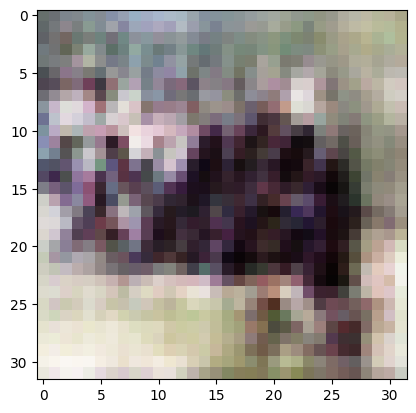

2/2 [==============================] - 0s 8ms/step
>3, 162/390, d1=0.691, d2=0.681 g=1.140


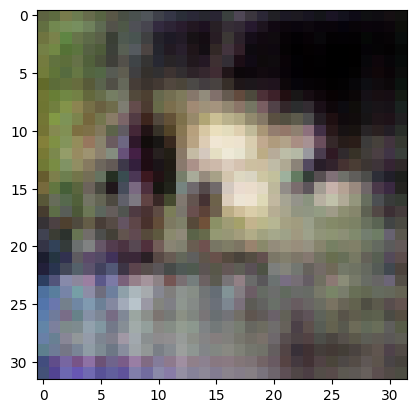

2/2 [==============================] - 0s 9ms/step
>3, 163/390, d1=0.665, d2=0.866 g=1.347


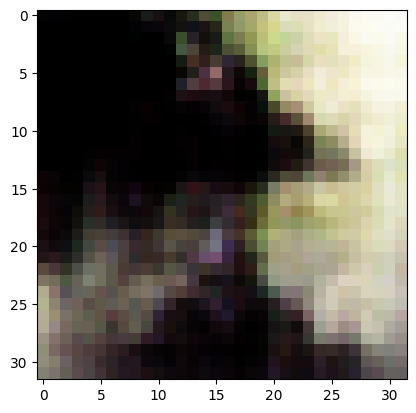

2/2 [==============================] - 0s 8ms/step
>3, 164/390, d1=0.805, d2=0.394 g=1.357


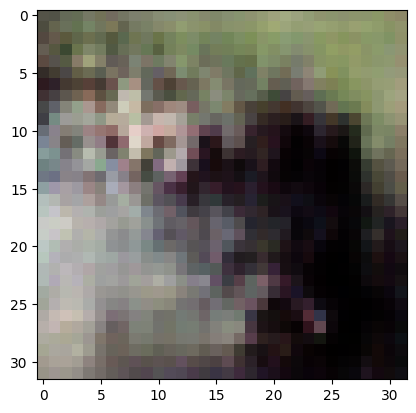

2/2 [==============================] - 0s 7ms/step
>3, 165/390, d1=0.814, d2=0.480 g=1.187


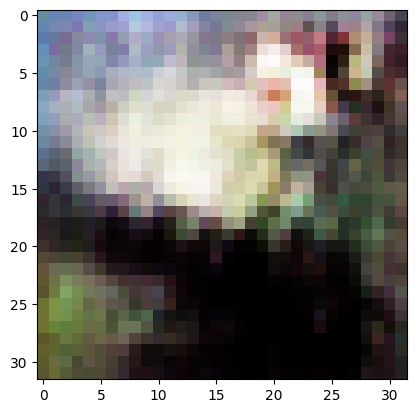

2/2 [==============================] - 0s 9ms/step
>3, 166/390, d1=0.597, d2=0.521 g=1.121


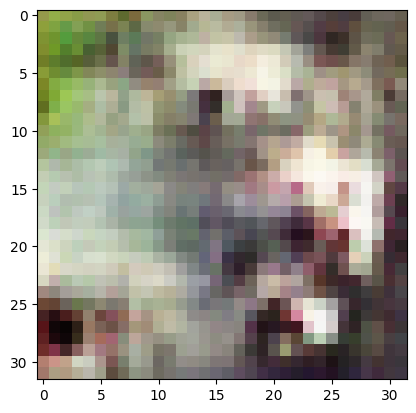

2/2 [==============================] - 0s 6ms/step
>3, 167/390, d1=0.595, d2=0.664 g=1.049


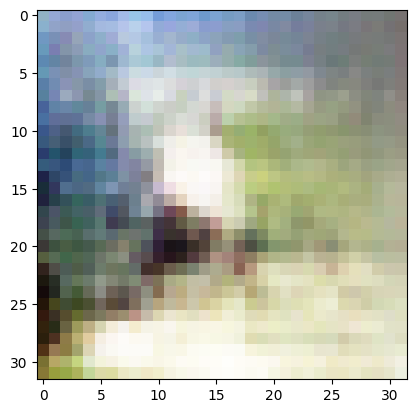

2/2 [==============================] - 0s 6ms/step
>3, 168/390, d1=0.688, d2=0.735 g=0.948


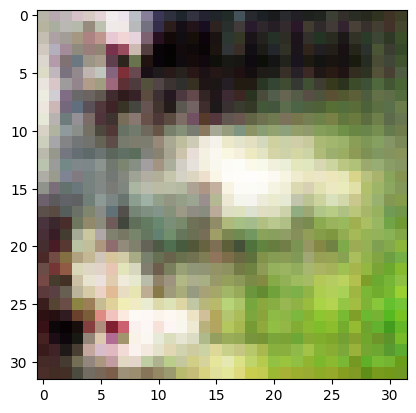

2/2 [==============================] - 0s 7ms/step
>3, 169/390, d1=0.547, d2=0.647 g=1.044


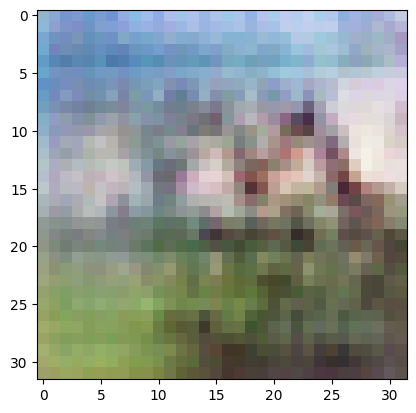

2/2 [==============================] - 0s 8ms/step
>3, 170/390, d1=0.627, d2=0.594 g=1.065


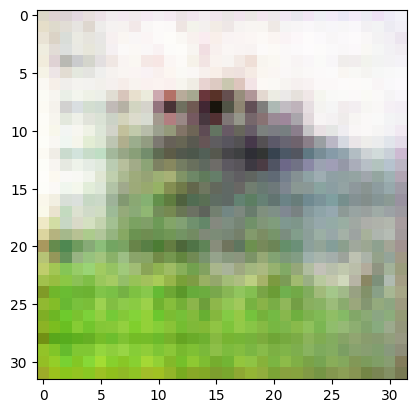

2/2 [==============================] - 0s 7ms/step
>3, 171/390, d1=0.597, d2=0.524 g=1.184


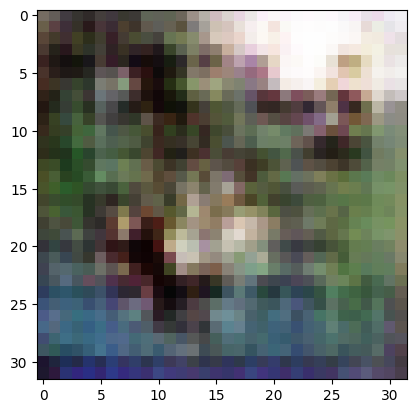

2/2 [==============================] - 0s 8ms/step
>3, 172/390, d1=0.604, d2=0.576 g=1.265


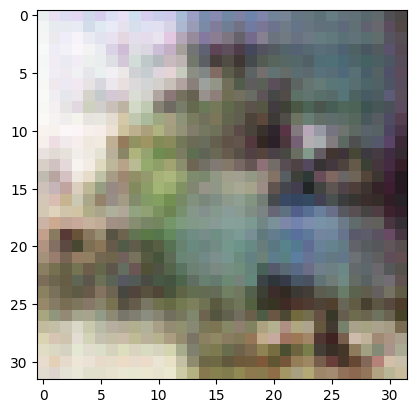

2/2 [==============================] - 0s 8ms/step
>3, 173/390, d1=0.602, d2=0.654 g=1.347


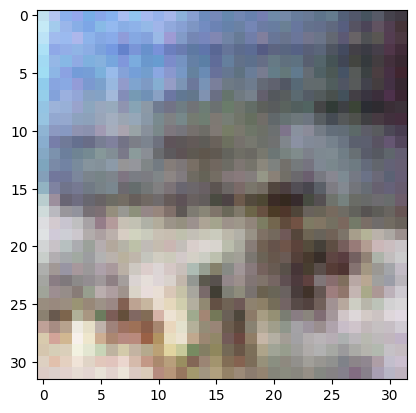

2/2 [==============================] - 0s 8ms/step
>3, 174/390, d1=0.577, d2=0.628 g=1.225


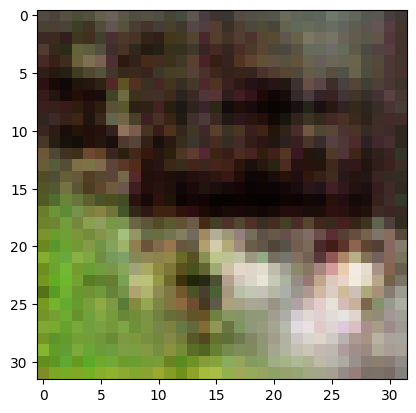

2/2 [==============================] - 0s 7ms/step
>3, 175/390, d1=0.659, d2=0.692 g=1.185


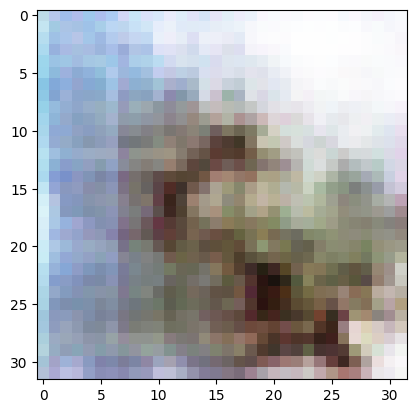

2/2 [==============================] - 0s 11ms/step
>3, 176/390, d1=0.624, d2=0.710 g=1.197


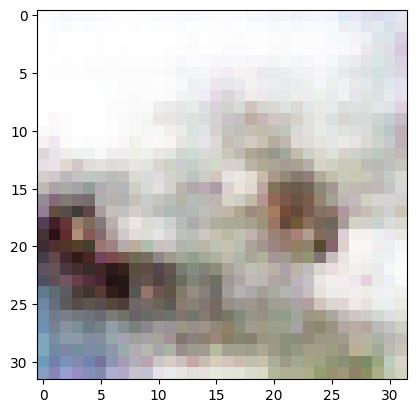

2/2 [==============================] - 0s 10ms/step
>3, 177/390, d1=0.694, d2=0.650 g=1.207


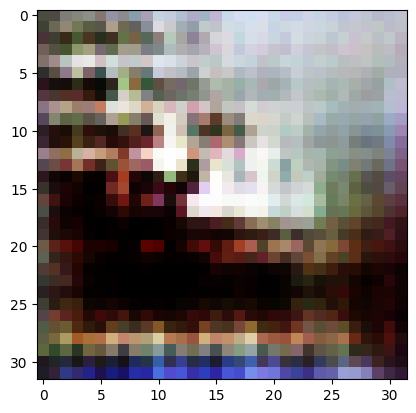

2/2 [==============================] - 0s 8ms/step
>3, 178/390, d1=0.665, d2=0.675 g=1.374


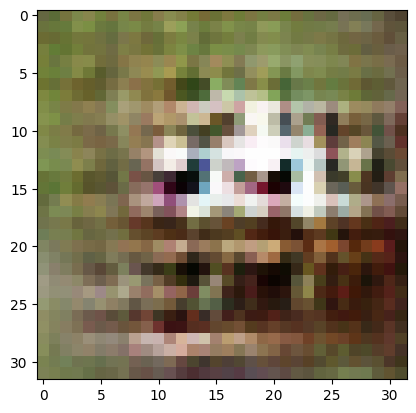

2/2 [==============================] - 0s 7ms/step
>3, 179/390, d1=0.596, d2=0.613 g=1.415


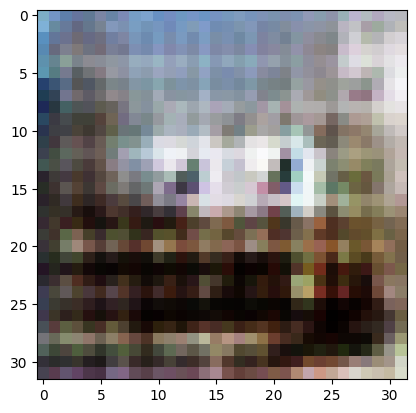

2/2 [==============================] - 0s 8ms/step
>3, 180/390, d1=0.636, d2=0.531 g=1.463


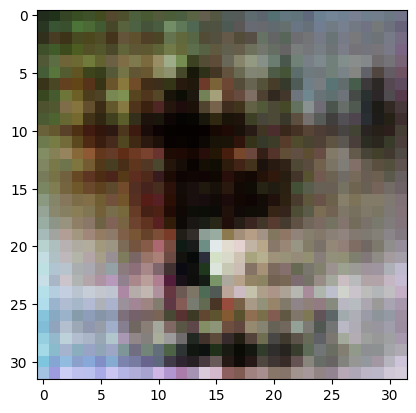

2/2 [==============================] - 0s 7ms/step
>3, 181/390, d1=0.533, d2=0.610 g=1.528


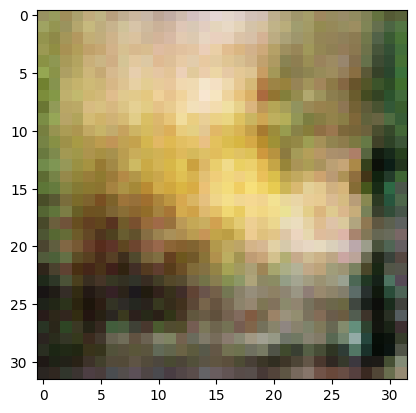

2/2 [==============================] - 0s 8ms/step
>3, 182/390, d1=0.543, d2=0.513 g=1.435


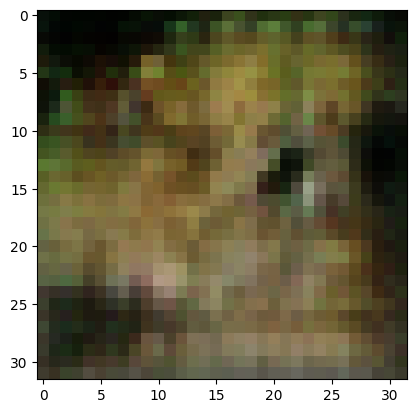

2/2 [==============================] - 0s 8ms/step
>3, 183/390, d1=0.561, d2=0.589 g=1.206


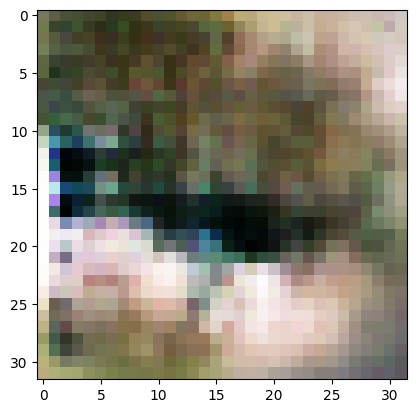

2/2 [==============================] - 0s 8ms/step
>3, 184/390, d1=0.603, d2=0.858 g=1.118


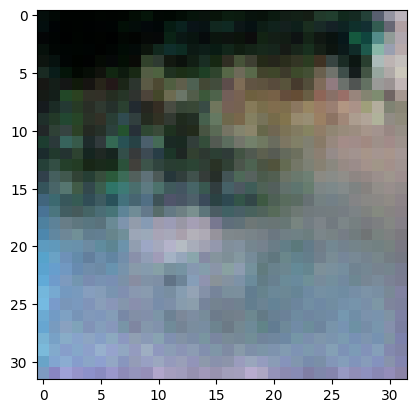

2/2 [==============================] - 0s 7ms/step
>3, 185/390, d1=0.559, d2=0.706 g=1.174


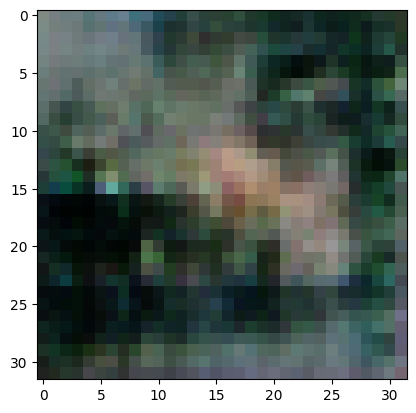

2/2 [==============================] - 0s 8ms/step
>3, 186/390, d1=0.660, d2=0.572 g=1.124


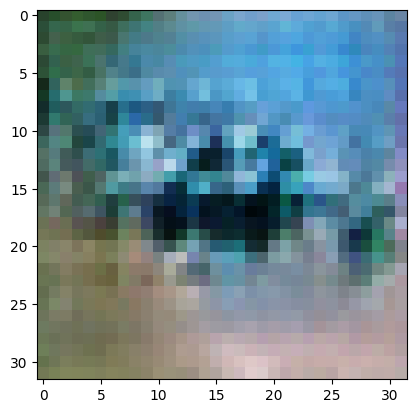

2/2 [==============================] - 0s 6ms/step
>3, 187/390, d1=0.683, d2=0.672 g=1.298


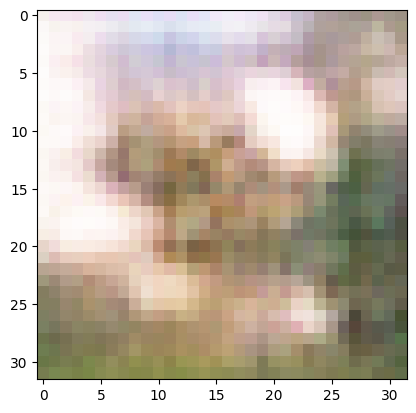

2/2 [==============================] - 0s 7ms/step
>3, 188/390, d1=0.617, d2=0.573 g=1.446


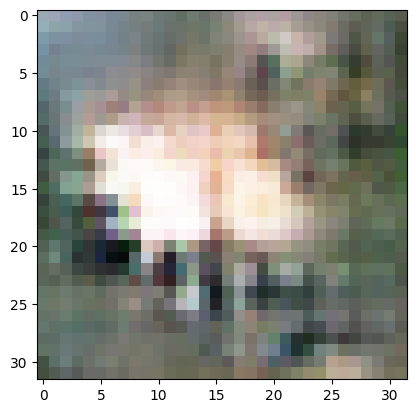

2/2 [==============================] - 0s 7ms/step
>3, 189/390, d1=0.602, d2=0.583 g=1.531


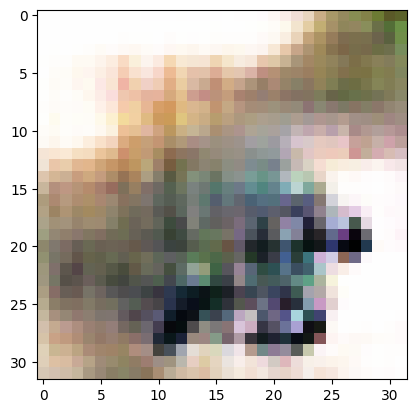

2/2 [==============================] - 0s 7ms/step
>3, 190/390, d1=0.566, d2=0.615 g=1.530


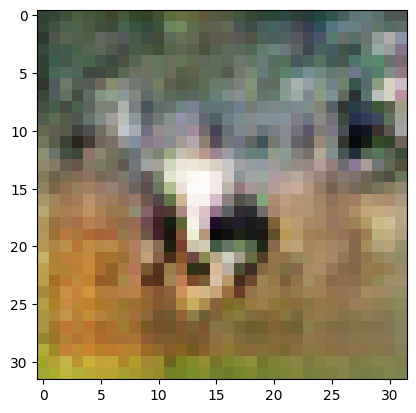

2/2 [==============================] - 0s 8ms/step
>3, 191/390, d1=0.646, d2=0.627 g=1.358


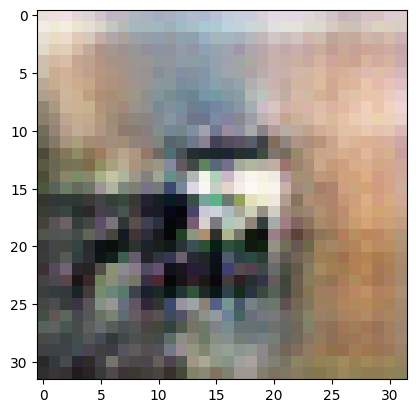

2/2 [==============================] - 0s 7ms/step
>3, 192/390, d1=0.759, d2=0.626 g=1.226


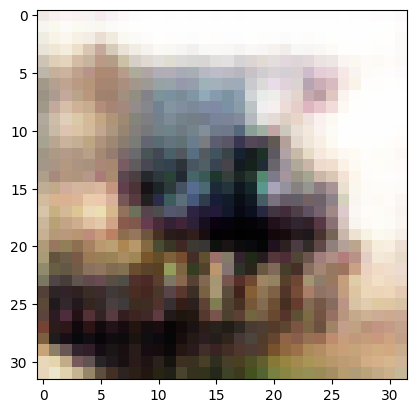

2/2 [==============================] - 0s 8ms/step
>3, 193/390, d1=0.597, d2=0.733 g=1.225


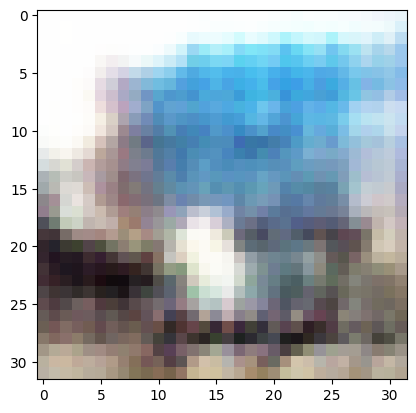

2/2 [==============================] - 0s 8ms/step
>3, 194/390, d1=0.772, d2=0.651 g=1.232


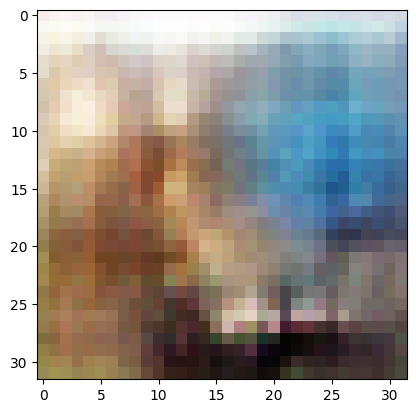

2/2 [==============================] - 0s 8ms/step
>3, 195/390, d1=0.791, d2=0.583 g=1.282


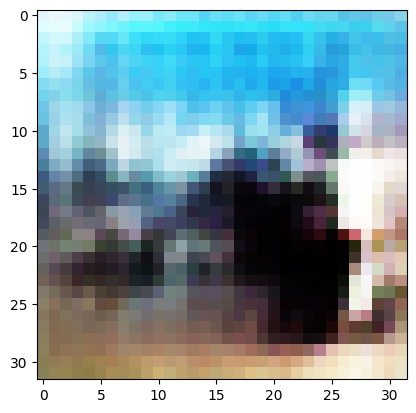

2/2 [==============================] - 0s 8ms/step
>3, 196/390, d1=0.747, d2=0.489 g=1.355


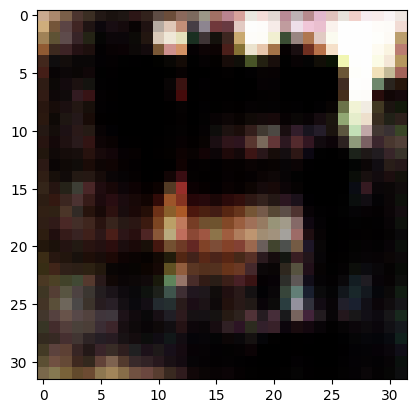

2/2 [==============================] - 0s 8ms/step
>3, 197/390, d1=0.689, d2=0.421 g=1.461


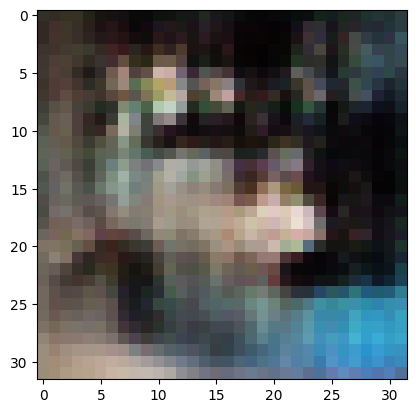

2/2 [==============================] - 0s 7ms/step
>3, 198/390, d1=0.488, d2=0.511 g=1.399


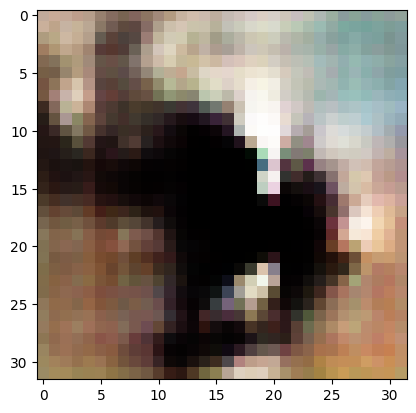

2/2 [==============================] - 0s 7ms/step
>3, 199/390, d1=0.631, d2=0.533 g=1.275


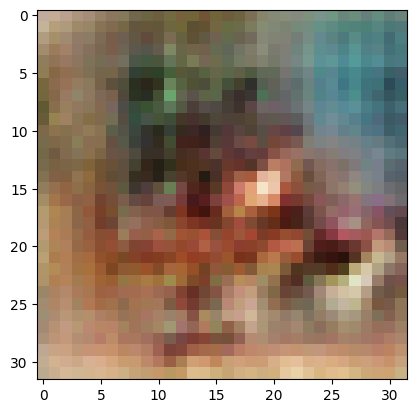

2/2 [==============================] - 0s 8ms/step
>3, 200/390, d1=0.416, d2=0.552 g=1.198


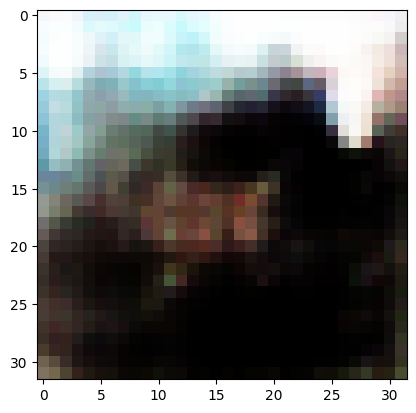

2/2 [==============================] - 0s 14ms/step
>3, 201/390, d1=0.519, d2=0.646 g=1.204


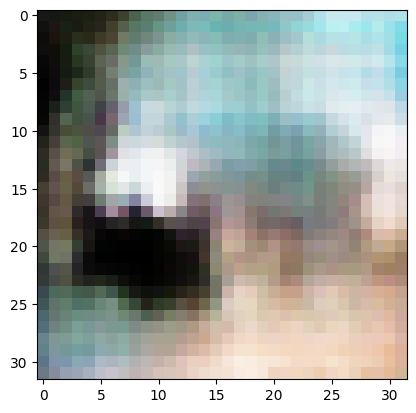

2/2 [==============================] - 0s 7ms/step
>3, 202/390, d1=0.645, d2=0.812 g=1.159


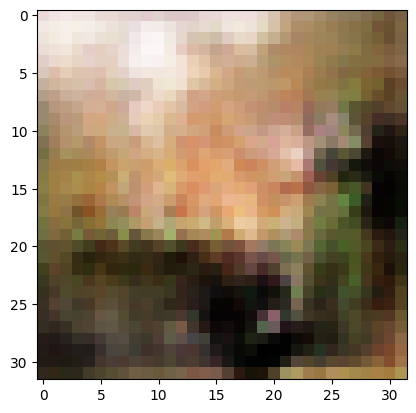

2/2 [==============================] - 0s 8ms/step
>3, 203/390, d1=0.623, d2=1.709 g=1.534


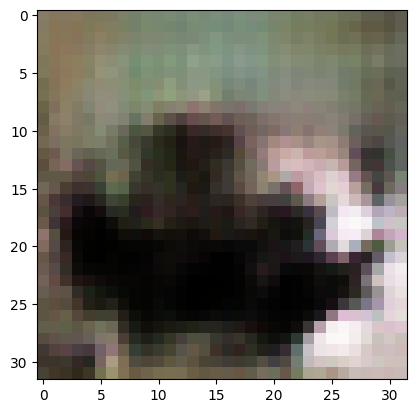

2/2 [==============================] - 0s 8ms/step
>3, 204/390, d1=0.829, d2=0.518 g=1.431


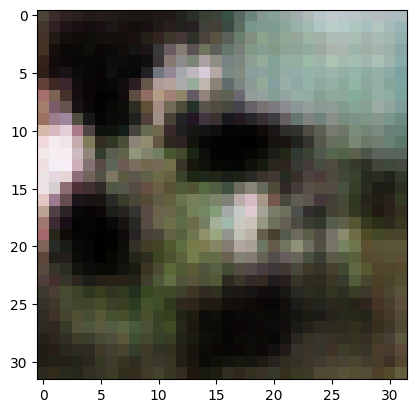

2/2 [==============================] - 0s 7ms/step
>3, 205/390, d1=0.890, d2=0.543 g=1.419


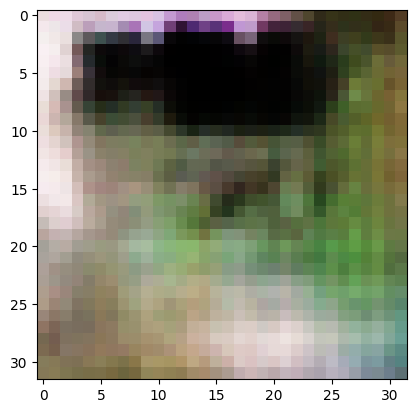

2/2 [==============================] - 0s 7ms/step
>3, 206/390, d1=0.678, d2=0.575 g=1.290


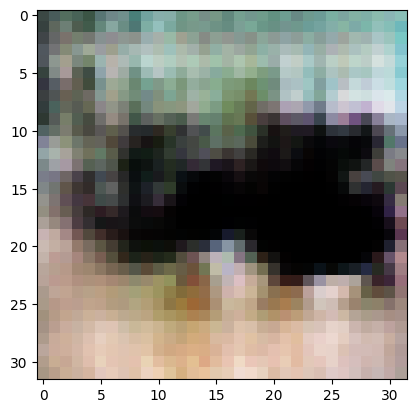

2/2 [==============================] - 0s 7ms/step
>3, 207/390, d1=0.622, d2=0.654 g=1.340


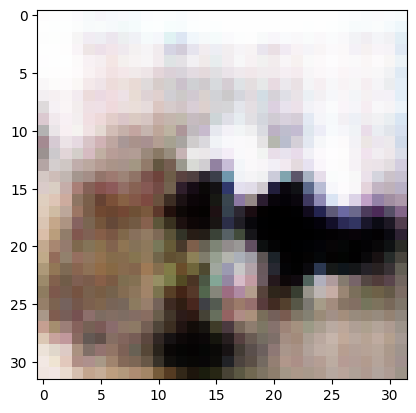

2/2 [==============================] - 0s 7ms/step
>3, 208/390, d1=0.688, d2=0.429 g=1.473


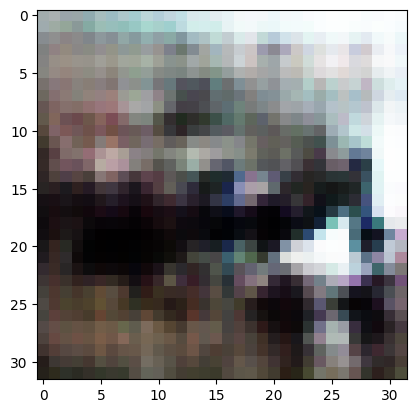

2/2 [==============================] - 0s 7ms/step
>3, 209/390, d1=0.732, d2=0.497 g=1.371


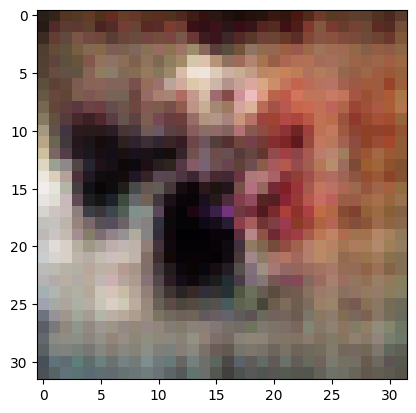

2/2 [==============================] - 0s 6ms/step
>3, 210/390, d1=0.643, d2=0.573 g=1.275


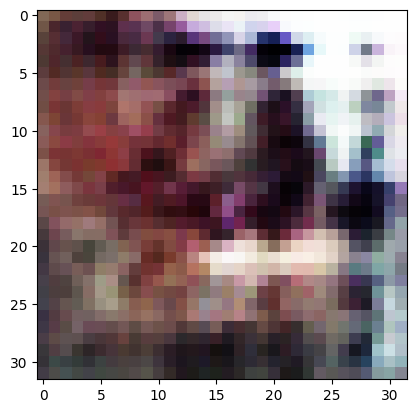

2/2 [==============================] - 0s 7ms/step
>3, 211/390, d1=0.720, d2=0.577 g=1.232


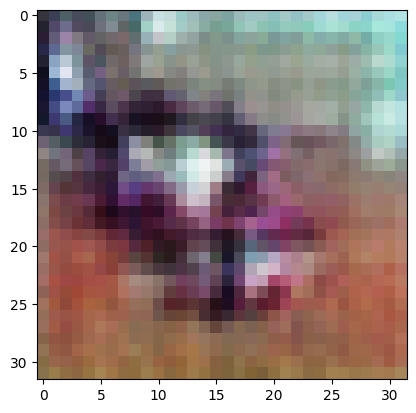

2/2 [==============================] - 0s 9ms/step
>3, 212/390, d1=0.535, d2=0.782 g=1.223


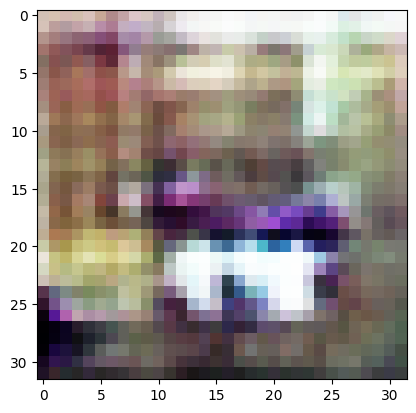

2/2 [==============================] - 0s 8ms/step
>3, 213/390, d1=0.626, d2=1.283 g=1.442


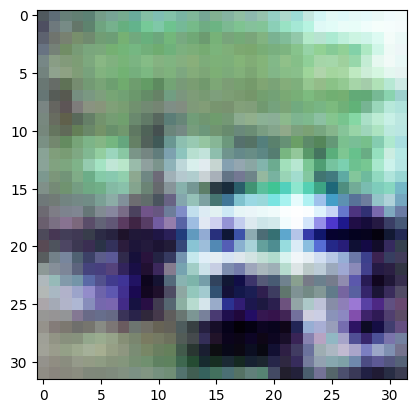

2/2 [==============================] - 0s 8ms/step
>3, 214/390, d1=0.602, d2=0.463 g=1.581


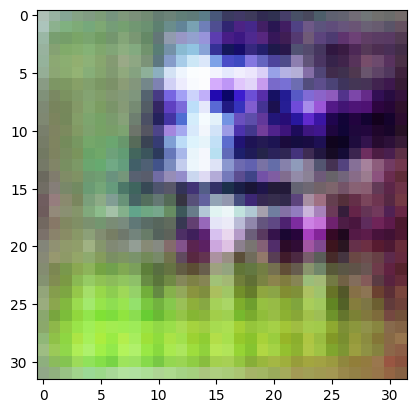

2/2 [==============================] - 0s 7ms/step
>3, 215/390, d1=0.630, d2=0.438 g=1.645


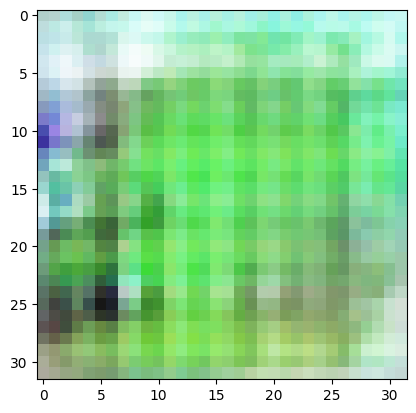

2/2 [==============================] - 0s 9ms/step
>3, 216/390, d1=0.582, d2=0.576 g=1.849


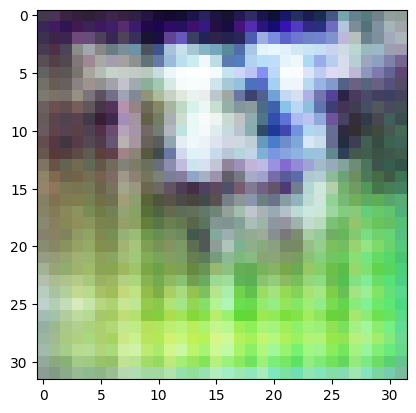

2/2 [==============================] - 0s 9ms/step
>3, 217/390, d1=0.511, d2=0.739 g=2.284


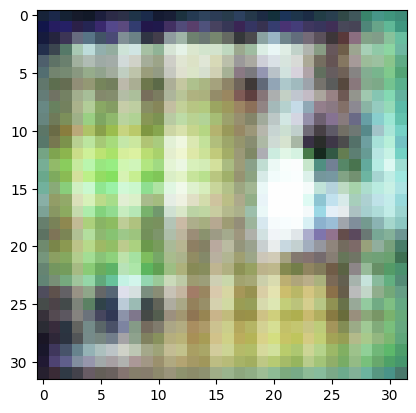

2/2 [==============================] - 0s 8ms/step
>3, 218/390, d1=0.686, d2=0.406 g=1.974


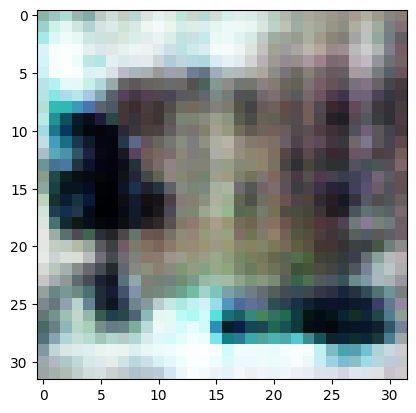

2/2 [==============================] - 0s 12ms/step
>3, 219/390, d1=0.762, d2=0.670 g=1.303


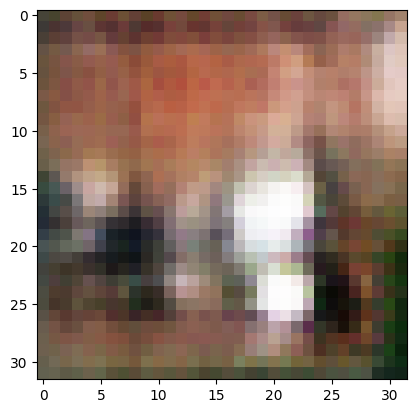

2/2 [==============================] - 0s 7ms/step
>3, 220/390, d1=0.621, d2=0.812 g=1.290


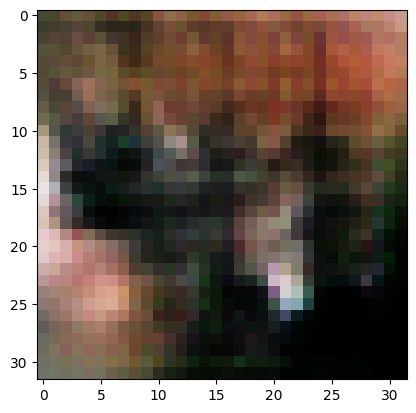

2/2 [==============================] - 0s 7ms/step
>3, 221/390, d1=0.785, d2=0.519 g=1.233


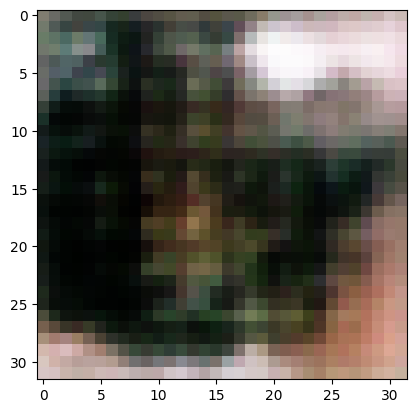

2/2 [==============================] - 0s 6ms/step
>3, 222/390, d1=0.617, d2=0.566 g=1.295


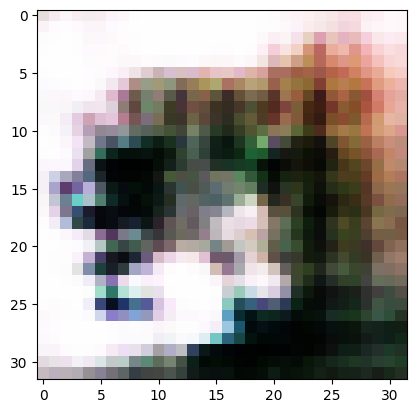

2/2 [==============================] - 0s 6ms/step
>3, 223/390, d1=0.696, d2=0.445 g=1.544


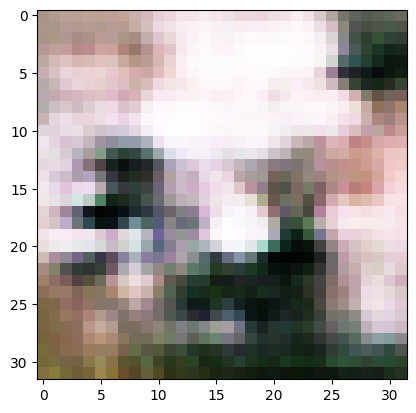

2/2 [==============================] - 0s 8ms/step
>3, 224/390, d1=0.556, d2=0.336 g=1.635


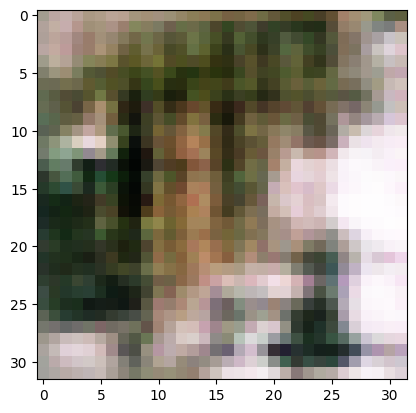

2/2 [==============================] - 0s 9ms/step
>3, 225/390, d1=0.630, d2=0.388 g=1.759


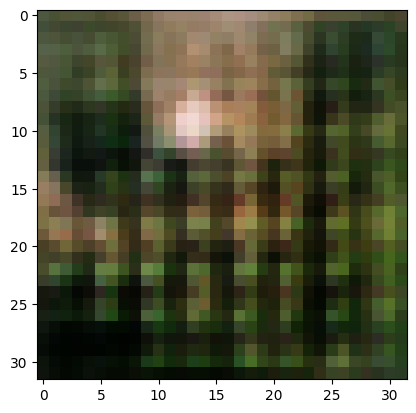

2/2 [==============================] - 0s 8ms/step
>3, 226/390, d1=0.486, d2=0.505 g=1.732


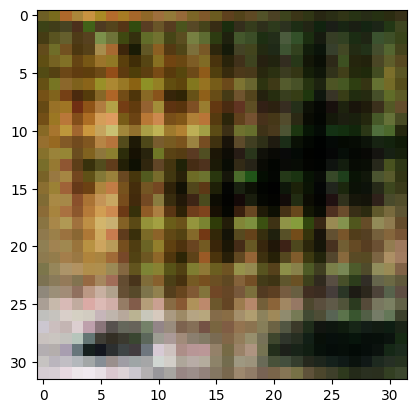

2/2 [==============================] - 0s 8ms/step
>3, 227/390, d1=0.569, d2=0.493 g=1.624


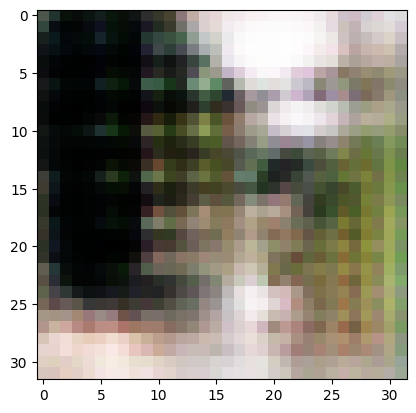

2/2 [==============================] - 0s 8ms/step
>3, 228/390, d1=0.528, d2=0.503 g=1.382


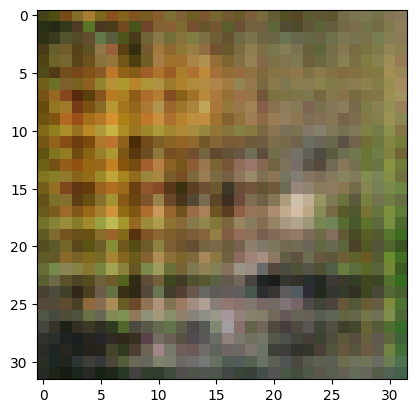

2/2 [==============================] - 0s 7ms/step
>3, 229/390, d1=0.573, d2=0.678 g=1.183


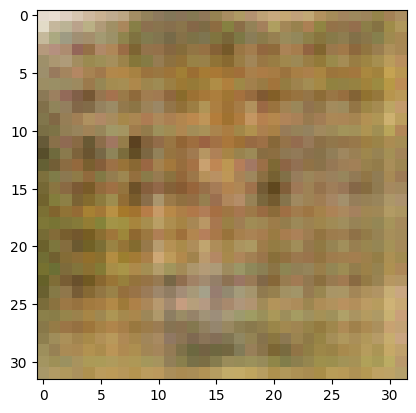

2/2 [==============================] - 0s 8ms/step
>3, 230/390, d1=0.566, d2=0.873 g=1.048


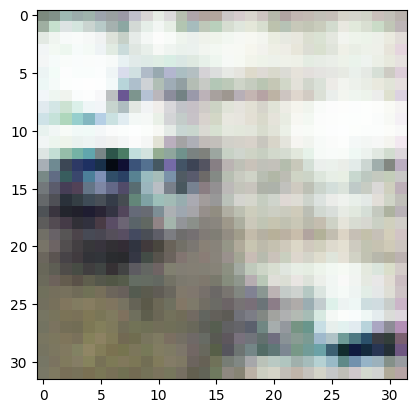

2/2 [==============================] - 0s 7ms/step
>3, 231/390, d1=0.606, d2=0.690 g=1.041


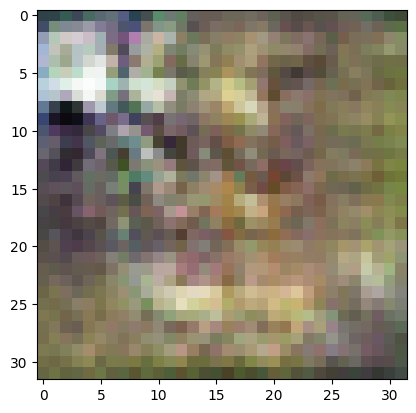

2/2 [==============================] - 0s 7ms/step
>3, 232/390, d1=0.561, d2=0.659 g=1.094


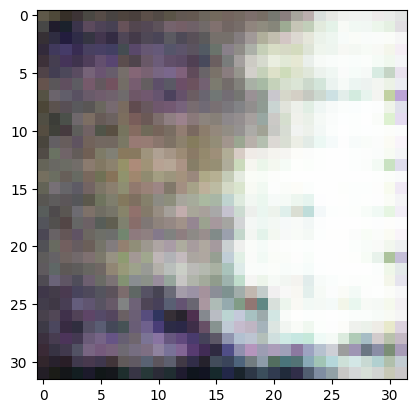

2/2 [==============================] - 0s 7ms/step
>3, 233/390, d1=0.485, d2=0.612 g=1.112


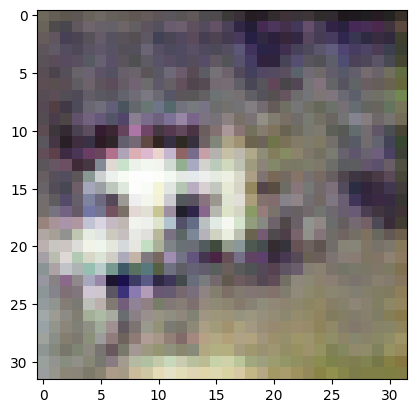

2/2 [==============================] - 0s 7ms/step
>3, 234/390, d1=0.369, d2=0.589 g=1.275


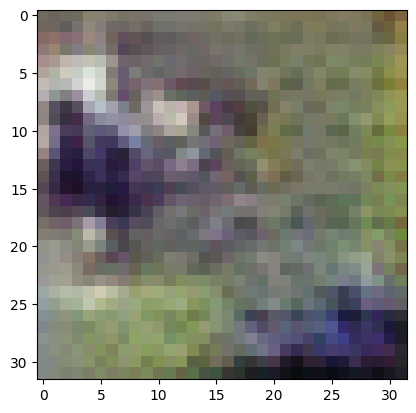

2/2 [==============================] - 0s 8ms/step
>3, 235/390, d1=0.359, d2=0.723 g=1.595


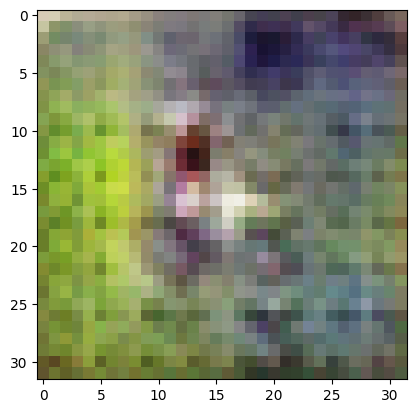

2/2 [==============================] - 0s 7ms/step
>3, 236/390, d1=0.538, d2=0.634 g=1.879


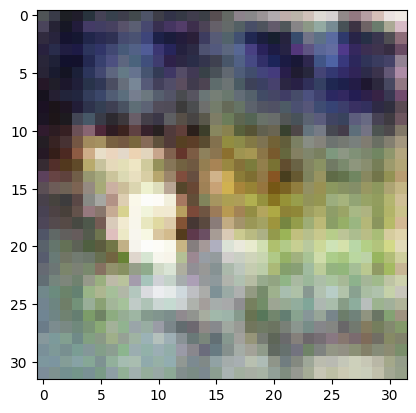

2/2 [==============================] - 0s 7ms/step
>3, 237/390, d1=0.746, d2=0.783 g=1.949


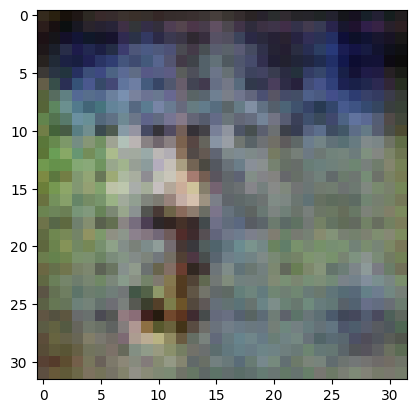

2/2 [==============================] - 0s 7ms/step
>3, 238/390, d1=0.715, d2=1.108 g=2.251


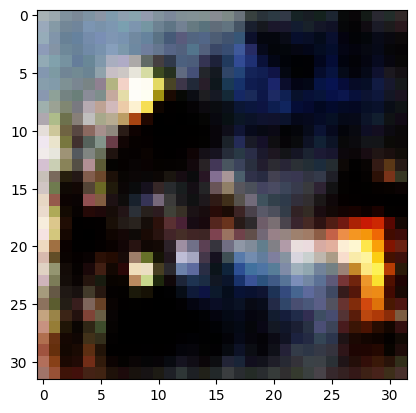

2/2 [==============================] - 0s 8ms/step
>3, 239/390, d1=1.174, d2=0.470 g=1.483


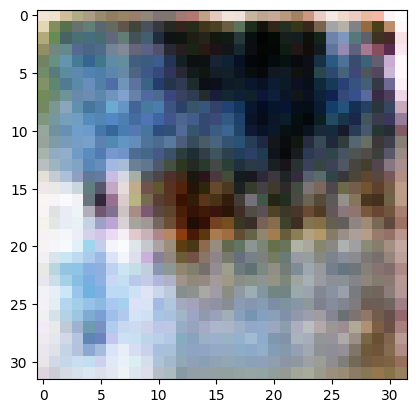

2/2 [==============================] - 0s 9ms/step
>3, 240/390, d1=0.971, d2=0.553 g=1.298


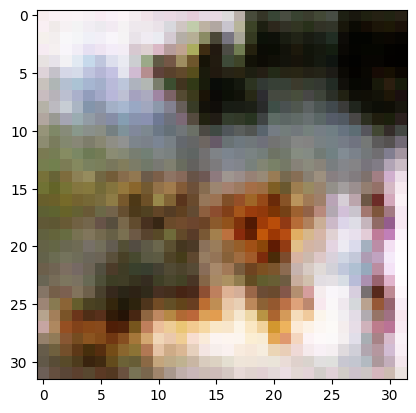

2/2 [==============================] - 0s 8ms/step
>3, 241/390, d1=0.747, d2=0.506 g=1.349


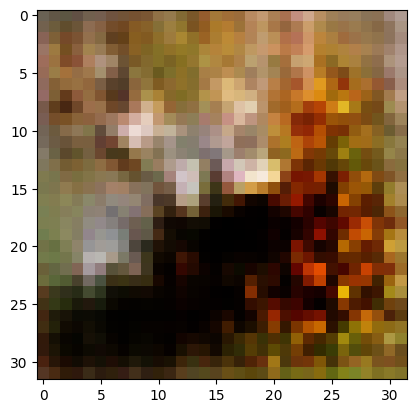

2/2 [==============================] - 0s 8ms/step
>3, 242/390, d1=0.712, d2=0.539 g=1.451


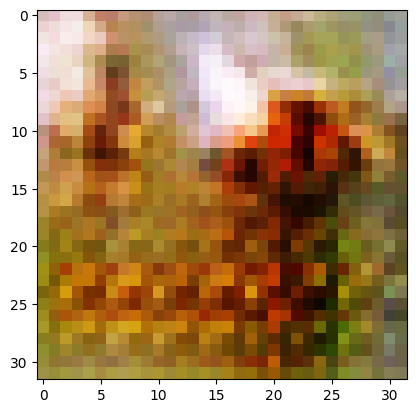

2/2 [==============================] - 0s 6ms/step
>3, 243/390, d1=0.858, d2=0.493 g=1.521


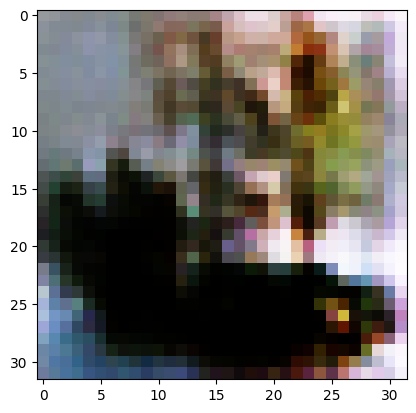

2/2 [==============================] - 0s 12ms/step
>3, 244/390, d1=0.762, d2=0.553 g=1.354


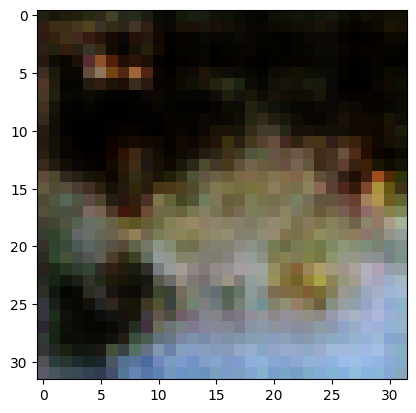

2/2 [==============================] - 0s 8ms/step
>3, 245/390, d1=0.606, d2=0.521 g=1.366


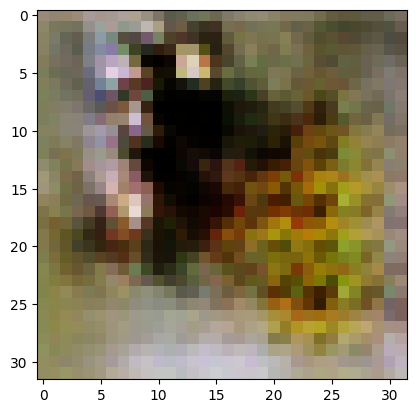

2/2 [==============================] - 0s 11ms/step
>3, 246/390, d1=0.615, d2=0.546 g=1.351


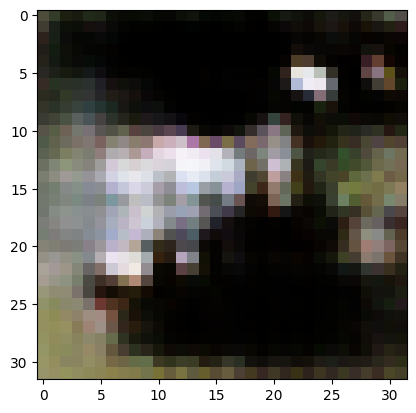

2/2 [==============================] - 0s 6ms/step
>3, 247/390, d1=0.655, d2=0.527 g=1.346


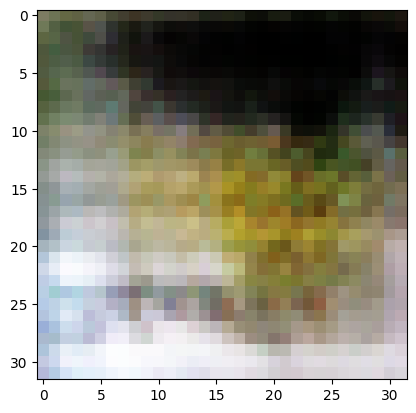

2/2 [==============================] - 0s 7ms/step
>3, 248/390, d1=0.666, d2=0.463 g=1.268


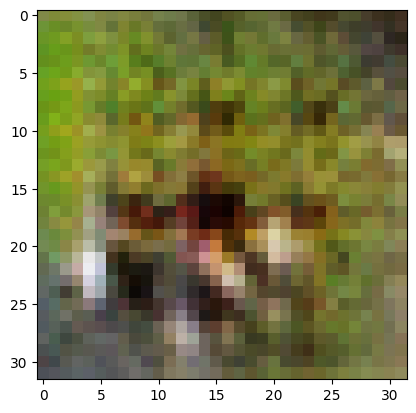

2/2 [==============================] - 0s 7ms/step
>3, 249/390, d1=0.608, d2=0.561 g=1.147


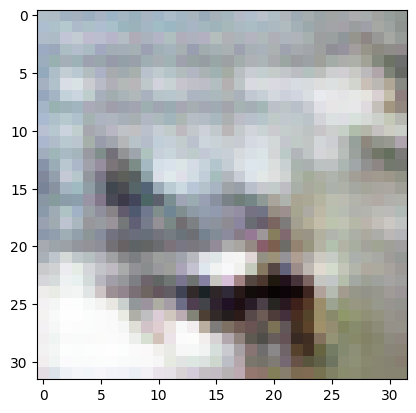

2/2 [==============================] - 0s 7ms/step
>3, 250/390, d1=0.679, d2=0.605 g=1.131


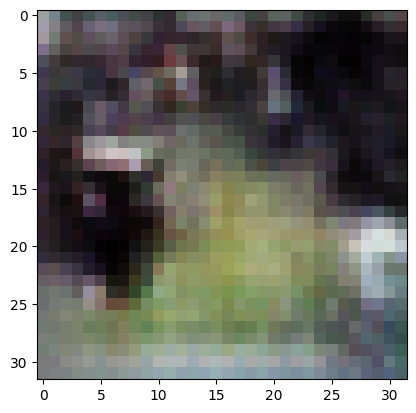

2/2 [==============================] - 0s 8ms/step
>3, 251/390, d1=0.627, d2=0.660 g=1.047


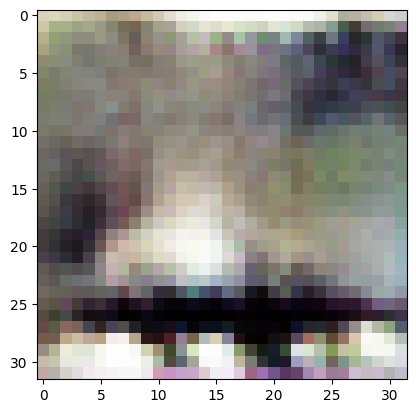

2/2 [==============================] - 0s 8ms/step
>3, 252/390, d1=0.535, d2=0.664 g=1.105


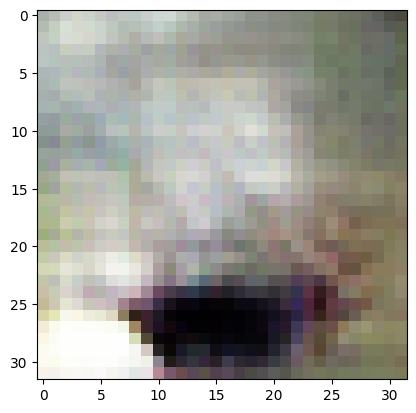

2/2 [==============================] - 0s 9ms/step
>3, 253/390, d1=0.548, d2=0.592 g=1.161


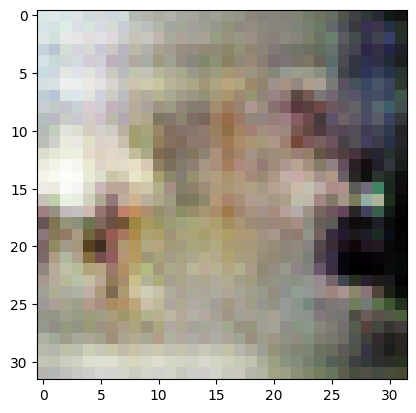

2/2 [==============================] - 0s 7ms/step
>3, 254/390, d1=0.509, d2=0.537 g=1.288


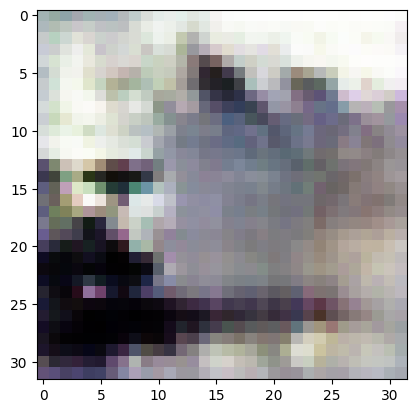

2/2 [==============================] - 0s 7ms/step
>3, 255/390, d1=0.506, d2=0.514 g=1.444


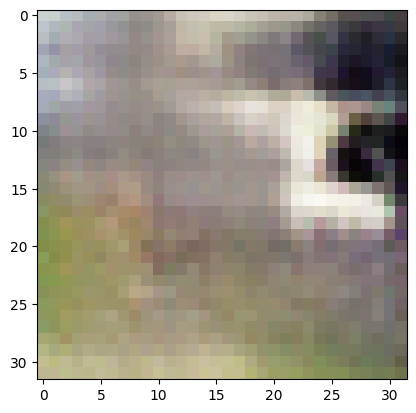

2/2 [==============================] - 0s 8ms/step
>3, 256/390, d1=0.591, d2=0.549 g=1.298


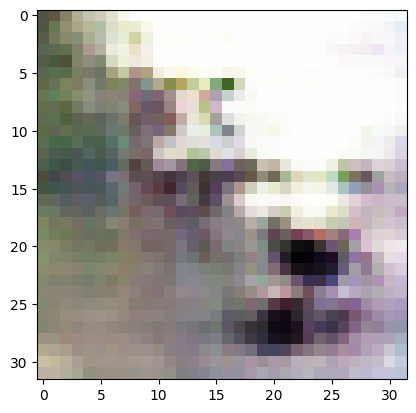

2/2 [==============================] - 0s 7ms/step
>3, 257/390, d1=0.612, d2=0.791 g=1.217


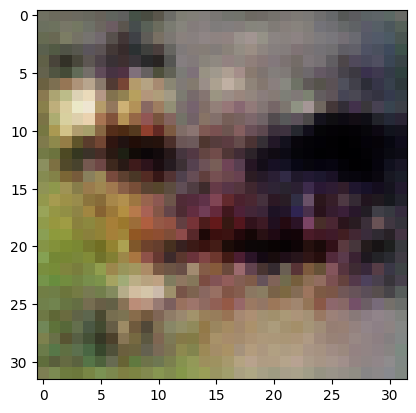

2/2 [==============================] - 0s 5ms/step
>3, 258/390, d1=0.554, d2=0.689 g=1.384


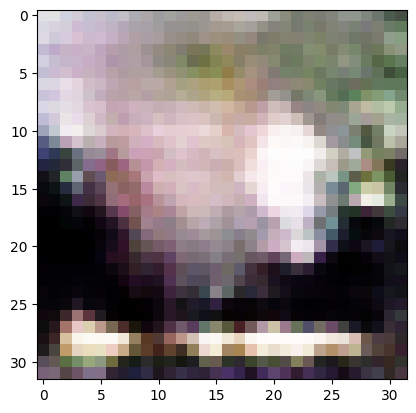

2/2 [==============================] - 0s 8ms/step
>3, 259/390, d1=0.680, d2=0.617 g=1.378


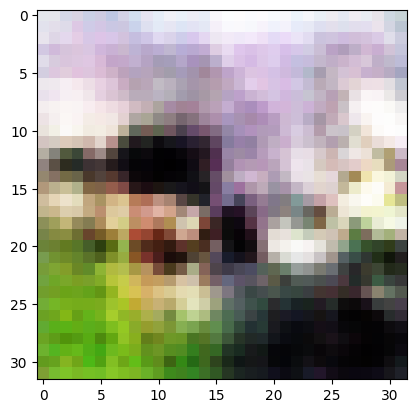

2/2 [==============================] - 0s 8ms/step
>3, 260/390, d1=0.742, d2=0.574 g=1.571


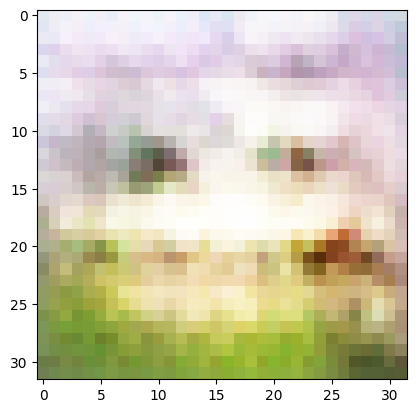

2/2 [==============================] - 0s 6ms/step
>3, 261/390, d1=0.626, d2=0.508 g=1.449


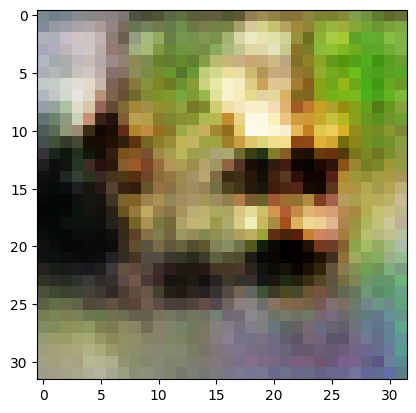

2/2 [==============================] - 0s 7ms/step
>3, 262/390, d1=0.717, d2=0.629 g=1.427


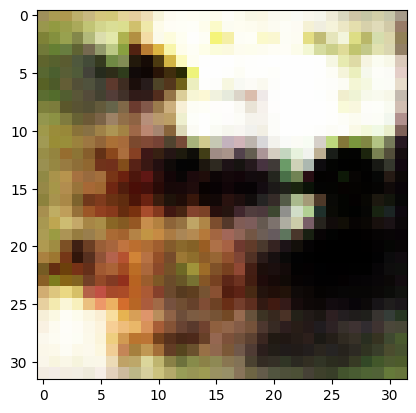

2/2 [==============================] - 0s 8ms/step
>3, 263/390, d1=0.697, d2=1.007 g=1.288


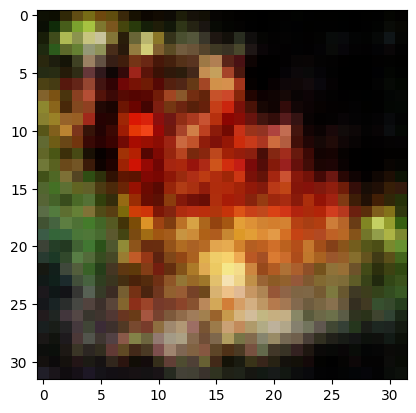

2/2 [==============================] - 0s 6ms/step
>3, 264/390, d1=0.753, d2=0.654 g=1.578


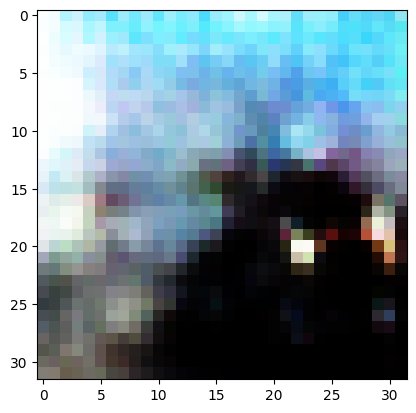

2/2 [==============================] - 0s 5ms/step
>3, 265/390, d1=0.748, d2=0.432 g=1.693


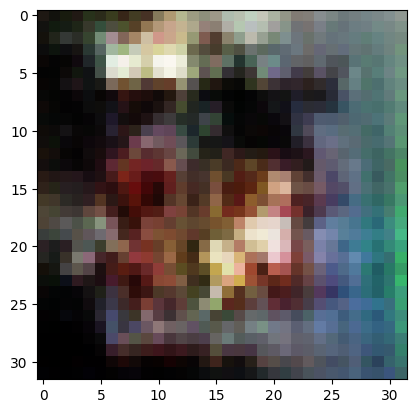

2/2 [==============================] - 0s 7ms/step
>3, 266/390, d1=0.944, d2=0.776 g=1.280


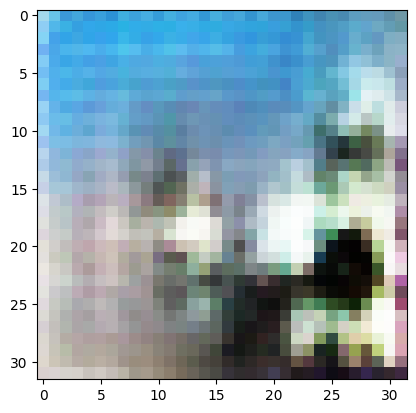

2/2 [==============================] - 0s 10ms/step
>3, 267/390, d1=0.718, d2=0.708 g=1.086


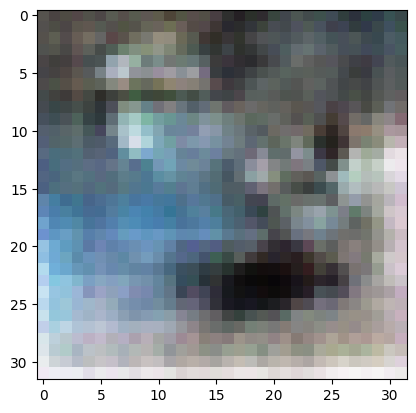

2/2 [==============================] - 0s 7ms/step
>3, 268/390, d1=0.771, d2=0.731 g=1.012


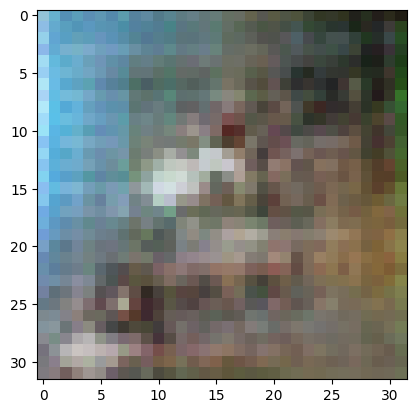

2/2 [==============================] - 0s 13ms/step
>3, 269/390, d1=0.686, d2=0.688 g=1.010


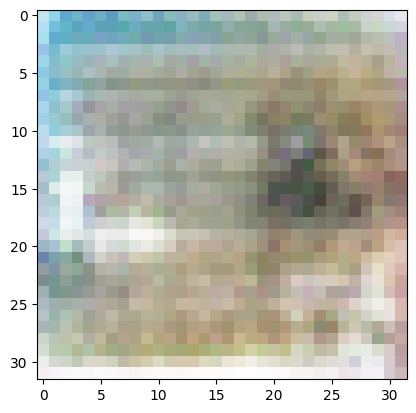

2/2 [==============================] - 0s 9ms/step
>3, 270/390, d1=0.624, d2=0.620 g=1.062


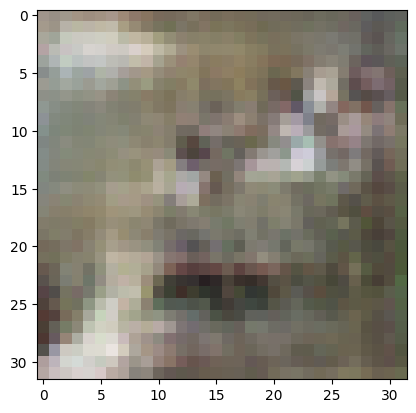

2/2 [==============================] - 0s 9ms/step
>3, 271/390, d1=0.645, d2=0.671 g=1.148


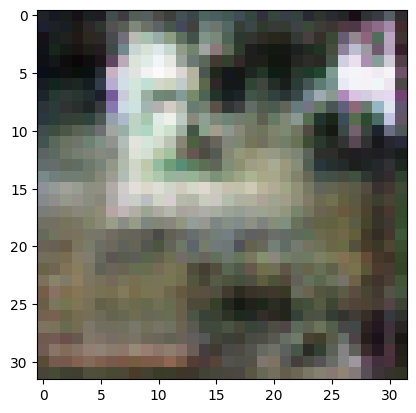

2/2 [==============================] - 0s 8ms/step
>3, 272/390, d1=0.691, d2=0.666 g=1.229


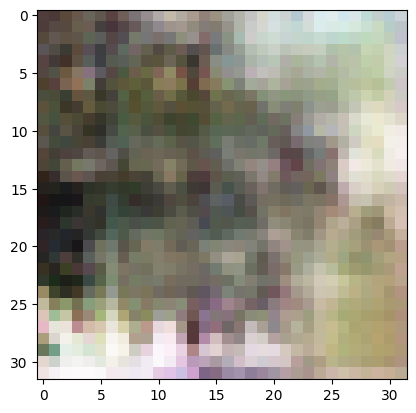

2/2 [==============================] - 0s 9ms/step
>3, 273/390, d1=0.553, d2=0.658 g=1.249


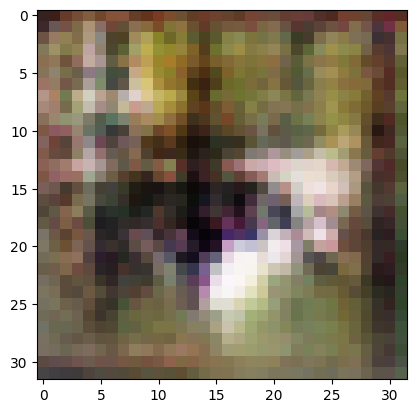

2/2 [==============================] - 0s 8ms/step
>3, 274/390, d1=0.571, d2=0.505 g=1.361


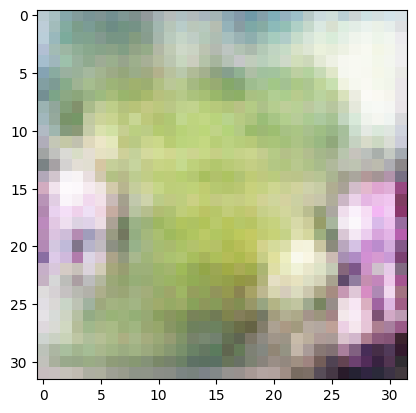

2/2 [==============================] - 0s 8ms/step
>3, 275/390, d1=0.590, d2=0.626 g=1.386


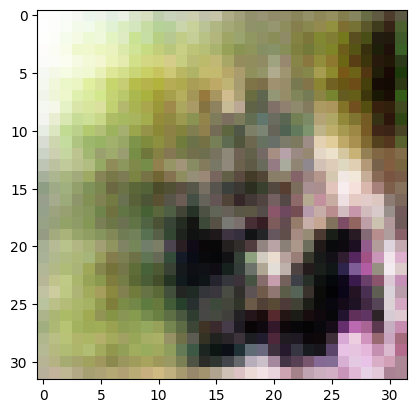

2/2 [==============================] - 0s 8ms/step
>3, 276/390, d1=0.747, d2=0.582 g=1.224


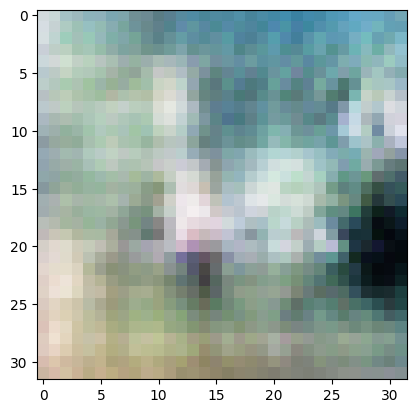

2/2 [==============================] - 0s 8ms/step
>3, 277/390, d1=0.563, d2=0.563 g=1.345


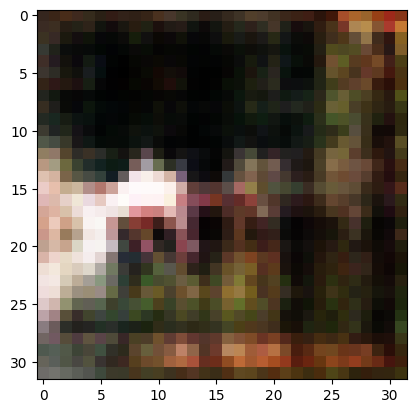

2/2 [==============================] - 0s 7ms/step
>3, 278/390, d1=0.554, d2=0.461 g=1.496


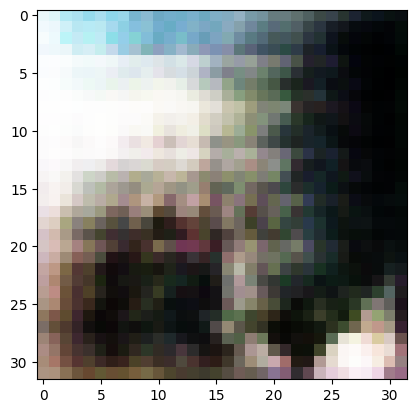

2/2 [==============================] - 0s 7ms/step
>3, 279/390, d1=0.589, d2=0.470 g=1.598


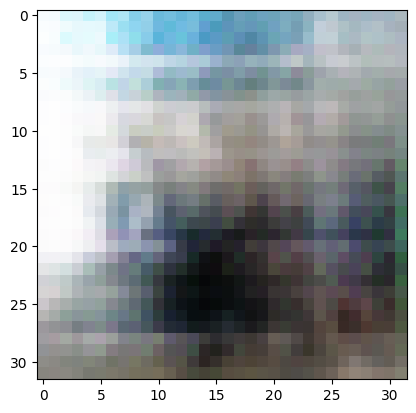

2/2 [==============================] - 0s 6ms/step
>3, 280/390, d1=0.412, d2=0.396 g=1.638


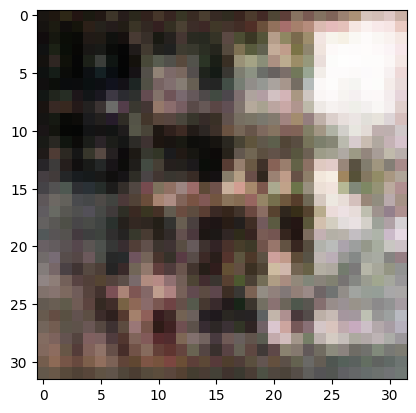

2/2 [==============================] - 0s 7ms/step
>3, 281/390, d1=0.412, d2=0.889 g=1.811


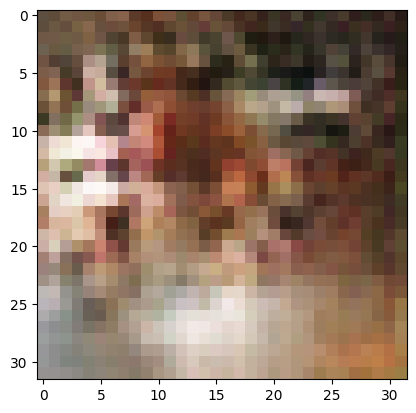

2/2 [==============================] - 0s 7ms/step
>3, 282/390, d1=0.758, d2=1.206 g=1.470


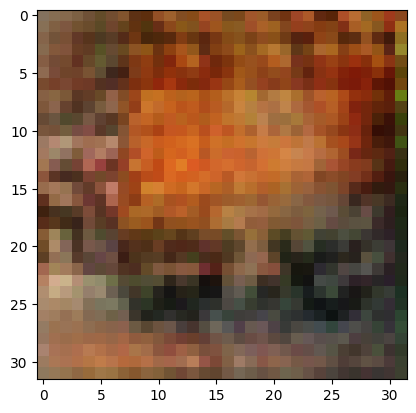

2/2 [==============================] - 0s 7ms/step
>3, 283/390, d1=0.832, d2=0.684 g=1.078


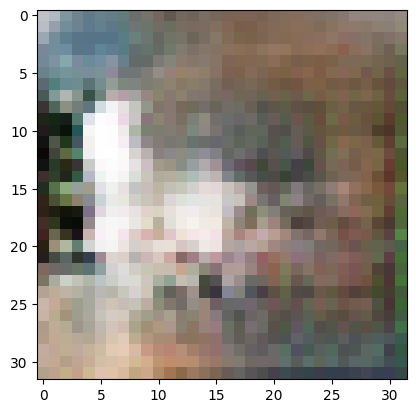

2/2 [==============================] - 0s 7ms/step
>3, 284/390, d1=0.957, d2=0.809 g=0.892


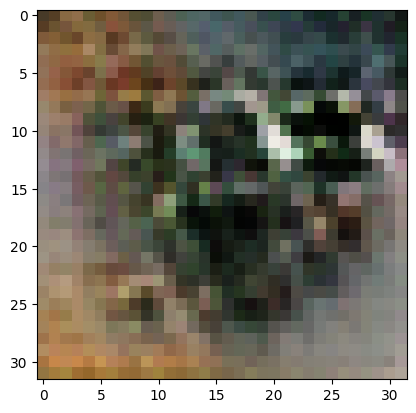

2/2 [==============================] - 0s 8ms/step
>3, 285/390, d1=0.611, d2=0.729 g=0.937


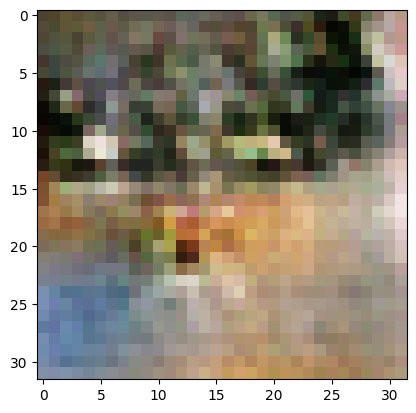

2/2 [==============================] - 0s 8ms/step
>3, 286/390, d1=0.573, d2=0.665 g=1.067


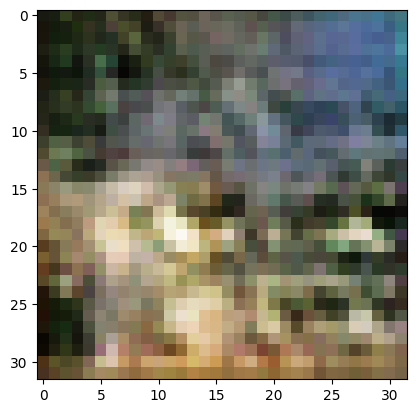

2/2 [==============================] - 0s 8ms/step
>3, 287/390, d1=0.582, d2=0.743 g=1.019


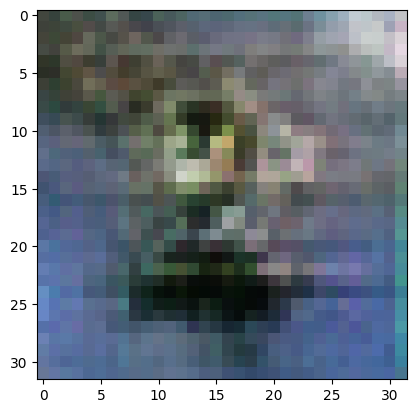

2/2 [==============================] - 0s 11ms/step
>3, 288/390, d1=0.477, d2=0.829 g=1.157


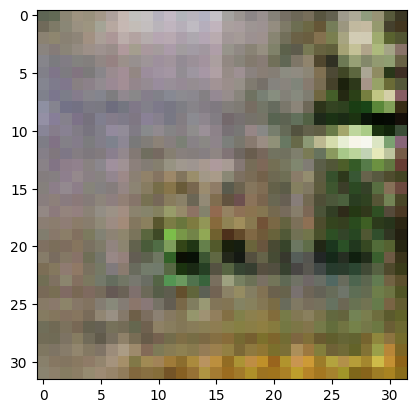

2/2 [==============================] - 0s 8ms/step
>3, 289/390, d1=0.668, d2=0.726 g=1.202


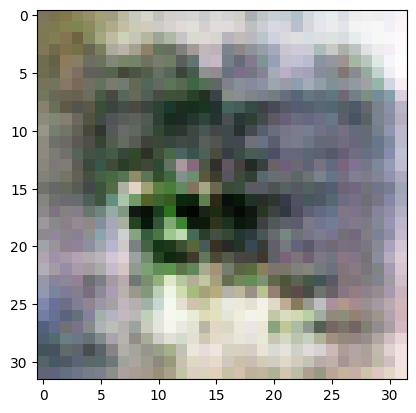

2/2 [==============================] - 0s 8ms/step
>3, 290/390, d1=0.718, d2=0.631 g=1.202


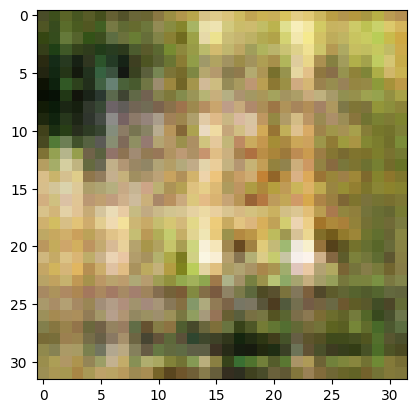

2/2 [==============================] - 0s 8ms/step
>3, 291/390, d1=0.726, d2=0.649 g=1.331


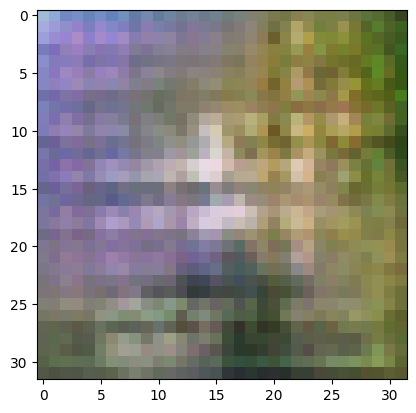

2/2 [==============================] - 0s 6ms/step
>3, 292/390, d1=0.782, d2=0.469 g=1.403


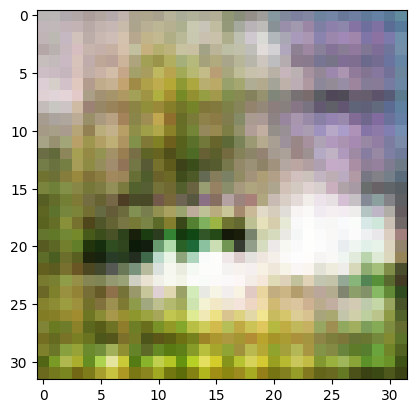

2/2 [==============================] - 0s 7ms/step
>3, 293/390, d1=0.617, d2=0.593 g=1.501


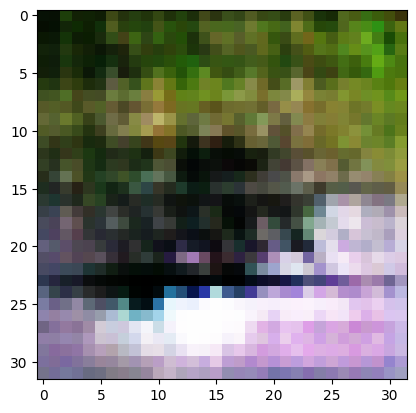

2/2 [==============================] - 0s 7ms/step
>3, 294/390, d1=0.672, d2=0.621 g=1.623


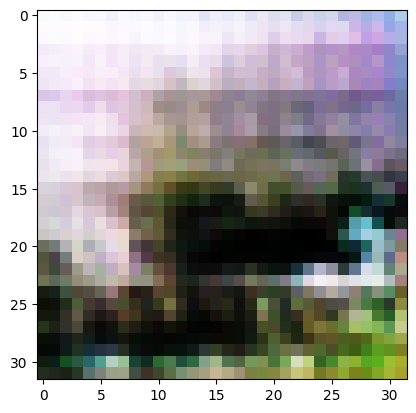

2/2 [==============================] - 0s 7ms/step
>3, 295/390, d1=0.750, d2=0.500 g=1.234


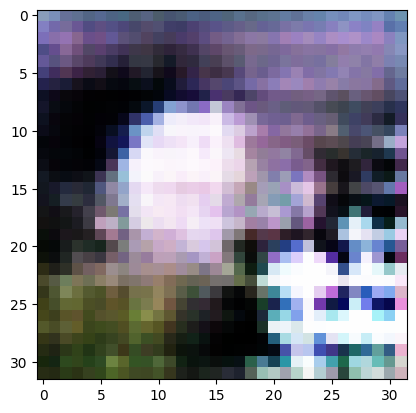

2/2 [==============================] - 0s 7ms/step
>3, 296/390, d1=0.722, d2=0.637 g=1.214


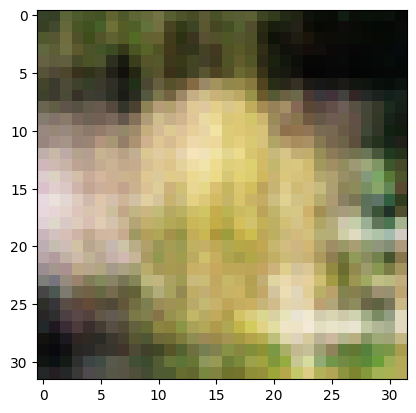

2/2 [==============================] - 0s 5ms/step
>3, 297/390, d1=0.636, d2=0.624 g=1.240


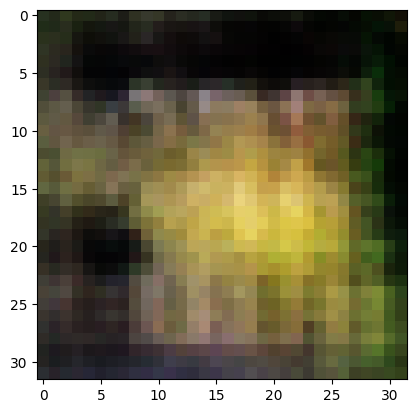

2/2 [==============================] - 0s 8ms/step
>3, 298/390, d1=0.696, d2=0.593 g=1.238


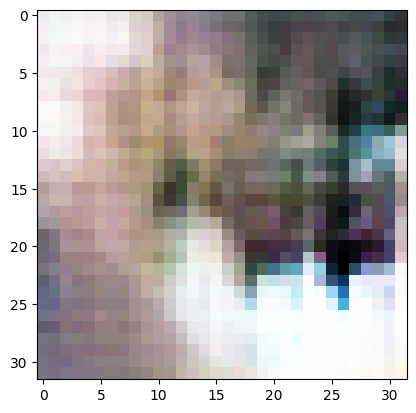

2/2 [==============================] - 0s 7ms/step
>3, 299/390, d1=0.619, d2=0.552 g=1.341


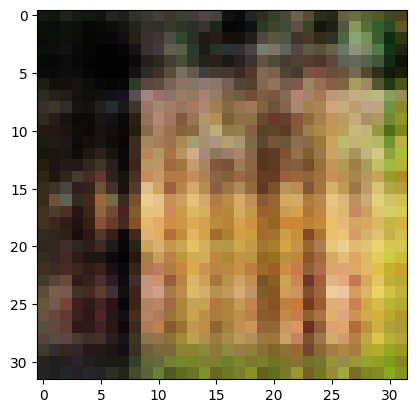

2/2 [==============================] - 0s 8ms/step
>3, 300/390, d1=0.642, d2=0.542 g=1.338


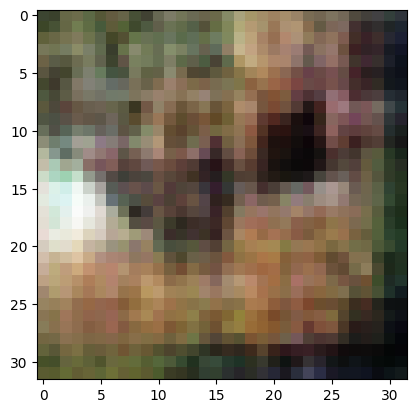

2/2 [==============================] - 0s 7ms/step
>3, 301/390, d1=0.558, d2=0.688 g=1.411


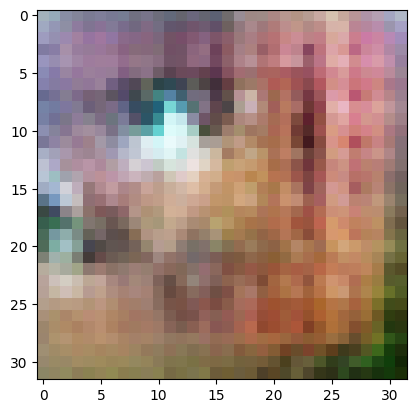

2/2 [==============================] - 0s 9ms/step
>3, 302/390, d1=0.593, d2=0.575 g=1.477


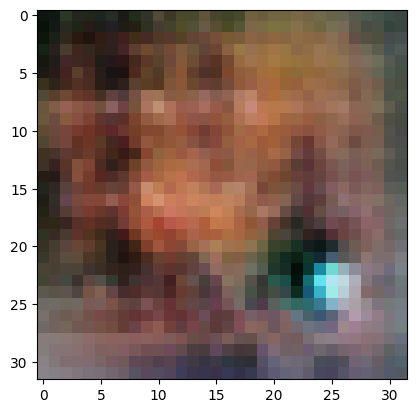

2/2 [==============================] - 0s 8ms/step
>3, 303/390, d1=0.546, d2=0.619 g=1.395


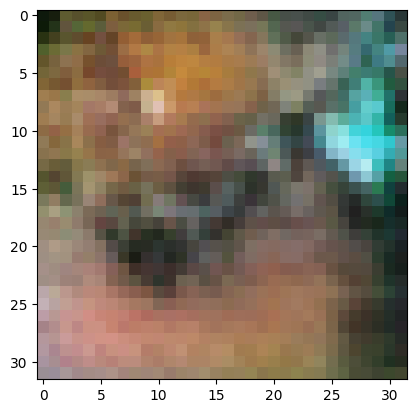

2/2 [==============================] - 0s 8ms/step
>3, 304/390, d1=0.585, d2=0.820 g=1.149


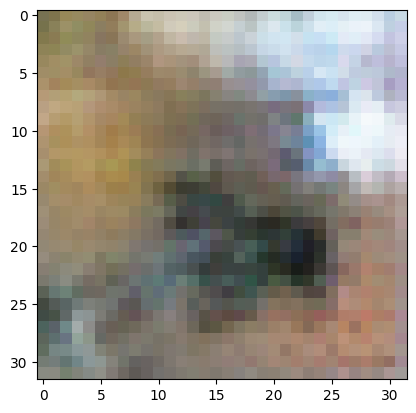

2/2 [==============================] - 0s 7ms/step
>3, 305/390, d1=0.632, d2=0.743 g=1.058


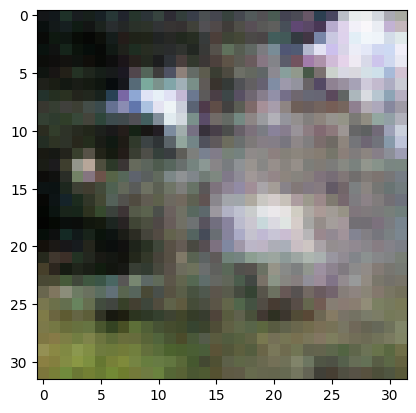

2/2 [==============================] - 0s 8ms/step
>3, 306/390, d1=0.684, d2=0.662 g=1.110


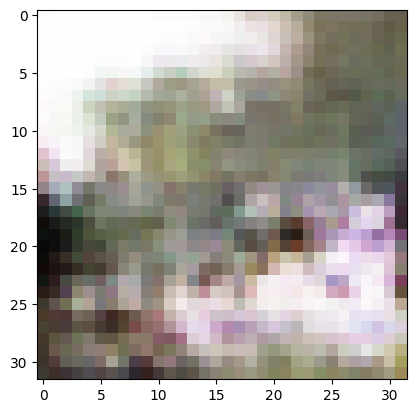

2/2 [==============================] - 0s 9ms/step
>3, 307/390, d1=0.611, d2=0.674 g=1.277


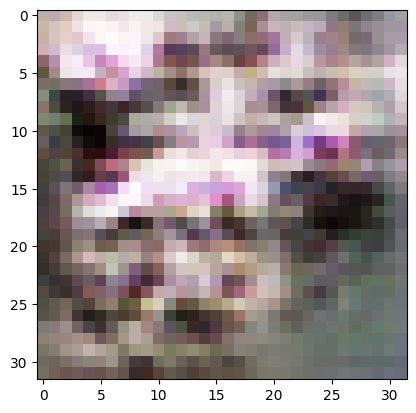

2/2 [==============================] - 0s 8ms/step
>3, 308/390, d1=0.680, d2=0.446 g=1.396


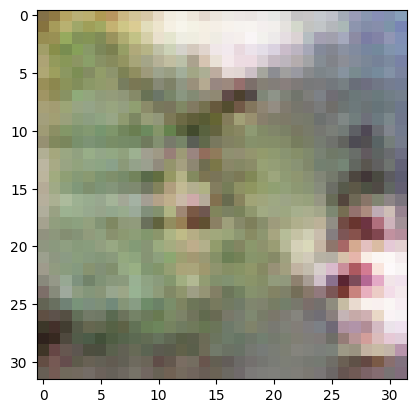

2/2 [==============================] - 0s 11ms/step
>3, 309/390, d1=0.610, d2=0.558 g=1.420


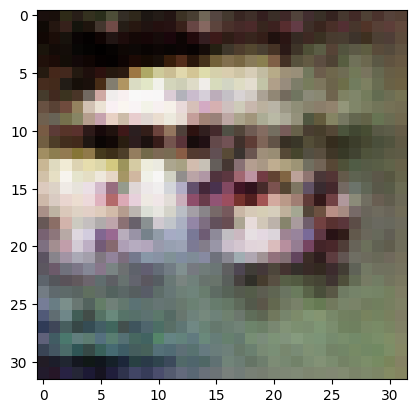

2/2 [==============================] - 0s 9ms/step
>3, 310/390, d1=0.576, d2=0.485 g=1.457


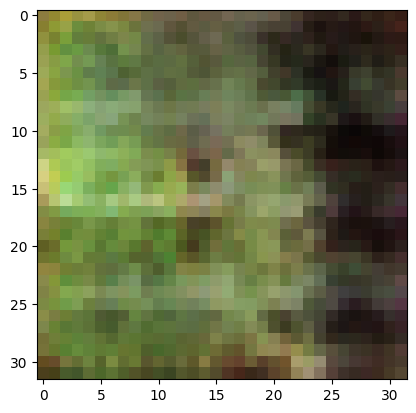

2/2 [==============================] - 0s 9ms/step
>3, 311/390, d1=0.518, d2=0.592 g=1.364


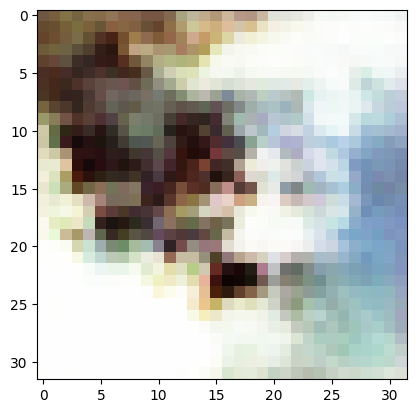

2/2 [==============================] - 0s 6ms/step
>3, 312/390, d1=0.493, d2=0.727 g=1.318


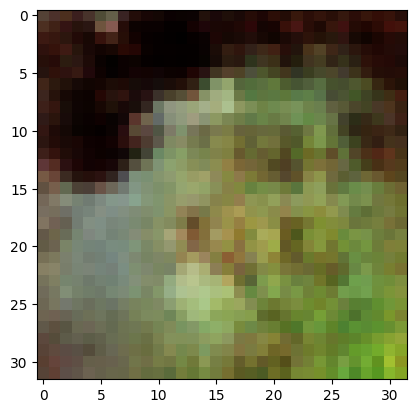

2/2 [==============================] - 0s 7ms/step
>3, 313/390, d1=0.689, d2=0.617 g=1.368


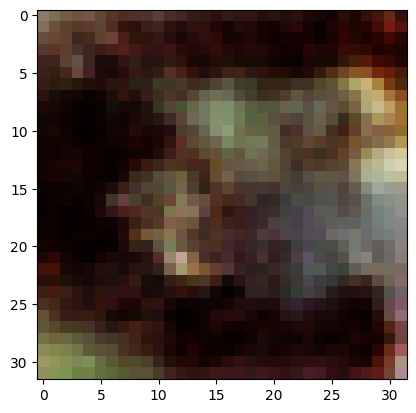

2/2 [==============================] - 0s 7ms/step
>3, 314/390, d1=0.671, d2=0.668 g=1.457


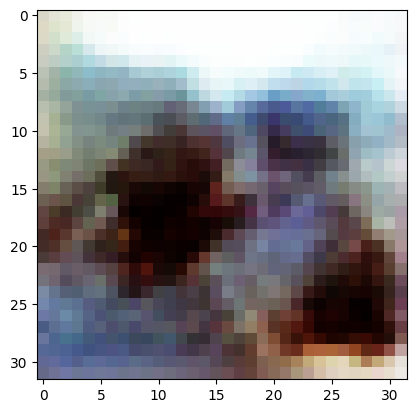

2/2 [==============================] - 0s 11ms/step
>3, 315/390, d1=0.629, d2=0.573 g=1.482


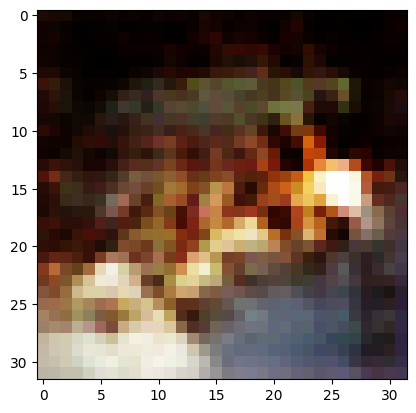

2/2 [==============================] - 0s 7ms/step
>3, 316/390, d1=0.701, d2=0.560 g=1.304


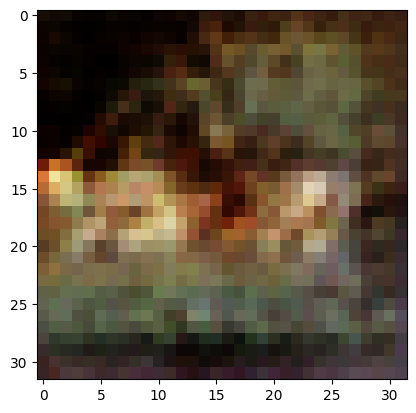

2/2 [==============================] - 0s 7ms/step
>3, 317/390, d1=0.509, d2=0.696 g=1.421


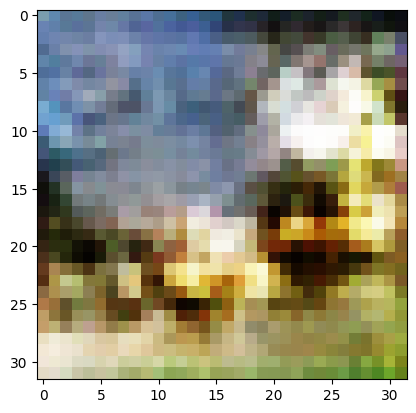

2/2 [==============================] - 0s 5ms/step
>3, 318/390, d1=0.661, d2=0.630 g=1.491


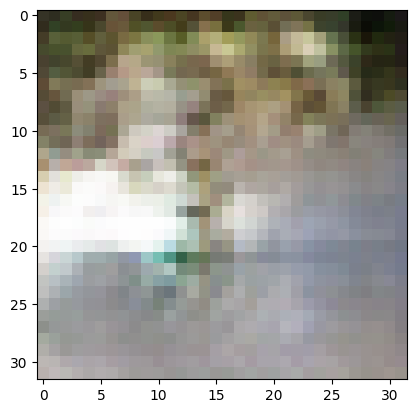

2/2 [==============================] - 0s 7ms/step
>3, 319/390, d1=0.638, d2=0.591 g=1.471


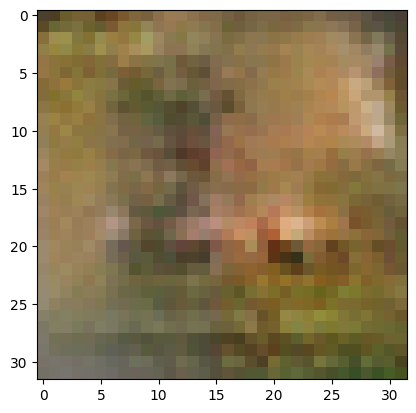

2/2 [==============================] - 0s 7ms/step
>3, 320/390, d1=0.599, d2=0.533 g=1.405


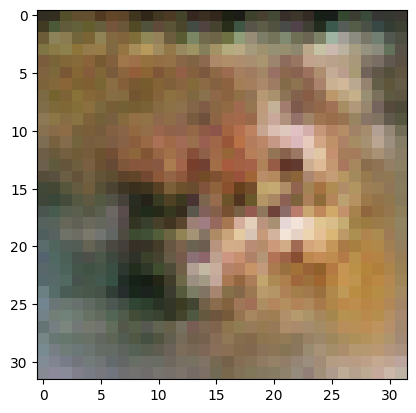

2/2 [==============================] - 0s 7ms/step
>3, 321/390, d1=0.636, d2=0.617 g=1.374


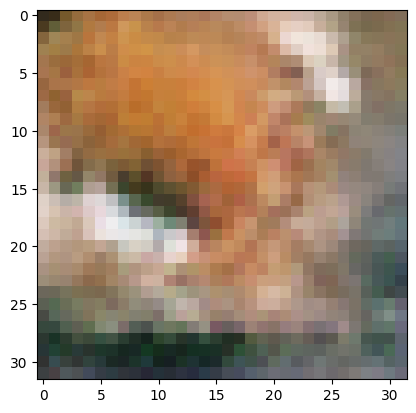

2/2 [==============================] - 0s 8ms/step
>3, 322/390, d1=0.585, d2=0.679 g=1.326


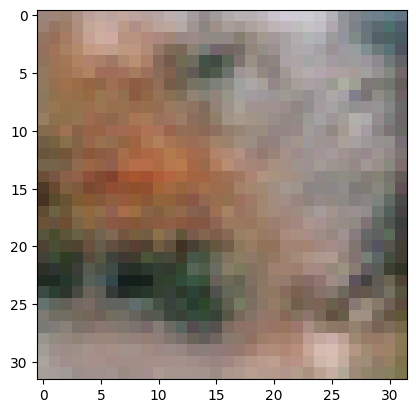

2/2 [==============================] - 0s 7ms/step
>3, 323/390, d1=0.549, d2=0.597 g=1.309


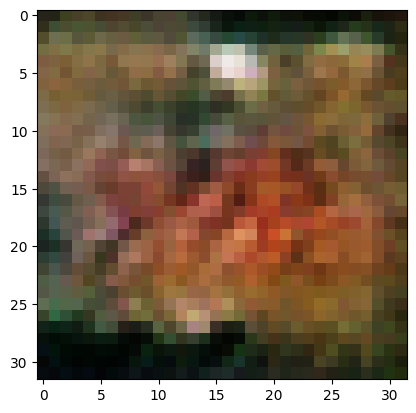

2/2 [==============================] - 0s 6ms/step
>3, 324/390, d1=0.658, d2=0.584 g=1.226


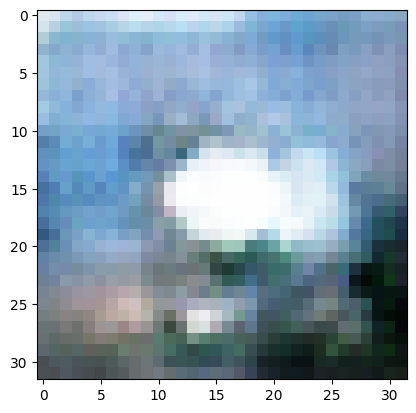

2/2 [==============================] - 0s 8ms/step
>3, 325/390, d1=0.666, d2=0.531 g=1.142


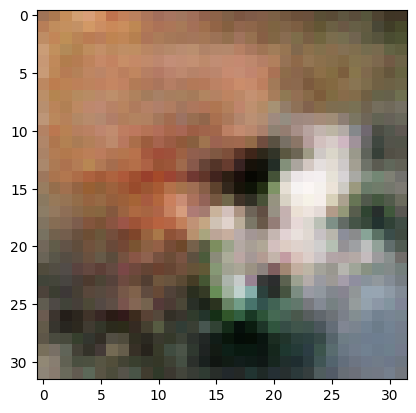

2/2 [==============================] - 0s 8ms/step
>3, 326/390, d1=0.594, d2=0.655 g=1.133


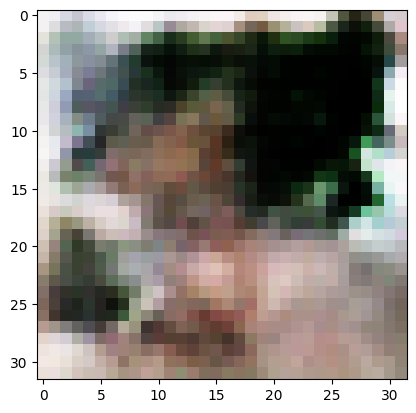

2/2 [==============================] - 0s 11ms/step
>3, 327/390, d1=0.561, d2=0.667 g=1.110


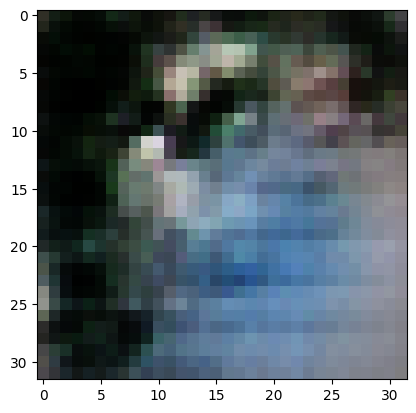

2/2 [==============================] - 0s 8ms/step
>3, 328/390, d1=0.543, d2=0.627 g=1.261


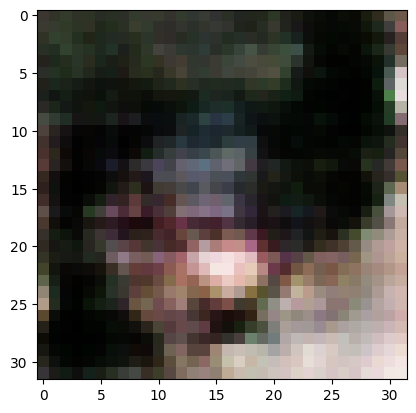

2/2 [==============================] - 0s 8ms/step
>3, 329/390, d1=0.549, d2=0.519 g=1.330


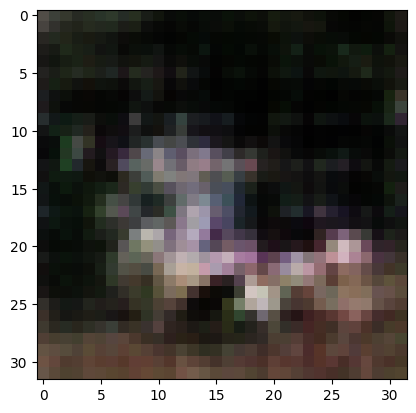

2/2 [==============================] - 0s 10ms/step
>3, 330/390, d1=0.645, d2=0.550 g=1.316


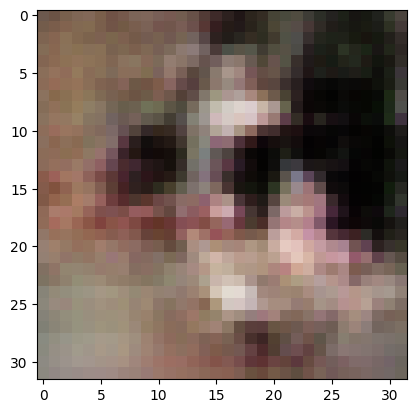

2/2 [==============================] - 0s 7ms/step
>3, 331/390, d1=0.476, d2=0.679 g=1.403


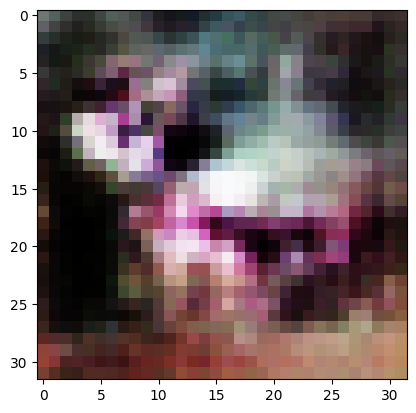

2/2 [==============================] - 0s 8ms/step
>3, 332/390, d1=0.655, d2=1.199 g=1.422


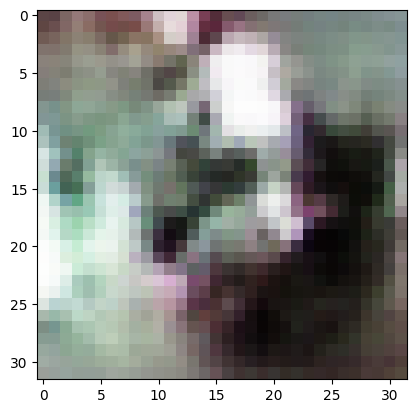

2/2 [==============================] - 0s 7ms/step
>3, 333/390, d1=0.863, d2=1.404 g=1.960


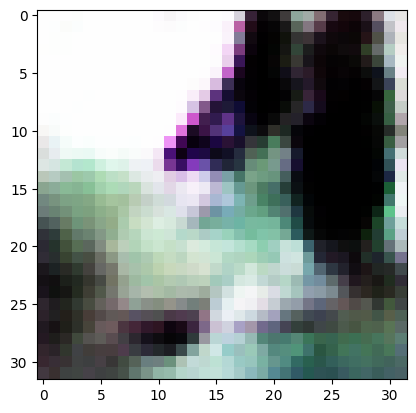

2/2 [==============================] - 0s 8ms/step
>3, 334/390, d1=0.970, d2=0.351 g=1.674


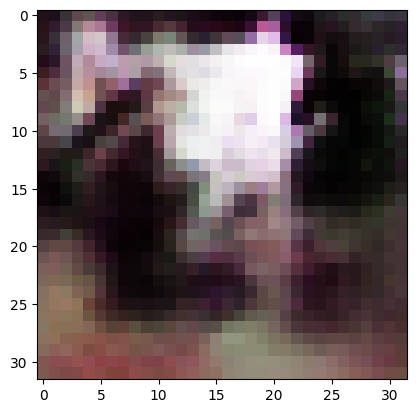

2/2 [==============================] - 0s 7ms/step
>3, 335/390, d1=0.752, d2=0.553 g=1.378


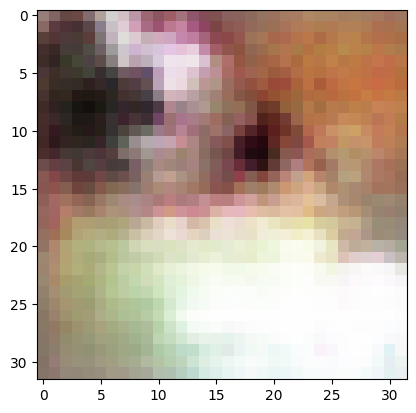

2/2 [==============================] - 0s 7ms/step
>3, 336/390, d1=0.813, d2=0.611 g=1.254


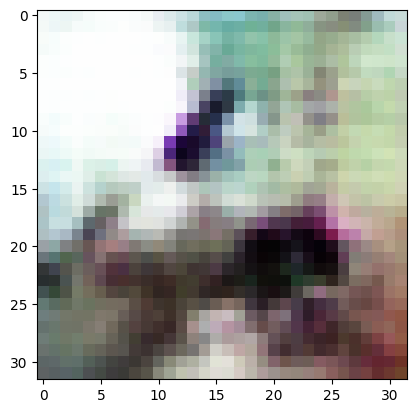

2/2 [==============================] - 0s 8ms/step
>3, 337/390, d1=0.839, d2=0.736 g=1.241


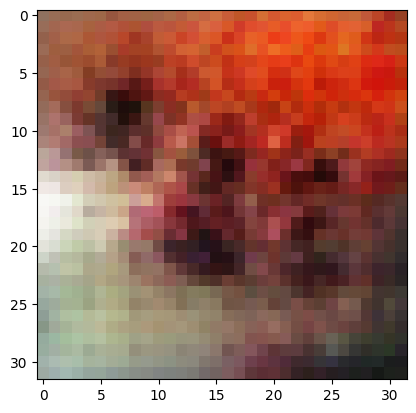

2/2 [==============================] - 0s 7ms/step
>3, 338/390, d1=0.763, d2=0.517 g=1.245


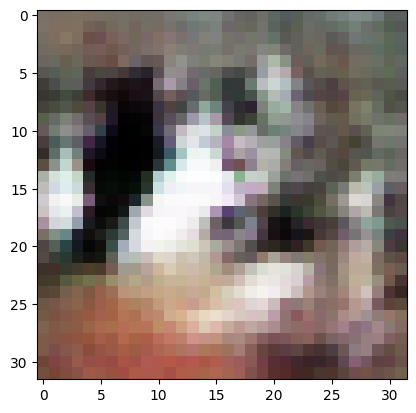

2/2 [==============================] - 0s 7ms/step
>3, 339/390, d1=0.703, d2=0.508 g=1.302


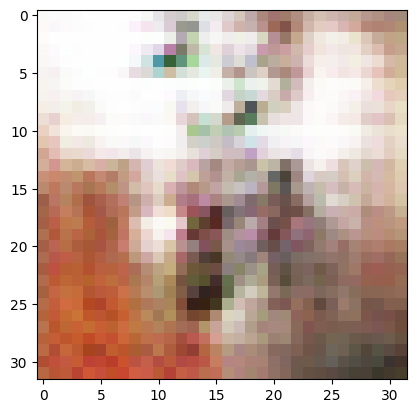

2/2 [==============================] - 0s 8ms/step
>3, 340/390, d1=0.736, d2=0.597 g=1.260


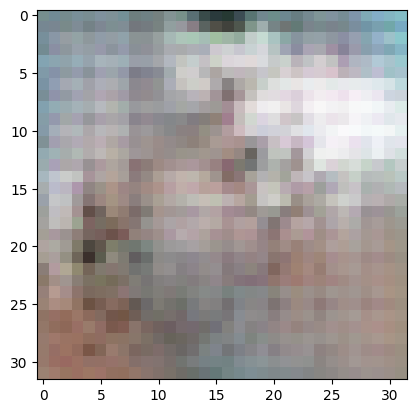

2/2 [==============================] - 0s 8ms/step
>3, 341/390, d1=0.696, d2=0.578 g=1.191


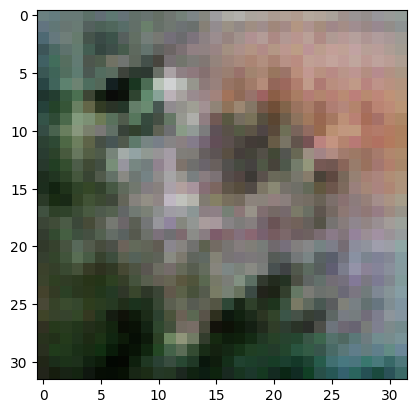

2/2 [==============================] - 0s 6ms/step
>3, 342/390, d1=0.612, d2=0.546 g=1.060


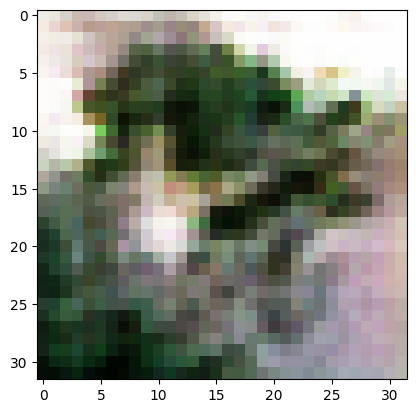

2/2 [==============================] - 0s 7ms/step
>3, 343/390, d1=0.615, d2=0.734 g=1.126


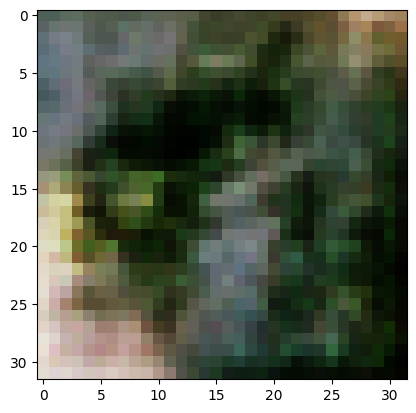

2/2 [==============================] - 0s 8ms/step
>3, 344/390, d1=0.588, d2=0.661 g=1.281


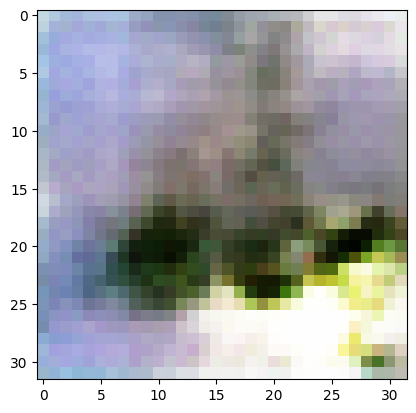

2/2 [==============================] - 0s 6ms/step
>3, 345/390, d1=0.539, d2=0.593 g=1.228


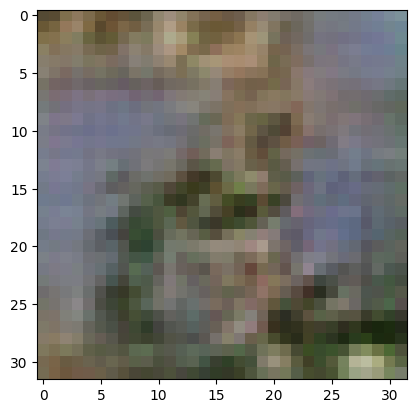

2/2 [==============================] - 0s 8ms/step
>3, 346/390, d1=0.625, d2=0.700 g=1.176


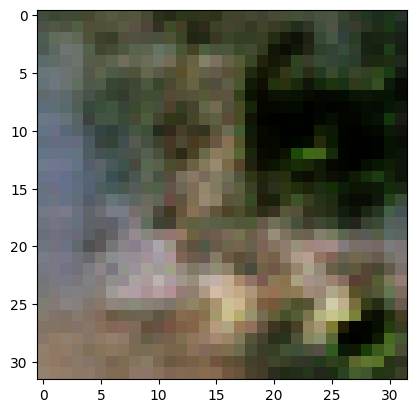

2/2 [==============================] - 0s 7ms/step
>3, 347/390, d1=0.570, d2=0.670 g=1.172


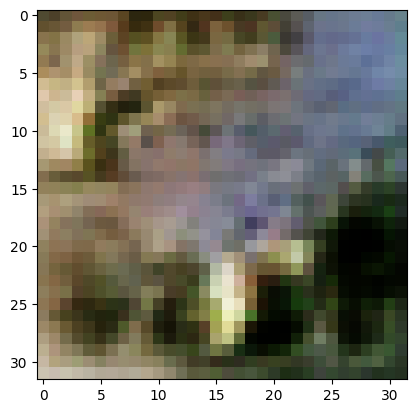

2/2 [==============================] - 0s 7ms/step
>3, 348/390, d1=0.628, d2=0.771 g=1.236


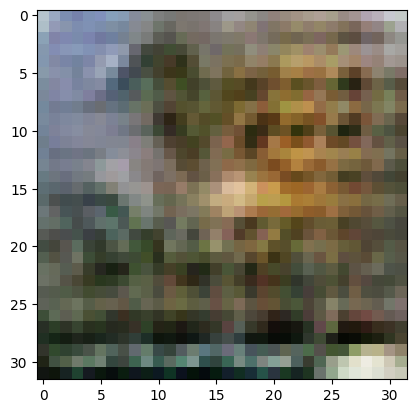

2/2 [==============================] - 0s 7ms/step
>3, 349/390, d1=0.595, d2=0.612 g=1.458


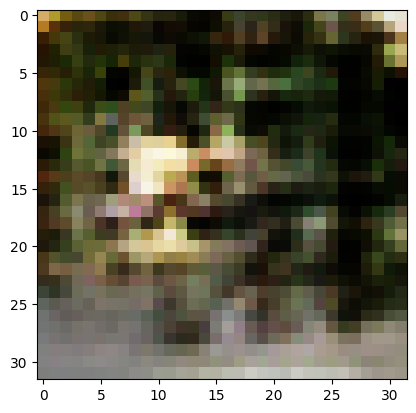

2/2 [==============================] - 0s 8ms/step
>3, 350/390, d1=0.753, d2=0.537 g=1.484


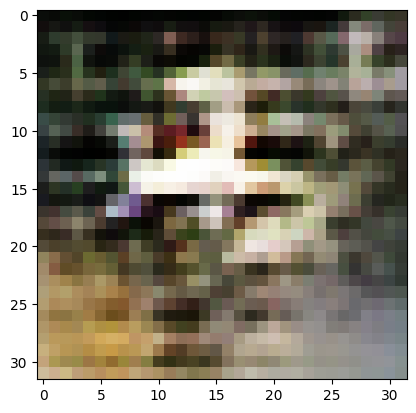

2/2 [==============================] - 0s 8ms/step
>3, 351/390, d1=0.570, d2=0.568 g=1.542


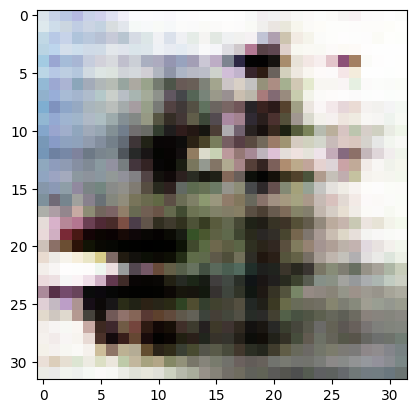

2/2 [==============================] - 0s 7ms/step
>3, 352/390, d1=0.542, d2=0.642 g=1.603


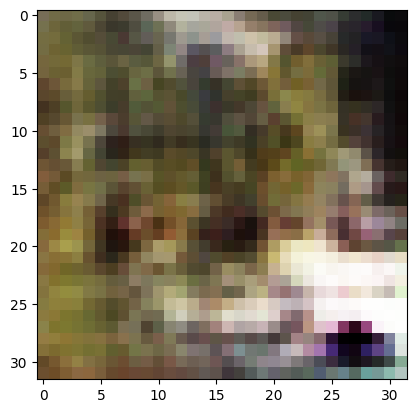

2/2 [==============================] - 0s 7ms/step
>3, 353/390, d1=0.619, d2=1.408 g=1.667


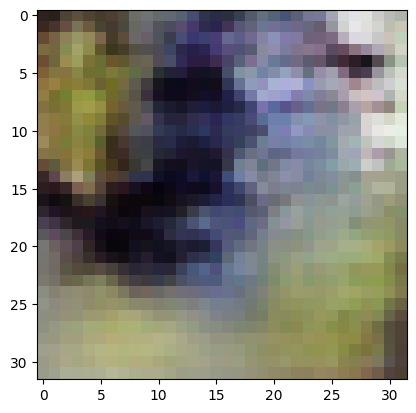

2/2 [==============================] - 0s 7ms/step
>3, 354/390, d1=1.149, d2=1.068 g=1.461


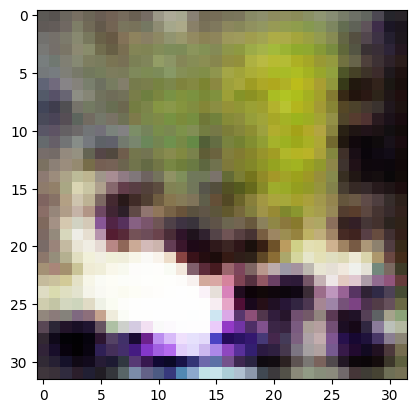

2/2 [==============================] - 0s 7ms/step
>3, 355/390, d1=0.851, d2=0.455 g=1.361


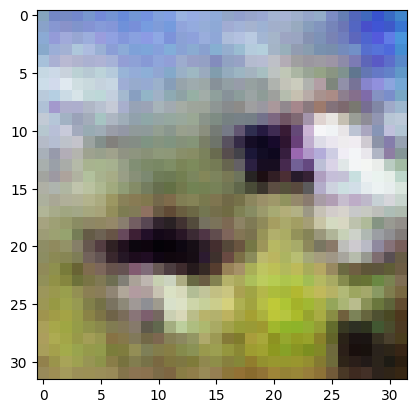

2/2 [==============================] - 0s 8ms/step
>3, 356/390, d1=0.792, d2=0.589 g=1.302


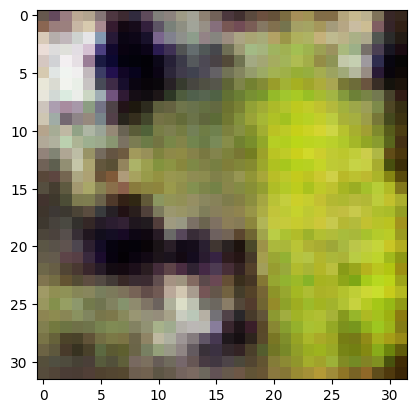

2/2 [==============================] - 0s 7ms/step
>3, 357/390, d1=0.755, d2=0.638 g=1.085


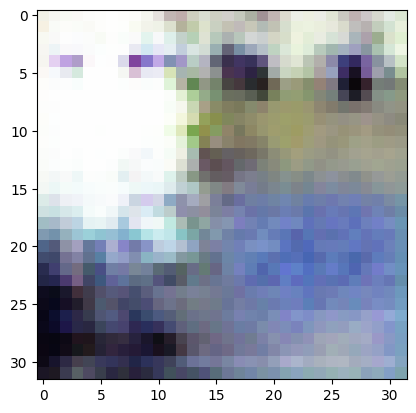

2/2 [==============================] - 0s 6ms/step
>3, 358/390, d1=0.774, d2=0.717 g=0.908


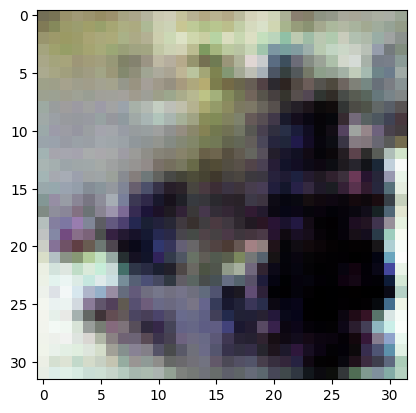

2/2 [==============================] - 0s 8ms/step
>3, 359/390, d1=0.657, d2=0.737 g=0.927


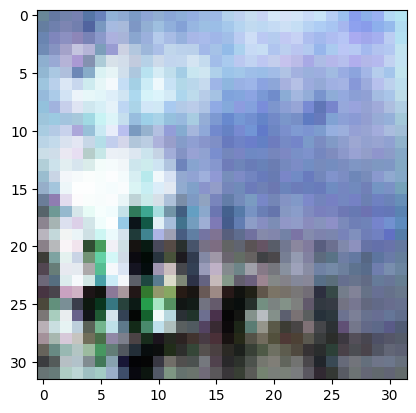

2/2 [==============================] - 0s 8ms/step
>3, 360/390, d1=0.624, d2=0.684 g=0.969


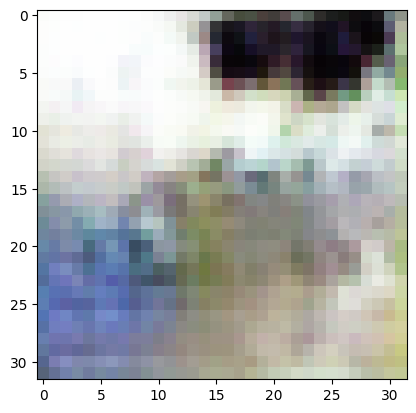

2/2 [==============================] - 0s 6ms/step
>3, 361/390, d1=0.653, d2=0.672 g=1.017


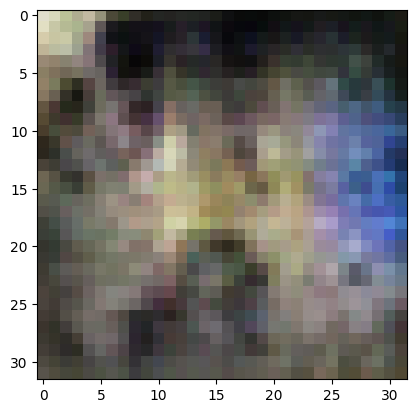

2/2 [==============================] - 0s 8ms/step
>3, 362/390, d1=0.714, d2=0.748 g=1.067


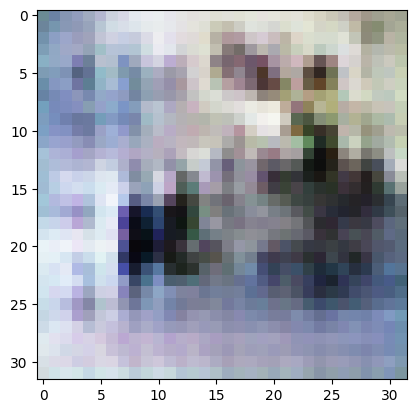

2/2 [==============================] - 0s 9ms/step
>3, 363/390, d1=0.684, d2=0.537 g=1.036


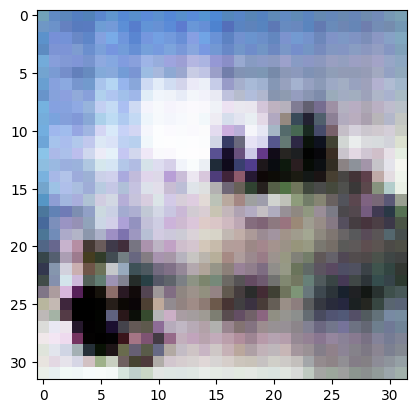

2/2 [==============================] - 0s 8ms/step
>3, 364/390, d1=0.668, d2=0.558 g=1.040


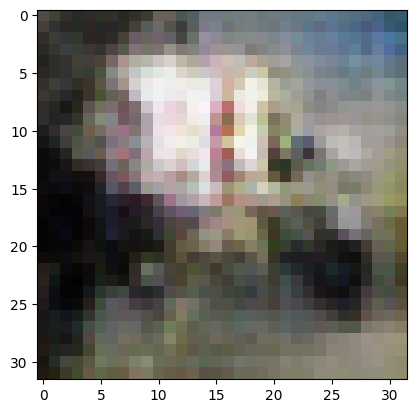

2/2 [==============================] - 0s 7ms/step
>3, 365/390, d1=0.651, d2=0.597 g=0.998


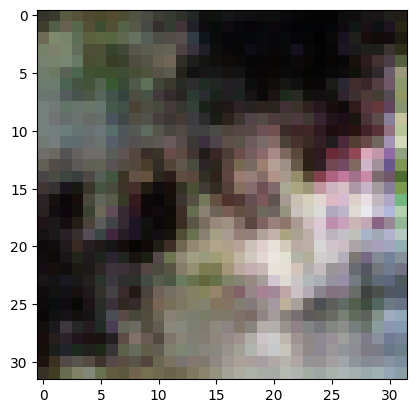

2/2 [==============================] - 0s 14ms/step
>3, 366/390, d1=0.563, d2=0.722 g=1.051


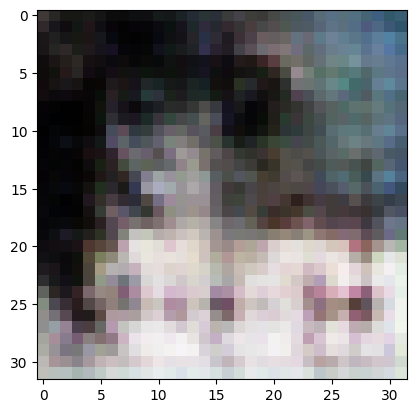

2/2 [==============================] - 0s 6ms/step
>3, 367/390, d1=0.622, d2=0.725 g=1.101


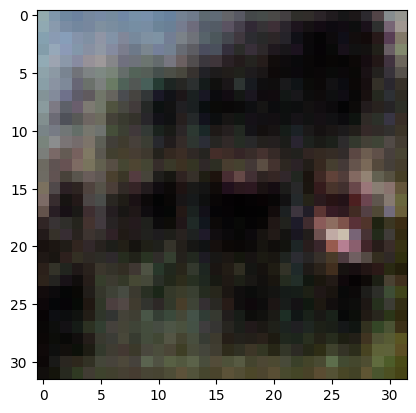

2/2 [==============================] - 0s 7ms/step
>3, 368/390, d1=0.670, d2=0.614 g=1.207


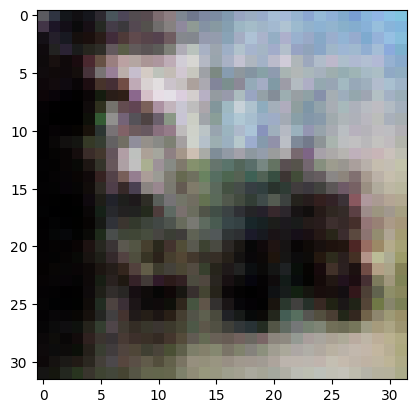

2/2 [==============================] - 0s 8ms/step
>3, 369/390, d1=0.705, d2=0.568 g=1.187


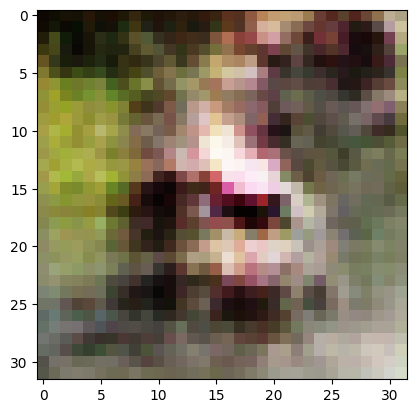

2/2 [==============================] - 0s 8ms/step
>3, 370/390, d1=0.659, d2=0.577 g=1.226


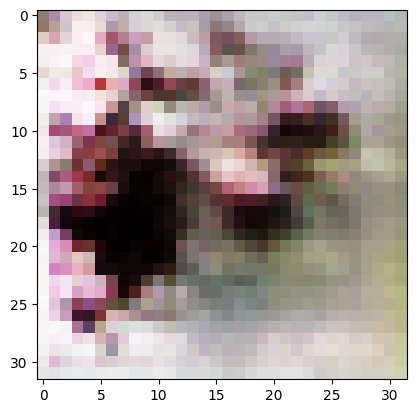

2/2 [==============================] - 0s 9ms/step
>3, 371/390, d1=0.654, d2=0.559 g=1.162


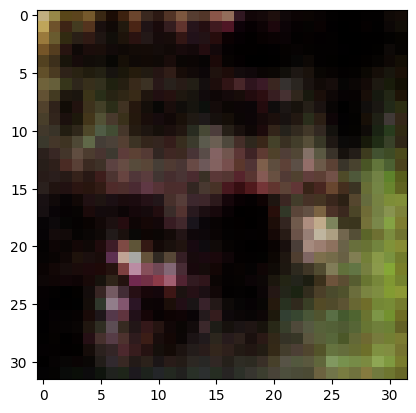

2/2 [==============================] - 0s 8ms/step
>3, 372/390, d1=0.809, d2=0.748 g=1.044


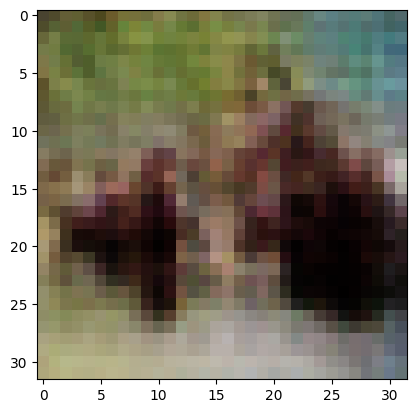

2/2 [==============================] - 0s 9ms/step
>3, 373/390, d1=0.718, d2=0.737 g=1.022


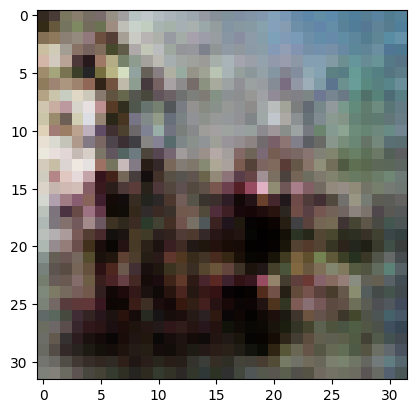

2/2 [==============================] - 0s 7ms/step
>3, 374/390, d1=0.714, d2=0.651 g=1.139


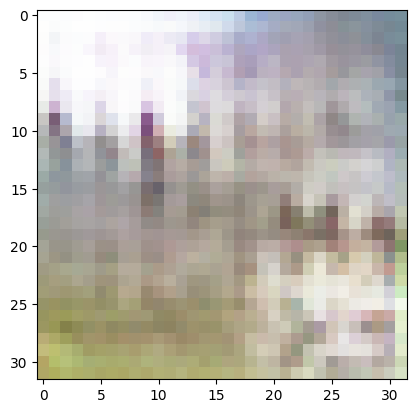

2/2 [==============================] - 0s 7ms/step
>3, 375/390, d1=0.687, d2=0.634 g=1.277


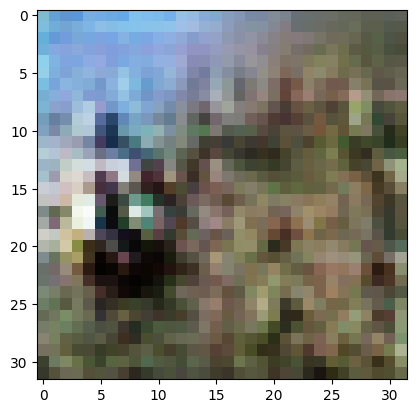

2/2 [==============================] - 0s 7ms/step
>3, 376/390, d1=0.561, d2=0.515 g=1.373


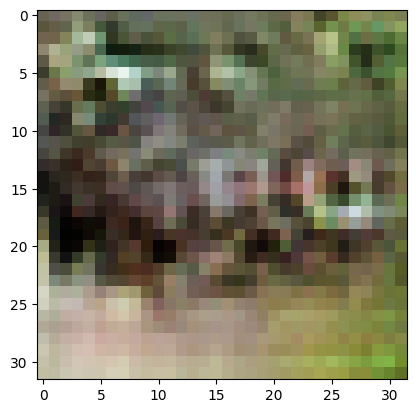

2/2 [==============================] - 0s 6ms/step
>3, 377/390, d1=0.627, d2=0.769 g=1.125


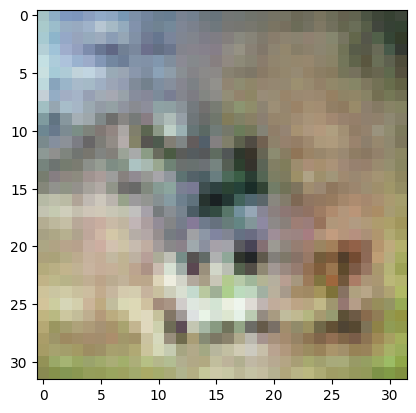

2/2 [==============================] - 0s 10ms/step
>3, 378/390, d1=0.698, d2=1.094 g=1.140


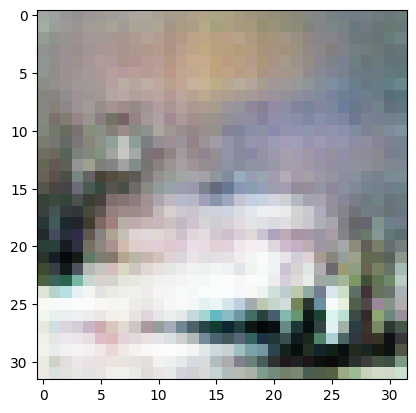

2/2 [==============================] - 0s 8ms/step
>3, 379/390, d1=0.683, d2=0.559 g=1.251


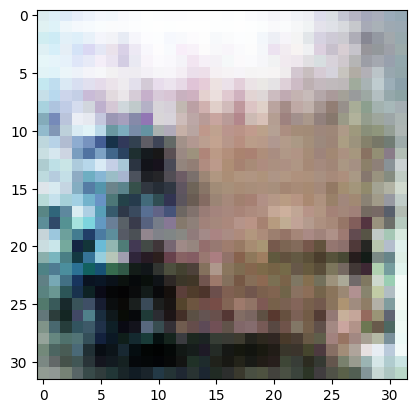

2/2 [==============================] - 0s 7ms/step
>3, 380/390, d1=0.555, d2=0.467 g=1.347


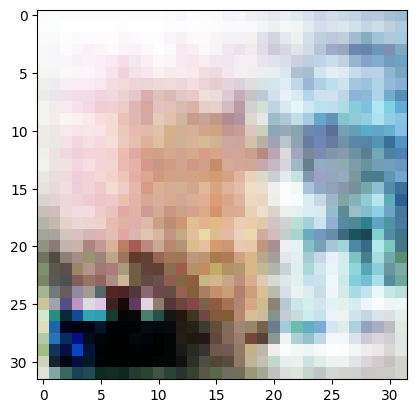

2/2 [==============================] - 0s 7ms/step
>3, 381/390, d1=0.541, d2=0.691 g=1.268


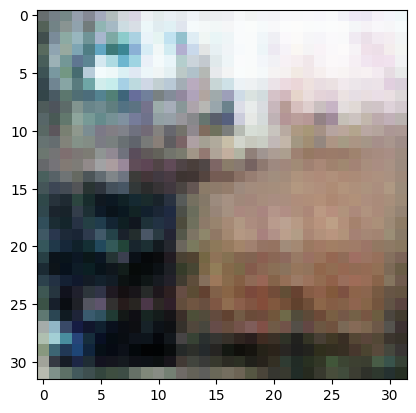

2/2 [==============================] - 0s 8ms/step
>3, 382/390, d1=0.568, d2=0.666 g=1.310


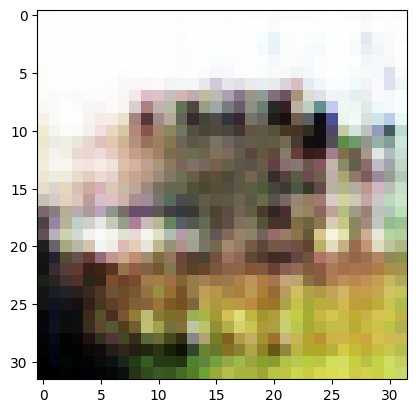

2/2 [==============================] - 0s 9ms/step
>3, 383/390, d1=0.604, d2=0.612 g=1.058


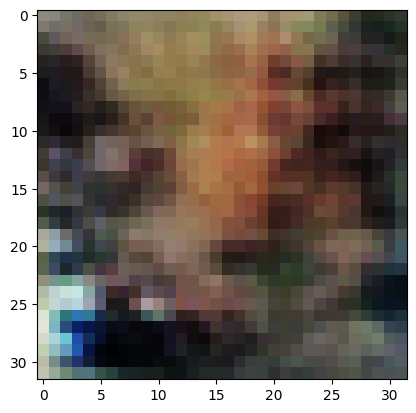

2/2 [==============================] - 0s 7ms/step
>3, 384/390, d1=0.701, d2=0.670 g=1.094


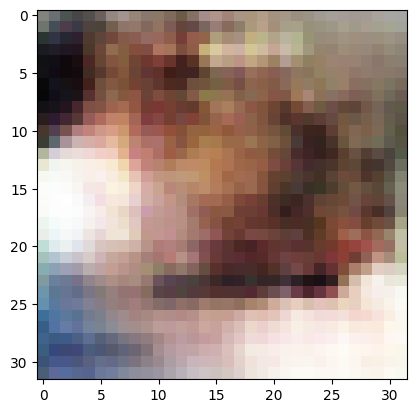

2/2 [==============================] - 0s 6ms/step
>3, 385/390, d1=0.632, d2=0.593 g=1.076


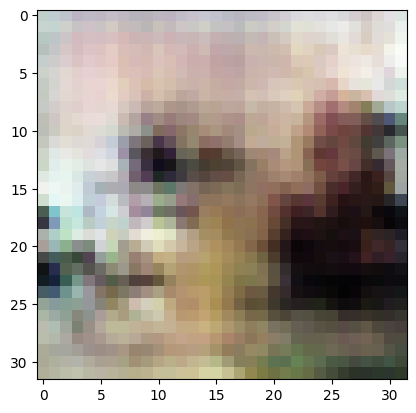

2/2 [==============================] - 0s 6ms/step
>3, 386/390, d1=0.709, d2=0.618 g=1.008


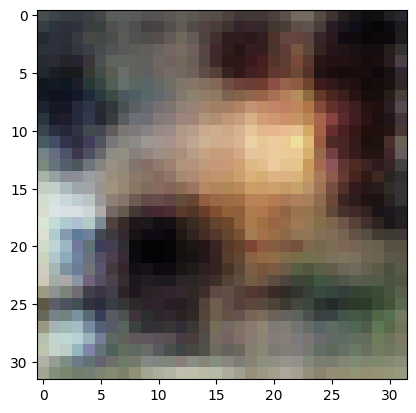

2/2 [==============================] - 0s 7ms/step
>3, 387/390, d1=0.766, d2=0.659 g=1.119


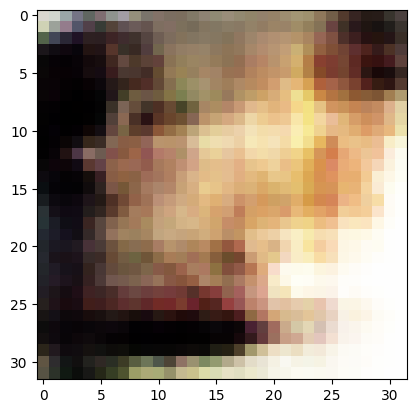

2/2 [==============================] - 0s 7ms/step
>3, 388/390, d1=0.612, d2=0.559 g=1.188


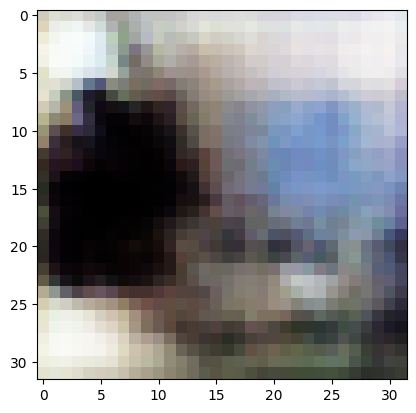

2/2 [==============================] - 0s 7ms/step
>3, 389/390, d1=0.693, d2=0.527 g=1.200


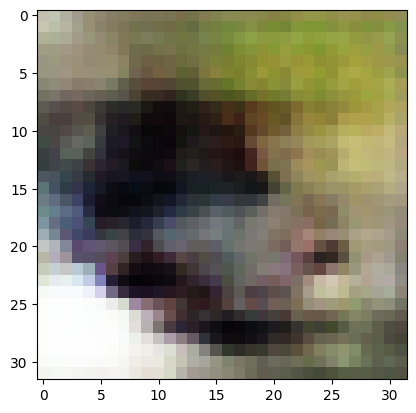

2/2 [==============================] - 0s 12ms/step
>3, 390/390, d1=0.717, d2=0.533 g=1.213


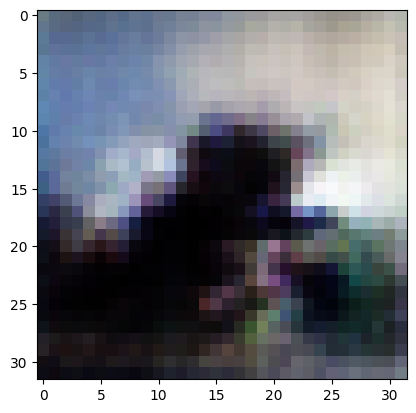

2/2 [==============================] - 0s 11ms/step
>4, 1/390, d1=0.658, d2=0.578 g=1.121


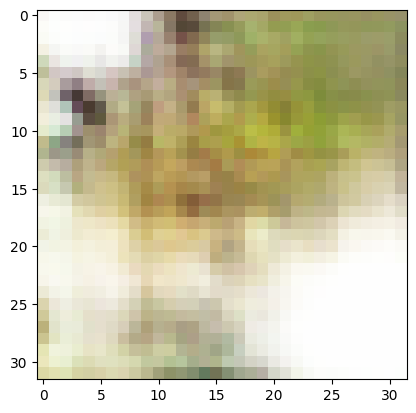

2/2 [==============================] - 0s 6ms/step
>4, 2/390, d1=0.678, d2=0.597 g=1.129


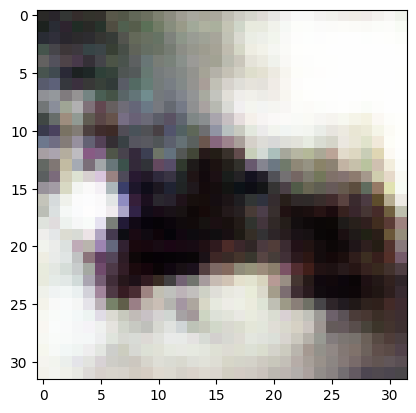

2/2 [==============================] - 0s 7ms/step
>4, 3/390, d1=0.642, d2=0.616 g=1.153


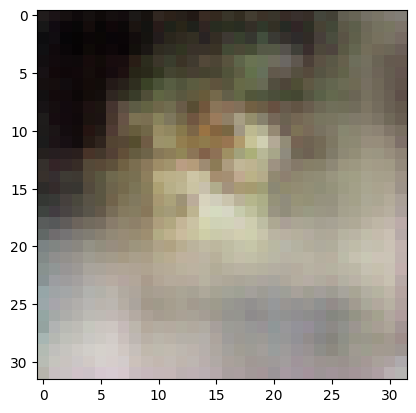

2/2 [==============================] - 0s 6ms/step
>4, 4/390, d1=0.647, d2=0.588 g=1.126


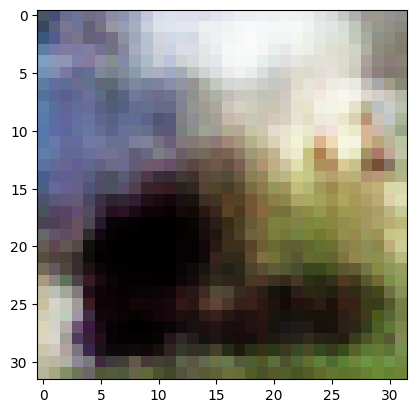

2/2 [==============================] - 0s 9ms/step


In [1]:
# example of a dcgan on cifar10
from numpy import expand_dims
from numpy import zeros
from numpy import ones
from numpy import vstack
from numpy.random import randn
from numpy.random import randint
from keras.datasets.cifar10 import load_data
from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout
from matplotlib import pyplot

# define the standalone discriminator model
def define_discriminator(in_shape=(32,32,3)):
	model = Sequential()
	# normal
	model.add(Conv2D(64, (3,3), padding='same', input_shape=in_shape))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# downsample
	model.add(Conv2D(256, (3,3), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# classifier
	model.add(Flatten())
	model.add(Dropout(0.4))
	model.add(Dense(1, activation='sigmoid'))
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model

# define the standalone generator model
def define_generator(latent_dim):
	model = Sequential()
	# foundation for 4x4 image
	n_nodes = 256 * 4 * 4
	model.add(Dense(n_nodes, input_dim=latent_dim))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 256)))
	# upsample to 8x8
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 16x16
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# upsample to 32x32
	model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	# output layer
	model.add(Conv2D(3, (3,3), activation='tanh', padding='same'))
	return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
	# make weights in the discriminator not trainable
	d_model.trainable = False
	# connect them
	model = Sequential()
	# add generator
	model.add(g_model)
	# add the discriminator
	model.add(d_model)
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt)
	return model

# load and prepare cifar10 training images
def load_real_samples():
	# load cifar10 dataset
	(trainX, _), (_, _) = load_data()
	# convert from unsigned ints to floats
	X = trainX.astype('float32')
	# scale from [0,255] to [-1,1]
	X = (X - 127.5) / 127.5
	return X

# select real samples
def generate_real_samples(dataset, n_samples):
	# choose random instances
	ix = randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	# generate 'real' class labels (1)
	y = ones((n_samples, 1))
	return X, y

# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
	# generate points in latent space
	x_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	X = g_model.predict(x_input)
	# create 'fake' class labels (0)
	y = zeros((n_samples, 1))
	return X, y

# create and save a plot of generated images
def save_plot(examples, epoch, n=7):
	# scale from [-1,1] to [0,1]
	examples = (examples + 1) / 2.0
	# plot images
	for i in range(n * n):
		# define subplot
		pyplot.subplot(n, n, 1 + i)
		# turn off axis
		pyplot.axis('off')
		# plot raw pixel data
		pyplot.imshow(examples[i])
	# save plot to file
	filename = 'generated_plot_e%03d.png' % (epoch+1)
	pyplot.savefig(filename)
	pyplot.close()

# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=150):
	# prepare real samples
	X_real, y_real = generate_real_samples(dataset, n_samples)
	# evaluate discriminator on real examples
	_, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
	# prepare fake examples
	x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
	# evaluate discriminator on fake examples
	_, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
	# summarize discriminator performance
	print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
	# save plot
	save_plot(x_fake, epoch)
	# save the generator model tile file
	filename = 'generator_model_%03d.h5' % (epoch+1)
	g_model.save(filename)

# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=200, n_batch=128):
	bat_per_epo = int(dataset.shape[0] / n_batch)
	half_batch = int(n_batch / 2)
	# manually enumerate epochs
	for i in range(n_epochs):
		# enumerate batches over the training set
		for j in range(bat_per_epo):
			# get randomly selected 'real' samples
			X_real, y_real = generate_real_samples(dataset, half_batch)
			# update discriminator model weights
			d_loss1, _ = d_model.train_on_batch(X_real, y_real)
			# generate 'fake' examples
			X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
			# update discriminator model weights
			d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
			# prepare points in latent space as input for the generator
			X_gan = generate_latent_points(latent_dim, n_batch)
			# create inverted labels for the fake samples
			y_gan = ones((n_batch, 1))
			# update the generator via the discriminator's error
			g_loss = gan_model.train_on_batch(X_gan, y_gan)
			# summarize loss on this batch
			print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' %
				(i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))
			pyplot.imshow((X_fake[0]+1)/2); pyplot.show()
		# evaluate the model performance, sometimes
		if (i+1) % 10 == 0:
			summarize_performance(i, g_model, d_model, dataset, latent_dim)

# size of the latent space
latent_dim = 100
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples()
# train model
train(g_model, d_model, gan_model, dataset, latent_dim)

In [ ]:
import numpy as np
import tensorflow as tf

# Load the CIFAR-10 dataset
(train_images, train_labels), (test_images, test_labels) = tf.keras.datasets.cifar10.load_data()

# Find the indices of all frog images in the training set
frog_indices = np.where(train_labels == 6)[0]

# Extract the frog images from the training set
frog_images = train_images[frog_indices]

In [ ]:
# Define the generator model
generator = tf.keras.Sequential([
    tf.keras.layers.Dense(128 * 7 * 7, activation="relu"),
    tf.keras.layers.Reshape((7, 7, 128)),
    tf.keras.layers.Conv2DTranspose(128, (3, 3), strides=2, activation="relu"),
    tf.keras.layers.Conv2DTranspose(64, (3, 3), strides=2, activation="relu"),
    tf.keras.layers.Conv2D(1, (3, 3), activation="sigmoid"),
])

# Train the GAN on the frog images
# ... (code to train the GAN)

# Generate 10 frogs
generated_frogs = generator.predict(np.random.randn(10, 100))

1/1 [==============================] - 0s 183ms/step
